# Which Rates can we expect ? 

In [1]:
import matplotlib.pyplot as plt 
% matplotlib inline

import pandas as pd
import numpy as np

import scipy
from scipy import stats

from random import randint

from astropy.io import fits  ## pip install astropy --no-deps 
from astropy import units as u 

from collections import OrderedDict

from Gilmore_simulation import calculatesignificance,calculaterate
from Gilmore_simulation import calculaterate_GBM
from Gilmore_simulation import plot_simulation, integrate_background
from spectra_LAT import make_DF_from_LGRB
from spectra import make_DF_from_GBM, make_DF_from_BATSE

from uncertainties import unumpy
from uncertainties import ufloat

from ebltable.tau_from_model import OptDepth
tau =  OptDepth.readmodel(model = 'dominguez')

## Realistic expactations on the detectability of different transients
                 
### 1a Gilmore expactations done with newest data set 

[Paper](https://arxiv.org/pdf/1201.0010.pdf) von Gilmore et.al 2012:
- CGRO BATSE and *Swift* BAT Data in kev range 
- High energy data from *Fermi* LAT 
- Extrapolation with BANDEX and FIXED model depending on BAND function
- EBL attenuation by Gilmore, z distribution uncorrelated to fluence
- effective area and background from CTA (modeled)
- Flux calculation through time and energy integration 
- significance calculation 
- detection rate calculation 

Need catalogs:
- CGRO BATSE catalog BATSE5B (As a .Fit-File [here-browse results](https://heasarc.gsfc.nasa.gov/W3Browse/cgro/bat5bgrbsp.html))
- *SWIFT* GRB Lookuptable(Look up[here](https://swift.gsfc.nasa.gov/archive/grb_table/))
- *Fermi* LAT GRB catalog (As a .Fit-File [here](https://heasarc.gsfc.nasa.gov/W3Browse/fermi/fermilgrb.html))
- *Fermi* GBM GRBs catalog (As a .Fit-File [here](https://heasarc.gsfc.nasa.gov/W3Browse/fermi/fermigbrst.html))

Also need:
- CTAs IRF for different zenith angles and observation times 
- EBL model (new Version by Dominguez reaching z=4) 

Copy steps:
- get Band function indices
- test fixed and bandex model 
- get EBL attenuation 
- fold flux with effective area 
- calculate significances
- check redshift distribution of Fermi LAT bursts
- check flux distributions of LAT bursts

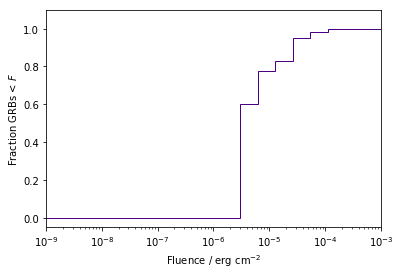

In [4]:
## LAT Catalog online 
LAT_DF = make_DF_from_LGRB('Kataloge/LATGRB.fits')

## catalog Paper with redshift table 
LAT_Redshifts = np.array([4.35,3.57,0.74,0.9,1.82,2.11,0.9,1.06,1.37,2.83])
Redshift_Bursts = np.array(['080916','090323', '090328', '090510','090902',
                           '090926', '091003', '091208', '100414', '110731'])
## Redshifts in a histogram 
plt.hist(LAT_Redshifts, color='indigo')
plt.xlabel(r'Redshift $z$') ; plt.ylabel('# GRBs')
plt.savefig('Plots/LAT_Redshifts.pdf')  ; plt.clf()

## Max Energy Loss 
plt.hist(LAT_DF['Emax'], color='#73ac14',bins=10)
plt.xlabel(r'$E_{\mathrm{max}}$ / GeV') ; plt.ylabel('# GRBs')
plt.savefig('Plots/LAT_Energies.pdf') ; plt.clf()

## Fluence 
binning = np.logspace(-9,-3,20)
plt.hist(LAT_DF['Fluence'],bins=binning,cumulative=True,histtype='step',density=True, color='indigo')
plt.xscale('log') ; plt.xlabel('Fluence / erg cm$^{-2}$')
plt.ylabel('Fraction GRBs < $F$') ; #plt.title('Cumulative fluence distribution')
plt.ylim(-0.05,1.1) ; plt.xlim(1e-9,1e-3)
plt.savefig('Plots/LAT_CumFluence.pdf',bbox_inches='tight') 
#plt.savefig('Plots/Gilmore_Simulation/LAT_CumFluence.jpeg',bbox_inches='tight') 

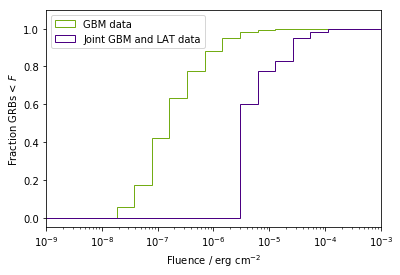

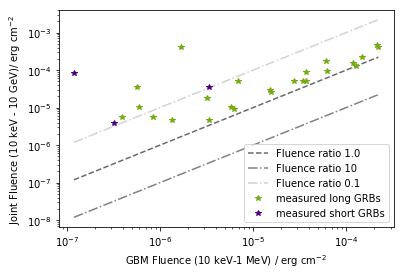

In [7]:
## GBM catalog
DF = make_DF_from_GBM('Kataloge/GRBST.fits')
## Comparison GBM and LAT 
binning = np.logspace(-9,-3,20)
plt.hist(DF['Fluence'],bins=binning,cumulative=True,histtype='step',density=True, color='#73ac14',
        label='GBM data')
plt.hist(LAT_DF['Fluence'],bins=binning,cumulative=True,histtype='step',density=True, color='indigo',
        label='Joint GBM and LAT data')
plt.xscale('log') ; plt.xlabel('Fluence / erg cm$^{-2}$')
plt.ylabel('Fraction GRBs < $F$') ; #plt.title('Cumulative fluence distribution')
plt.ylim(-0.05,1.1) ; plt.xlim(1e-9,1e-3)
plt.legend(loc='upper left') ; 
plt.savefig('Plots/GBM_vs_LAT.pdf',bbox_inches='tight')
#plt.savefig('Plots/Gilmore_Simulation/GBM_vs_LAT.jpg',bbox_inches='tight')
plt.show() ;plt.clf()

GBM_Flu = np.zeros(26) ; Flu_LAT = np.zeros(26)
Fast_GBM = np.zeros(4) ; Fast_LAT = np.zeros(4)
index, index2 = 0,0
#Search for common detections of one GRB 
for i in LAT_DF['Name']:
    LAT = LAT_DF[LAT_DF.Name.str.contains(i)]
    Table = DF[DF.Name.str.contains(i[0:9])]
    if len(Table) == 1:  
        
        if Table['T90/s'].iloc[0] > 2: 
            GBM_Flu[index] = Table['Fluence'].iloc[0]
            Flu_LAT[index] = LAT['Fluence']
            index +=1
        else:
            Fast_GBM[index2] = Table['Fluence'].iloc[0]
            Fast_LAT[index2] = LAT['Fluence']
            index2 +=1 
    if len(Table) == 2:
        if Table['T90/s'].iloc[0] > 2: 
            GBM_Flu[index] = Table['Fluence'].iloc[0]
            Flu_LAT[index] = LAT['Fluence']
            index +=1
        if Table['T90/s'].iloc[1] > 2: 
            GBM_Flu[index] = Table['Fluence'].iloc[1]
            Flu_LAT[index] = LAT['Fluence']
            index +=1
        if Table['T90/s'].iloc[0] <= 2:
            Fast_GBM[index2] = Table['Fluence'].iloc[0]
            Fast_LAT[index2] = LAT['Fluence'] 
            index2 +=1
        if Table['T90/s'].iloc[1] <= 2:
            Fast_GBM[index2] = Table['Fluence'].iloc[1]
            Fast_LAT[index2] = LAT['Fluence'] 
            index2 +=1 
# Plot Fluence Rate            
plt.xlabel('GBM Fluence (10 keV-1 MeV) / erg cm$^{-2}$') 
plt.ylabel('Joint Fluence (10 keV - 10 GeV)/ erg cm$^{-2}$') 
plt.xscale('log') ; plt.yscale('log')
x = np.linspace(Fast_GBM.min(),GBM_Flu.max())
plt.plot(x,x,'--',color='dimgray',label='Fluence ratio 1.0')
plt.plot(x,0.1*x,'-.',color='gray',label='Fluence ratio 10')
plt.plot(x,10*x,'-.',color='lightgray',label='Fluence ratio 0.1')
plt.plot(GBM_Flu,Flu_LAT,'*',color='#73ac14',label='measured long GRBs')
plt.plot(Fast_GBM,Fast_LAT,'*',color='indigo',label='measured short GRBs')
plt.legend() ; #plt.title('Fluence ratio = LAT_Fluence/GBM_Fluence')
plt.savefig('Plots/LAT_GBM_Fluence.pdf',bbox_inches='tight')
#plt.savefig('Plots/Gilmore_Simulation/LAT_GBM_Fluence.jpg',bbox_inches='tight')


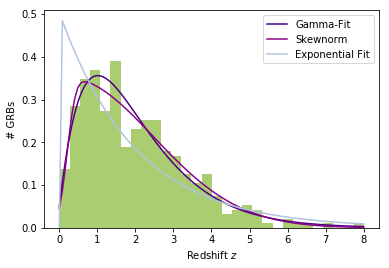

2.0820486455090523

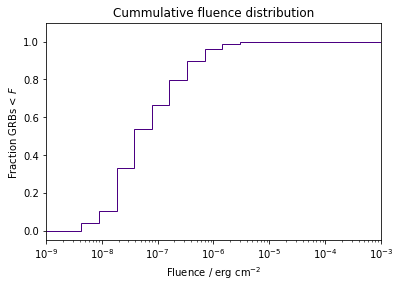

In [6]:
## SWIFT data 2004-2018 
Name,Flu,z = np.genfromtxt('Kataloge/SWIFT.txt',unpack=True)
Flu = Flu*1e-7 # in erg/cm² between 15 and 150 keV 
## Redshift 
plt.hist(z[z>0],bins=30,color='#73ac14',density=True, alpha=0.6)
plt.xlabel('Redshift $z$') ; plt.ylabel('# GRBs')

gamma = stats.gamma
x = np.linspace(0, z[z>0].max(), 100)
param = gamma.fit(z[z>0]) ; pdf_fitted = gamma.pdf(x, *param)
a = param[0]
plt.plot(x, pdf_fitted, color='indigo', label='Gamma-Fit')

skewnorm = stats.skewnorm
param = skewnorm.fit(z[z>0]) ; pdf_fitted = skewnorm.pdf(x, *param)
plt.plot(x, pdf_fitted, color='darkmagenta', label='Skewnorm')

P = stats.expon.fit(z[z>0])
rX = np.linspace(0,8, 100) ; rP = stats.expon.pdf(rX, *P)
plt.plot(rX, rP, color='lightsteelblue', label='Exponential Fit')
plt.legend()
plt.savefig('Plots/SWIFT_Redshifts.pdf',bbox_inches='tight')
#plt.savefig('Plots/SWIFT_Redshifts.jpg',bbox_inches='tight')
plt.show() ; plt.clf()

## Test density 
r = gamma.rvs(a, size=1000)
#plt.hist(r, histtype='stepfilled', color='#73ac14') ---> Able to randomly drag Redshift 

## Fluence 
binning = np.logspace(-9,-3,20)
plt.hist(Flu[Flu>1e-9],bins=binning,cumulative=True,histtype='step',density=True, color='indigo')
plt.xscale('log')
plt.xlabel('Fluence / erg cm$^{-2}$') ; plt.ylabel('Fraction GRBs < $F$')
plt.title('Cummulative fluence distribution')
plt.ylim(-0.05,1.1) ; plt.xlim(1e-9,1e-3)
plt.savefig('Plots/SWIFT_Fluence.pdf',bbox_inches='tight')
#plt.savefig('Plots/SWIFT_Fluence.jpg',bbox_inches='tight')

a

Length of Lowest regime (0-1.2) =  118
Length of Middle regime (1.2-2.43)=  119
Length of Highest regime (>2.43) =  119
The higher the redshfit, the higher the fluence needed for a detection


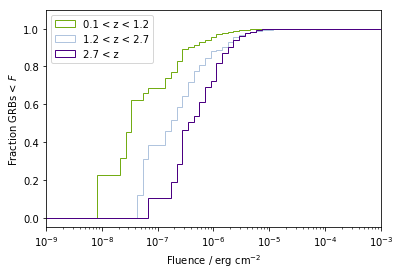

Pearson correlation Redshift to Fluence:  -0.119884970133


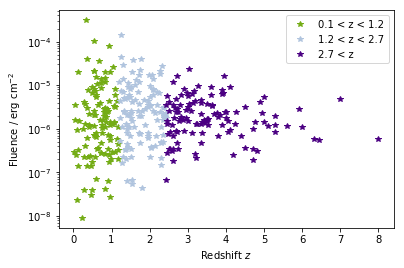

In [9]:
SWIFT_DF = pd.DataFrame({'Name': Name,'Fluence':Flu , 'Redshift': z   
                         })
All_z = SWIFT_DF[SWIFT_DF['Redshift']>0]
Low_z = All_z[All_z['Redshift']<1.2]
Config_z = All_z[All_z['Redshift']>1.2]
Mid_z = Config_z[Config_z['Redshift']<2.43]
High_z = All_z[All_z['Redshift']>2.43]
# Rates
print('Length of Lowest regime (0-1.2) = ',len(Low_z['Redshift']))
print('Length of Middle regime (1.2-2.43)= ',len(Mid_z['Redshift']))
print('Length of Highest regime (>2.43) = ',len(High_z['Redshift']))
# Histogramm 
binning = np.logspace(-9,-3,60)
plt.hist(Low_z['Fluence'],histtype = 'step',cumulative=True, bins=binning,density=True,
        color='#73ac14', label='0.1 < z < 1.2')
plt.hist(Mid_z['Fluence'],histtype = 'step',cumulative=True,bins=binning, density=True,
        color='lightsteelblue', label='1.2 < z < 2.7')
plt.hist(High_z['Fluence'],histtype='step',cumulative=True,bins=binning,density=True,
        color='indigo', label='2.7 < z')

print('The higher the redshfit, the higher the fluence needed for a detection')

plt.xscale('log')
plt.ylim(-0.05,1.1) ; plt.xlim(1e-9,1e-3)
plt.xlabel('Fluence / erg cm$^{-2}$') ; plt.ylabel('Fraction GRBs < $F$')
#plt.title('Cummulative fluence distribution')
plt.legend(loc ='upper left')
plt.savefig('Plots/SWIFT_z_Fluence.pdf',bbox_inches='tight') ;plt.show(); plt.clf()
#plt.savefig('Plots/Gilmore_Simulation/SWIFT_z_Fluence.jpg',bbox_inches='tight') ; plt.show(); plt.clf()


plt.plot(Low_z['Redshift'],Low_z['Fluence'],'*', color='#73ac14',label='0.1 < z < 1.2')
plt.plot(Mid_z['Redshift'],Mid_z['Fluence'],'*', color='lightsteelblue',label='1.2 < z < 2.7')
plt.plot(High_z['Redshift'],High_z['Fluence'],'*', color='indigo',label='2.7 < z ')

plt.yscale('log')
plt.legend()
plt.xlabel('Redshift $z$') ; plt.ylabel('Fluence / erg cm$^{-2}$')
plt.savefig('Plots/SWIFT_z_Fluence_Corr.pdf',bbox_inches='tight') 
#plt.savefig('Plots/Gilmore_Simulation/SWIFT_z_Fluence_Corr.jpg',bbox_inches='tight') ; plt.show() ; plt.clf()
print('Pearson correlation Redshift to Fluence: ',
      scipy.stats.pearsonr(All_z['Redshift'],All_z['Fluence'])[0]) #Pearson coefficient and p-Value 

In [2]:
# BATSE
BATSE_DF = make_DF_from_BATSE('Kataloge/BATSE5B.fits')
#BATSE_DF

### Instrument Response Function 
-----> For folding data with telescope's response <br>
“This research has made use of the CTA instrument response functions provided by the CTA Consortium and Observatory, see http://www.cta-observatory.org/science/cta-performance/ (version prod3b-v1) for more details.”

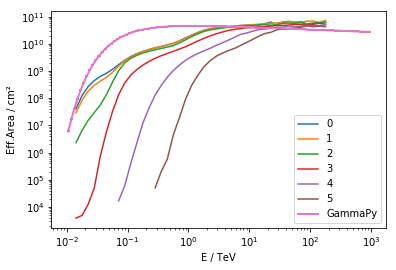

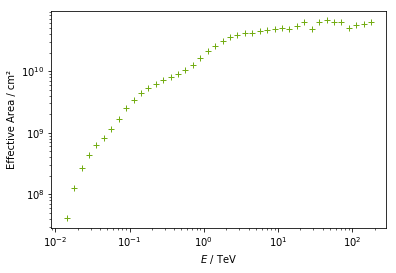

In [3]:
## effective Area
cta_perf_fits = fits.open('/home/jana/Schreibtisch/Projekt_Master/caldb/data/cta/prod3b/bcf/South_z20_average_100s/irf_file.fits')
data_A_eff = cta_perf_fits['EFFECTIVE AREA']

a_eff_cta_south = OrderedDict({"E_TeV": (data_A_eff.data['ENERG_LO'][0] + data_A_eff.data['ENERG_HI'][0])/2,
                                "A_eff": data_A_eff.data['EFFAREA'][0]})
plt.plot(a_eff_cta_south['E_TeV'], a_eff_cta_south['A_eff'][0]*1e4, label='0')
plt.plot(a_eff_cta_south['E_TeV'], a_eff_cta_south['A_eff'][1]*1e4, label='1')
plt.plot(a_eff_cta_south['E_TeV'], a_eff_cta_south['A_eff'][2]*1e4, label='2')
plt.plot(a_eff_cta_south['E_TeV'], a_eff_cta_south['A_eff'][3]*1e4, label='3')
plt.plot(a_eff_cta_south['E_TeV'], a_eff_cta_south['A_eff'][4]*1e4, label='4')
plt.plot(a_eff_cta_south['E_TeV'], a_eff_cta_south['A_eff'][5]*1e4, label='5')

energy = np.logspace(-2, 3, 100) * u.TeV
from gammapy.irf import EffectiveAreaTable
for instrument in [ 'CTA']:
    aeff = EffectiveAreaTable.from_parametrization(energy, instrument)
    ax = aeff.plot(label='GammaPy')
plt.legend()
plt.yscale('log') ; plt.xscale('log')
plt.xlabel('E / TeV') ; plt.ylabel('Eff.Area / cm²')
plt.show() ; plt.clf() 
## 0 = OPTIMISTIC = CHOSEN 

plt.plot(a_eff_cta_south['E_TeV'], a_eff_cta_south['A_eff'][0]*1e4,'+', color='#73ac14')
plt.yscale('log') ; plt.xscale('log')
plt.xlabel('$E$ / TeV') ; plt.ylabel('Effective Area / cm²')
plt.savefig('Plots/CTA_Aeff.pdf',bbox_inches='tight') ;plt.show();  plt.clf()
#plt.savefig('Plots/Gilmore_Simulation/CTA_Aeff.jpg',bbox_inches='tight') ;plt.show() ; plt.clf()

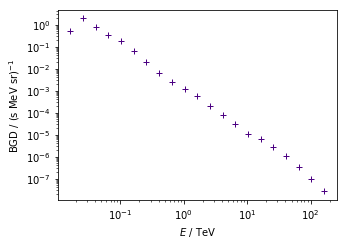

In [4]:
## Instrument Background
data_ang_res = cta_perf_fits['POINT SPREAD FUNCTION']
data_bg_rate = cta_perf_fits['BACKGROUND']

psf_cta_south = OrderedDict({"E_TeV": (data_ang_res.data['ENERG_LO'][0] + data_ang_res.data['ENERG_HI'][0])/2,
                                    "psf_sigma": data_ang_res.data['SIGMA_1'][0]})



Background_cta_south = OrderedDict({"E_TeV": (data_bg_rate.data['ENERG_LO'][0] + data_bg_rate.data['ENERG_HI'][0])/2,
                                   "DetX": (data_bg_rate.data['DETX_LO'][0]+data_bg_rate.data['DETX_HI'][0])/2,
                                 "DetY": (data_bg_rate.data['DETY_LO'][0]+data_bg_rate.data['DETY_HI'][0])/2,
                                    'Background': data_bg_rate.data['BGD']
                              })

All_21 = Background_cta_south['Background'][0]
plt.figure(figsize=(5,3.5))
for i in range(0,21):
    plt.plot(Background_cta_south['E_TeV'][i],All_21[i].max(),'+', color='indigo')
plt.xscale('log')
plt.yscale('log')
plt.xlabel('$E$ / TeV')
plt.ylabel('BGD / (s MeV sr)$^{-1}$')
#plt.savefig('Plots/Gilmore_Simulation/Integrated_backgorund.jpg',bbox_inches='tight')
plt.savefig('Plots/Integrated_backgorund.pdf',bbox_inches='tight')
plt.show()

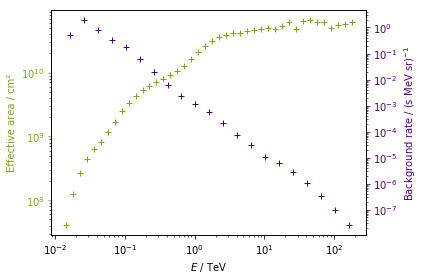

In [5]:
fig, ax1 = plt.subplots()
ax1.plot(a_eff_cta_south['E_TeV'], a_eff_cta_south['A_eff'][0]*1e4,'+', color='#73ac14')
plt.yscale('log') ; plt.xscale('log')
ax1.set_xlabel('$E$ / TeV')
ax1.tick_params('y', colors='#73ac14')
# Make the y-axis label, ticks and tick labels match the line color.
ax1.set_ylabel('Effective area / cm²',color='#73ac14')

All_21 = Background_cta_south['Background'][0]
ax2 = ax1.twinx()
plt.yscale('log') ; plt.xscale('log')
for i in range(0,21):
    ax2.plot(Background_cta_south['E_TeV'][i],All_21[i].max(),'+', color='indigo')

ax2.set_ylabel('Background rate / (s MeV sr)$^{-1}$', color='indigo')
ax2.tick_params('y', colors='indigo')

fig.tight_layout()
#plt.savefig('Plots_DE/jpeg/Integrated_backgorund.jpg',bbox_inches='tight')
plt.savefig('Plots/Aeff_backgorund.pdf',bbox_inches='tight')
plt.show()



### Folding 

- differential flux + EBL absorption
- effective area
- background distribution 

----> Calculate N$_{on}$ and N$_{off}$

In [3]:
Background_Rates,Energy = integrate_background('/home/jana/Schreibtisch/Projekt_Master/caldb/data/cta/prod3b/bcf/South_z20_average_100s/irf_file.fits')# [i].ax = 21 background rates in 1/s
print(Background_Rates[0].max().to(1/u.min)) # per minute to be compared to MAGIC perrfomance 2015
plt.figure(figsize=(5,3.5))
for i in range(0,len(Background_Rates)):
    plt.plot(Energy[i],Background_Rates[i].max(),'+', color='indigo')
plt.xscale('log')
plt.yscale('log')
plt.xlabel('$E$ / TeV') ; plt.ylabel(r'BGD Rate / s$^{-1}$')
plt.savefig('Plots/CTA_background_rate.pdf',bbox_inches='tight'); plt.clf()
#plt.savefig('Plots/Gilmore_Simulation/CTA_background_rate.jpg',bbox_inches='tight');plt.show(); plt.clf()

8.002836406230927 1 / min


Start simulation for 910905 with random redshift =  0.1
0.9599769154110965 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800
Fluence measured by BATSE 2.19126621966e-07
K calaculated for additional Power Law  8.76506487864e-14


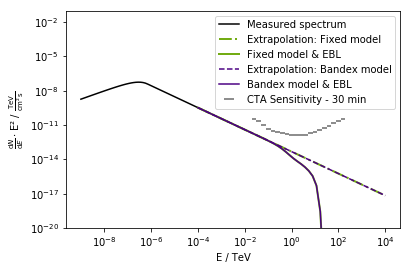

<Quantity 0.9599769154110965>

In [4]:
from Gilmore_simulation import calculaterate_GBM
def simulate_BATSE_detection(Path_to_fits_file,BATSE_DF, GRBname,z,time):
    print('Start simulation for', GRBname, 'with random redshift = ', z)
    BGD_Rate = integrate_background(Path_to_fits_file)[0] # integrate--- has two outputs 
    Gamma_Rate = calculaterate(Path_to_fits_file,GRBname,BATSE_DF,z)
    Sigma = calculatesignificance(Gamma_Rate,BGD_Rate,time,1)
    print(Sigma, 'Sigma reached with a maximum background and EBL absorption')
    print('Duration of simulation in seconds: ',time)
    plot_simulation(GRBname,BATSE_DF,z)
    return Sigma

simulate_BATSE_detection('/home/jana/Schreibtisch/Projekt_Master/caldb/data/cta/prod3b/bcf/South_z20_average_30m/irf_file.fits',
            BATSE_DF,'910905',0.1,1800)

### Usage of above defined functions

--> Simulate GRB-like transients and calculate significance
      - randomly drag transient's shape by calling a Name out of BATSE_DF['Name']
      - randomly drag transient's redshift by dragging redshift out of gamma density function 

Start simulation for 4B 940415-  with random redshift =  1.456482877
0.003986005198061943 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800
Fluence measured by BATSE 1.05405523797e-07
K calaculated for additional Power Law  4.21622095188e-14


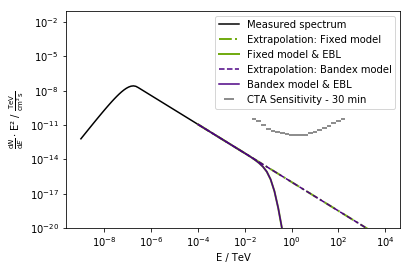

Start simulation for 4B 930621-  with random redshift =  0.654641821254
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800
Fluence measured by BATSE 1.26766901451e-08
K calaculated for additional Power Law  5.07067605803e-15


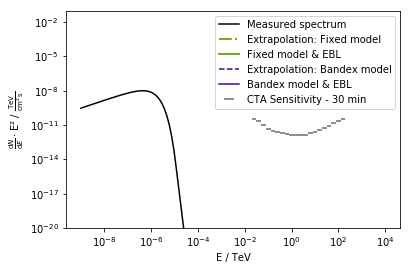

Start simulation for 4B 911026   with random redshift =  0.591284644656
52.38026442076968 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800
Fluence measured by BATSE 7.61735072894e-08
K calaculated for additional Power Law  3.04694029158e-14


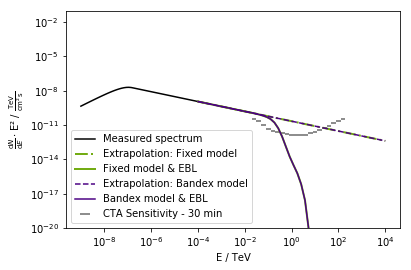

Start simulation for 4B 920622-  with random redshift =  2.93599783289
944.8560921738239 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800
Fluence measured by BATSE 1.90692422062e-07
K calaculated for additional Power Law  7.62769688248e-14


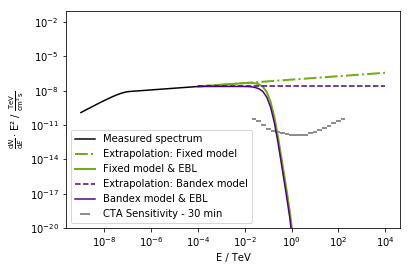

Start simulation for 4B 931024   with random redshift =  1.56881631145
1.1256803451832649 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800
Fluence measured by BATSE 2.70367189976e-07
K calaculated for additional Power Law  1.08146875991e-13


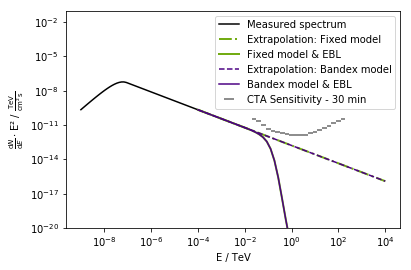

Start simulation for 4B 950130   with random redshift =  1.12225013213
1162.1256394199793 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800
Fluence measured by BATSE 1.54940253255e-06
K calaculated for additional Power Law  6.19761013019e-13


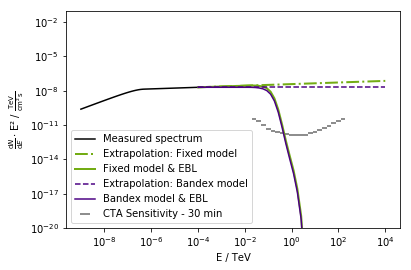

Start simulation for 4B 940226-  with random redshift =  1.98303824757
1.874212677588744e-08 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800
Fluence measured by BATSE 5.06660645432e-08
K calaculated for additional Power Law  2.02664258173e-14


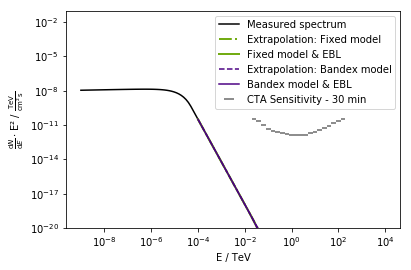

Start simulation for GRB 000126- with random redshift =  0.423570125233
0.6066830427348604 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800
Fluence measured by BATSE 2.60749298204e-07
K calaculated for additional Power Law  1.04299719282e-13


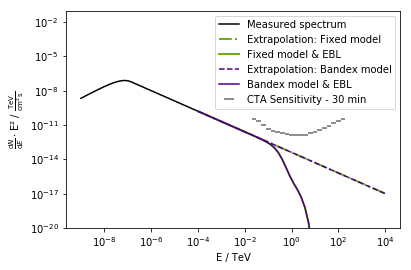

Start simulation for 4B 910904   with random redshift =  1.07427476029
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800
Fluence measured by BATSE 6.23833450761e-08
K calaculated for additional Power Law  2.49533380304e-14


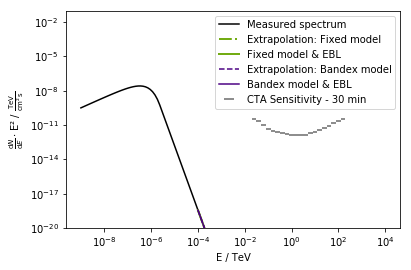

In [7]:
### Name randomly drag from BATSE Dataframe 
### Redshift not known --> Drag from distribution above
N = 10
Sigmas = unumpy.uarray(np.zeros(N), np.zeros(N)) 
for i in range(0,N-1):
    index = randint(0,len(BATSE_DF)-1)
    Name = BATSE_DF['Name'][index]
    z = gamma.rvs(a, size=1)
    z = z[0]

    Sigma = simulate_BATSE_detection('/home/jana/Schreibtisch/Projekt_Master/caldb/data/cta/prod3b/bcf/South_z20_average_30m/irf_file.fits',
               BATSE_DF,Name,z,1800)
    if np.isnan(Sigma) == True:
        Sigma = 0.0
    Sigmas[i] = Sigma 

In [8]:
DetectionRate = len(Sigmas[Sigmas>5])/len(Sigmas)
DetectionRate

0.3

## Usage with GBM data

Start simulation for 090926 with (random?) redshift =  0.1
Start IRF part
Ready
1715.5951668627106 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


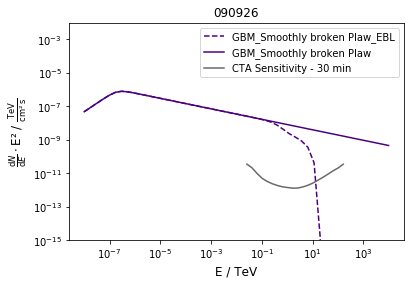

<Quantity 1715.5951668627106>

In [12]:
DF = make_DF_from_GBM('Kataloge/GRBST.fits')
from Gilmore_simulation import plot_Flux_Energy
from Sensitivity import plot_Sens

def simulate_GBM_detection(Path_to_fits_file,GBM_DF, GRBname,z,time):
    print('Start simulation for', GRBname, 'with (random?) redshift = ', z)
    BGD_Rate = integrate_background(Path_to_fits_file)[0] # integrate--- has two outputs 
    Gamma_Rate = calculaterate_GBM(Path_to_fits_file,GRBname,GBM_DF,z)
    Sigma = calculatesignificance(Gamma_Rate,BGD_Rate,time,1)
    print(Sigma, 'Sigma reached with a maximum background and EBL absorption')
    print('Duration of simulation in seconds: ',time)
    plot_Flux_Energy(GRBname,GBM_DF,True,z,'indigo')
    plot_Flux_Energy(GRBname,GBM_DF,False,z,'indigo')
    plot_Sens('Tev', 'curve','dimgray')
    plt.ylim(1e-15,1e-2)
    plt.show()
    return Sigma

simulate_GBM_detection('/home/jana/Schreibtisch/Projekt_Master/caldb/data/cta/prod3b/bcf/South_z20_average_30m/irf_file.fits',
                  DF,'090926', 0.1,1800)

Start simulation for GRB140323433 with (random?) redshift =  0.654808473716
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


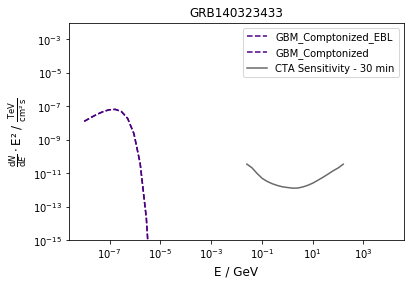

Start simulation for GRB100325246 with (random?) redshift =  0.612303786951
Start IRF part
Ready
1998.572429522645 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


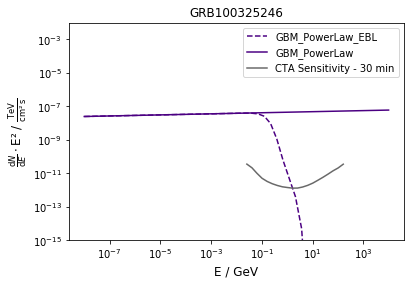

Start simulation for GRB100507577 with (random?) redshift =  2.49163411524
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


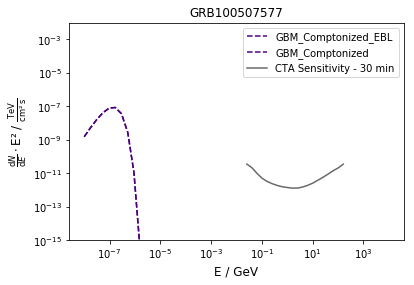

Start simulation for GRB140518709 with (random?) redshift =  8.9366501287
Start IRF part
Ready
180673.6075148894 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


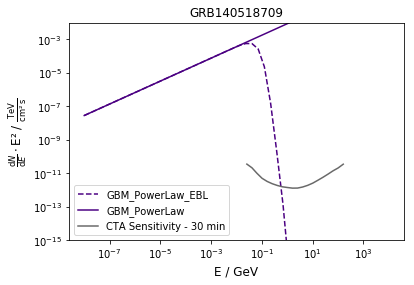

Start simulation for GRB130623488 with (random?) redshift =  2.92497089376
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


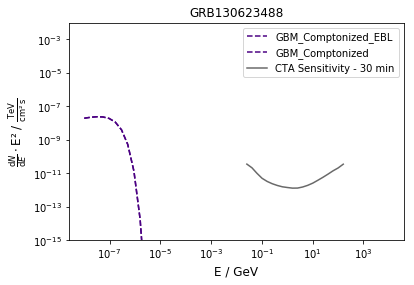

Start simulation for GRB141004150 with (random?) redshift =  2.37934176675
Start IRF part
Ready
1.5398502544744859 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


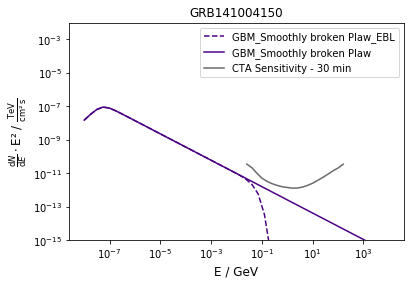

Start simulation for GRB101024486 with (random?) redshift =  0.751451505907
Start IRF part
Ready
11808.684635739839 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


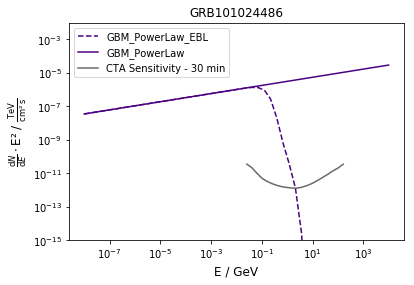

Start simulation for GRB110716018 with (random?) redshift =  2.97037530544
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


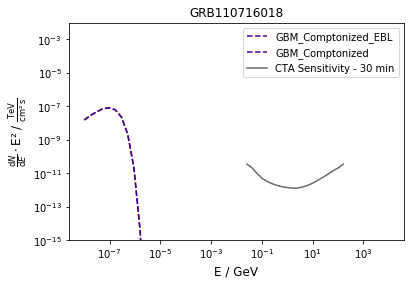

Start simulation for GRB130420422 with (random?) redshift =  1.85263067321
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


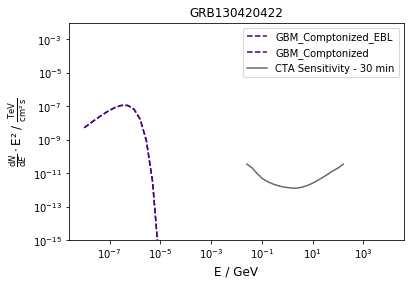

Start simulation for GRB081226044 with (random?) redshift =  2.22193251437
Start IRF part
Ready
88903.36923313196 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


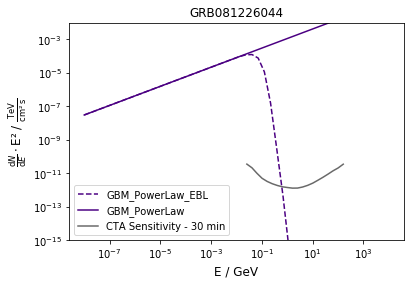

Start simulation for GRB171024977 with (random?) redshift =  1.25280100574
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


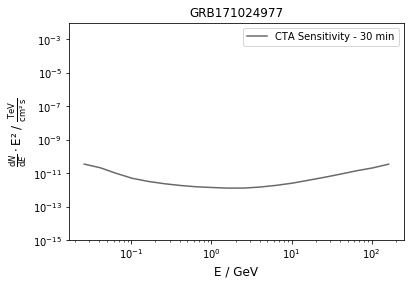

Start simulation for GRB090411838 with (random?) redshift =  3.26362550188
Start IRF part
Ready
10520.437173404087 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


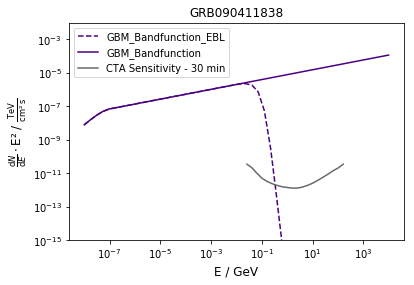

Start simulation for GRB160716144 with (random?) redshift =  0.475529997884
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


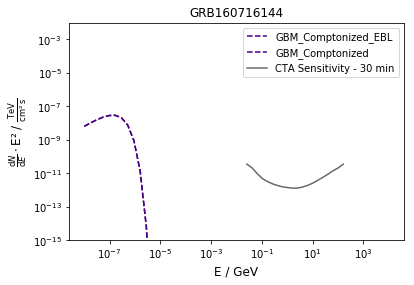

Start simulation for GRB090719063 with (random?) redshift =  2.28753476154
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


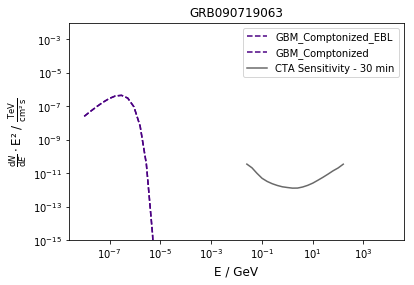

Start simulation for GRB100605774 with (random?) redshift =  0.916852103461
Start IRF part
Ready
38340.58958372874 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


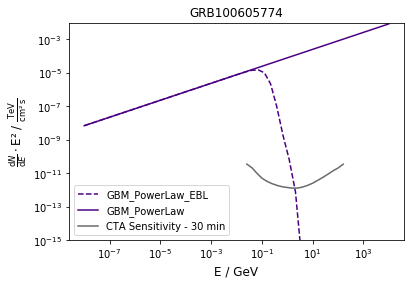

Start simulation for GRB110316139 with (random?) redshift =  2.4526269134
Start IRF part
Ready
90774.67316498463 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


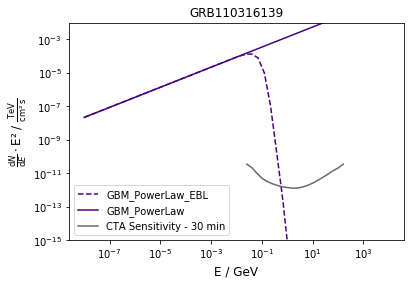

Start simulation for GRB081006604 with (random?) redshift =  3.9877340929
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


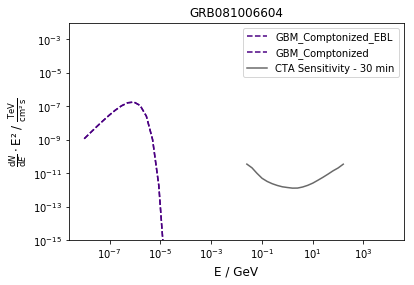

Start simulation for GRB120711115 with (random?) redshift =  2.49949910282
Start IRF part
Ready
127.99615874537622 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


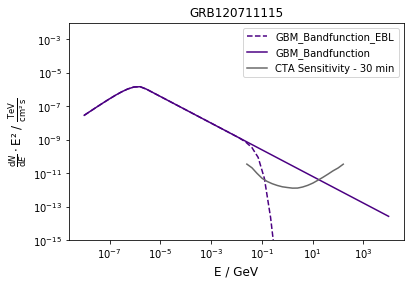

Start simulation for GRB090927422 with (random?) redshift =  7.04714480973
Start IRF part
Ready
36422.630247054105 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


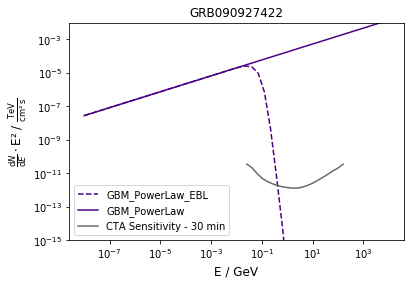

Start simulation for GRB140616165 with (random?) redshift =  1.39206653459
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


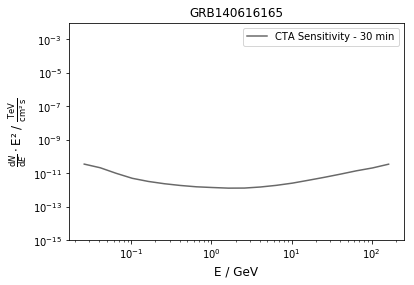

Start simulation for GRB090606471 with (random?) redshift =  2.68320126803
Start IRF part
Ready
14572.77830244857 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


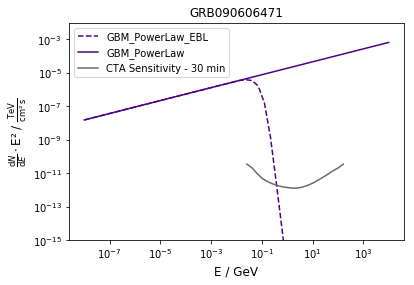

Start simulation for GRB130505955 with (random?) redshift =  2.56665119865
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


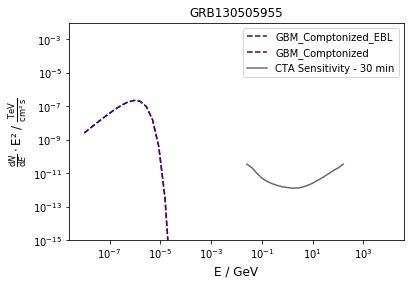

Start simulation for GRB171020813 with (random?) redshift =  1.93549679986
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


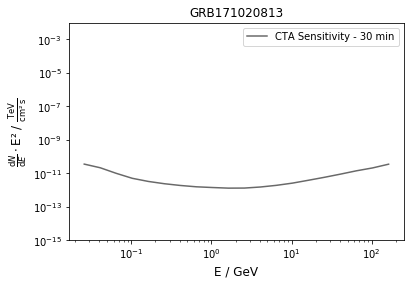

Start simulation for GRB080717543 with (random?) redshift =  0.955957086386
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


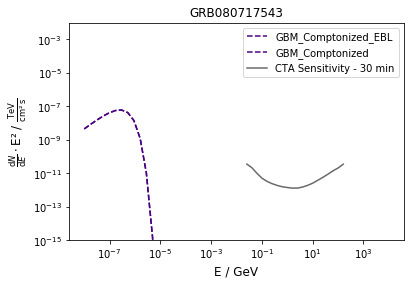

Start simulation for GRB100429999 with (random?) redshift =  2.16425902062
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


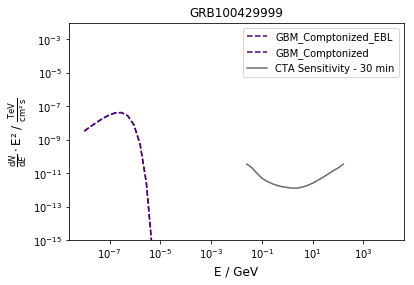

Start simulation for GRB120107384 with (random?) redshift =  2.44862848398
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


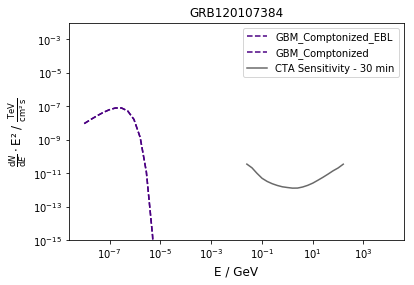

Start simulation for GRB141022061 with (random?) redshift =  2.9325690733
Start IRF part
Ready
7101.751369298254 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


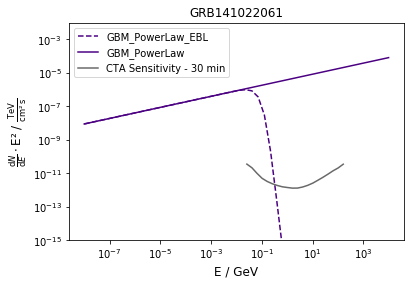

Start simulation for GRB170113420 with (random?) redshift =  2.24812873973
Start IRF part
Ready
1516.9670247521854 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


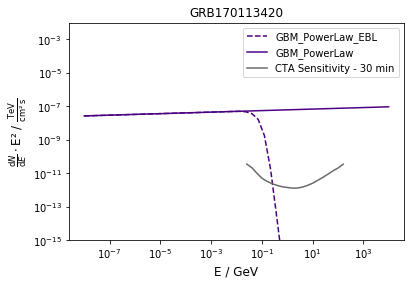

Start simulation for GRB120827216 with (random?) redshift =  4.05042912132
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


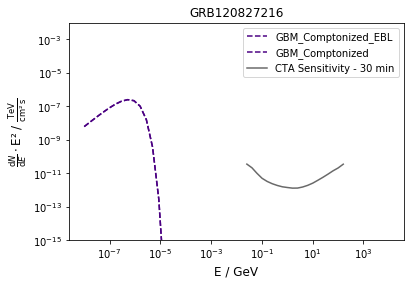

Start simulation for GRB100517639 with (random?) redshift =  1.06098475174
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


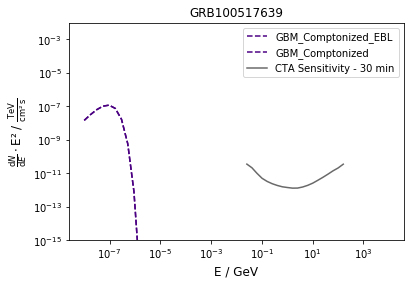

Start simulation for GRB090802666 with (random?) redshift =  3.41751404323
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


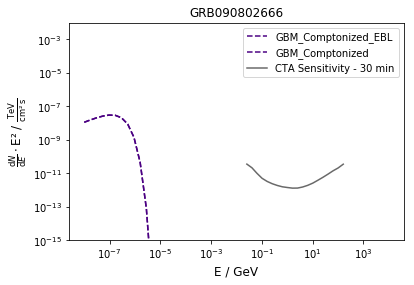

Start simulation for GRB110618366 with (random?) redshift =  2.73503312881
Start IRF part
Ready
1363.9815942752534 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


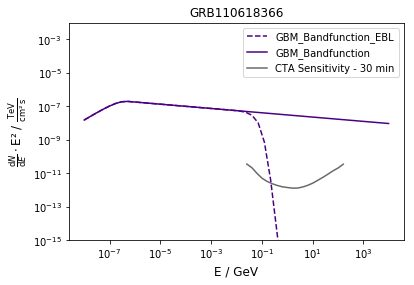

Start simulation for GRB090516137 with (random?) redshift =  1.52327617935
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


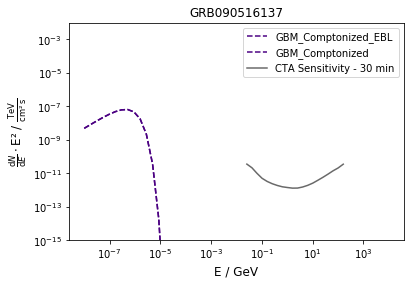

Start simulation for GRB130320560 with (random?) redshift =  5.0010772504
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


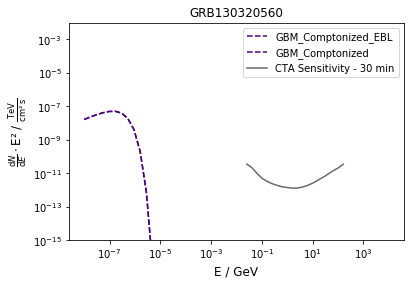

Start simulation for GRB091117080 with (random?) redshift =  1.16742841793
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


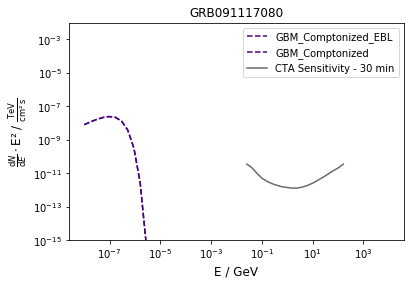

Start simulation for GRB110517453 with (random?) redshift =  3.61201153769
Start IRF part
Ready
170713.8585166643 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


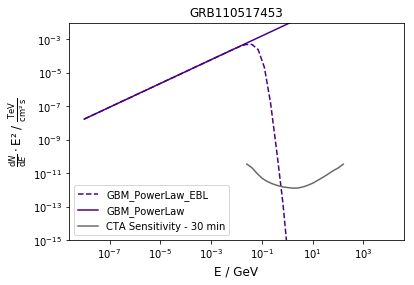

Start simulation for GRB170304003 with (random?) redshift =  2.36420431522
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


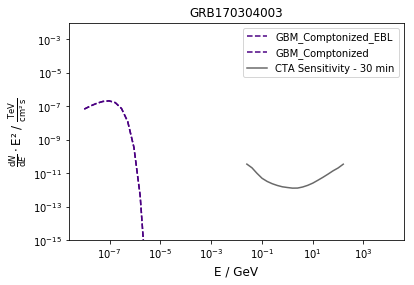

Start simulation for GRB140712973 with (random?) redshift =  1.06259630045
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


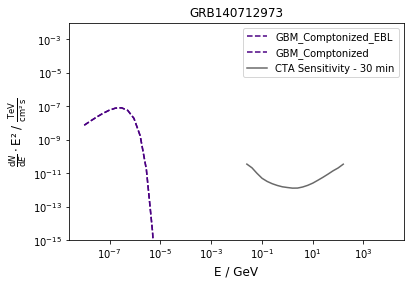

Start simulation for GRB090304216 with (random?) redshift =  2.27380017395
Start IRF part
Ready
43796.97061548983 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


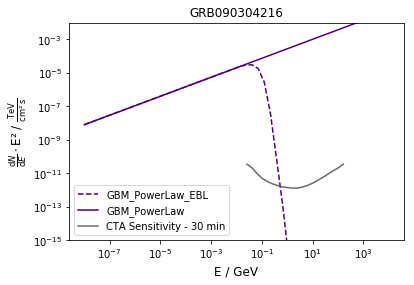

Start simulation for GRB151026523 with (random?) redshift =  1.03313690621
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


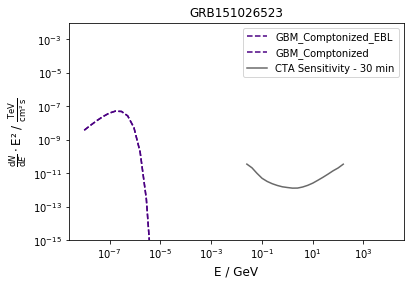

Start simulation for GRB160625230 with (random?) redshift =  1.91159106646
Start IRF part
Ready
8111.535768852418 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


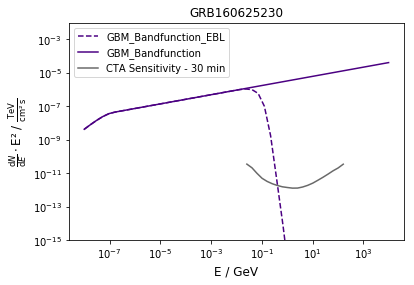

Start simulation for GRB100604287 with (random?) redshift =  2.99434186597
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


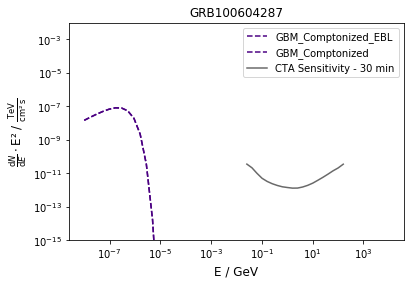

Start simulation for GRB130727698 with (random?) redshift =  1.88397301843
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


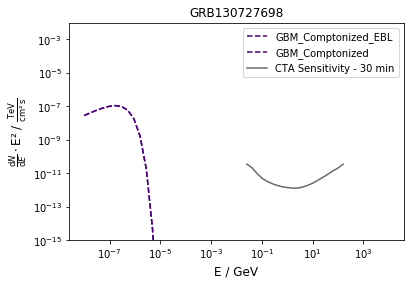

Start simulation for GRB101023951 with (random?) redshift =  0.289497443799
Start IRF part
Ready
452.3087482311868 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


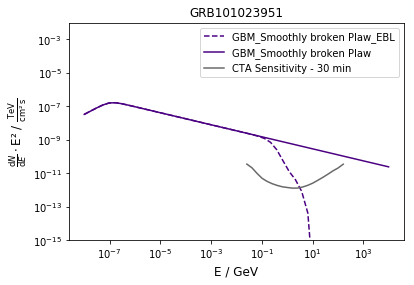

Start simulation for GRB170827818 with (random?) redshift =  0.385736803652
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


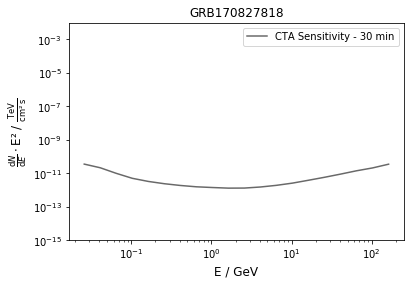

Start simulation for GRB161105417 with (random?) redshift =  1.99473694266
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


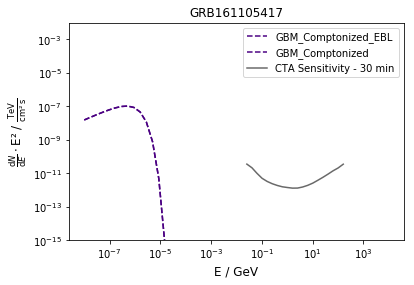

Start simulation for GRB170210116 with (random?) redshift =  2.74146398012
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


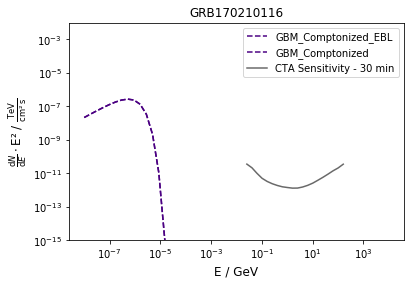

Start simulation for GRB090602564 with (random?) redshift =  0.753618257351
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


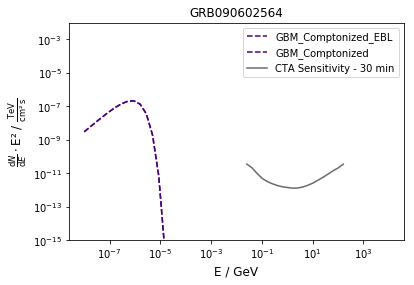

Start simulation for GRB090924625 with (random?) redshift =  1.95903414227
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


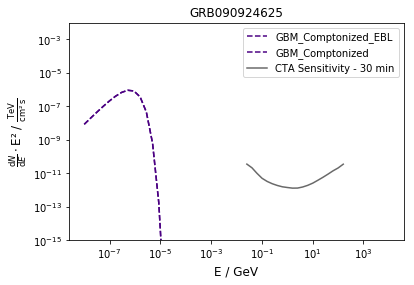

Start simulation for GRB110411629 with (random?) redshift =  2.21276118416
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


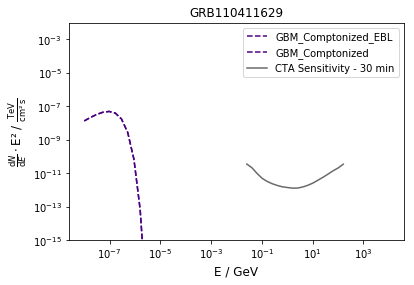

Start simulation for GRB151003729 with (random?) redshift =  0.562965863516
Start IRF part
Ready
24412.70201824978 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


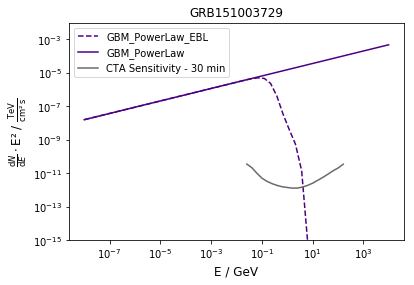

Start simulation for GRB090926181 with (random?) redshift =  0.58606245142
Start IRF part
Ready
1404.2584565010443 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


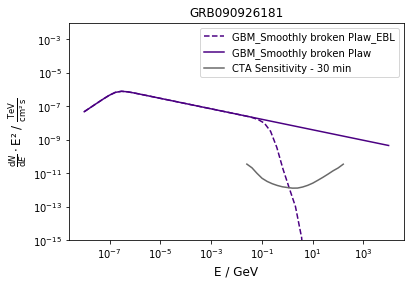

Start simulation for GRB150628767 with (random?) redshift =  3.03028029848
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


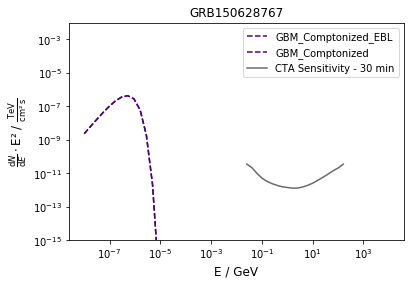

Start simulation for GRB120919816 with (random?) redshift =  0.963132125476
Start IRF part
Ready
5831.859600674993 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


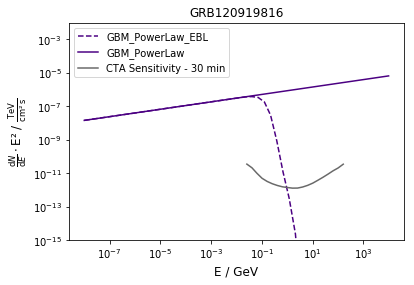

Start simulation for GRB101011707 with (random?) redshift =  4.59591781175
Start IRF part
Ready
41177.71686167538 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


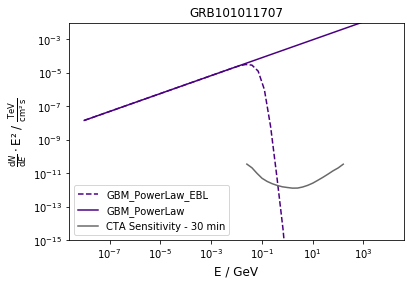

Start simulation for GRB090625560 with (random?) redshift =  0.513953302356
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


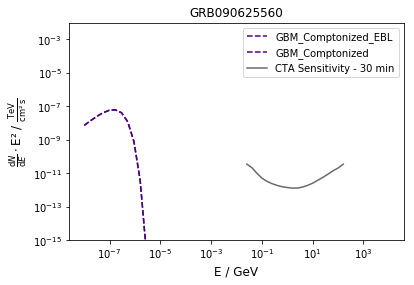

Start simulation for GRB160303971 with (random?) redshift =  1.5031822242
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


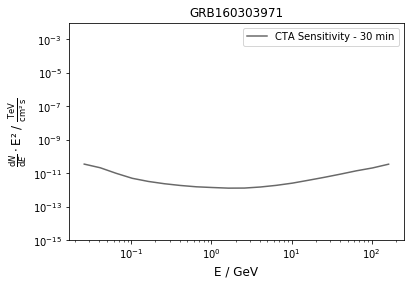

Start simulation for GRB120426090 with (random?) redshift =  0.881912833266
Start IRF part
Ready
14.149201363049254 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


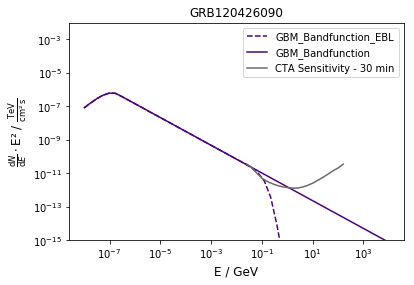

Start simulation for GRB140612294 with (random?) redshift =  2.6029710116
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


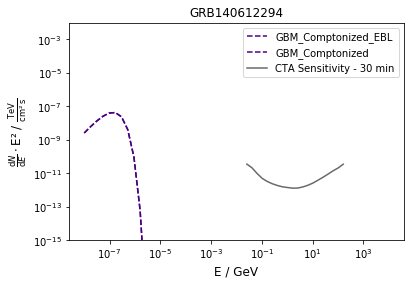

Start simulation for GRB151117442 with (random?) redshift =  4.42615143052
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


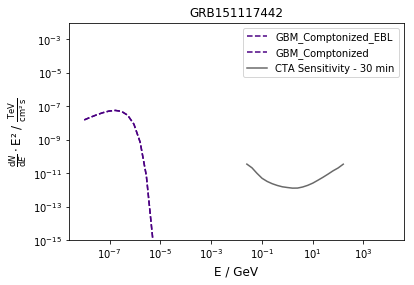

Start simulation for GRB150204272 with (random?) redshift =  2.91437143142
Start IRF part
Ready
11634.965910945533 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


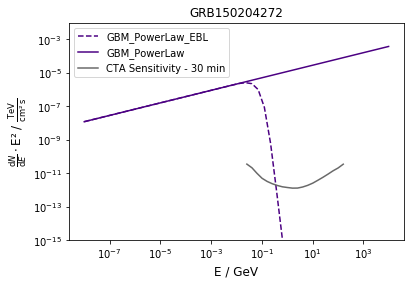

Start simulation for GRB110818860 with (random?) redshift =  1.77750275737
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


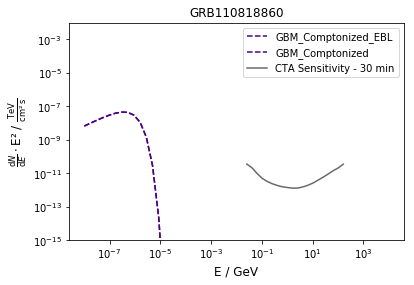

Start simulation for GRB170127067 with (random?) redshift =  11.6717576903
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


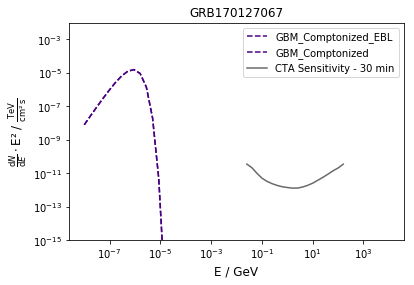

Start simulation for GRB140508179 with (random?) redshift =  2.59559439043
Start IRF part
Ready
11335.522193779103 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


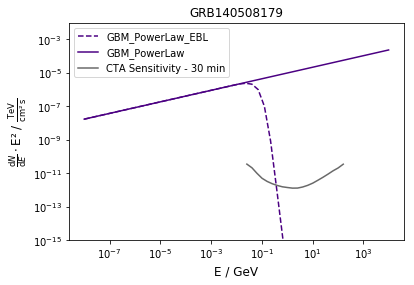

Start simulation for GRB130523198 with (random?) redshift =  3.8956323326
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


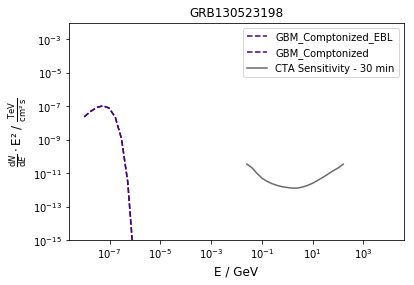

Start simulation for GRB131105087 with (random?) redshift =  1.05065384311
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


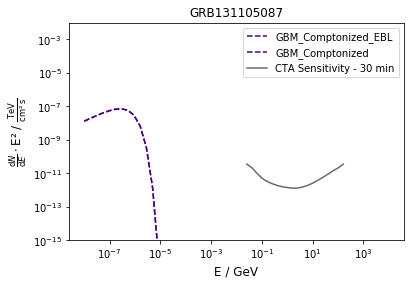

Start simulation for GRB150301818 with (random?) redshift =  1.96323884303
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


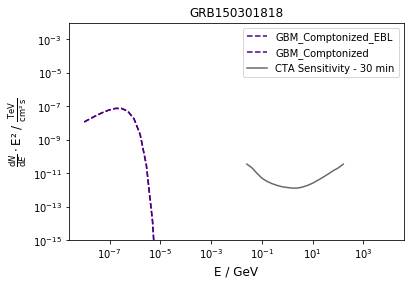

Start simulation for GRB090510325 with (random?) redshift =  5.0970882959
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


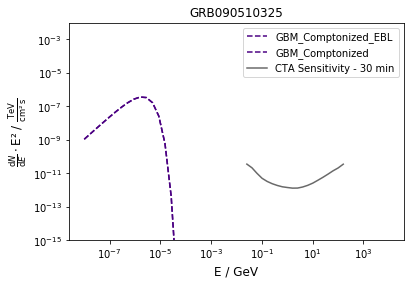

Start simulation for GRB150821406 with (random?) redshift =  2.12729788744
Start IRF part
Ready
1031.2189250946753 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


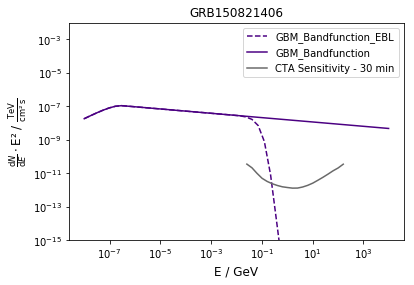

Start simulation for GRB140330180 with (random?) redshift =  0.148284646382
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


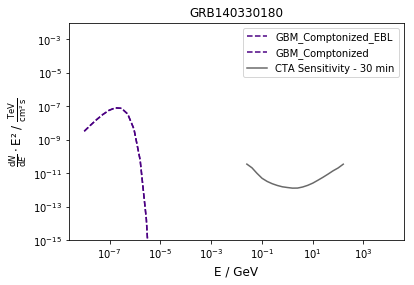

Start simulation for GRB091031500 with (random?) redshift =  1.56986757967
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


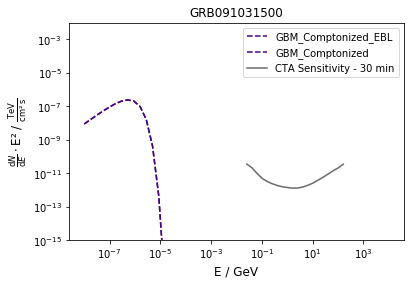

Start simulation for GRB081008832 with (random?) redshift =  2.08495551369
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


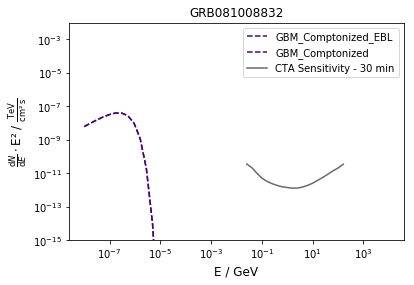

Start simulation for GRB120220210 with (random?) redshift =  1.4075796914
Start IRF part
Ready
16848.254028872587 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


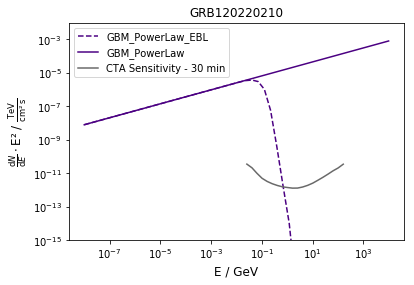

Start simulation for GRB141222298 with (random?) redshift =  4.59511915269
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


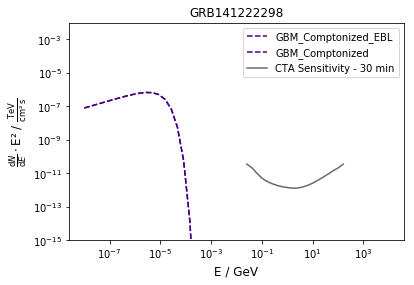

Start simulation for GRB140716436 with (random?) redshift =  1.31339953493
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


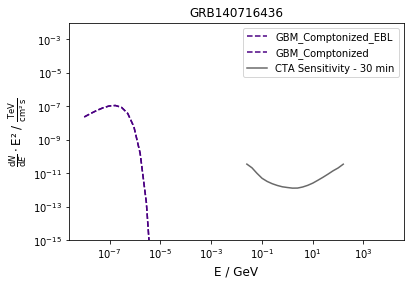

Start simulation for GRB130701060 with (random?) redshift =  2.97797124448
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


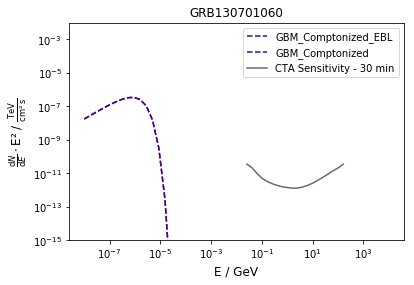

Start simulation for GRB130617564 with (random?) redshift =  0.384262986704
Start IRF part
Ready
152343.44002888858 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


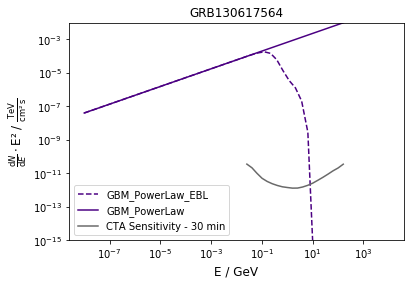

Start simulation for GRB160912350 with (random?) redshift =  3.35770783596
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


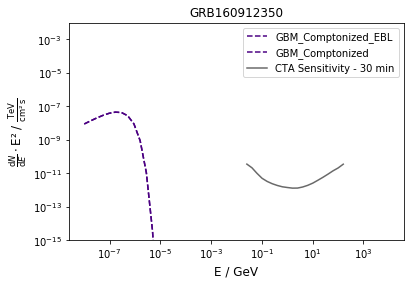

Start simulation for GRB150827785 with (random?) redshift =  2.35104946847
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


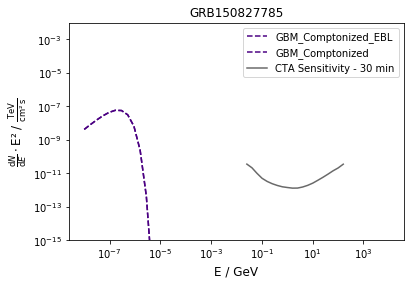

Start simulation for GRB171112868 with (random?) redshift =  0.486916966111
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


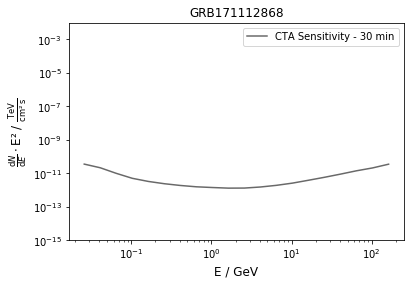

Start simulation for GRB120909070 with (random?) redshift =  1.88770719106
Start IRF part
Ready
2395.66827241838 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


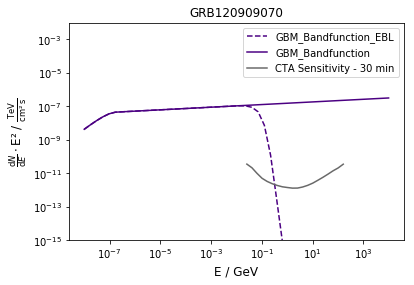

Start simulation for GRB100225115 with (random?) redshift =  1.42643726518
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


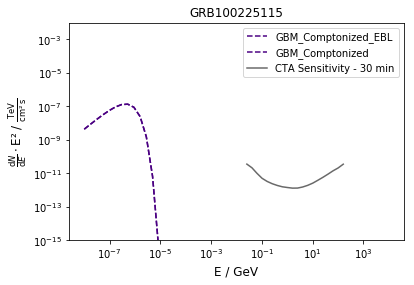

Start simulation for GRB140115863 with (random?) redshift =  0.0620891408944
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


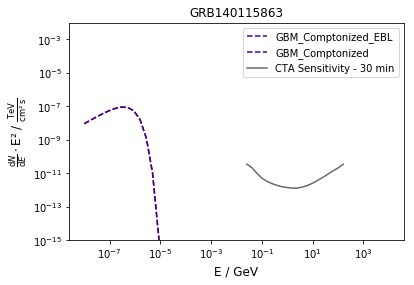

Start simulation for GRB120119229 with (random?) redshift =  1.39274871699
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


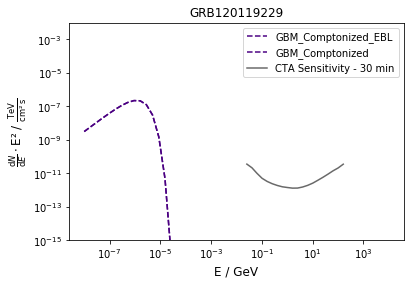

Start simulation for GRB080719529 with (random?) redshift =  3.01890715788
Start IRF part
Ready
10114.27924306401 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


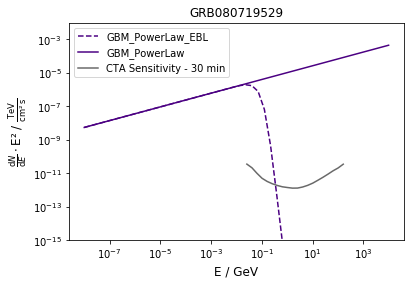

Start simulation for GRB120304061 with (random?) redshift =  0.21019869729
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


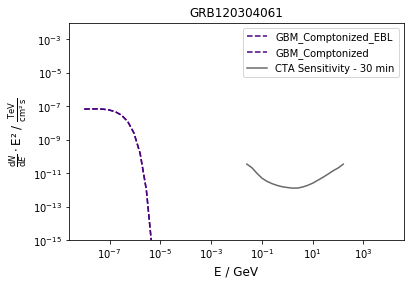

Start simulation for GRB081006872 with (random?) redshift =  5.72190981435
Start IRF part
Ready
26025.28517710059 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


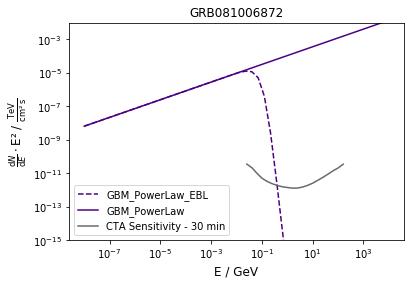

Start simulation for GRB150514774 with (random?) redshift =  3.70787044913
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


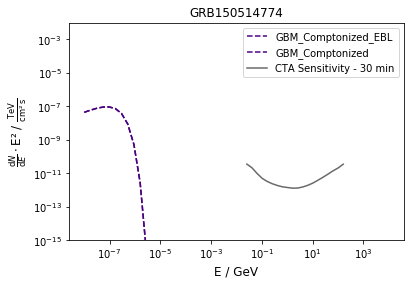

Start simulation for GRB091231206 with (random?) redshift =  4.41536941137
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


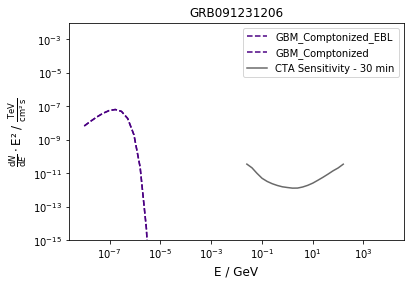

Start simulation for GRB161106786 with (random?) redshift =  1.6735967465
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


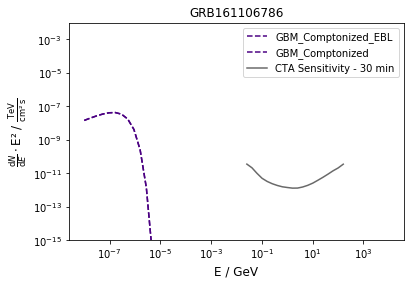

Start simulation for GRB160223670 with (random?) redshift =  2.28294096668
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


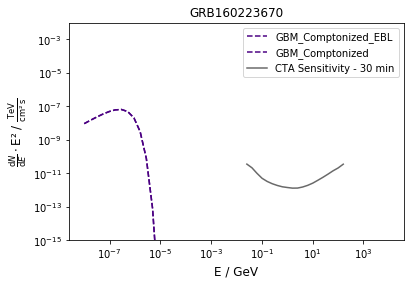

Start simulation for GRB150820880 with (random?) redshift =  4.54242209923
Start IRF part
Ready
27128.803384579933 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


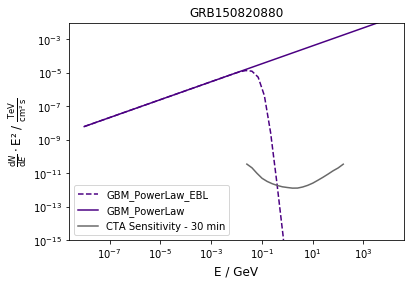

Start simulation for GRB130919985 with (random?) redshift =  1.71858598555
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


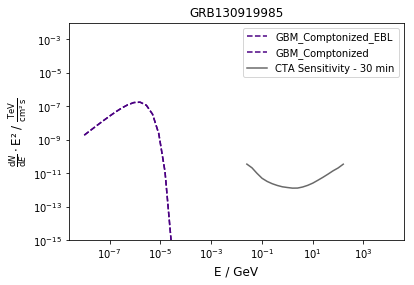

Start simulation for GRB160227831 with (random?) redshift =  1.76975700853
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


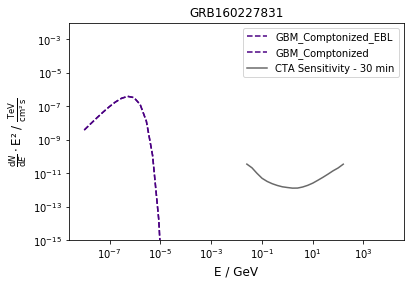

Start simulation for GRB120212353 with (random?) redshift =  0.972034494158
Start IRF part
Ready
1137196.2395480818 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


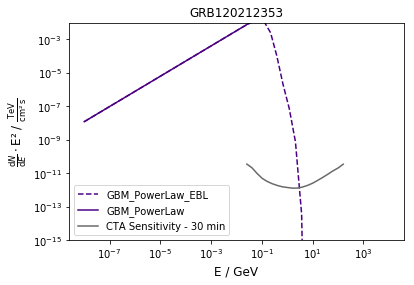

Start simulation for GRB150322066 with (random?) redshift =  0.711130090644
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


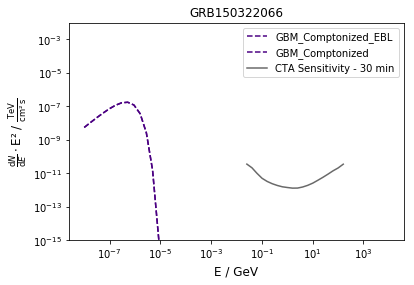

Start simulation for GRB151114645 with (random?) redshift =  2.53156348449
Start IRF part
Ready
31122.815812142642 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


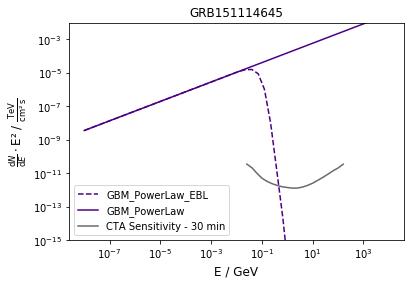

Start simulation for GRB100204024 with (random?) redshift =  2.2099542998
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


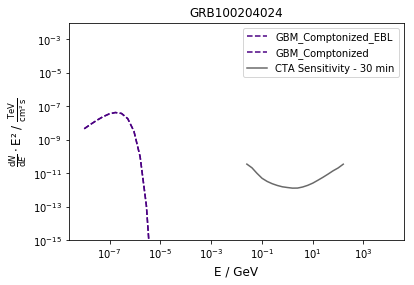

Start simulation for GRB090805622 with (random?) redshift =  3.24645821699
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


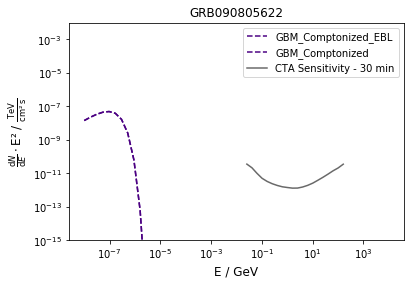

Start simulation for GRB160905471 with (random?) redshift =  1.67298839902
Start IRF part
Ready
68.21740301372809 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


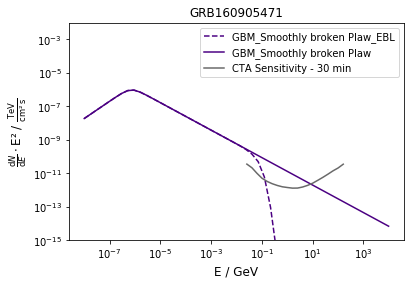

Start simulation for GRB110706477 with (random?) redshift =  2.53318744121
Start IRF part
Ready
6650.79182710514 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


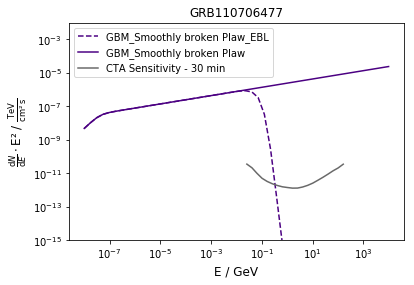

Start simulation for GRB081215880 with (random?) redshift =  1.18153649694
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


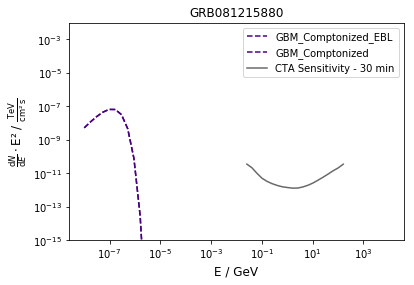

Start simulation for GRB150922883 with (random?) redshift =  3.79971022743
Start IRF part
Ready
11840.454236603216 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


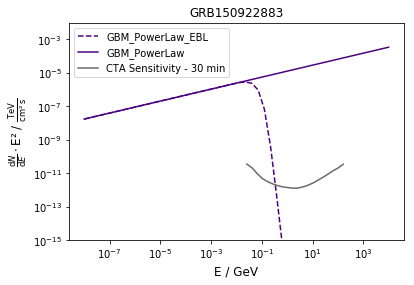

Start simulation for GRB140608153 with (random?) redshift =  2.42604528906
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


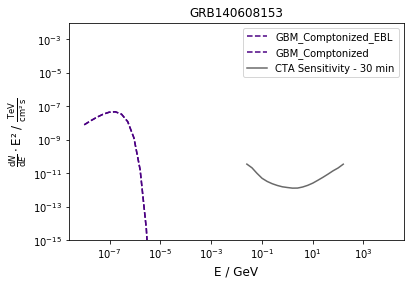

Start simulation for GRB091207333 with (random?) redshift =  1.83391820471
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


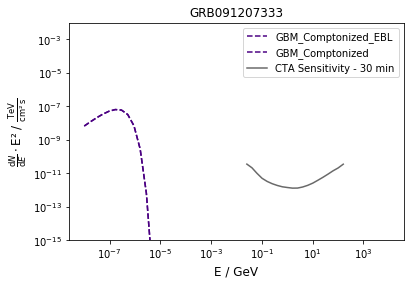

Start simulation for GRB120709883 with (random?) redshift =  2.44967449619
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


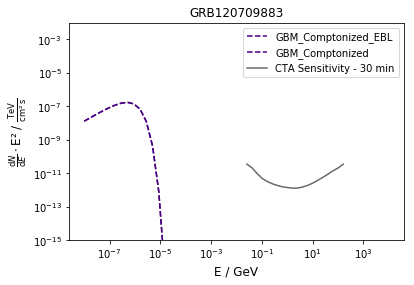

Start simulation for GRB120304248 with (random?) redshift =  2.43494089563
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


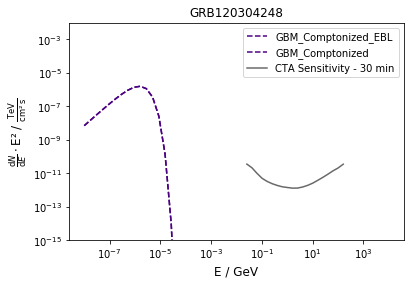

Start simulation for GRB110125894 with (random?) redshift =  1.68643915316
Start IRF part
Ready
2047.0584231770044 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


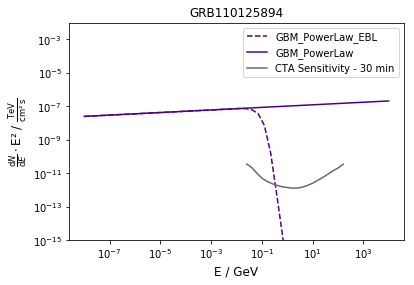

Start simulation for GRB150222450 with (random?) redshift =  0.759879122089
Start IRF part
Ready
7321.344875891223 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


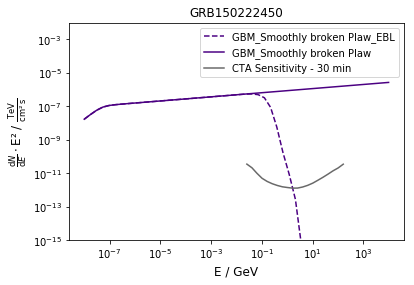

Start simulation for GRB100718160 with (random?) redshift =  0.809744290869
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


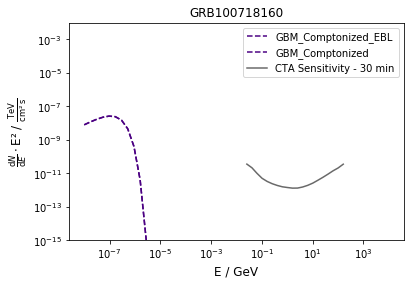

Start simulation for GRB161128216 with (random?) redshift =  5.14388497976
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


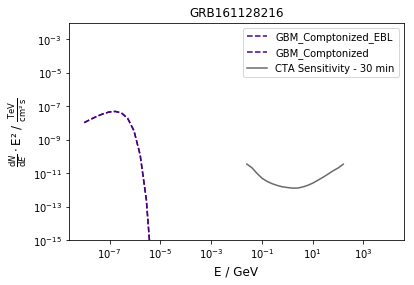

Start simulation for GRB100918863 with (random?) redshift =  1.34902415176
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


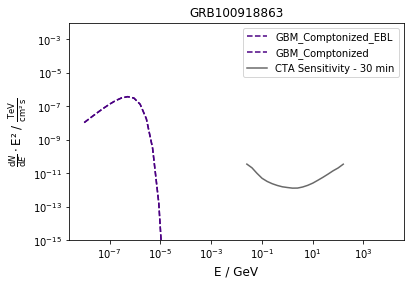

Start simulation for GRB170402961 with (random?) redshift =  2.26390803984
Start IRF part
Ready
16637.948724157683 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


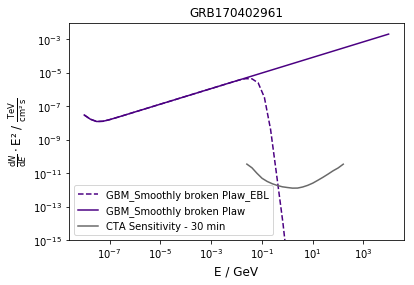

Start simulation for GRB120728434 with (random?) redshift =  0.374714352606
Start IRF part
Ready
0.42678209655026306 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


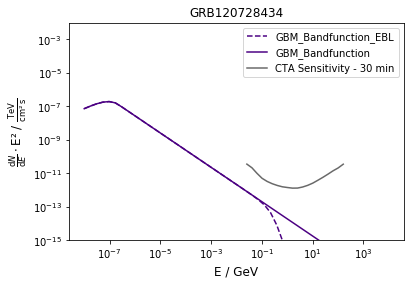

Start simulation for GRB130906435 with (random?) redshift =  0.77888275624
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


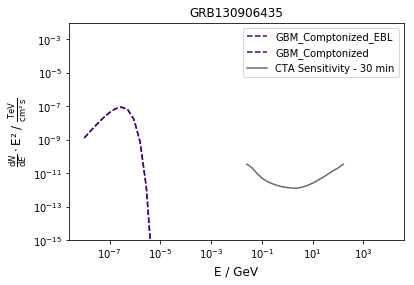

Start simulation for GRB080804972 with (random?) redshift =  2.05335975628
Start IRF part
Ready
3333.1907416939457 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


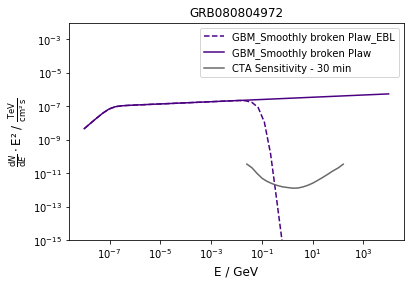

Start simulation for GRB100204566 with (random?) redshift =  3.76839109979
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


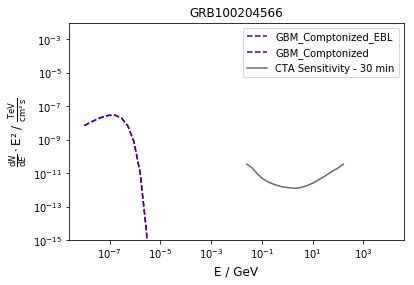

Start simulation for GRB141215560 with (random?) redshift =  2.71575838055
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


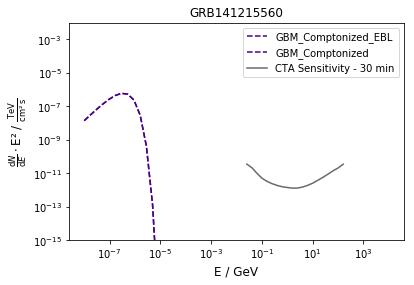

Start simulation for GRB120521380 with (random?) redshift =  0.335913227603
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


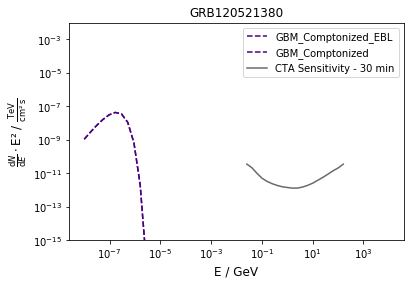

Start simulation for GRB100313288 with (random?) redshift =  2.03437979287
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


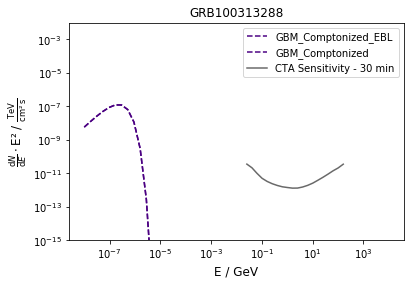

Start simulation for GRB141122875 with (random?) redshift =  1.83498010841
Start IRF part
Ready
0.05288244686857345 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


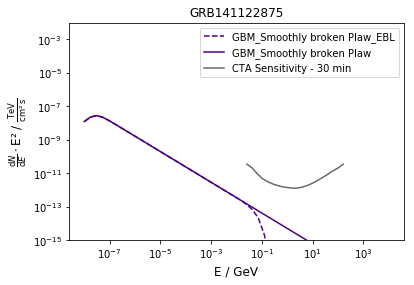

Start simulation for GRB150508945 with (random?) redshift =  1.42956509271
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


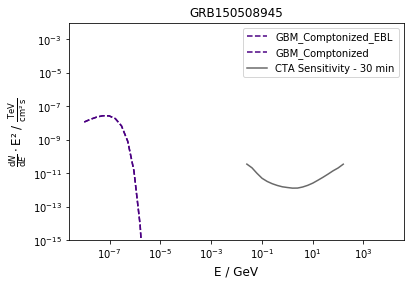

Start simulation for GRB161020024 with (random?) redshift =  2.10290925868
Start IRF part
Ready
5385.6155358544365 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


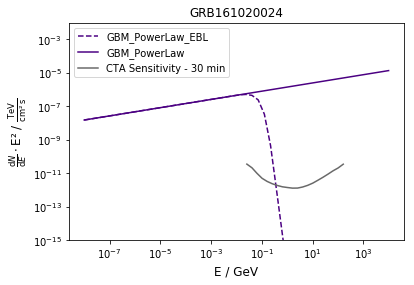

Start simulation for GRB100715477 with (random?) redshift =  2.447485194
Start IRF part
Ready
11573.932967862609 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


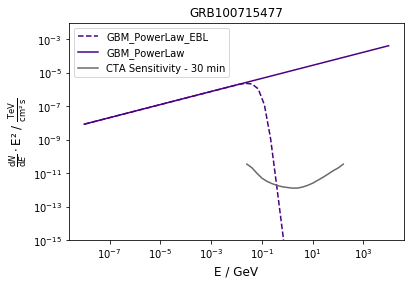

Start simulation for GRB081109293 with (random?) redshift =  1.15870840259
Start IRF part
Ready
17213.600351820613 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


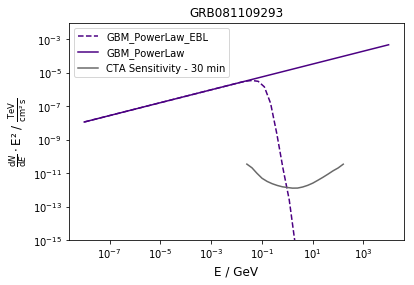

Start simulation for GRB120728934 with (random?) redshift =  0.819257168796
Start IRF part
Ready
4837.886387182919 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


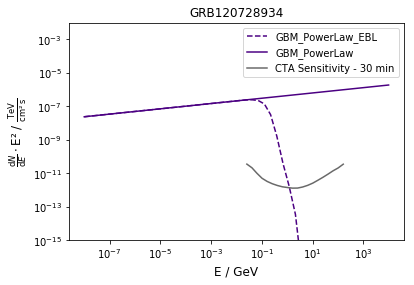

Start simulation for GRB160513553 with (random?) redshift =  1.19841343378
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


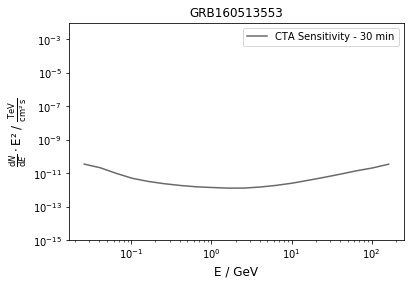

Start simulation for GRB171010875 with (random?) redshift =  0.286178002573
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


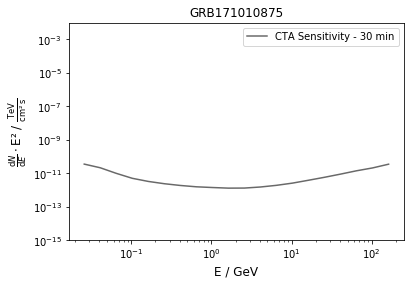

Start simulation for GRB100201588 with (random?) redshift =  2.89858365348
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


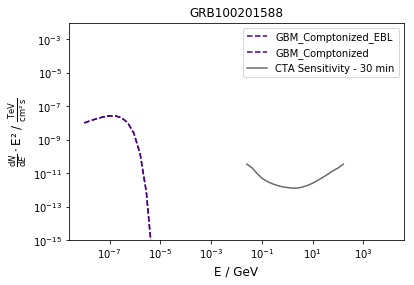

Start simulation for GRB090308734 with (random?) redshift =  4.34876108168
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


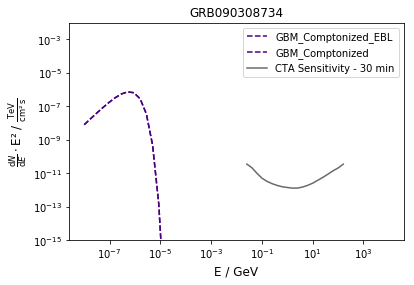

Start simulation for GRB130515056 with (random?) redshift =  2.82086825011
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


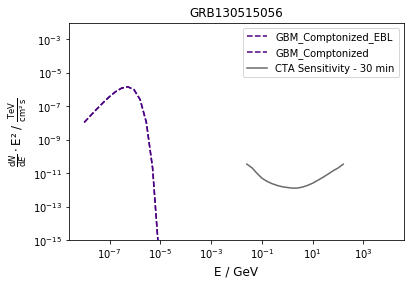

Start simulation for GRB111009282 with (random?) redshift =  1.46713072348
Start IRF part
Ready
405.5051353415448 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


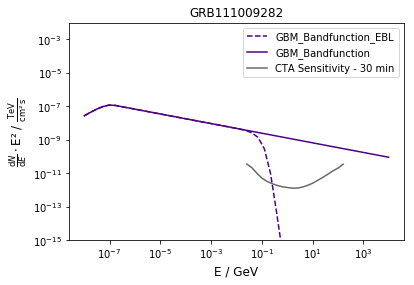

Start simulation for GRB150824079 with (random?) redshift =  1.48295944519
Start IRF part
Ready
275.21395112891895 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


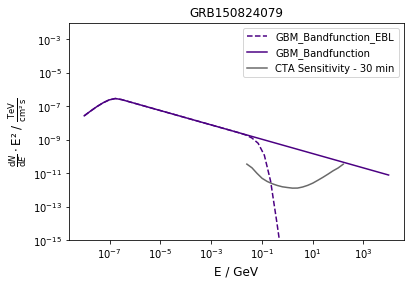

Start simulation for GRB090519462 with (random?) redshift =  1.07630826102
Start IRF part
Ready
13911.703670279541 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


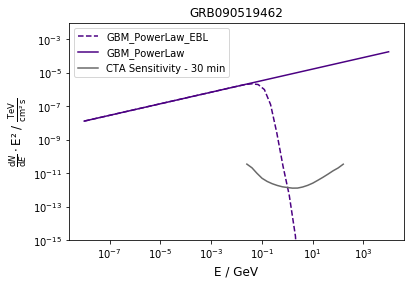

Start simulation for GRB080916009 with (random?) redshift =  4.61313501888
Start IRF part
Ready
2098.937681158039 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


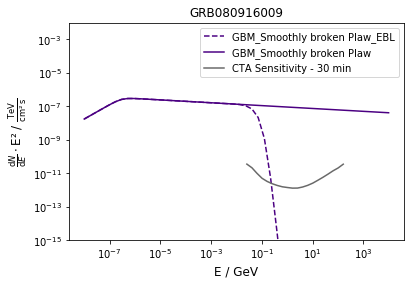

Start simulation for GRB100825287 with (random?) redshift =  3.23785192205
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


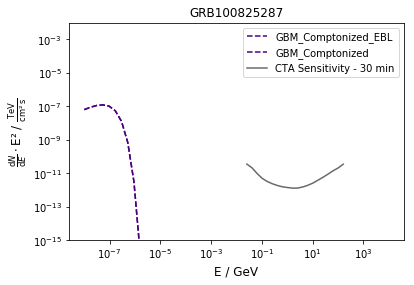

Start simulation for GRB120316008 with (random?) redshift =  0.208109977505
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


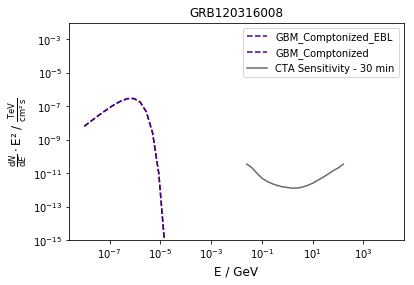

Start simulation for GRB161228388 with (random?) redshift =  1.71705106334
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


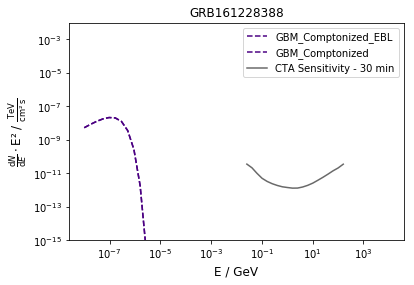

Start simulation for GRB111220486 with (random?) redshift =  4.20966340457
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


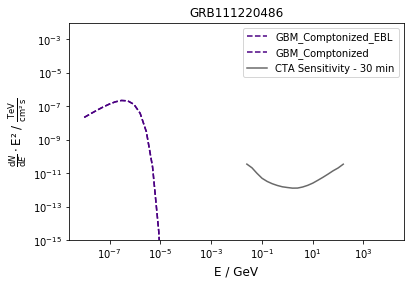

Start simulation for GRB141011467 with (random?) redshift =  2.39044387828
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


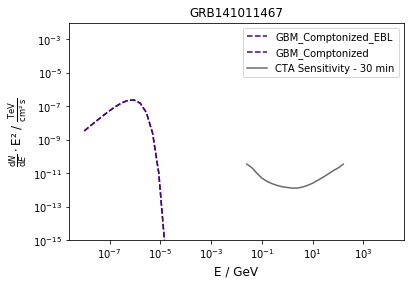

Start simulation for GRB150324164 with (random?) redshift =  1.48246309808
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


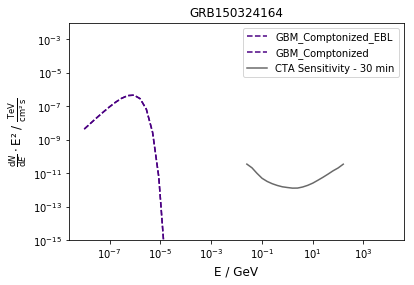

Start simulation for GRB151210041 with (random?) redshift =  3.33397213463
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


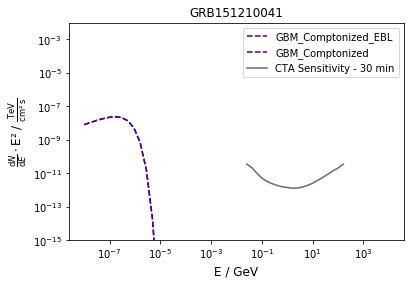

Start simulation for GRB121109338 with (random?) redshift =  1.08639694059
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


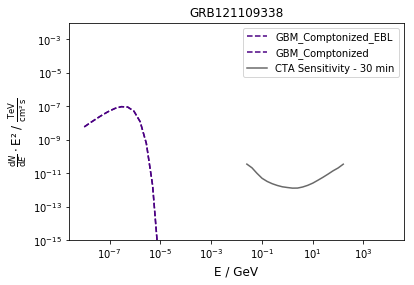

Start simulation for GRB080823363 with (random?) redshift =  1.12756674852
Start IRF part
Ready
23114.166448762215 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


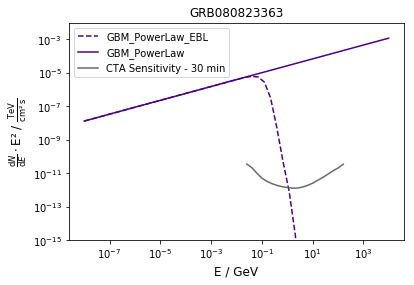

Start simulation for GRB130404840 with (random?) redshift =  0.378161474416
Start IRF part
Ready
28000.9764382861 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


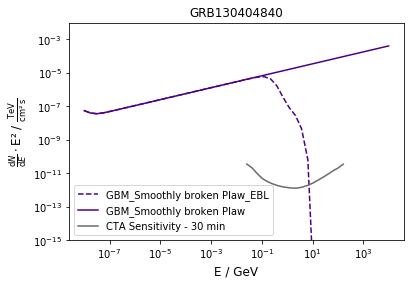

Start simulation for GRB090610723 with (random?) redshift =  0.856794971128
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


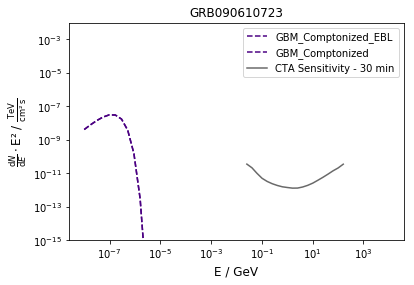

Start simulation for GRB090701225 with (random?) redshift =  0.191393271999
Start IRF part
Ready
6924.164082540495 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


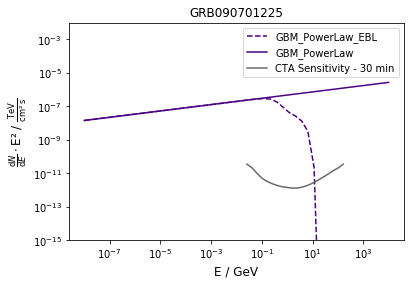

Start simulation for GRB150418819 with (random?) redshift =  3.66463450225
Start IRF part
Ready
1403.6033522014661 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


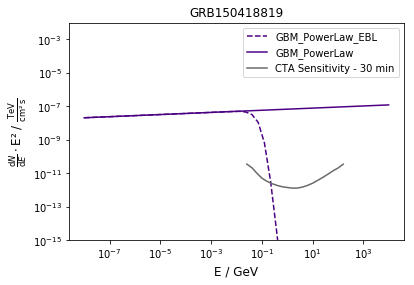

Start simulation for GRB120719146 with (random?) redshift =  1.87951779073
Start IRF part
Ready
3360.574669383546 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


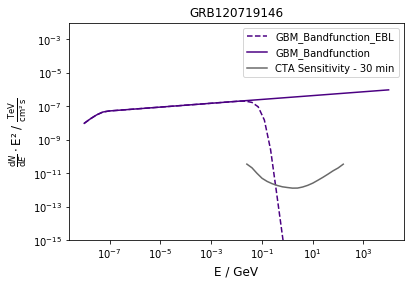

Start simulation for GRB081118876 with (random?) redshift =  1.46668823668
Start IRF part
Ready
215.4121476986898 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


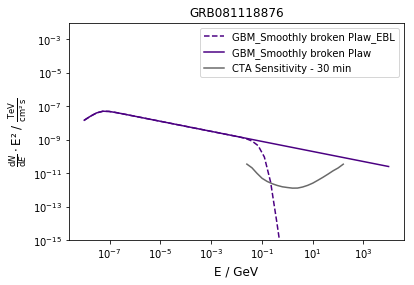

Start simulation for GRB090320045 with (random?) redshift =  0.20241740577
Start IRF part
Ready
72942.32848973275 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


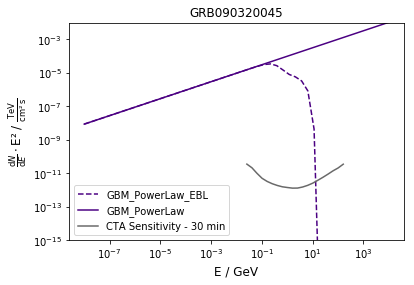

Start simulation for GRB090623107 with (random?) redshift =  3.1680896753
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


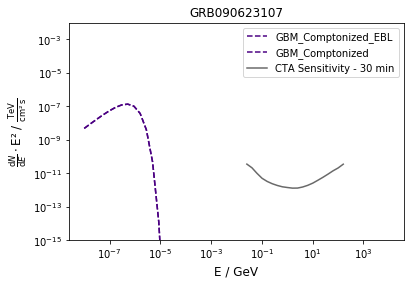

Start simulation for GRB111103948 with (random?) redshift =  0.955225338398
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


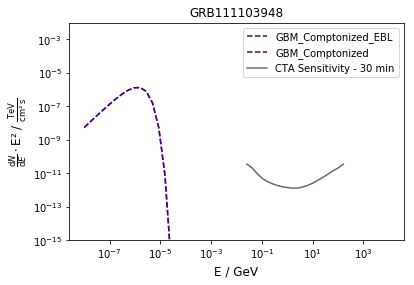

Start simulation for GRB090620901 with (random?) redshift =  5.04623974089
Start IRF part
Ready
104339.93100610629 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


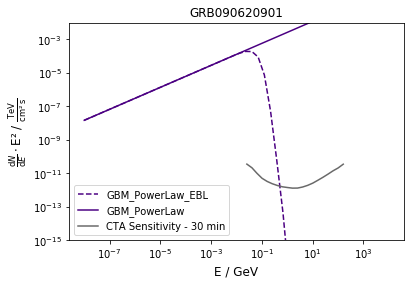

Start simulation for GRB090227310 with (random?) redshift =  2.97367676057
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


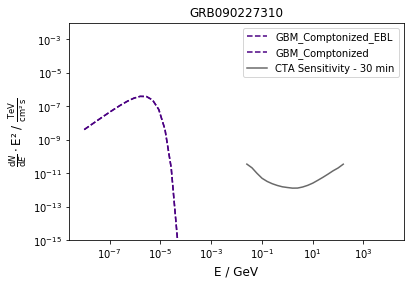

Start simulation for GRB110511616 with (random?) redshift =  1.09423713835
Start IRF part
Ready
6844.761474140419 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


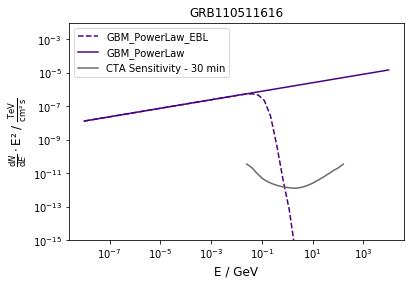

Start simulation for GRB170301812 with (random?) redshift =  0.191540652064
Start IRF part
Ready
57787.63860418607 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


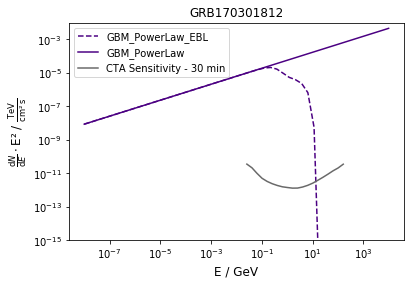

Start simulation for GRB120323162 with (random?) redshift =  0.926703737086
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


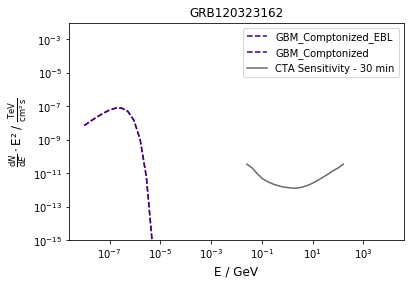

Start simulation for GRB170424425 with (random?) redshift =  0.388352584114
Start IRF part
Ready
1742.0722859983455 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


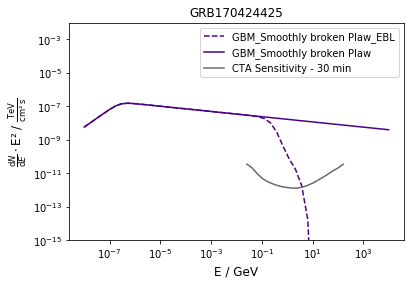

Start simulation for GRB111024722 with (random?) redshift =  0.543713602345
Start IRF part
Ready
955.9904296241077 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


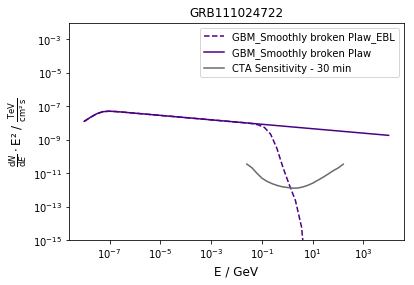

Start simulation for GRB120611108 with (random?) redshift =  2.60828773595
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


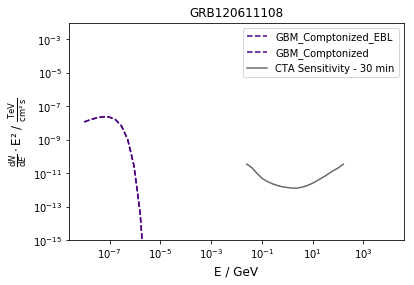

Start simulation for GRB150305724 with (random?) redshift =  3.17549783052
Start IRF part
Ready
122555.79280378109 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


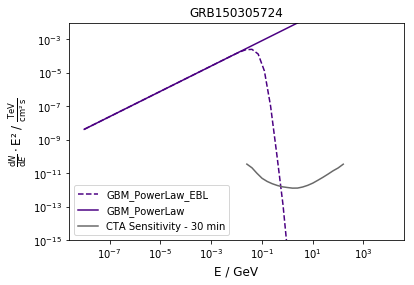

Start simulation for GRB140817229 with (random?) redshift =  1.86446018855
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


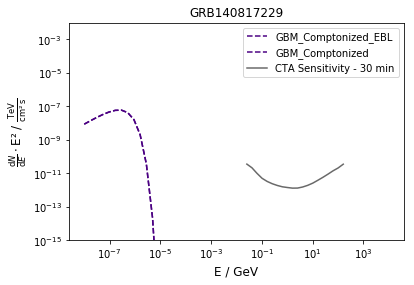

Start simulation for GRB110817191 with (random?) redshift =  2.94427825686
Start IRF part
Ready
6278.521723234392 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


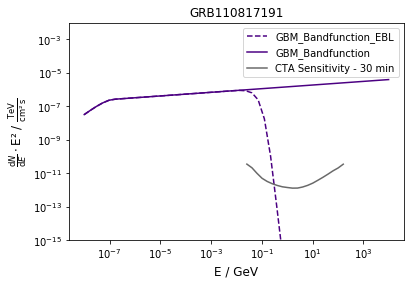

Start simulation for GRB141112539 with (random?) redshift =  4.70167740416
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


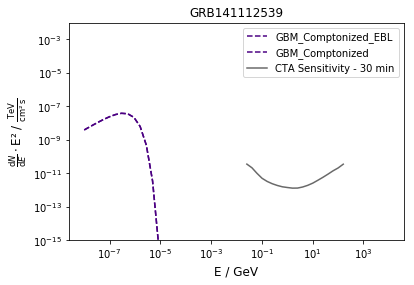

Start simulation for GRB090427644 with (random?) redshift =  2.79453389846
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


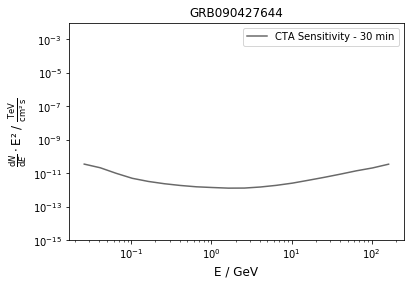

Start simulation for GRB120701654 with (random?) redshift =  0.955218710634
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


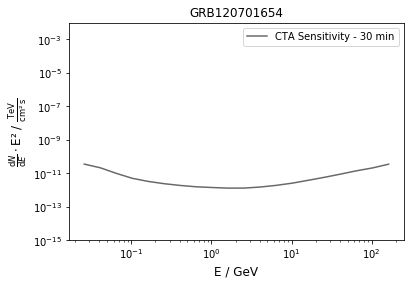

Start simulation for GRB110228011 with (random?) redshift =  2.02370502935
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


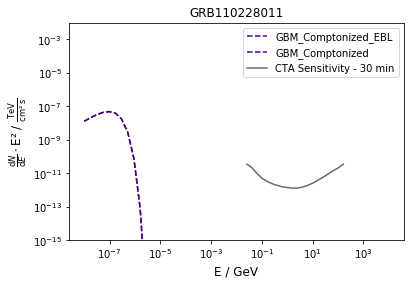

Start simulation for GRB120926753 with (random?) redshift =  1.82699281031
Start IRF part
Ready
48377.3946988296 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


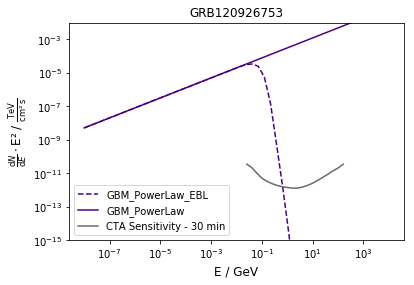

Start simulation for GRB120919309 with (random?) redshift =  0.870377293803
Start IRF part
Ready
2145.006176995945 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


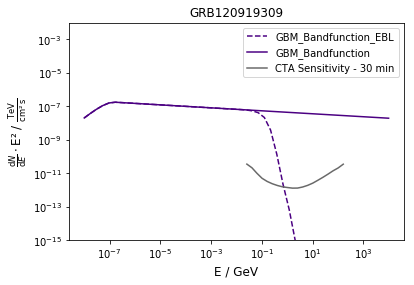

Start simulation for GRB120319983 with (random?) redshift =  2.24140914076
Start IRF part
Ready
34744.58995994489 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


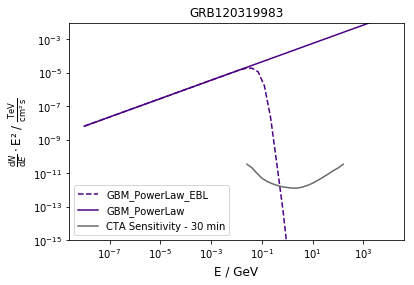

Start simulation for GRB150523396 with (random?) redshift =  2.27767193714
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


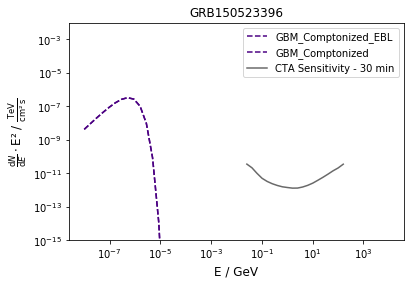

Start simulation for GRB161119633 with (random?) redshift =  1.91326973933
Start IRF part
Ready
49.37136356091235 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


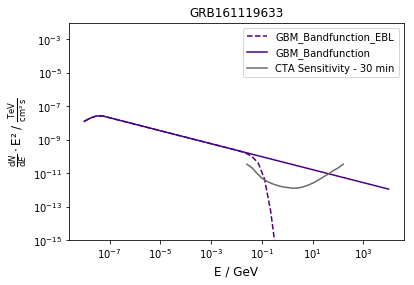

Start simulation for GRB170906030 with (random?) redshift =  1.39599282207
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


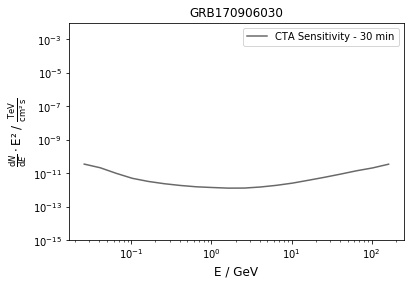

Start simulation for GRB141102536 with (random?) redshift =  4.42526275496
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


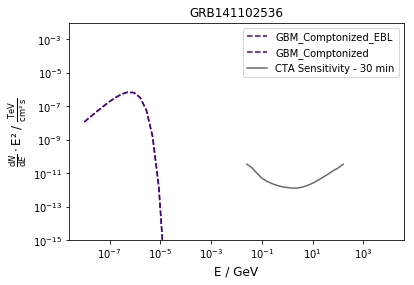

Start simulation for GRB090706283 with (random?) redshift =  0.761737669554
Start IRF part
Ready
4635.098213508727 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


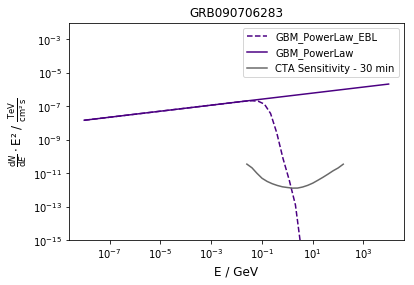

Start simulation for GRB171119992 with (random?) redshift =  1.42241113651
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


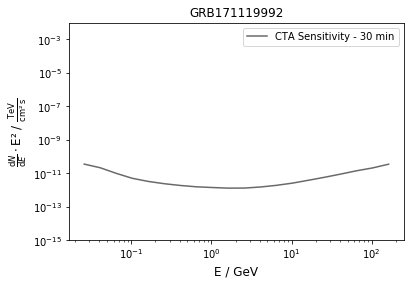

Start simulation for GRB170115743 with (random?) redshift =  2.36165254012
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


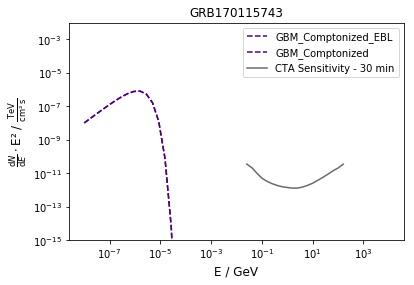

Start simulation for GRB170208758 with (random?) redshift =  0.28365246525
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


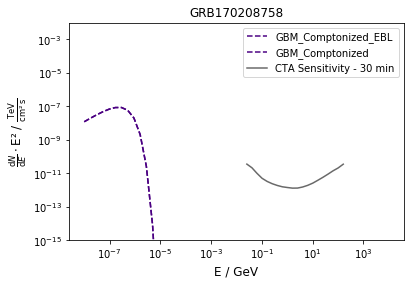

Start simulation for GRB150604284 with (random?) redshift =  3.23117103469
Start IRF part
Ready
52217.63307155953 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


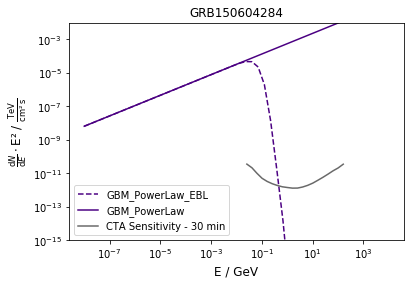

Start simulation for GRB121225417 with (random?) redshift =  4.54573971386
Start IRF part
Ready
982.8728788468757 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


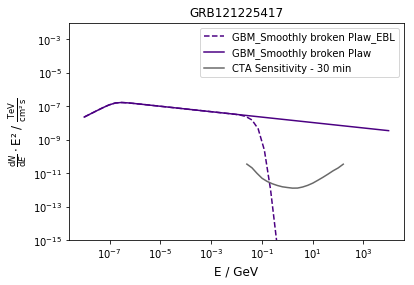

Start simulation for GRB160225809 with (random?) redshift =  1.57944494569
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


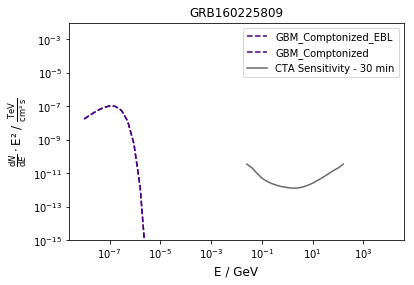

Start simulation for GRB100910818 with (random?) redshift =  0.421808406441
Start IRF part
Ready
398.58419304509044 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


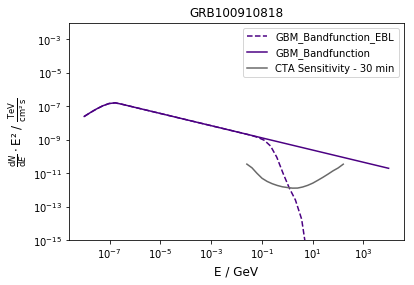

Start simulation for GRB090427688 with (random?) redshift =  3.11733887433
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


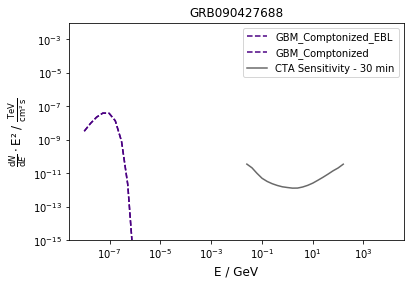

Start simulation for GRB101219686 with (random?) redshift =  1.29560136096
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


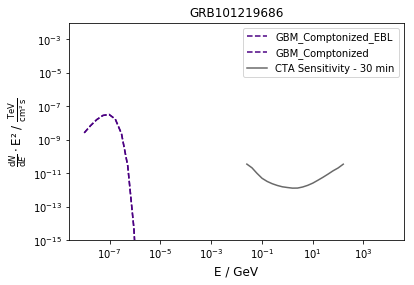

Start simulation for GRB120707800 with (random?) redshift =  1.36406626366
Start IRF part
Ready
974.9800303470114 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


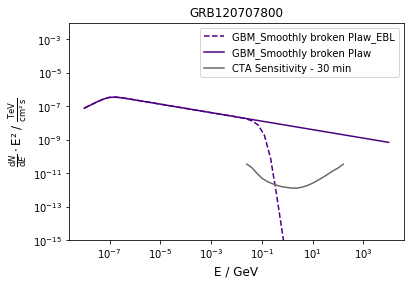

Start simulation for GRB110409179 with (random?) redshift =  2.08715747219
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


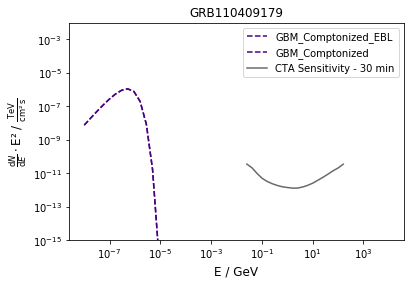

Start simulation for GRB090310189 with (random?) redshift =  2.03770407534
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


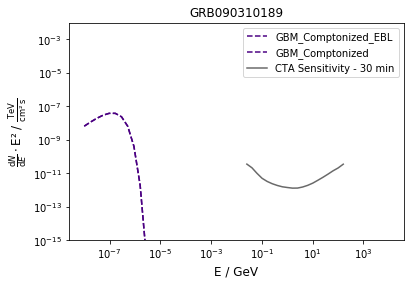

Start simulation for GRB140430716 with (random?) redshift =  1.97108071533
Start IRF part
Ready
2007.2406843866922 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


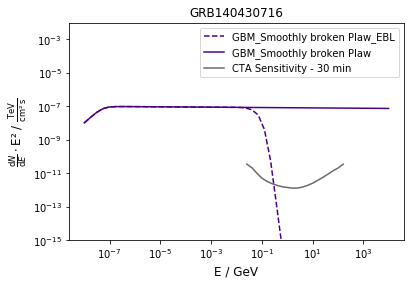

Start simulation for GRB091112737 with (random?) redshift =  1.66291210307
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


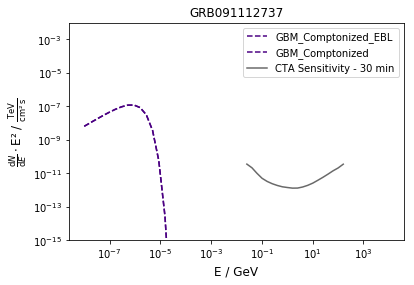

Start simulation for GRB140911012 with (random?) redshift =  3.04382539072
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


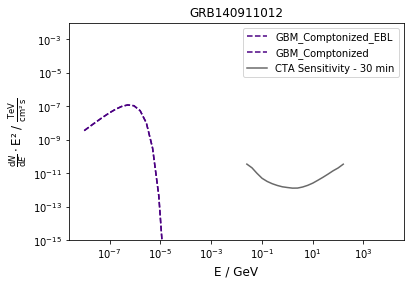

Start simulation for GRB120222119 with (random?) redshift =  2.68000880201
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


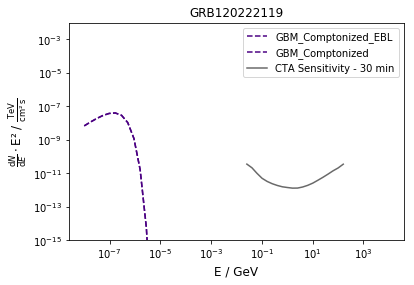

Start simulation for GRB090718762 with (random?) redshift =  0.720477129764
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


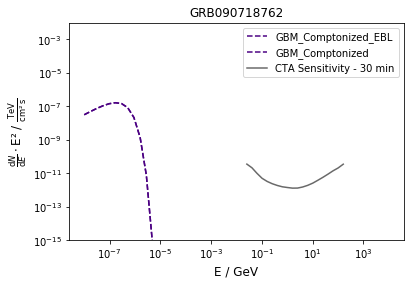

Start simulation for GRB140110263 with (random?) redshift =  3.14257298188
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


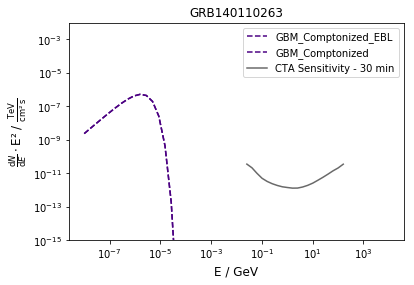

Start simulation for GRB150726877 with (random?) redshift =  0.741698424344
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


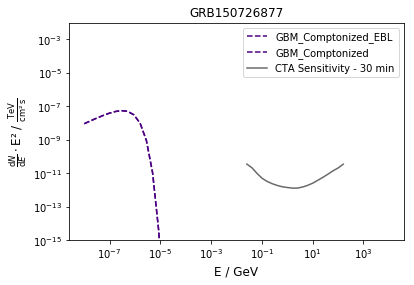

Start simulation for GRB090531775 with (random?) redshift =  3.55268996322
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


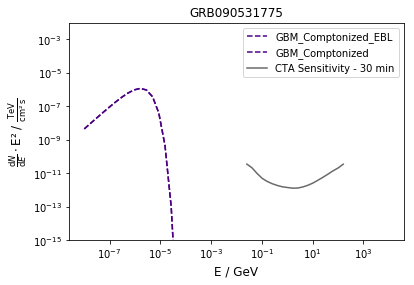

Start simulation for GRB150201590 with (random?) redshift =  1.13953464899
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


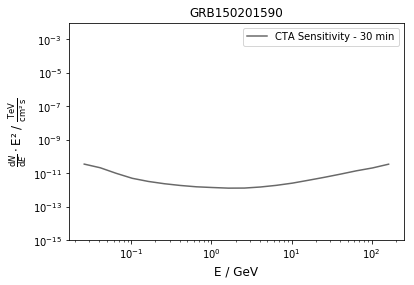

Start simulation for GRB090608052 with (random?) redshift =  1.75812088452
Start IRF part
Ready
4326.573895402986 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


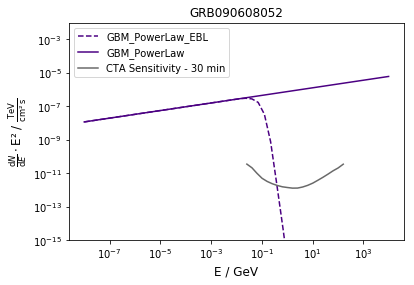

Start simulation for GRB100118100 with (random?) redshift =  2.17362073022
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


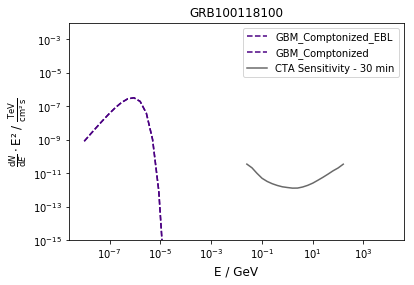

Start simulation for GRB111120556 with (random?) redshift =  2.11501546495
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


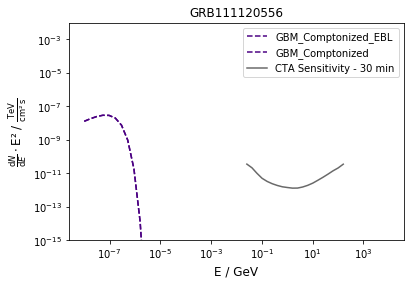

Start simulation for GRB120926426 with (random?) redshift =  3.30858090665
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


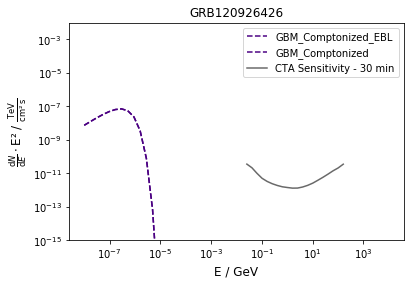

Start simulation for GRB130627372 with (random?) redshift =  3.05963247768
Start IRF part
Ready
5229.771452137279 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


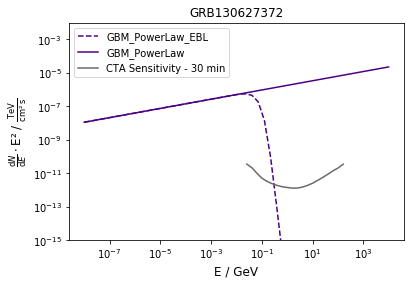

Start simulation for GRB101102840 with (random?) redshift =  2.31372219537
Start IRF part
Ready
48032.5312403518 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


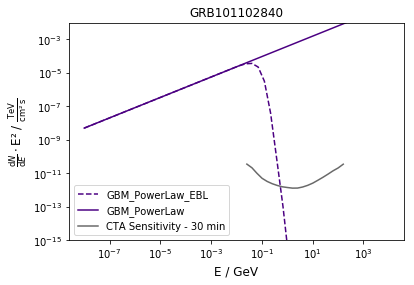

Start simulation for GRB141003564 with (random?) redshift =  1.27847690523
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


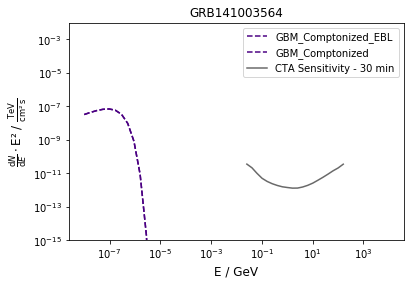

Start simulation for GRB150423285 with (random?) redshift =  1.903892105
Start IRF part
Ready
10607.540801708363 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


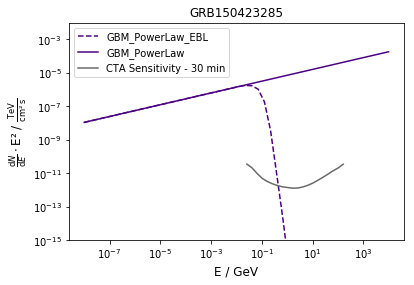

Start simulation for GRB090117632 with (random?) redshift =  1.31990326175
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


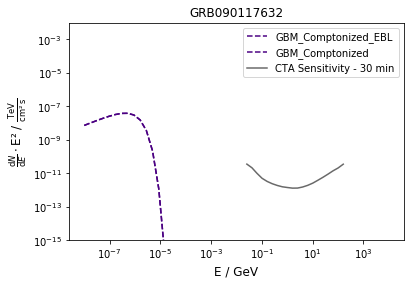

Start simulation for GRB101224998 with (random?) redshift =  0.0613429572092
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


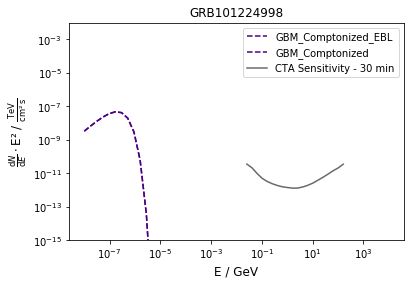

Start simulation for GRB110721200 with (random?) redshift =  1.91805226859
Start IRF part
Ready
13940.154594856005 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


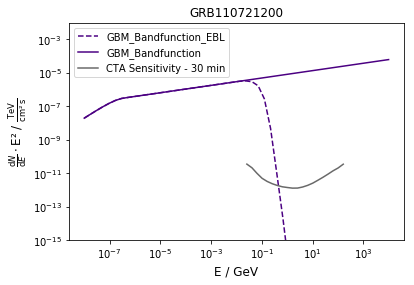

Start simulation for GRB111107076 with (random?) redshift =  1.66574165181
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


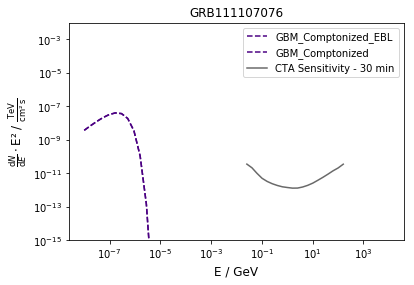

Start simulation for GRB150712846 with (random?) redshift =  1.82373525268
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


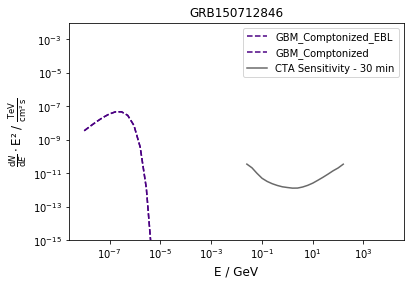

Start simulation for GRB170915161 with (random?) redshift =  0.496584369311
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


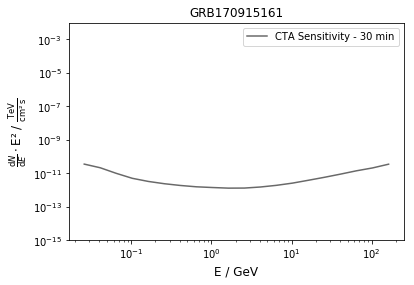

Start simulation for GRB170125102 with (random?) redshift =  1.05708081474
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


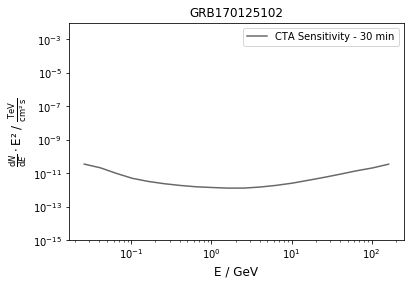

Start simulation for GRB110609425 with (random?) redshift =  3.95844281494
Start IRF part
Ready
5624.464587314553 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


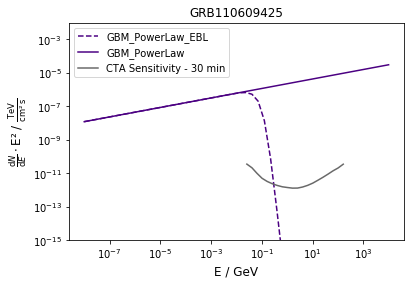

Start simulation for GRB160131116 with (random?) redshift =  0.904028801668
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


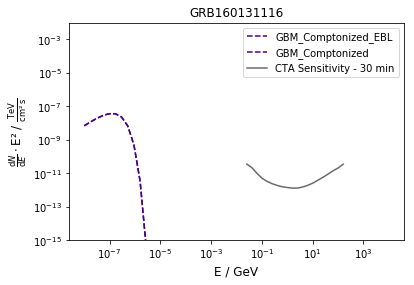

Start simulation for GRB110420946 with (random?) redshift =  0.808980397889
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


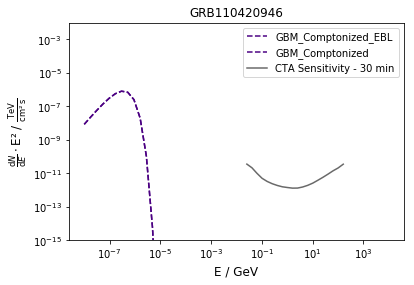

Start simulation for GRB170219110 with (random?) redshift =  0.715146021371
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


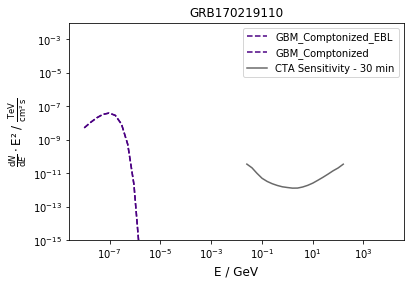

Start simulation for GRB140721336 with (random?) redshift =  3.0756590523
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


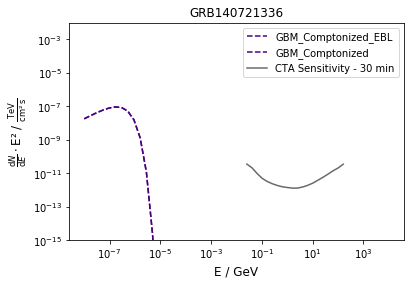

Start simulation for GRB140329272 with (random?) redshift =  0.430428566571
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


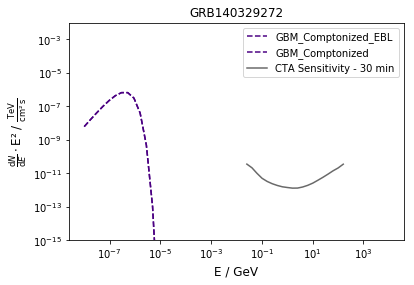

Start simulation for GRB150817251 with (random?) redshift =  4.06310904081
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


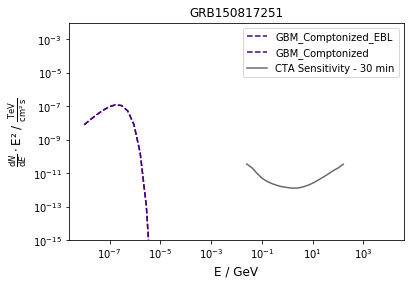

Start simulation for GRB150222832 with (random?) redshift =  4.36759497496
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


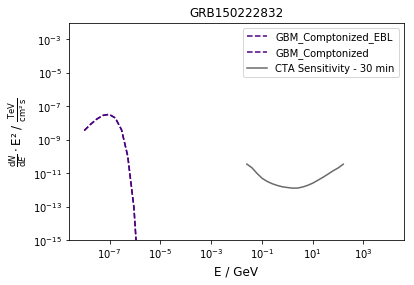

Start simulation for GRB150923429 with (random?) redshift =  1.89726506732
Start IRF part
Ready
198746.31573846337 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


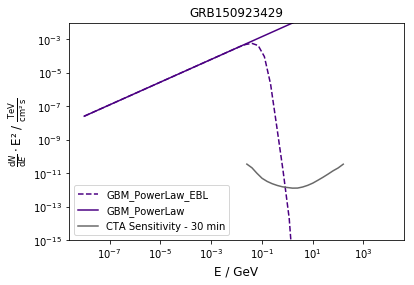

Start simulation for GRB090513916 with (random?) redshift =  1.41125931716
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


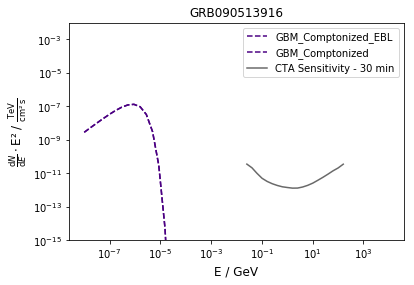

Start simulation for GRB120710100 with (random?) redshift =  2.38075565796
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


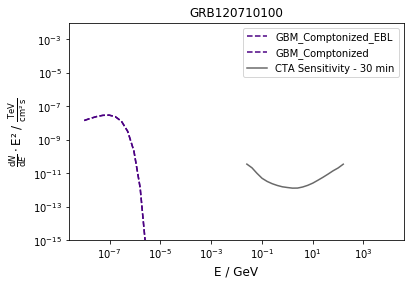

Start simulation for GRB091122163 with (random?) redshift =  2.40305621235
Start IRF part
Ready
123541.76280348333 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


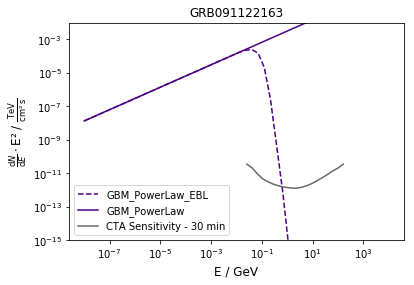

Start simulation for GRB120219563 with (random?) redshift =  1.37996368789
Start IRF part
Ready
88923.27720938285 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


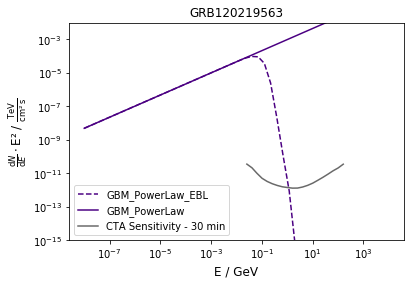

Start simulation for GRB101214993 with (random?) redshift =  0.629216779968
Start IRF part
Ready
47994.90890605428 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


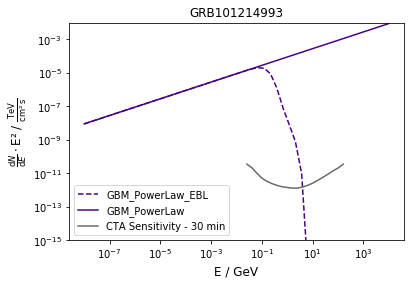

Start simulation for GRB130715906 with (random?) redshift =  2.20647182914
Start IRF part
Ready
1120.256976692267 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


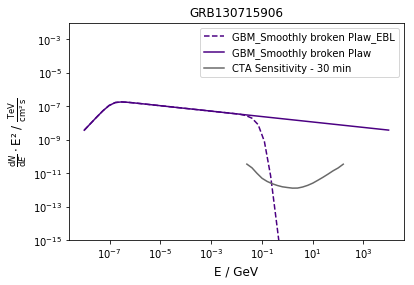

Start simulation for GRB091006360 with (random?) redshift =  1.58606062961
Start IRF part
Ready
49761.19824723926 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


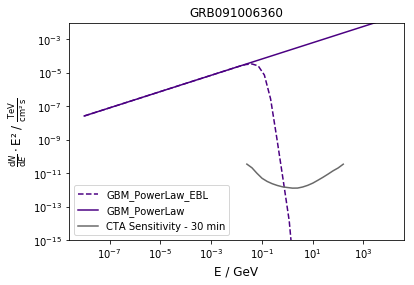

Start simulation for GRB130701761 with (random?) redshift =  5.21765666744
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


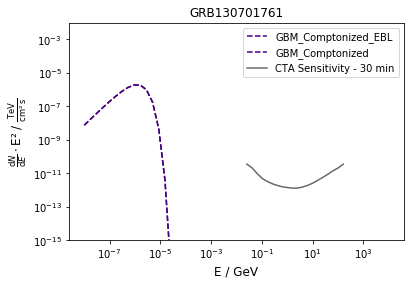

Start simulation for GRB151218857 with (random?) redshift =  3.07140905937
Start IRF part
Ready
9191.344963686332 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


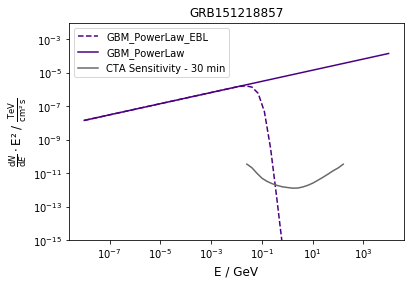

Start simulation for GRB170711019 with (random?) redshift =  0.851322834006
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


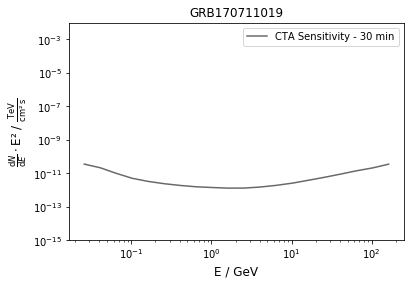

Start simulation for GRB141209131 with (random?) redshift =  3.93720211372
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


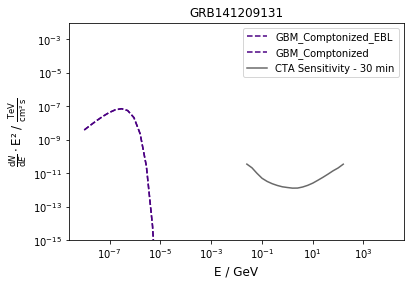

Start simulation for GRB090112332 with (random?) redshift =  3.06170911858
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


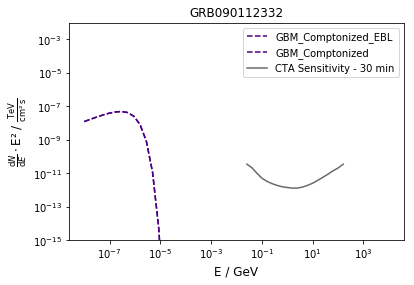

Start simulation for GRB140223495 with (random?) redshift =  1.9782278293
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


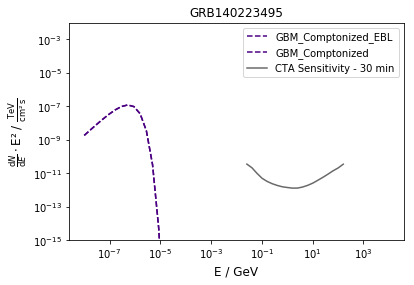

Start simulation for GRB171023097 with (random?) redshift =  1.35529381925
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


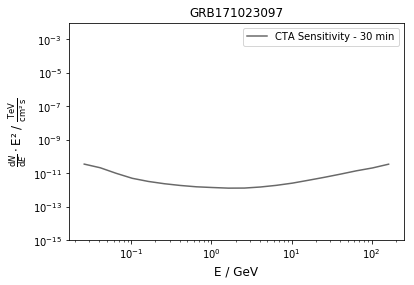

Start simulation for GRB170127634 with (random?) redshift =  3.41270775331
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


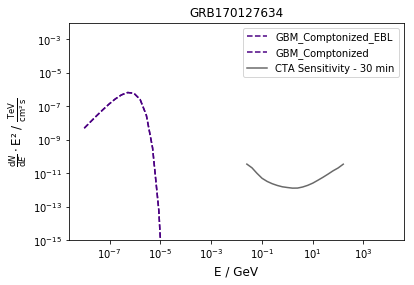

Start simulation for GRB150511362 with (random?) redshift =  0.527999107787
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


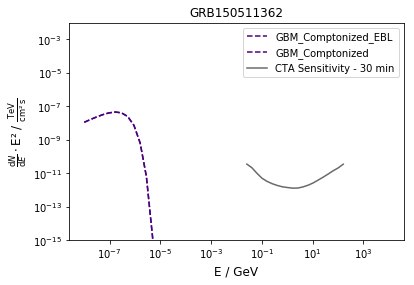

Start simulation for GRB141031998 with (random?) redshift =  1.39401329277
Start IRF part
Ready
195209.68018042424 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


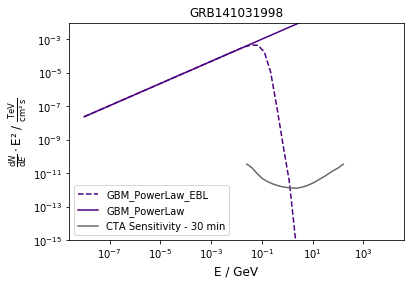

Start simulation for GRB090626189 with (random?) redshift =  0.997973648797
Start IRF part
Ready
1500.1627470015276 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


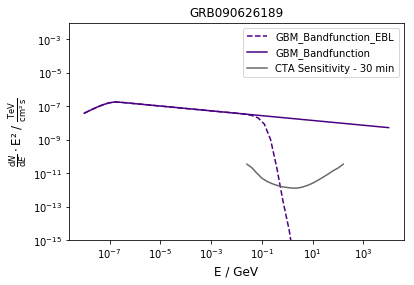

Start simulation for GRB150805746 with (random?) redshift =  0.879228976402
Start IRF part
Ready
4906.169742595388 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


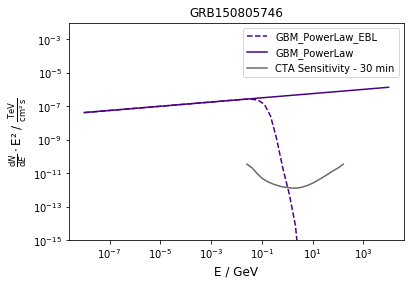

Start simulation for GRB111109453 with (random?) redshift =  1.4138238451
Start IRF part
Ready
65063.86638541081 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


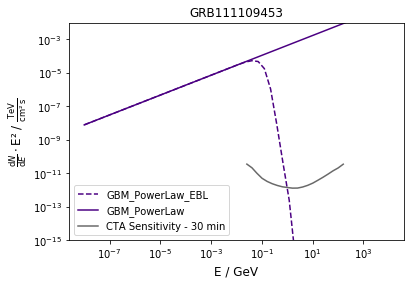

Start simulation for GRB080812889 with (random?) redshift =  3.89604581851
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


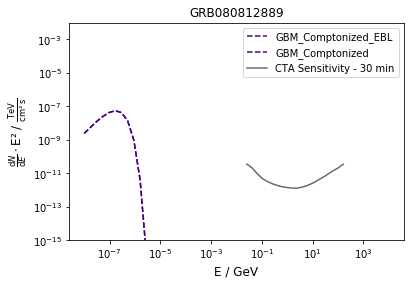

Start simulation for GRB131209547 with (random?) redshift =  7.19997165396
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


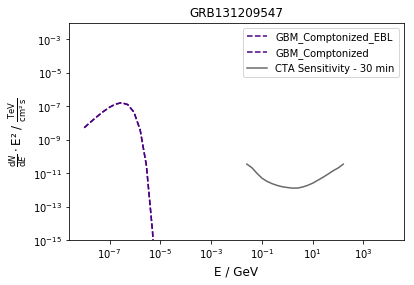

Start simulation for GRB140919636 with (random?) redshift =  3.95141516749
Start IRF part
Ready
1634.0764441736317 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


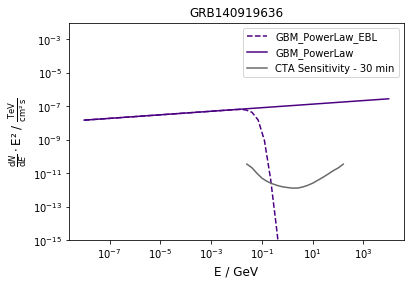

Start simulation for GRB111022854 with (random?) redshift =  4.47148596792
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


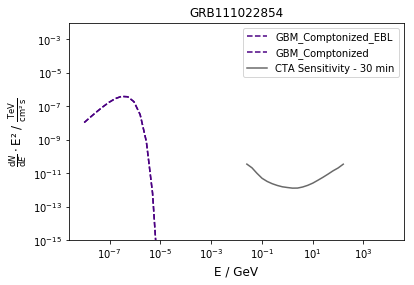

Start simulation for GRB090829672 with (random?) redshift =  2.34596528323
Start IRF part
Ready
832.7891565745103 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


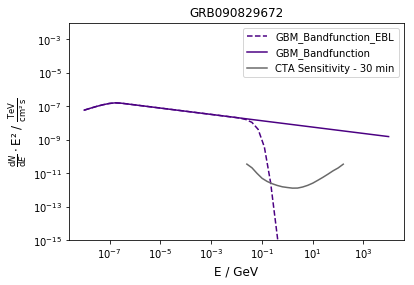

Start simulation for GRB150214293 with (random?) redshift =  0.566146146934
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


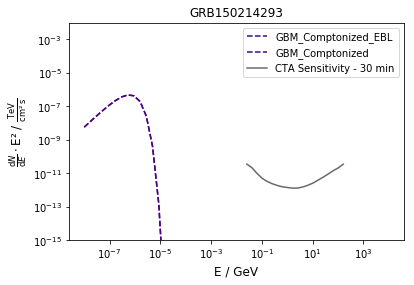

Start simulation for GRB081222204 with (random?) redshift =  1.15594274814
Start IRF part
Ready
384.85869485432846 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


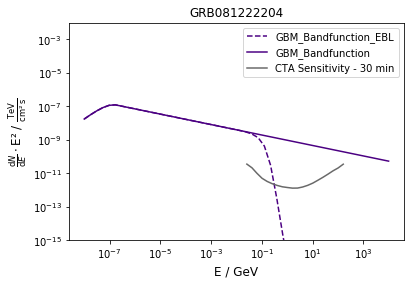

Start simulation for GRB141110232 with (random?) redshift =  6.14732824997
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


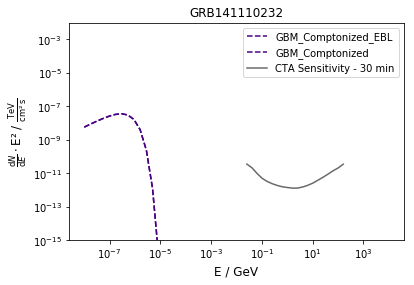

Start simulation for GRB160310291 with (random?) redshift =  1.27056588844
Start IRF part
Ready
3286.3986300653496 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


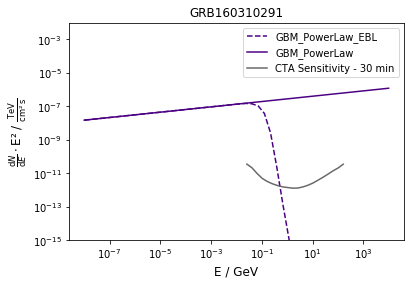

Start simulation for GRB110616648 with (random?) redshift =  0.954140622765
Start IRF part
Ready
5144.594076833884 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


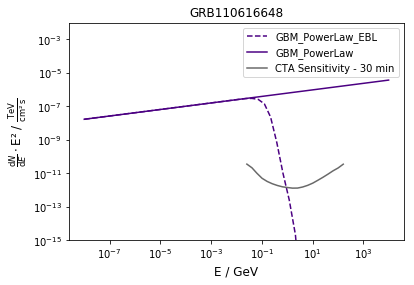

Start simulation for GRB161206064 with (random?) redshift =  0.366597930715
Start IRF part
Ready
4749.10353416657 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


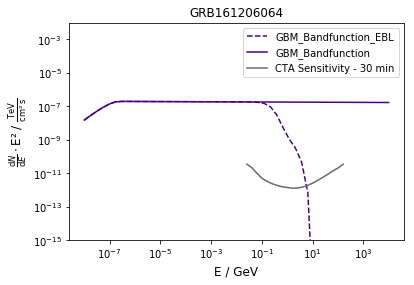

Start simulation for GRB110509142 with (random?) redshift =  3.65184266212
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


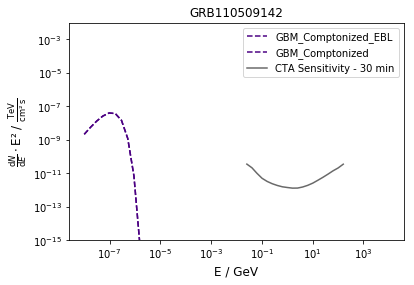

Start simulation for GRB080904886 with (random?) redshift =  7.88603313015
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


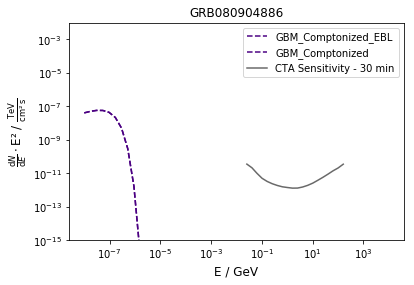

Start simulation for GRB160625240 with (random?) redshift =  2.07660136583
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


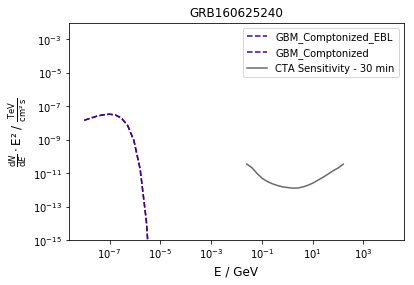

Start simulation for GRB150426594 with (random?) redshift =  1.13829162571
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


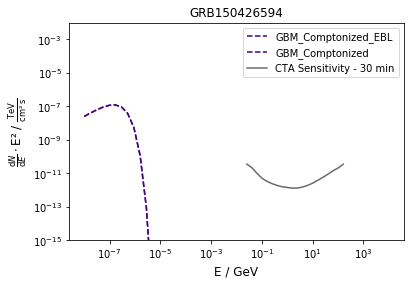

Start simulation for GRB150318521 with (random?) redshift =  2.12323791652
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


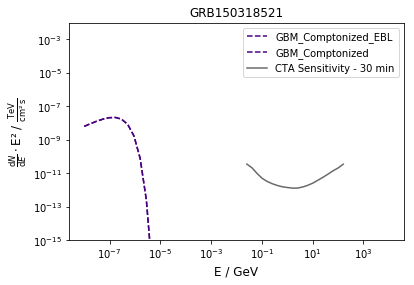

Start simulation for GRB140511095 with (random?) redshift =  1.74284183712
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


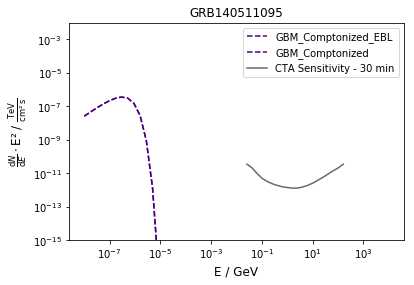

Start simulation for GRB150227702 with (random?) redshift =  5.03799677499
Start IRF part
Ready
501.9945898067906 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


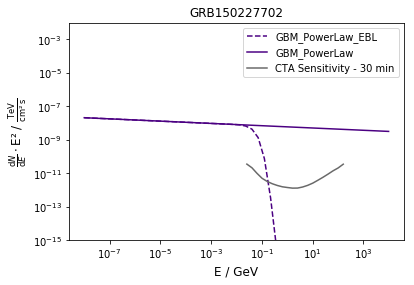

Start simulation for GRB111221739 with (random?) redshift =  4.12276234452
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


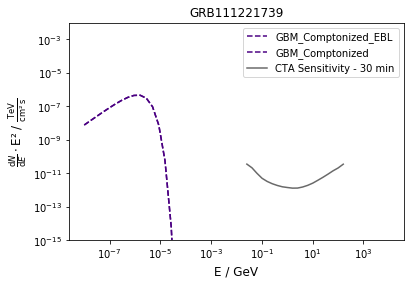

Start simulation for GRB170730133 with (random?) redshift =  0.860866472418
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


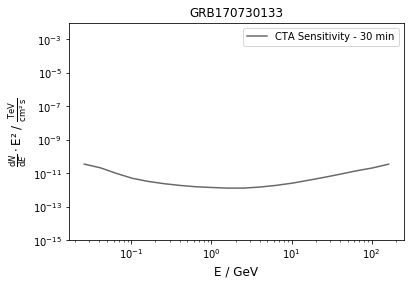

Start simulation for GRB160709826 with (random?) redshift =  0.972621350938
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


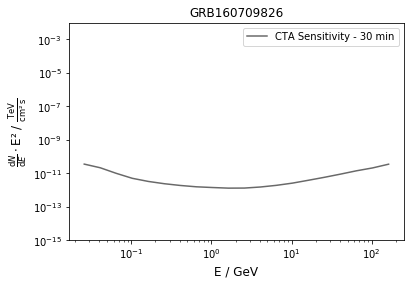

Start simulation for GRB090621417 with (random?) redshift =  1.24846493501
Start IRF part
Ready
20385.64438691053 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


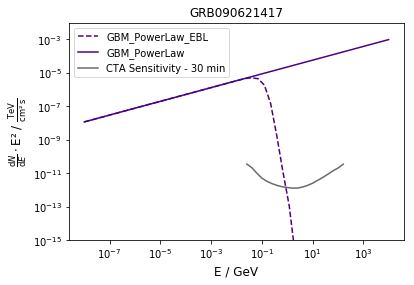

Start simulation for GRB170114833 with (random?) redshift =  0.213845577145
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


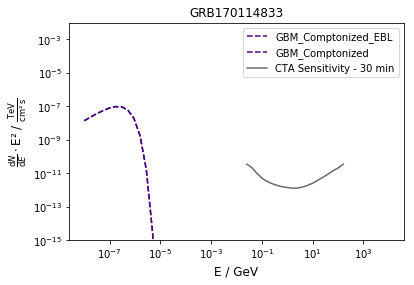

Start simulation for GRB160221993 with (random?) redshift =  4.88786748412
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


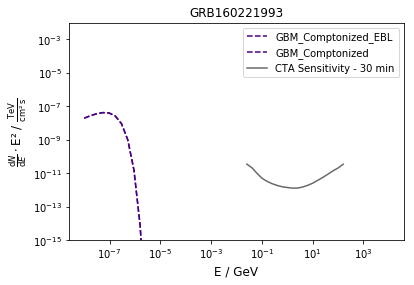

Start simulation for GRB090509215 with (random?) redshift =  3.3607342992
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


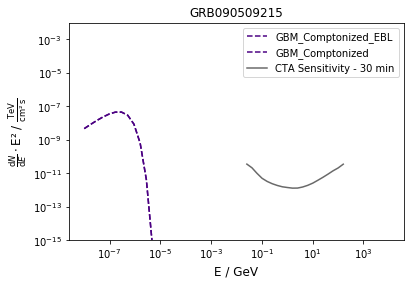

Start simulation for GRB101214748 with (random?) redshift =  2.36041285122
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


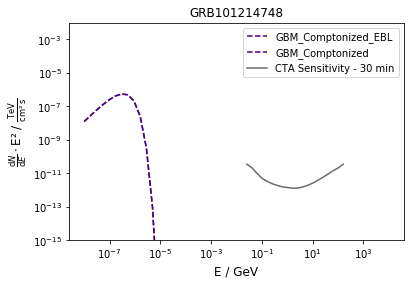

Start simulation for GRB170906039 with (random?) redshift =  2.46743988178
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


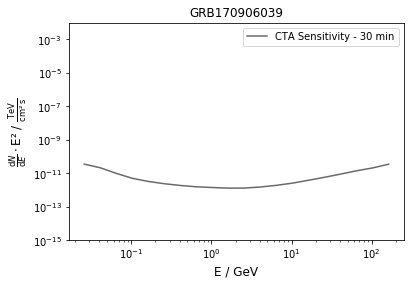

Start simulation for GRB170829414 with (random?) redshift =  1.71483683599
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


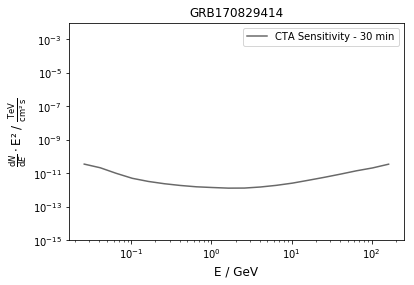

Start simulation for GRB090418816 with (random?) redshift =  1.42768266613
Start IRF part
Ready
57341.2458997389 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


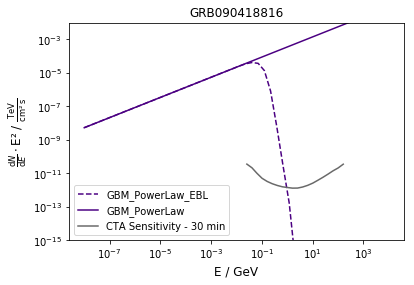

Start simulation for GRB100207665 with (random?) redshift =  1.3330016579
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


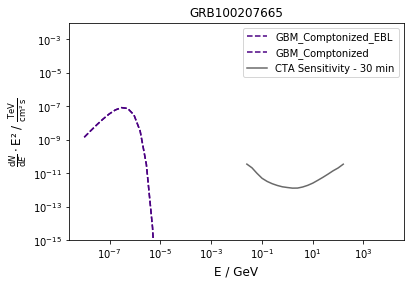

Start simulation for GRB130209961 with (random?) redshift =  1.62941094662
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


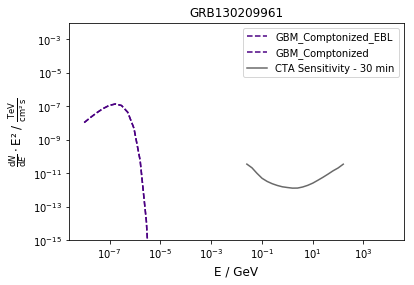

Start simulation for GRB110920546 with (random?) redshift =  3.68389062902
Start IRF part
Ready
13.183551466742117 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


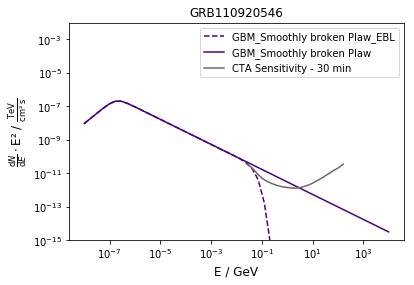

Start simulation for GRB150118927 with (random?) redshift =  0.824034280906
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


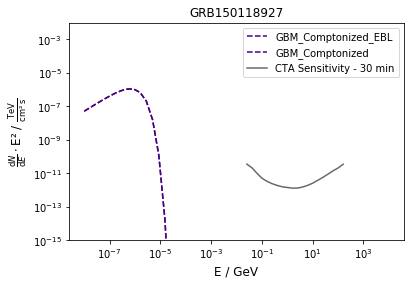

Start simulation for GRB101002279 with (random?) redshift =  0.983640908681
Start IRF part
Ready
60633.390009900955 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


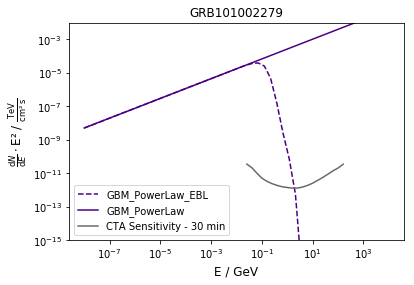

Start simulation for GRB160419637 with (random?) redshift =  1.78790129741
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


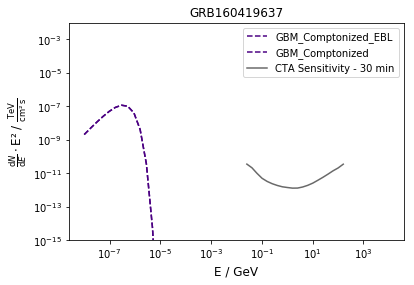

Start simulation for GRB150831930 with (random?) redshift =  6.19635149499
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


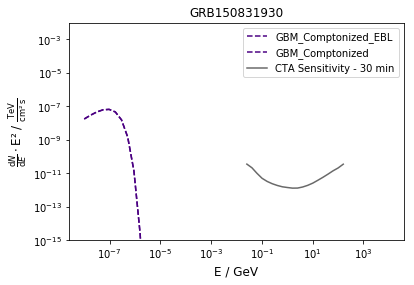

Start simulation for GRB081028538 with (random?) redshift =  5.18428625214
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


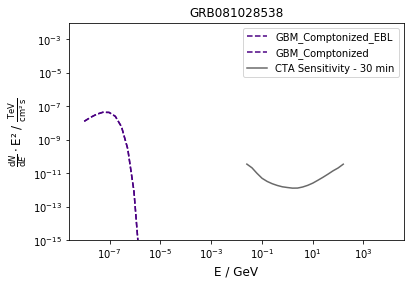

Start simulation for GRB100816009 with (random?) redshift =  2.11774384451
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


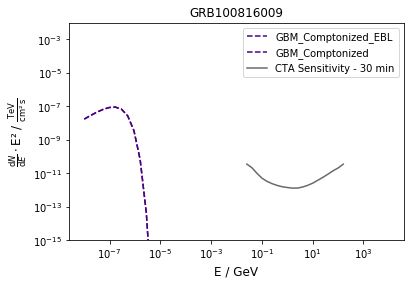

Start simulation for GRB171013350 with (random?) redshift =  3.48126775045
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


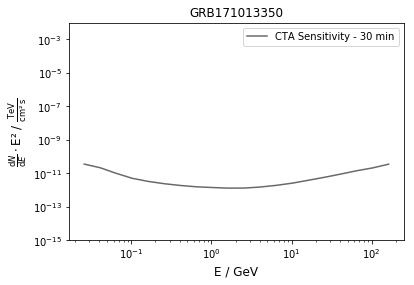

Start simulation for GRB131006367 with (random?) redshift =  1.25252016169
Start IRF part
Ready
299599.5171532998 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


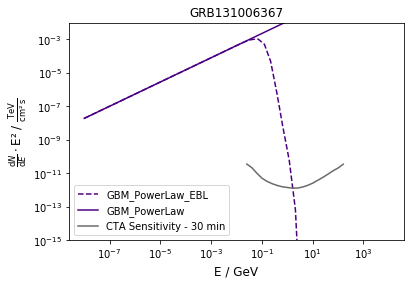

Start simulation for GRB090510016 with (random?) redshift =  4.3882988459
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


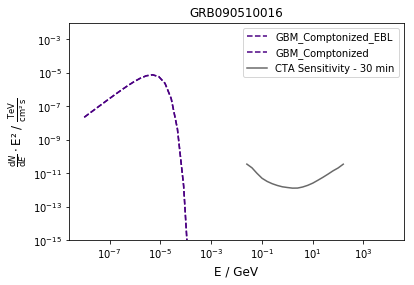

Start simulation for GRB101017619 with (random?) redshift =  4.19312657862
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


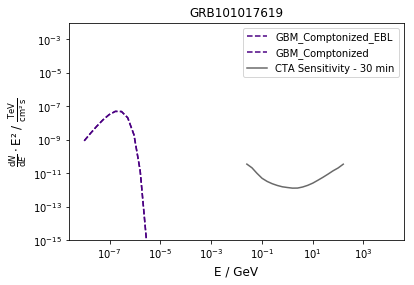

Start simulation for GRB160428412 with (random?) redshift =  0.786968398444
Start IRF part
Ready
200021.5318687842 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


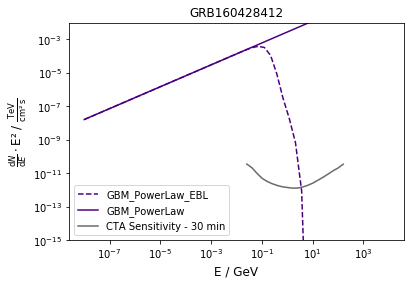

Start simulation for GRB100325275 with (random?) redshift =  3.061946088
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


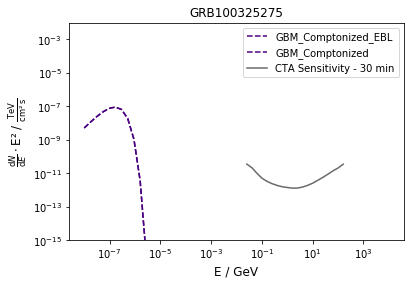

Start simulation for GRB150629564 with (random?) redshift =  3.44698948628
Start IRF part
Ready
123287.54285954688 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


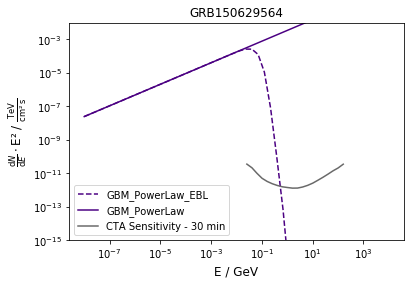

Start simulation for GRB110725236 with (random?) redshift =  4.10955130893
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


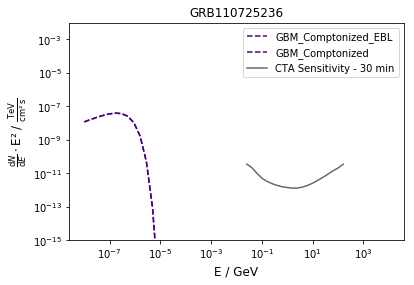

Start simulation for GRB100922625 with (random?) redshift =  1.78160363815
Start IRF part
Ready
99334.97445818355 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


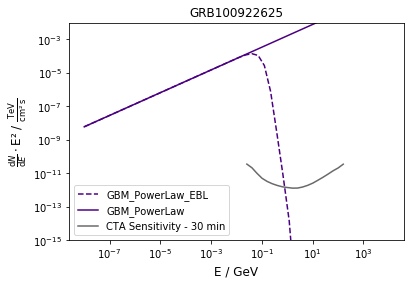

Start simulation for GRB090908341 with (random?) redshift =  0.926269072893
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


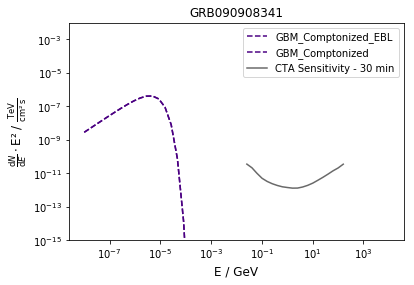

Start simulation for GRB130907760 with (random?) redshift =  3.08185499224
Start IRF part
Ready
187014.9515991745 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


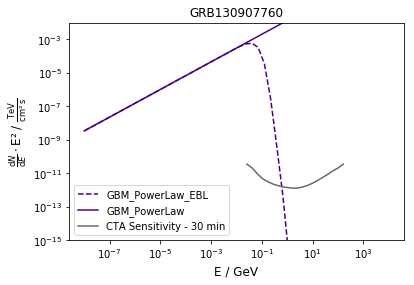

Start simulation for GRB121028280 with (random?) redshift =  0.504030524815
Start IRF part
Ready
25963.027816403042 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


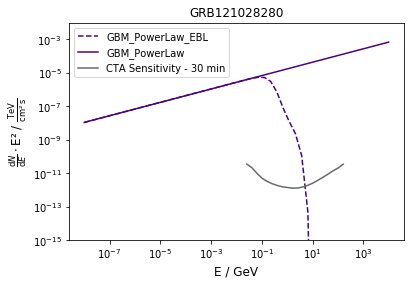

Start simulation for GRB140109877 with (random?) redshift =  1.33402240273
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


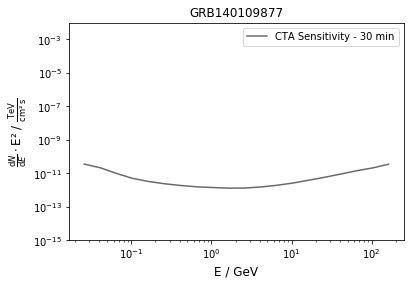

Start simulation for GRB090909854 with (random?) redshift =  2.30510438709
Start IRF part
Ready
77477.7495599841 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


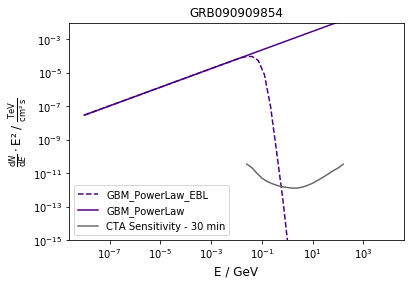

Start simulation for GRB120619884 with (random?) redshift =  6.27365025132
Start IRF part
Ready
251599.75816602938 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


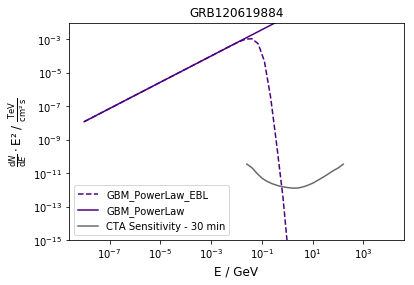

Start simulation for GRB160218711 with (random?) redshift =  1.91523252802
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


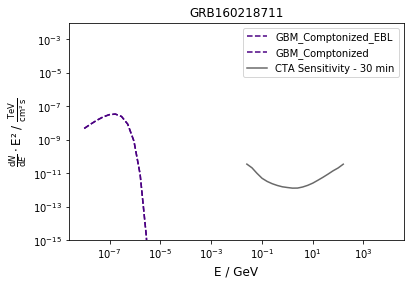

Start simulation for GRB170621784 with (random?) redshift =  1.43686930413
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


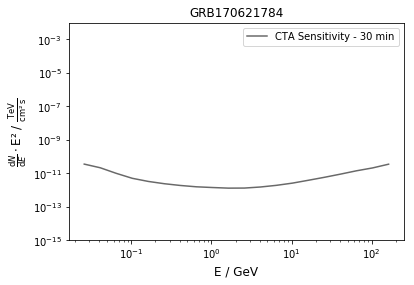

Start simulation for GRB120817168 with (random?) redshift =  2.2014987699
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


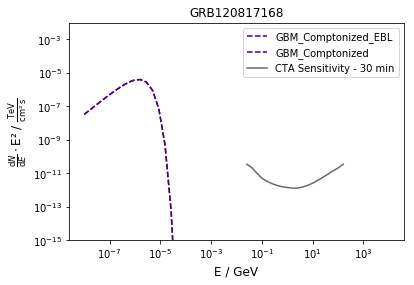

Start simulation for GRB170926782 with (random?) redshift =  1.31718945688
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


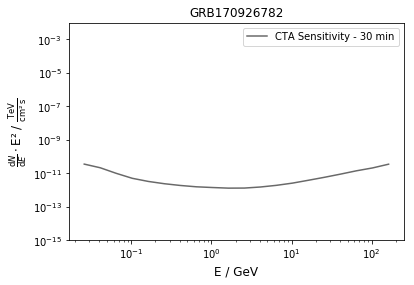

Start simulation for GRB170825307 with (random?) redshift =  2.06301306026
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


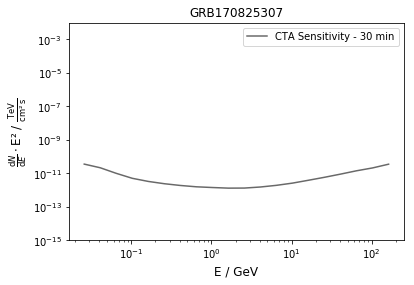

Start simulation for GRB090828099 with (random?) redshift =  1.78366068674
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


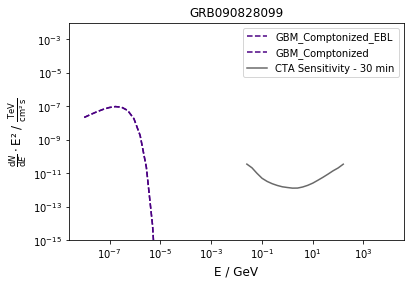

Start simulation for GRB130925164 with (random?) redshift =  0.118291511199
Start IRF part
Ready
208.40560557329735 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


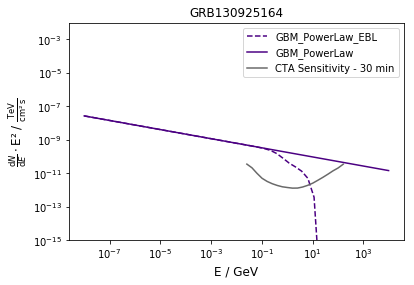

Start simulation for GRB130925173 with (random?) redshift =  2.02862895401
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


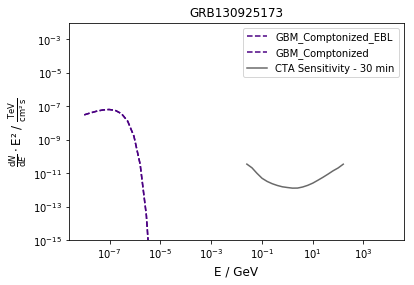

Start simulation for GRB120608489 with (random?) redshift =  1.02695182059
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


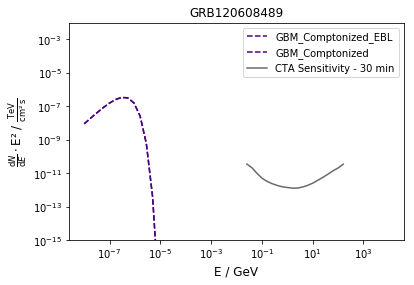

Start simulation for GRB131119781 with (random?) redshift =  2.81181382154
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


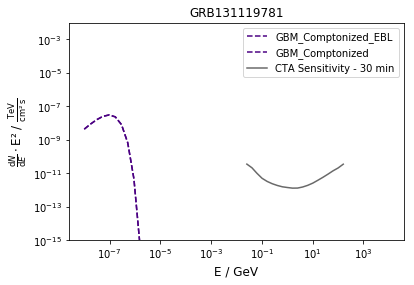

Start simulation for GRB090307167 with (random?) redshift =  1.28857546413
Start IRF part
Ready
29027.02750526099 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


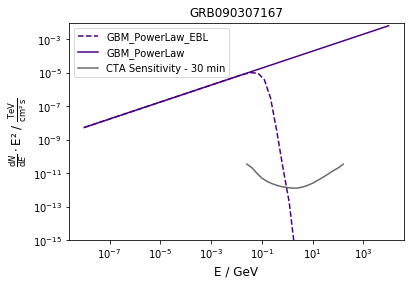

Start simulation for GRB110828575 with (random?) redshift =  1.45436665495
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


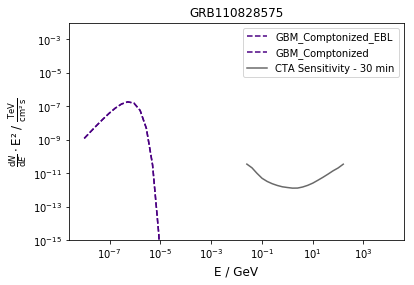

Start simulation for GRB160222070 with (random?) redshift =  1.14525240787
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


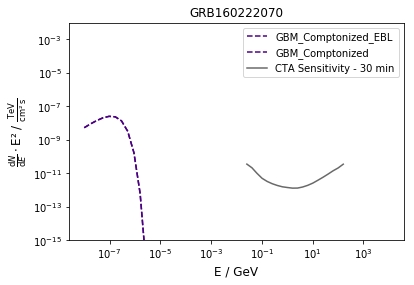

Start simulation for GRB101021009 with (random?) redshift =  2.57270725245
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


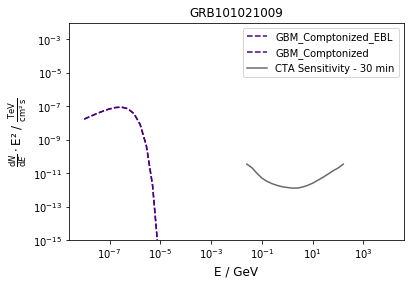

Start simulation for GRB091026485 with (random?) redshift =  3.24712331736
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


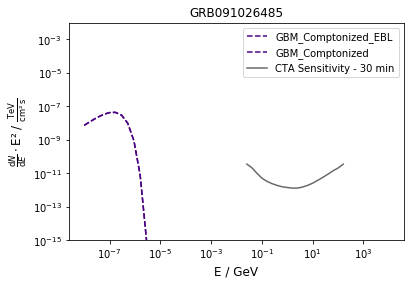

Start simulation for GRB170817529 with (random?) redshift =  1.12224989635
Start IRF part
Ready
90788.02436028022 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


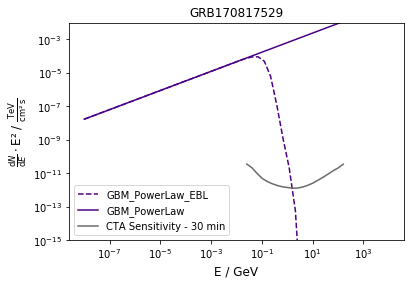

Start simulation for GRB080831921 with (random?) redshift =  0.812430283436
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


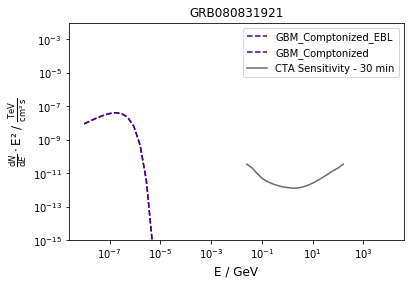

Start simulation for GRB160921087 with (random?) redshift =  0.49001651447
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


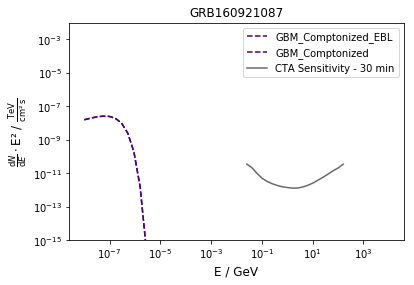

Start simulation for GRB090621447 with (random?) redshift =  4.75734443008
Start IRF part
Ready
7277.355360882986 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


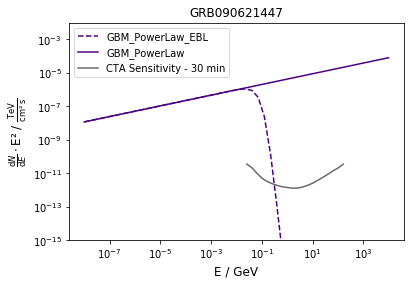

Start simulation for GRB101126198 with (random?) redshift =  2.66238550461
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


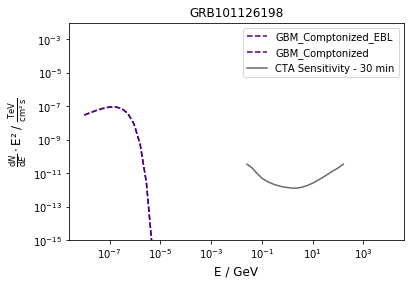

Start simulation for GRB091010113 with (random?) redshift =  1.39408191913
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


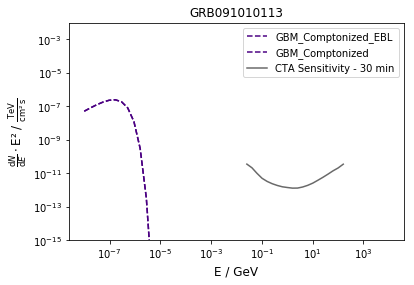

Start simulation for GRB160819852 with (random?) redshift =  3.42616395101
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


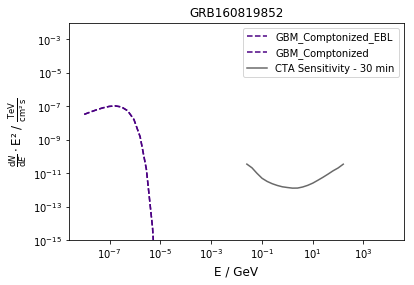

Start simulation for GRB130722990 with (random?) redshift =  5.83402504064
Start IRF part
Ready
14891.78309572879 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


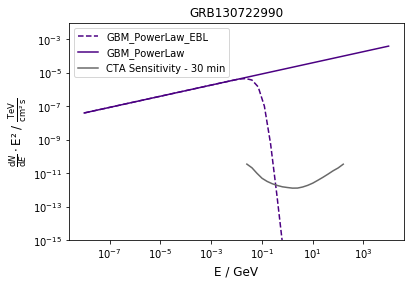

Start simulation for GRB130219197 with (random?) redshift =  2.32323337143
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


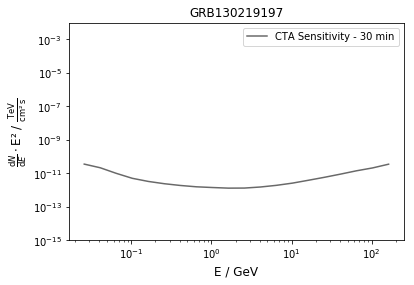

Start simulation for GRB100730463 with (random?) redshift =  5.7909857761
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


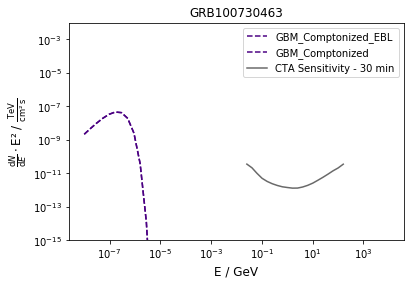

Start simulation for GRB110204179 with (random?) redshift =  1.17336865694
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


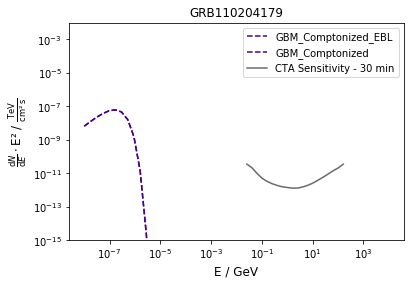

Start simulation for GRB081230871 with (random?) redshift =  1.21047414984
Start IRF part
Ready
214639.61683057723 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


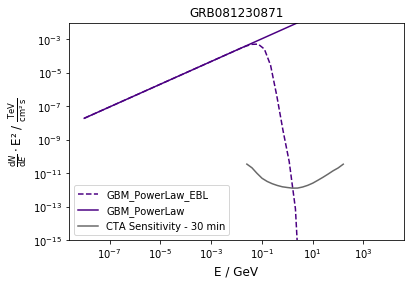

Start simulation for GRB101129652 with (random?) redshift =  1.40009154549
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


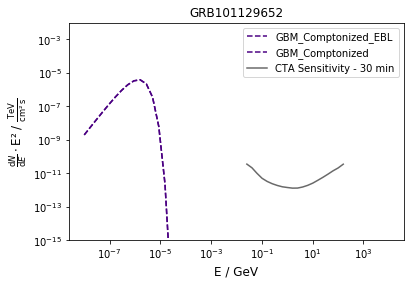

Start simulation for GRB130310840 with (random?) redshift =  0.993914953368
Start IRF part
Ready
4528.218030160584 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


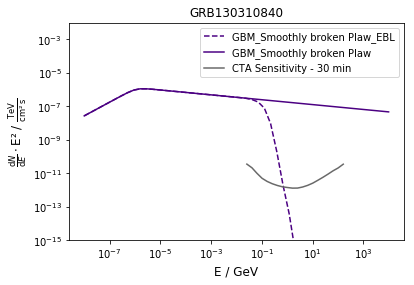

Start simulation for GRB151023104 with (random?) redshift =  1.05909754528
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


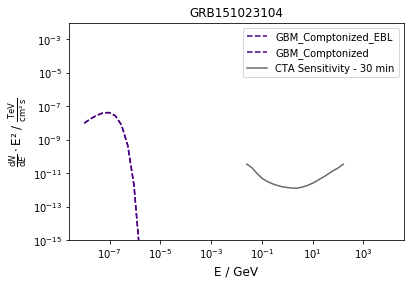

Start simulation for GRB110105877 with (random?) redshift =  2.05278260027
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


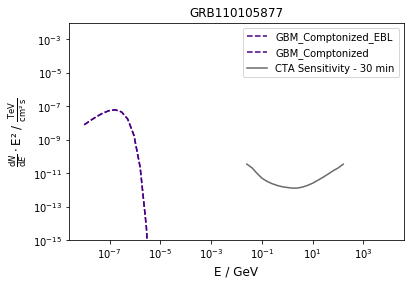

Start simulation for GRB161201342 with (random?) redshift =  3.08901363556
Start IRF part
Ready
13942.406830847936 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


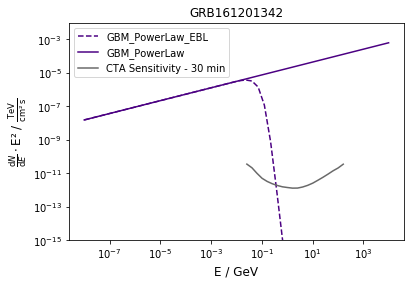

Start simulation for GRB080817720 with (random?) redshift =  1.232489399
Start IRF part
Ready
109315.76757745272 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


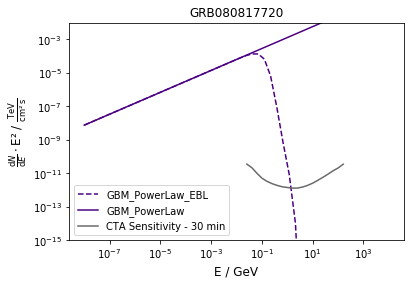

Start simulation for GRB110209165 with (random?) redshift =  2.18245491601
Start IRF part
Ready
49877.27440081101 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


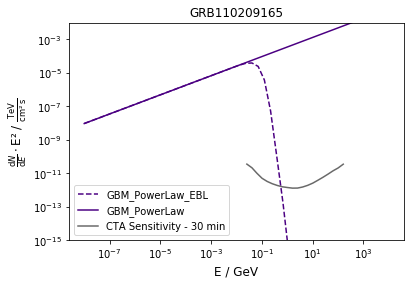

Start simulation for GRB100304534 with (random?) redshift =  1.23021773069
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


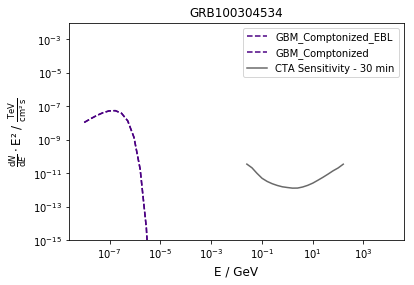

Start simulation for GRB110321346 with (random?) redshift =  2.83274886105
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


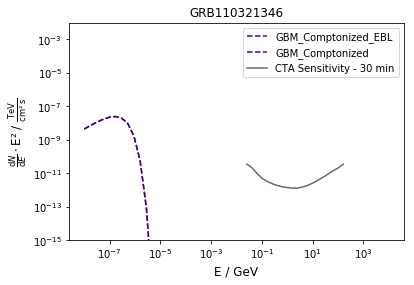

Start simulation for GRB150203545 with (random?) redshift =  5.84868352271
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


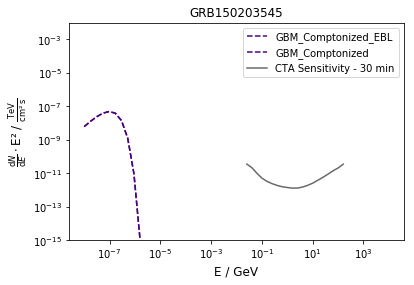

Start simulation for GRB091120191 with (random?) redshift =  0.448724847867
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


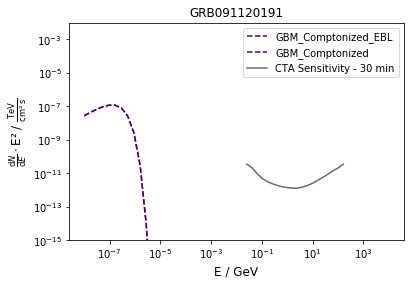

Start simulation for GRB131202633 with (random?) redshift =  3.09792778035
Start IRF part
Ready
15671.44519224583 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


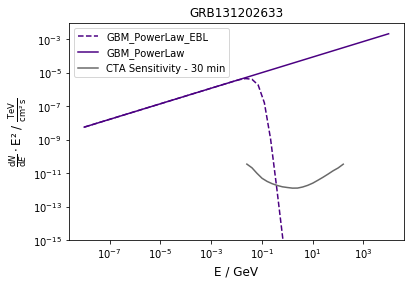

Start simulation for GRB150604434 with (random?) redshift =  1.12992271558
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


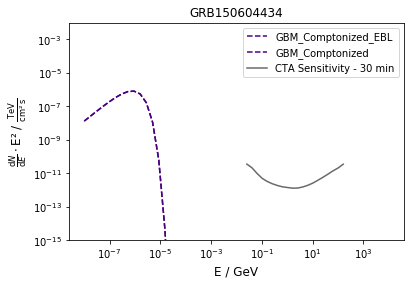

Start simulation for GRB120805706 with (random?) redshift =  5.07138855981
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


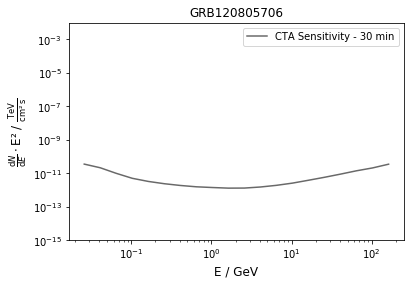

Start simulation for GRB150422703 with (random?) redshift =  0.974340602204
Start IRF part
Ready
411.7593207591162 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


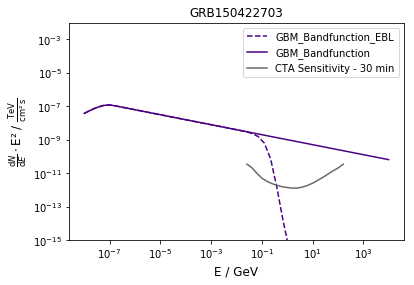

Start simulation for GRB130909817 with (random?) redshift =  0.494025704741
Start IRF part
Ready
4480.97007593511 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


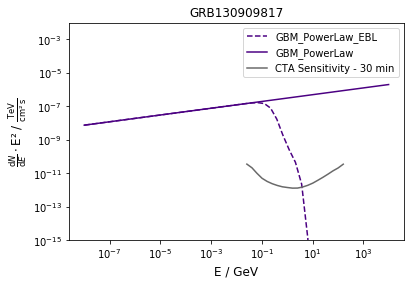

Start simulation for GRB151229285 with (random?) redshift =  4.90275249601
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


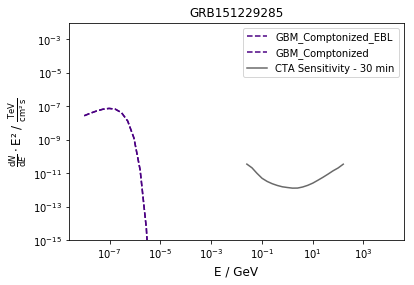

Start simulation for GRB141223240 with (random?) redshift =  2.0085780644
Start IRF part
Ready
3648.5994113118054 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


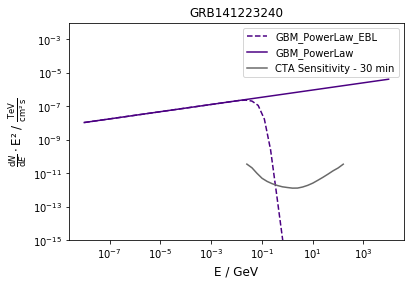

Start simulation for GRB130507545 with (random?) redshift =  5.0436432531
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


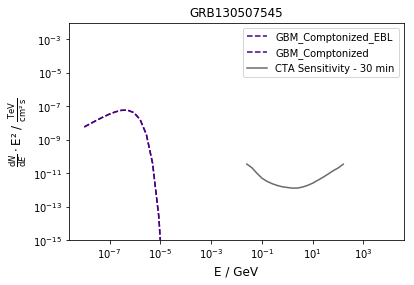

Start simulation for GRB160925221 with (random?) redshift =  1.5651094356
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


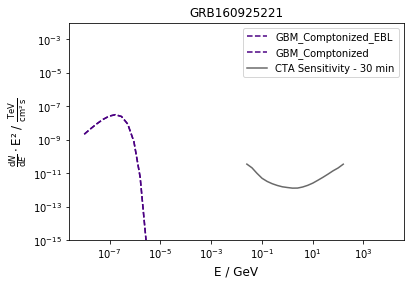

Start simulation for GRB150904479 with (random?) redshift =  0.224643633153
Start IRF part
Ready
53418.93096687861 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


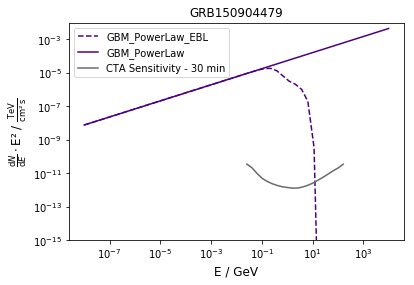

Start simulation for GRB090502777 with (random?) redshift =  1.00383391754
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


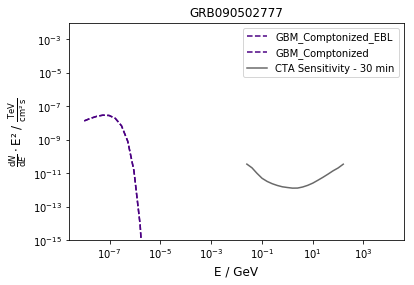

Start simulation for GRB150415029 with (random?) redshift =  1.22880981463
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


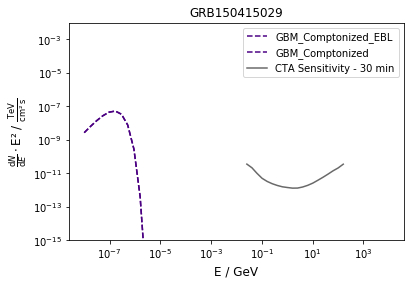

Start simulation for GRB100324172 with (random?) redshift =  1.57126386938
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


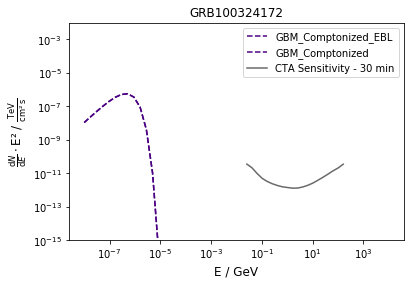

Start simulation for GRB091126333 with (random?) redshift =  2.23897027057
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


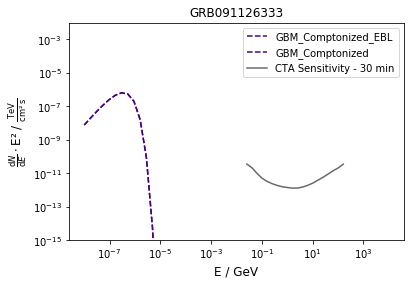

Start simulation for GRB141229492 with (random?) redshift =  2.53576915776
Start IRF part
Ready
5328.971030852348 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


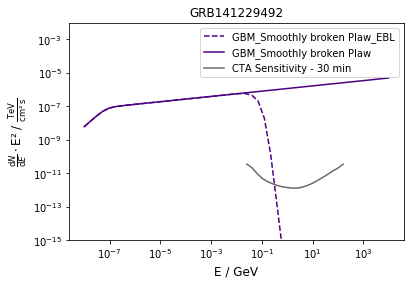

Start simulation for GRB120916085 with (random?) redshift =  1.32087372809
Start IRF part
Ready
125064.45934102581 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


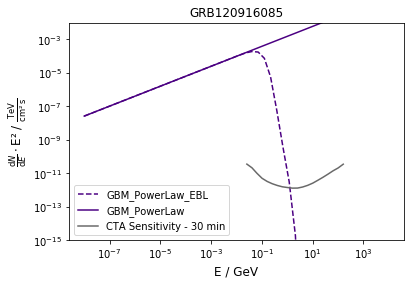

Start simulation for GRB160818198 with (random?) redshift =  0.702262048472
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


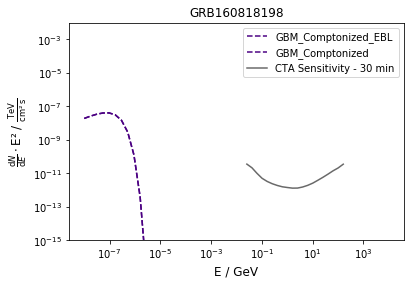

Start simulation for GRB090426066 with (random?) redshift =  0.649741764952
Start IRF part
Ready
22392.017782216622 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


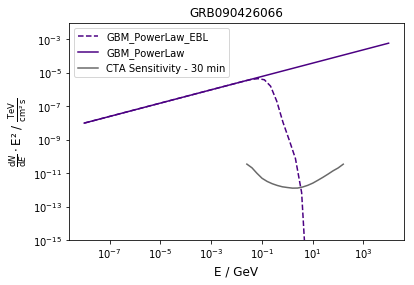

Start simulation for GRB131014215 with (random?) redshift =  1.1569261825
Start IRF part
Ready
595.2233755186707 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


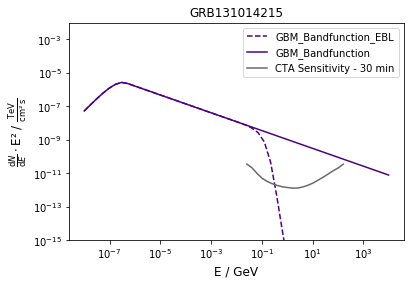

Start simulation for GRB110624906 with (random?) redshift =  5.84821371538
Start IRF part
Ready
10746.999958591987 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


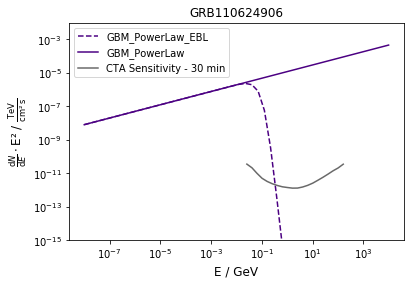

Start simulation for GRB110901230 with (random?) redshift =  1.06264782842
Start IRF part
Ready
4170.346346441396 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


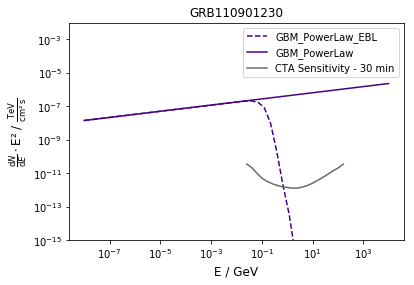

Start simulation for GRB100207721 with (random?) redshift =  5.68011987766
Start IRF part
Ready
15058.108906494714 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


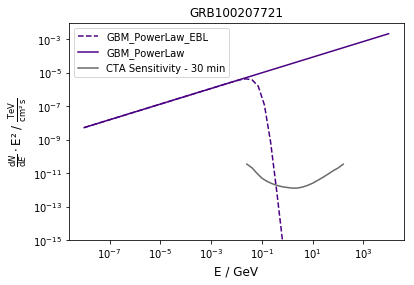

Start simulation for GRB100301068 with (random?) redshift =  1.56106901155
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


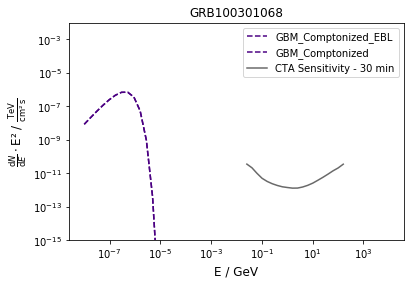

Start simulation for GRB100722096 with (random?) redshift =  2.54944260489
Start IRF part
Ready
147.14779589153196 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


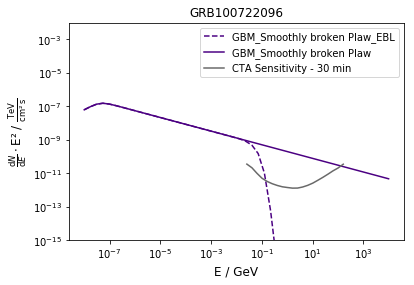

Start simulation for GRB120524134 with (random?) redshift =  1.99059359895
Start IRF part
Ready
5298.481853195889 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


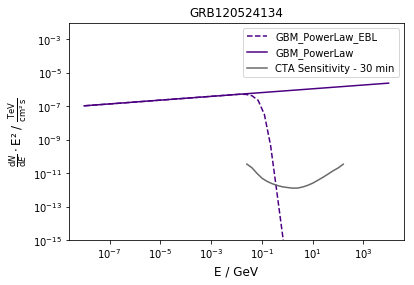

Start simulation for GRB170816258 with (random?) redshift =  4.2275153351
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


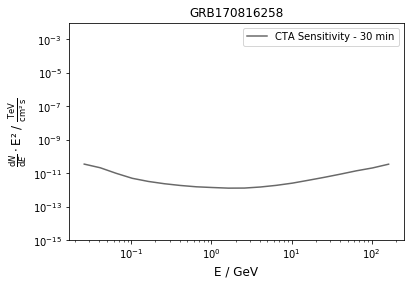

Start simulation for GRB150501017 with (random?) redshift =  2.00824070647
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


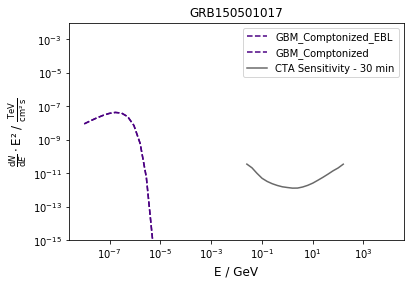

Start simulation for GRB110523344 with (random?) redshift =  0.535832362919
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


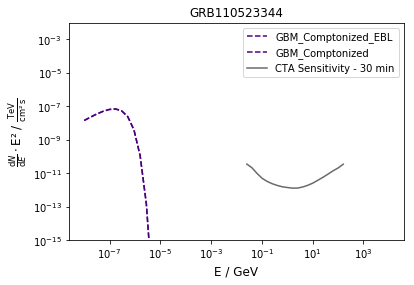

Start simulation for GRB151228129 with (random?) redshift =  0.977475436239
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


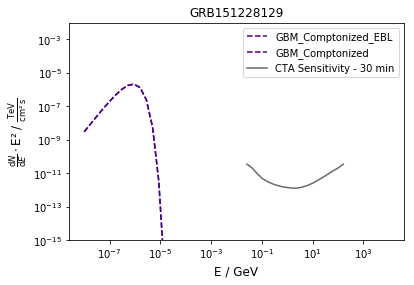

Start simulation for GRB081012549 with (random?) redshift =  3.40979615489
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


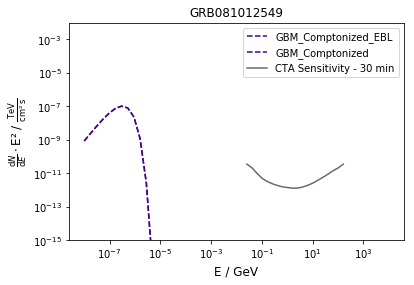

Start simulation for GRB090823133 with (random?) redshift =  1.46800805548
Start IRF part
Ready
6799.211834010137 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


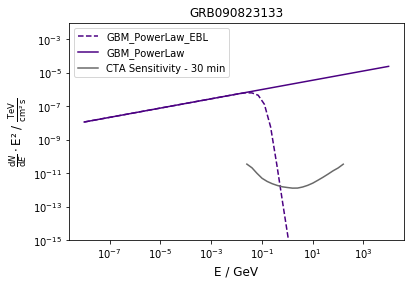

Start simulation for GRB130418844 with (random?) redshift =  0.445419430997
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


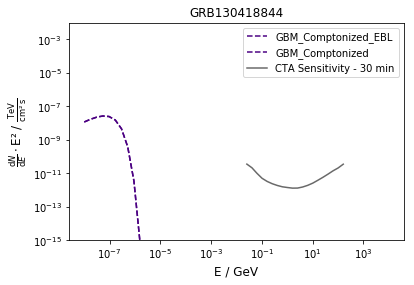

Start simulation for GRB090810781 with (random?) redshift =  5.95819687272
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


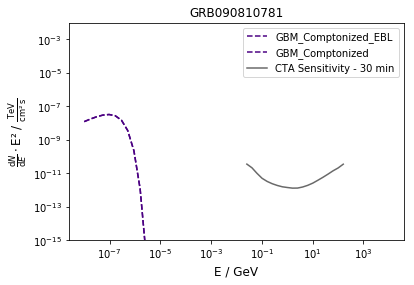

Start simulation for GRB120130699 with (random?) redshift =  3.24917669697
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


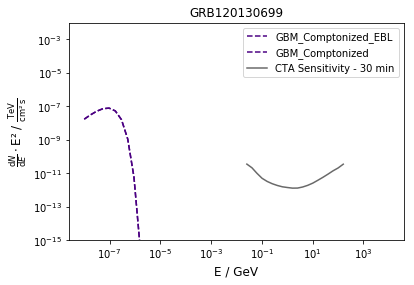

Start simulation for GRB141102112 with (random?) redshift =  2.4572299323
Start IRF part
Ready
94930.66171170835 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


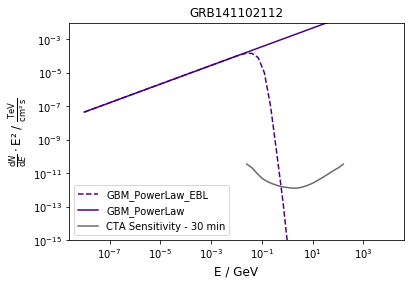

Start simulation for GRB100221368 with (random?) redshift =  5.01753444088
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


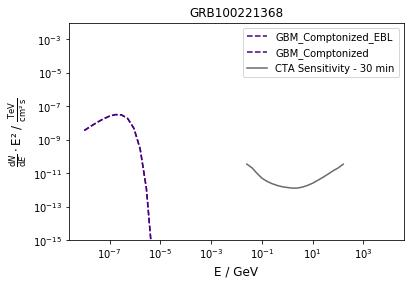

Start simulation for GRB100126460 with (random?) redshift =  2.06255785492
Start IRF part
Ready
63503.68332694853 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


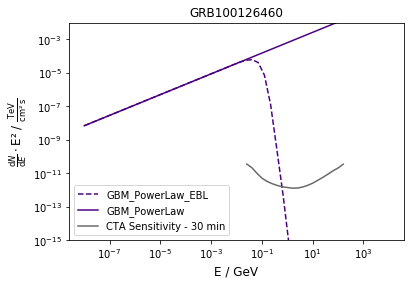

Start simulation for GRB150603823 with (random?) redshift =  4.65847281983
Start IRF part
Ready
11096.001457232984 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


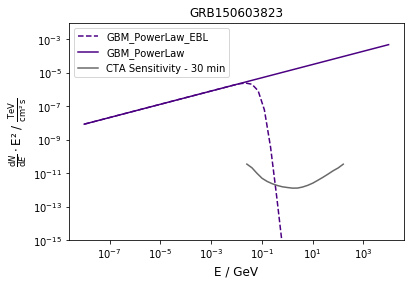

Start simulation for GRB170115662 with (random?) redshift =  4.33019844391
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


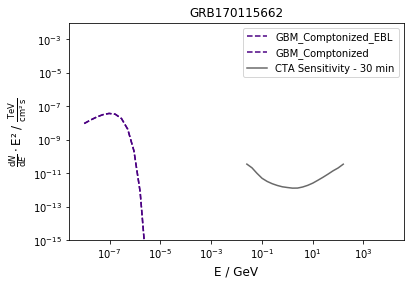

Start simulation for GRB100323542 with (random?) redshift =  4.74724064821
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


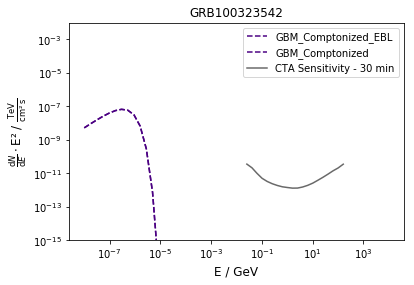

Start simulation for GRB090820509 with (random?) redshift =  0.600600126302
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


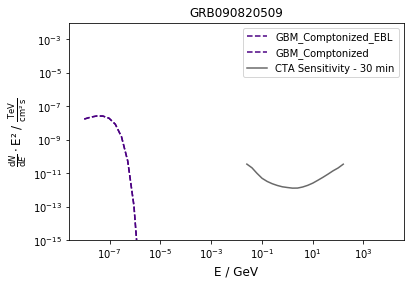

Start simulation for GRB160220059 with (random?) redshift =  2.63621377396
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


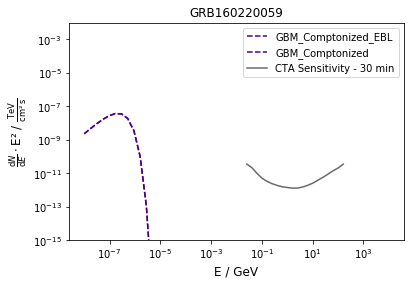

Start simulation for GRB100820373 with (random?) redshift =  2.96352442325
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


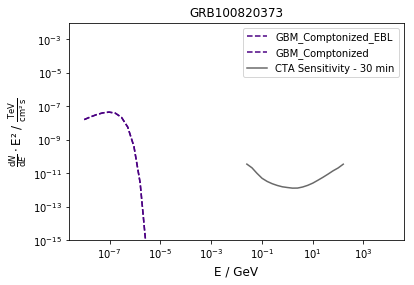

Start simulation for GRB081101167 with (random?) redshift =  0.437948489991
Start IRF part
Ready
91066.98684070588 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


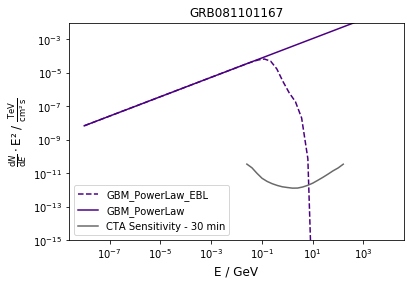

Start simulation for GRB150703149 with (random?) redshift =  0.756115326178
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


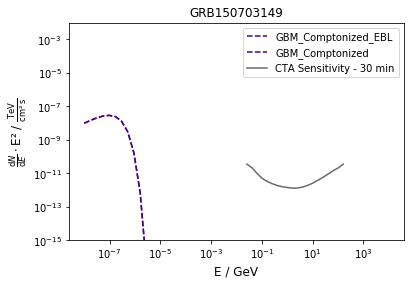

Start simulation for GRB140320092 with (random?) redshift =  2.98873184403
Start IRF part
Ready
38177.51000165468 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


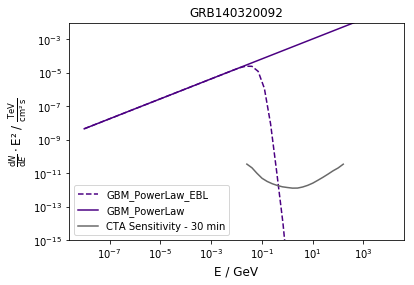

Start simulation for GRB110424758 with (random?) redshift =  2.72285231673
Start IRF part
Ready
192432.87010028277 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


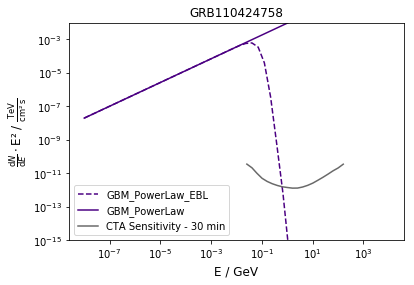

Start simulation for GRB100926694 with (random?) redshift =  1.40026913171
Start IRF part
Ready
17221.49046579353 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


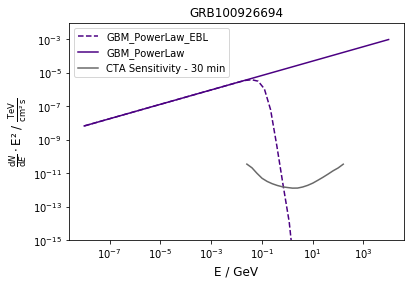

Start simulation for GRB121004211 with (random?) redshift =  0.71236692976
Start IRF part
Ready
65740.28197962814 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


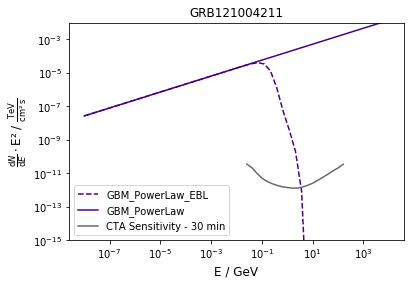

Start simulation for GRB151021791 with (random?) redshift =  1.38453668884
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


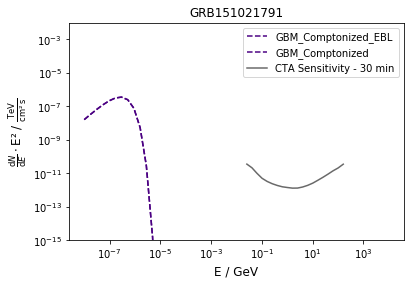

Start simulation for GRB150101641 with (random?) redshift =  0.722004035231
Start IRF part
Ready
15502.383741383566 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


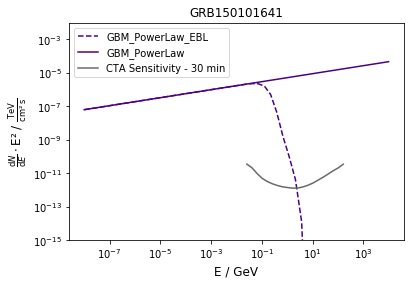

Start simulation for GRB140526571 with (random?) redshift =  2.25012437204
Start IRF part
Ready
196315.16414816768 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


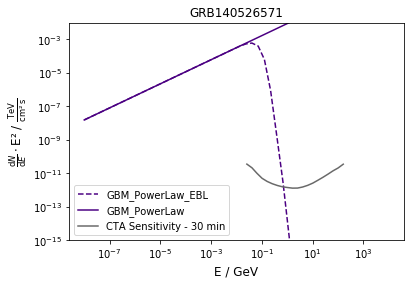

Start simulation for GRB110407998 with (random?) redshift =  2.73893543718
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


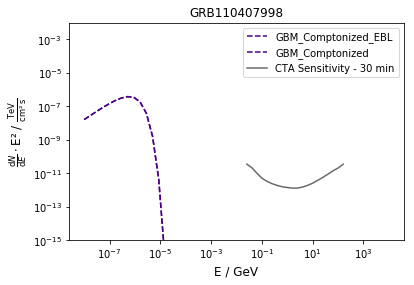

Start simulation for GRB100218194 with (random?) redshift =  0.587602866368
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


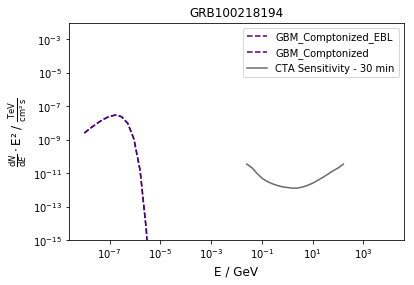

Start simulation for GRB121229533 with (random?) redshift =  1.26535396249
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


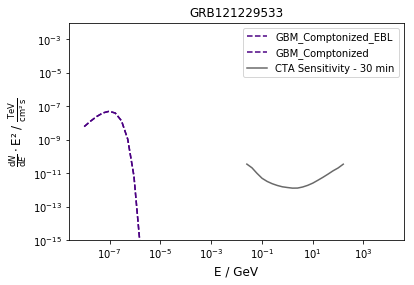

Start simulation for GRB121123421 with (random?) redshift =  4.32996650008
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


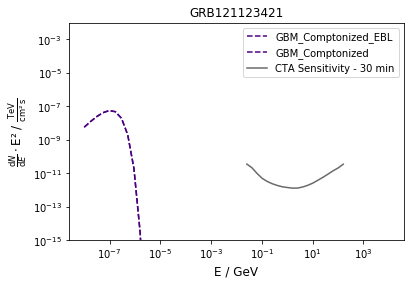

Start simulation for GRB090516353 with (random?) redshift =  1.24197718627
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


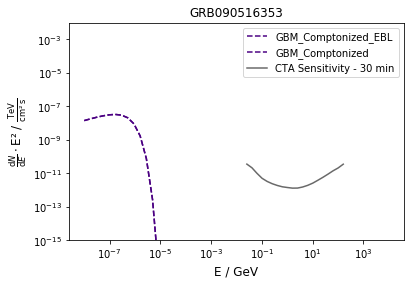

Start simulation for GRB130919173 with (random?) redshift =  1.50965498032
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


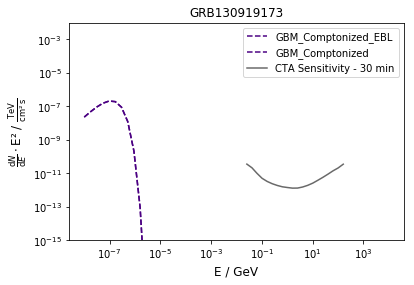

Start simulation for GRB090917661 with (random?) redshift =  0.904847572719
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


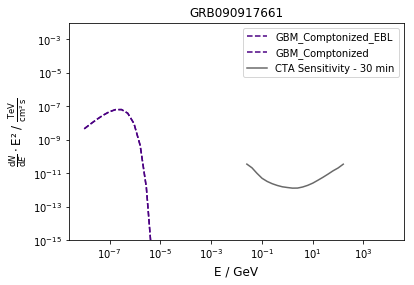

Start simulation for GRB130306991 with (random?) redshift =  0.677505547911
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


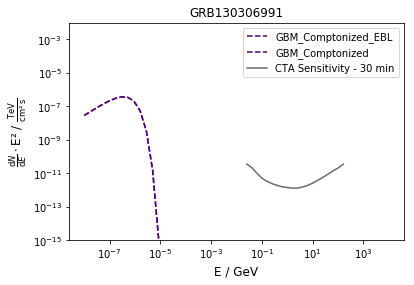

Start simulation for GRB160521839 with (random?) redshift =  1.69121404839
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


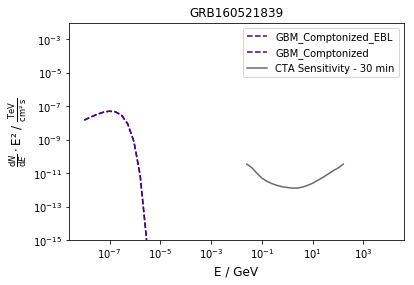

Start simulation for GRB120426585 with (random?) redshift =  5.54828526495
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


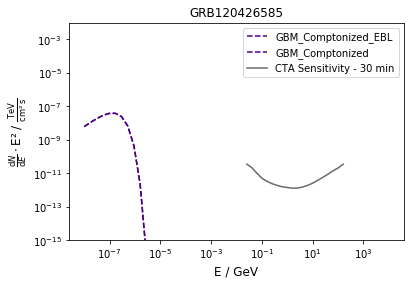

Start simulation for GRB140211091 with (random?) redshift =  2.18410108398
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


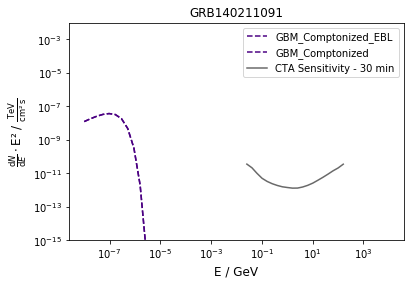

Start simulation for GRB130717734 with (random?) redshift =  1.91541296202
Start IRF part
Ready
15190.72792911257 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


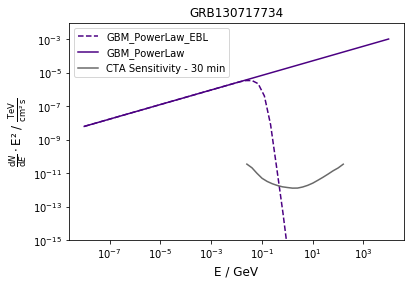

Start simulation for GRB160523919 with (random?) redshift =  3.39348833634
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


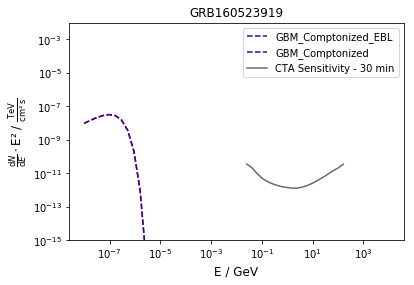

Start simulation for GRB141114687 with (random?) redshift =  2.24692442297
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


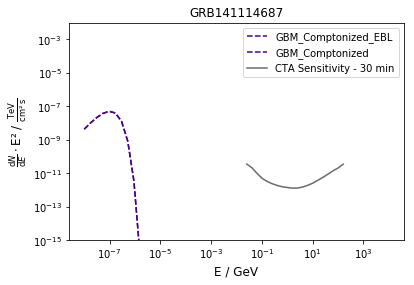

Start simulation for GRB091020977 with (random?) redshift =  2.26560242893
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


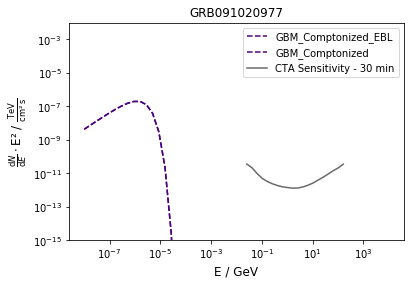

Start simulation for GRB170901255 with (random?) redshift =  0.919671052501
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


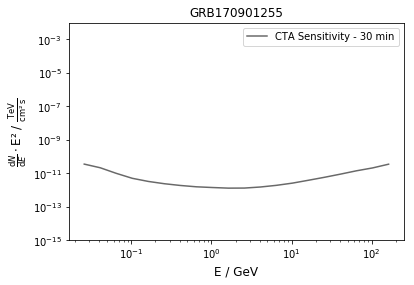

Start simulation for GRB080808772 with (random?) redshift =  8.10394477508
Start IRF part
Ready
29540.392002480858 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


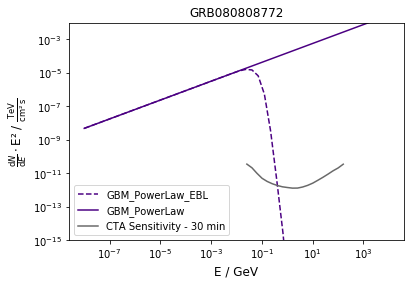

Start simulation for GRB150811849 with (random?) redshift =  2.02113192942
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


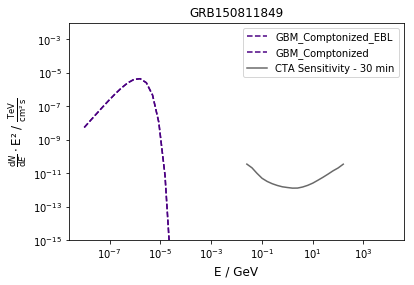

Start simulation for GRB091002685 with (random?) redshift =  0.179035878782
Start IRF part
Ready
41404.93504508015 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


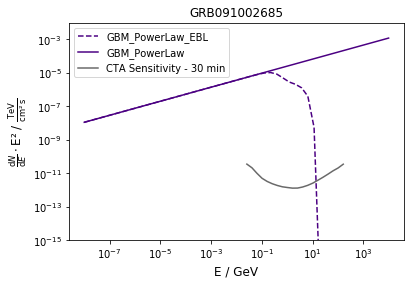

Start simulation for GRB080725435 with (random?) redshift =  2.72981612784
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


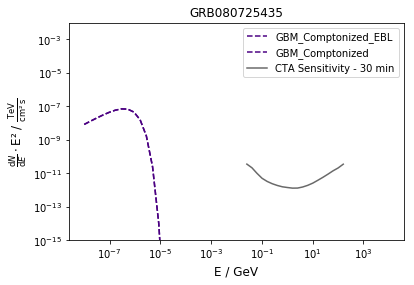

Start simulation for GRB140426515 with (random?) redshift =  2.45306616868
Start IRF part
Ready
35896.65562005613 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


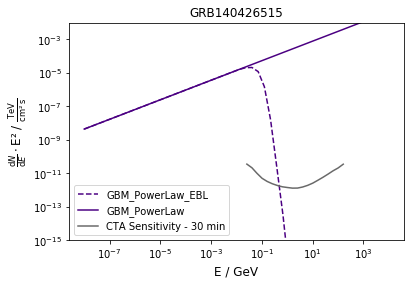

Start simulation for GRB110809461 with (random?) redshift =  2.14344765963
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


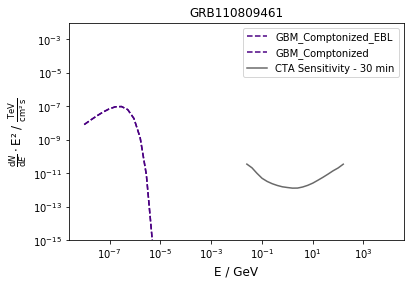

Start simulation for GRB160101030 with (random?) redshift =  2.03573721886
Start IRF part
Ready
792.7946469076203 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


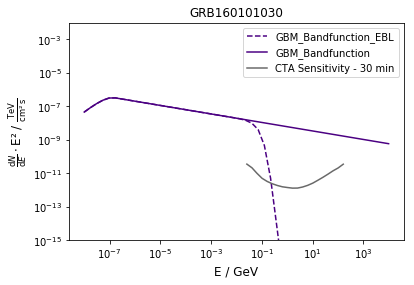

Start simulation for GRB090516853 with (random?) redshift =  8.15961590689
Start IRF part
Ready
12411.941044578934 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


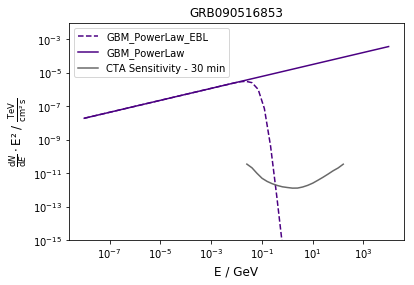

Start simulation for GRB111001804 with (random?) redshift =  1.42075268749
Start IRF part
Ready
112210.65310886642 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


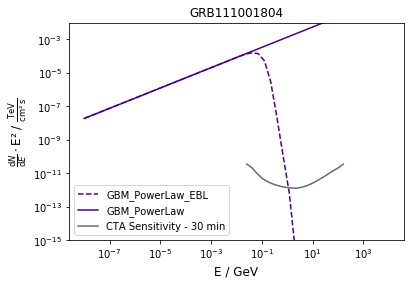

Start simulation for GRB130114019 with (random?) redshift =  2.79217197036
Start IRF part
Ready
1007.798597428086 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


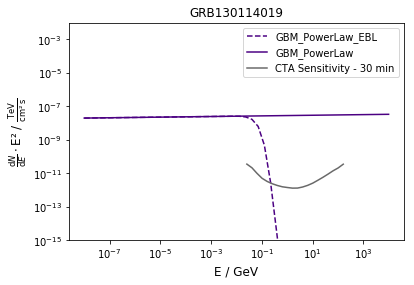

Start simulation for GRB110318552 with (random?) redshift =  2.7869609094
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


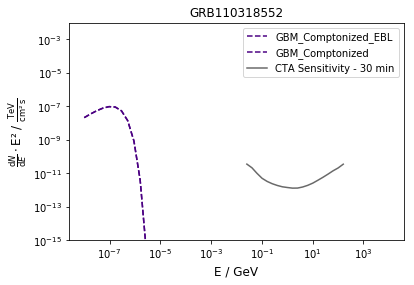

Start simulation for GRB100728095 with (random?) redshift =  1.10198077273
Start IRF part
Ready
28.13027331556543 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


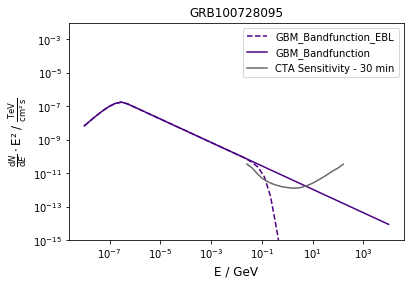

Start simulation for GRB081017474 with (random?) redshift =  2.66897918074
Start IRF part
Ready
2915.0207158199623 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


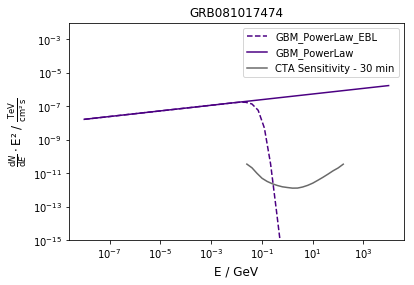

Start simulation for GRB170430204 with (random?) redshift =  3.89035318464
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


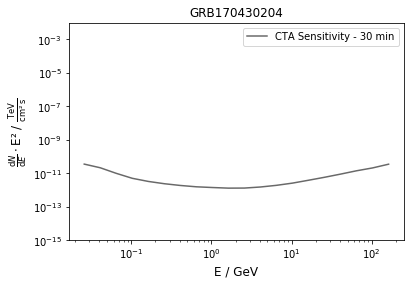

Start simulation for GRB170419898 with (random?) redshift =  0.436582969193
Start IRF part
Ready
765.0984875842687 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


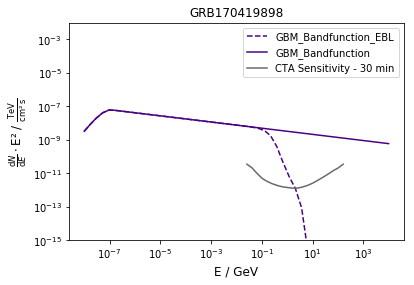

Start simulation for GRB140512814 with (random?) redshift =  2.86506664765
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


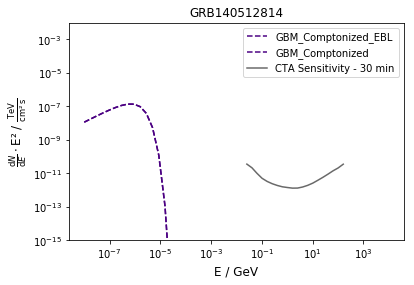

Start simulation for GRB160515819 with (random?) redshift =  2.54662441868
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


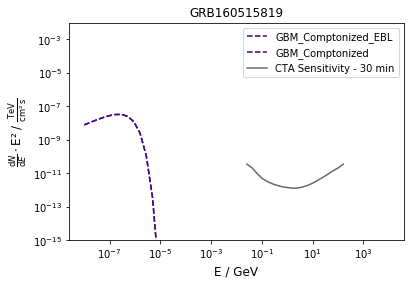

Start simulation for GRB080817161 with (random?) redshift =  2.73684772362
Start IRF part
Ready
1528.8328959752525 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


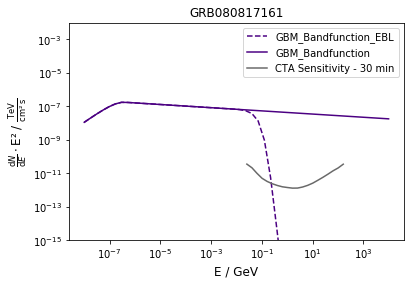

Start simulation for GRB150424403 with (random?) redshift =  2.02658711967
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


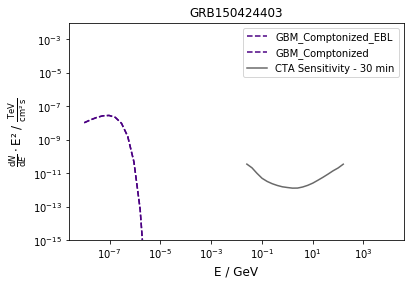

Start simulation for GRB120831901 with (random?) redshift =  1.71364791063
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


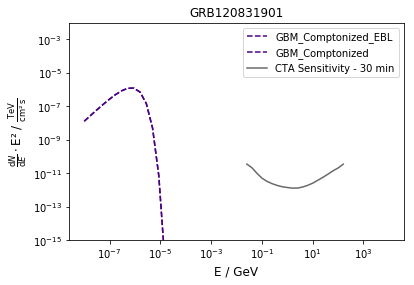

Start simulation for GRB101201418 with (random?) redshift =  0.764019940026
Start IRF part
Ready
7459.505191706583 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


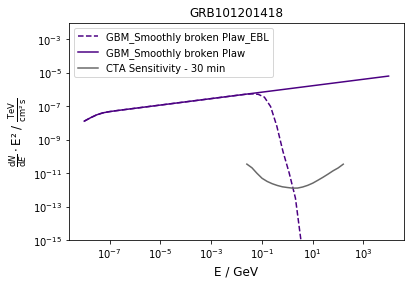

Start simulation for GRB111117526 with (random?) redshift =  2.34015380583
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


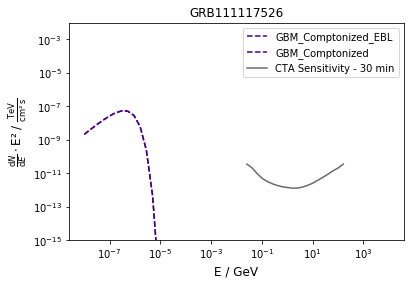

Start simulation for GRB080807993 with (random?) redshift =  0.777535771772
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


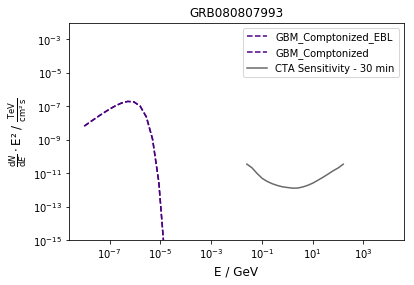

Start simulation for GRB110410133 with (random?) redshift =  0.44038807102
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


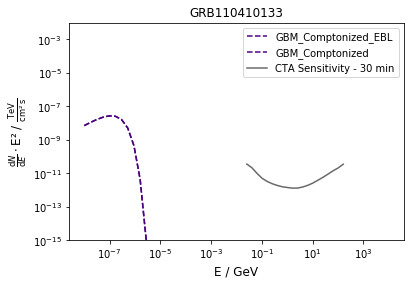

Start simulation for GRB160710233 with (random?) redshift =  3.08315356145
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


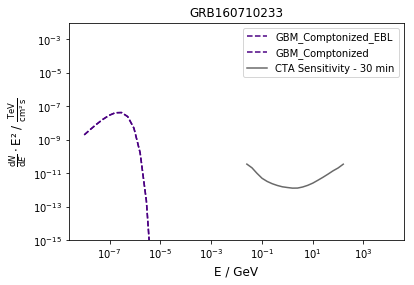

Start simulation for GRB170208940 with (random?) redshift =  0.731495738261
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


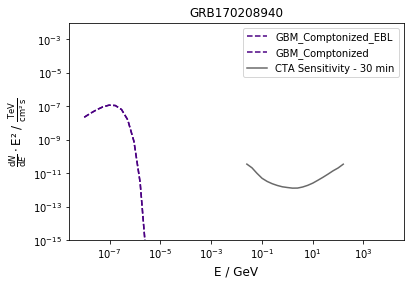

Start simulation for GRB161230511 with (random?) redshift =  3.77407628315
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


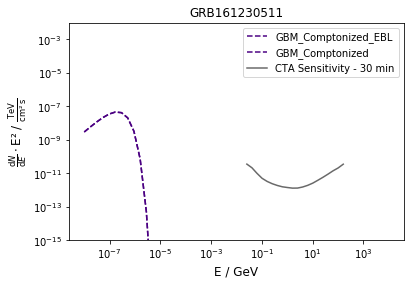

Start simulation for GRB090319622 with (random?) redshift =  3.91942315245
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


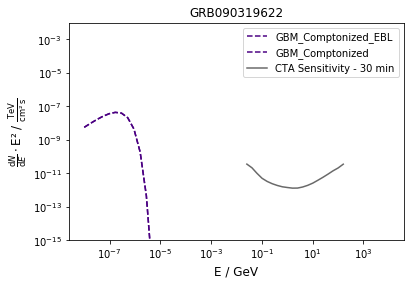

Start simulation for GRB140104731 with (random?) redshift =  2.71785176253
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


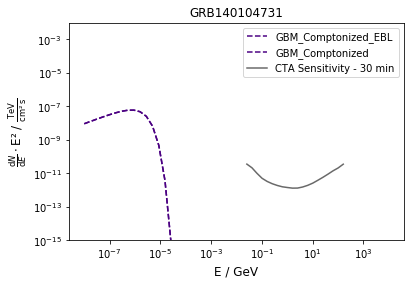

Start simulation for GRB120429003 with (random?) redshift =  2.41504312045
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


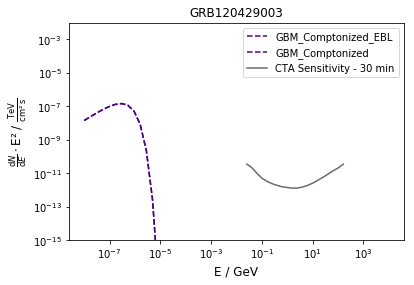

Start simulation for GRB140106345 with (random?) redshift =  2.13346356879
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


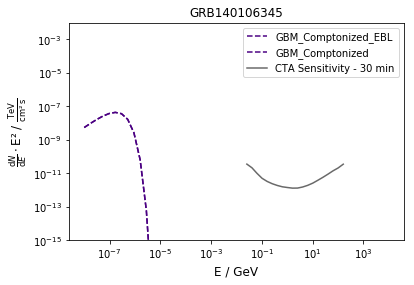

Start simulation for GRB110426629 with (random?) redshift =  0.861836362287
Start IRF part
Ready
2680.661670351635 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


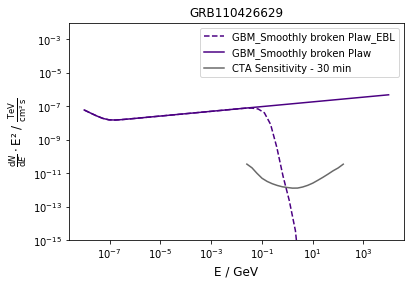

Start simulation for GRB140712706 with (random?) redshift =  1.68213417238
Start IRF part
Ready
18814.454357703908 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


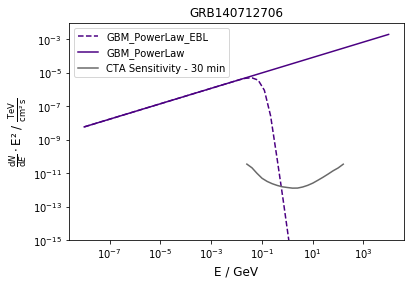

Start simulation for GRB170402285 with (random?) redshift =  2.65879439185
Start IRF part
Ready
734.0129738673363 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


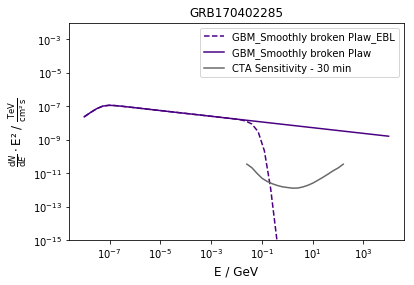

Start simulation for GRB170915520 with (random?) redshift =  3.83555478458
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


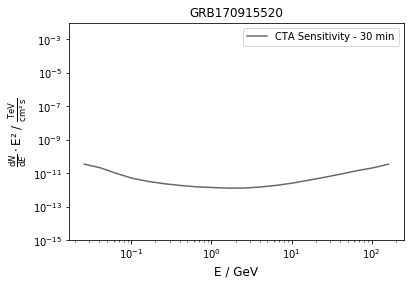

Start simulation for GRB111103441 with (random?) redshift =  1.5841798553
Start IRF part
Ready
3155.9912639169806 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


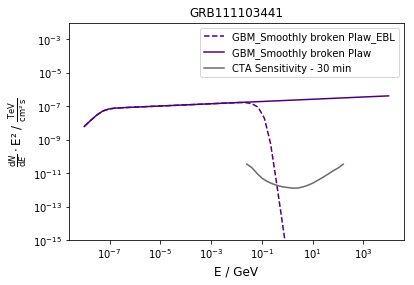

Start simulation for GRB171010792 with (random?) redshift =  0.90567653101
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


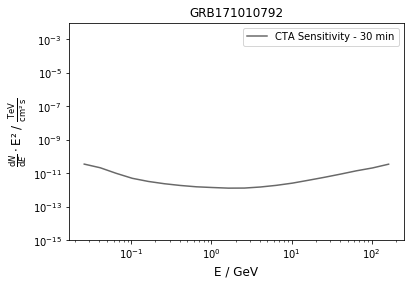

Start simulation for GRB120402669 with (random?) redshift =  0.353314094371
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


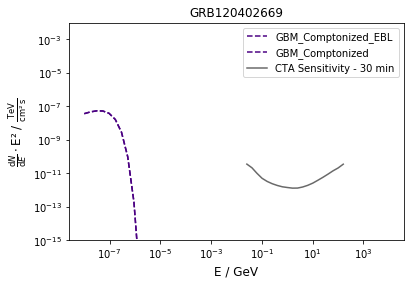

Start simulation for GRB100517154 with (random?) redshift =  1.14674008604
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


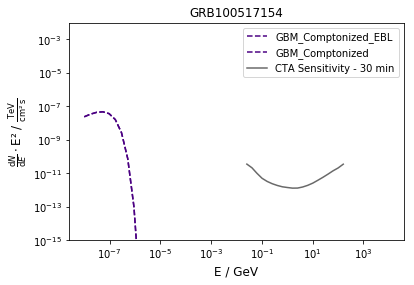

Start simulation for GRB090720276 with (random?) redshift =  3.2379243544
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


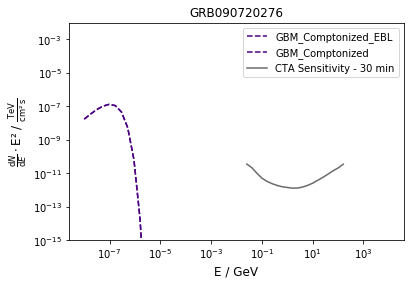

Start simulation for GRB150303516 with (random?) redshift =  1.58526953679
Start IRF part
Ready
1724.4479675527339 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


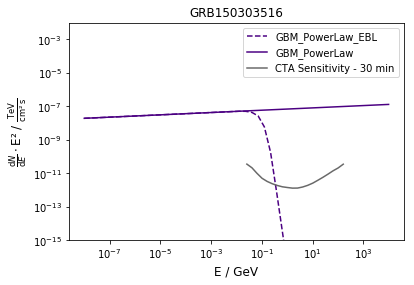

Start simulation for GRB081130629 with (random?) redshift =  1.76171670522
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


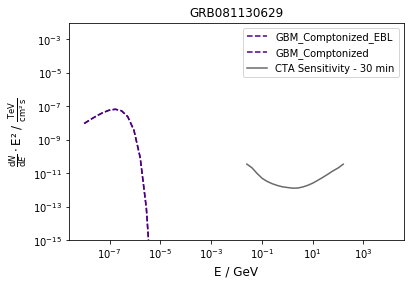

Start simulation for GRB170813051 with (random?) redshift =  3.76951976726
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


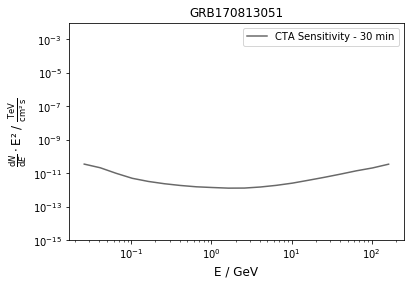

Start simulation for GRB131030791 with (random?) redshift =  1.60944859328
Start IRF part
Ready
15286.708836363929 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


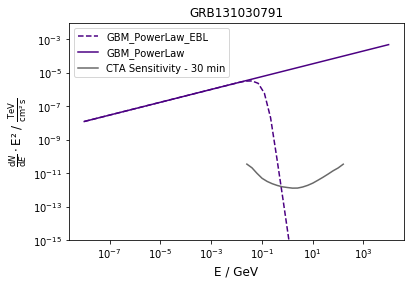

Start simulation for GRB170520202 with (random?) redshift =  7.13544096098
Start IRF part
Ready
1593.3248162632785 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


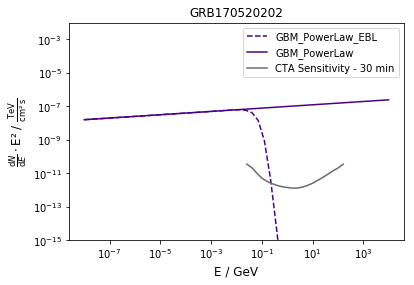

Start simulation for GRB130628531 with (random?) redshift =  1.25132990425
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


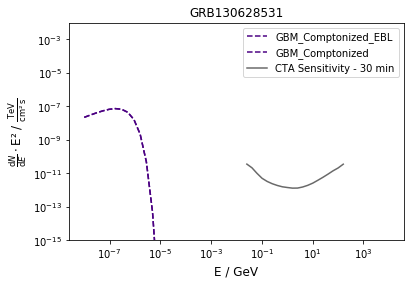

Start simulation for GRB150213001 with (random?) redshift =  1.05335942733
Start IRF part
Ready
41.016036683215475 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


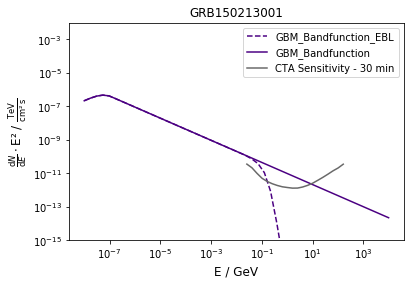

Start simulation for GRB080825593 with (random?) redshift =  9.2806425155
Start IRF part
Ready
517.6515628527575 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


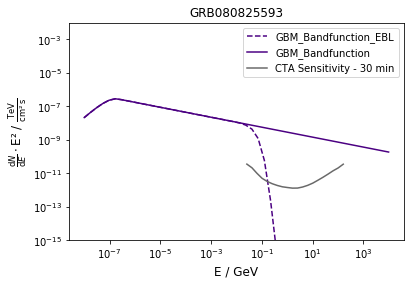

Start simulation for GRB080816989 with (random?) redshift =  2.47933616583
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


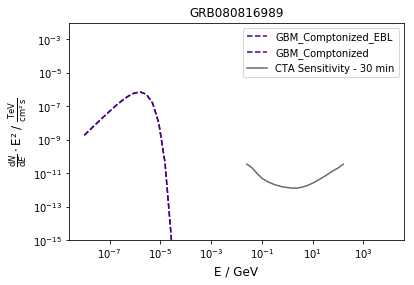

Start simulation for GRB090718720 with (random?) redshift =  2.95962782772
Start IRF part
Ready
23906.795430285096 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


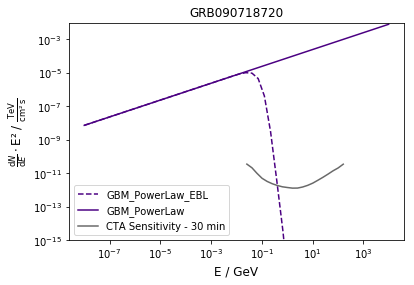

Start simulation for GRB160726065 with (random?) redshift =  1.72536532424
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


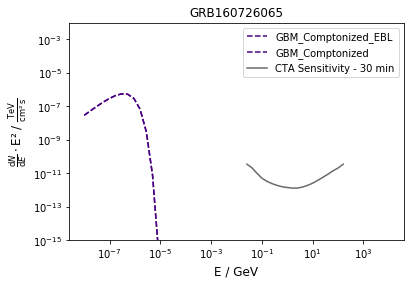

Start simulation for GRB150705588 with (random?) redshift =  3.85911899196
Start IRF part
Ready
11151.661645995842 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


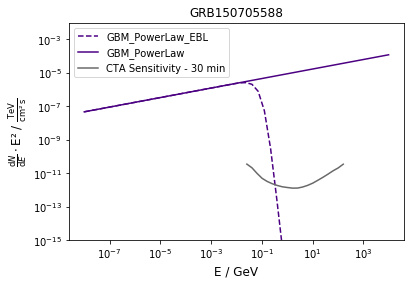

Start simulation for GRB100707032 with (random?) redshift =  5.72763893162
Start IRF part
Ready
2594.0899412648714 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


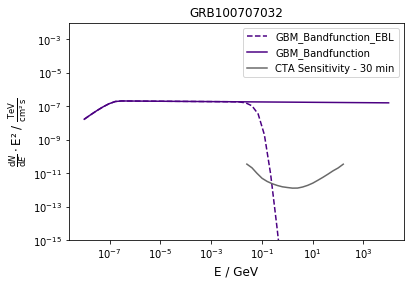

Start simulation for GRB090625234 with (random?) redshift =  1.61354968271
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


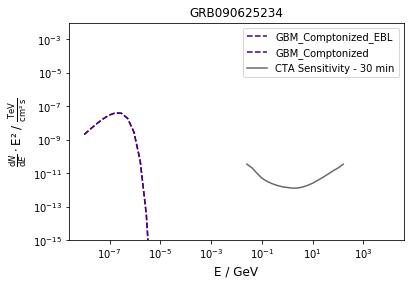

Start simulation for GRB170516808 with (random?) redshift =  0.3726225046
Start IRF part
Ready
327509.73073869635 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


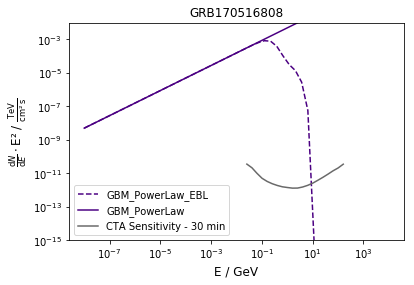

Start simulation for GRB080906212 with (random?) redshift =  0.956055774801
Start IRF part
Ready
1772.4201567163184 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


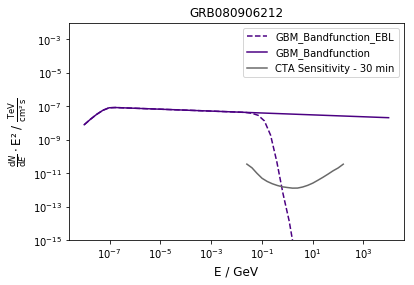

Start simulation for GRB090929190 with (random?) redshift =  1.60551286113
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


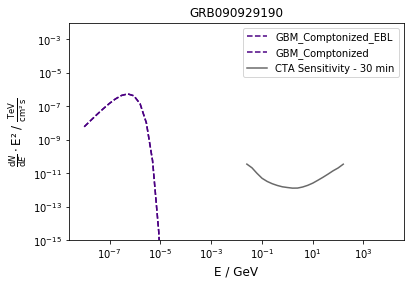

Start simulation for GRB120411925 with (random?) redshift =  0.888660169388
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


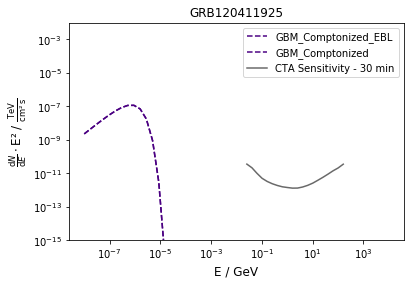

Start simulation for GRB080912360 with (random?) redshift =  1.24295341618
Start IRF part
Ready
7928.584501428235 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


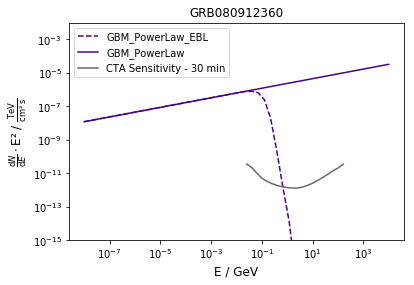

Start simulation for GRB130908677 with (random?) redshift =  1.35518418874
Start IRF part
Ready
62506.80275004832 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


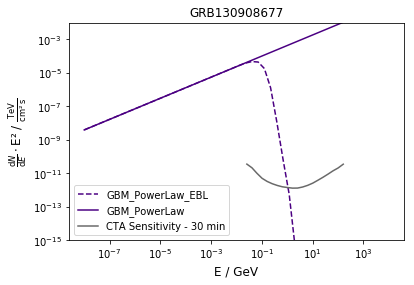

Start simulation for GRB120118709 with (random?) redshift =  1.07213000848
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


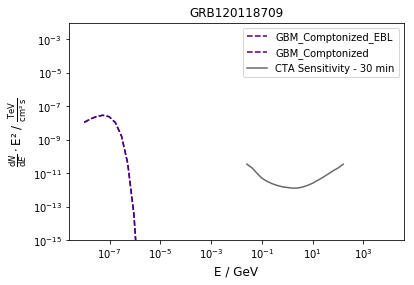

Start simulation for GRB130924255 with (random?) redshift =  3.49126529969
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


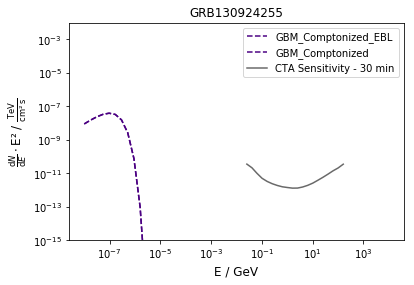

Start simulation for GRB160310016 with (random?) redshift =  0.963068544058
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


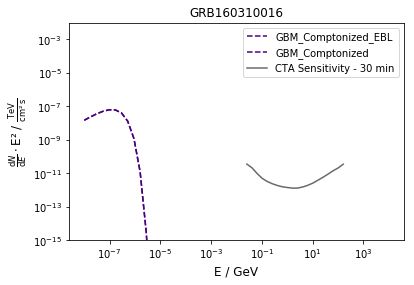

Start simulation for GRB101104810 with (random?) redshift =  1.10139938845
Start IRF part
Ready
17372.393768001242 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


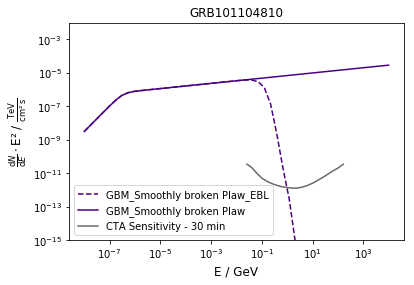

Start simulation for GRB111113410 with (random?) redshift =  1.99739918045
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


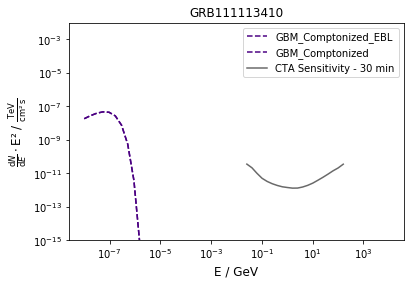

Start simulation for GRB110618760 with (random?) redshift =  1.60236238081
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


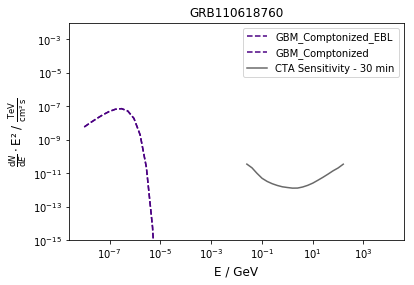

Start simulation for GRB101031625 with (random?) redshift =  1.25531493925
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


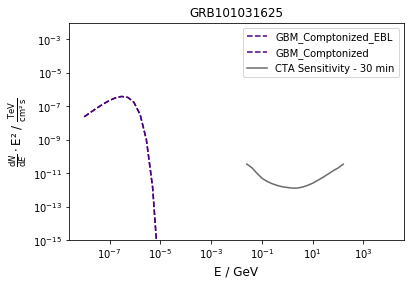

Start simulation for GRB120223933 with (random?) redshift =  1.39719352059
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


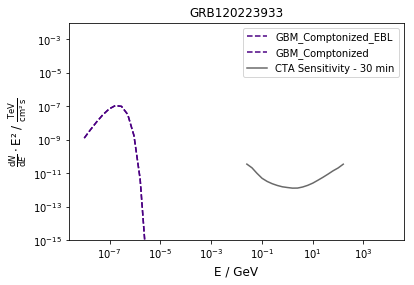

Start simulation for GRB170705244 with (random?) redshift =  1.79581642503
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


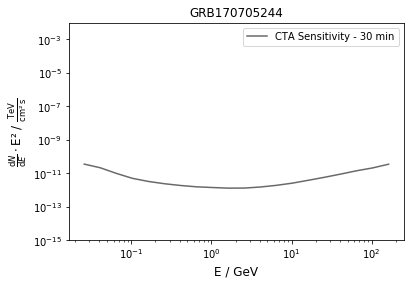

Start simulation for GRB090326633 with (random?) redshift =  1.96437511677
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


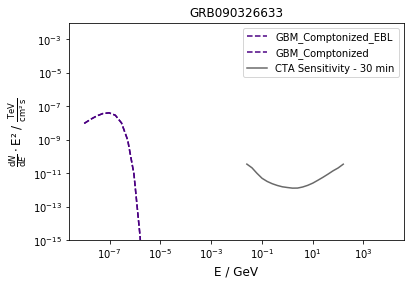

Start simulation for GRB120604220 with (random?) redshift =  3.44672744066
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


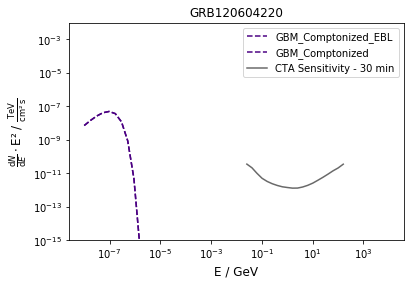

Start simulation for GRB170611937 with (random?) redshift =  1.72638856846
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


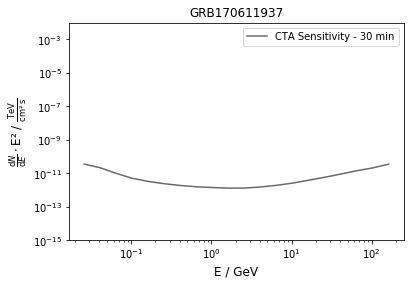

Start simulation for GRB081206987 with (random?) redshift =  4.12171238165
Start IRF part
Ready
22093.492730491238 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


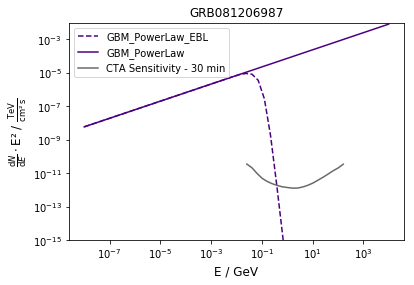

Start simulation for GRB140206275 with (random?) redshift =  4.17690630168
Start IRF part
Ready
1807.344117345393 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


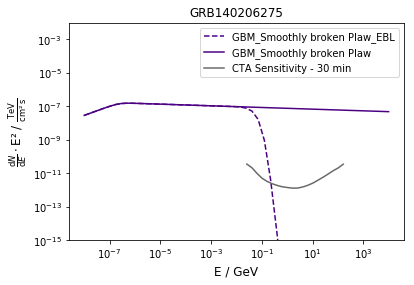

Start simulation for GRB120129312 with (random?) redshift =  1.93052308947
Start IRF part
Ready
163140.47747253478 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


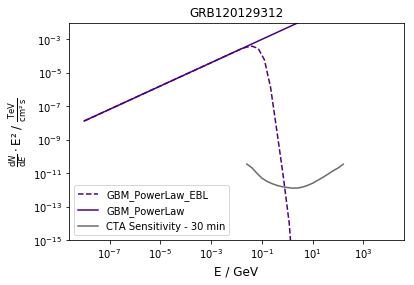

Start simulation for GRB101025146 with (random?) redshift =  3.1011315192
Start IRF part
Ready
49626.47786553915 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


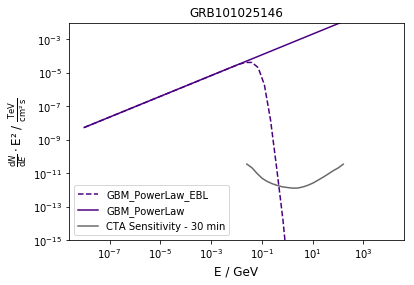

Start simulation for GRB090217206 with (random?) redshift =  0.806951682426
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


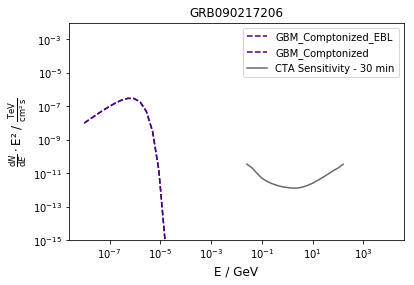

Start simulation for GRB150127398 with (random?) redshift =  0.739527752897
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


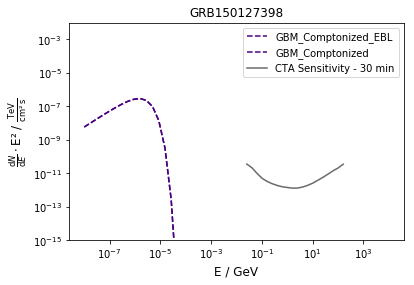

Start simulation for GRB160104918 with (random?) redshift =  2.89470851136
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


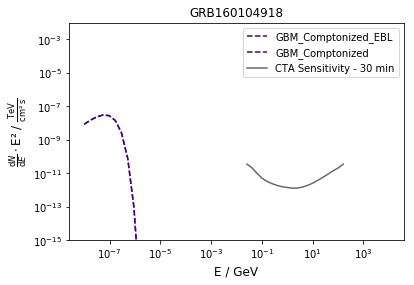

Start simulation for GRB100401297 with (random?) redshift =  2.14282683948
Start IRF part
Ready
1299.0762029310379 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


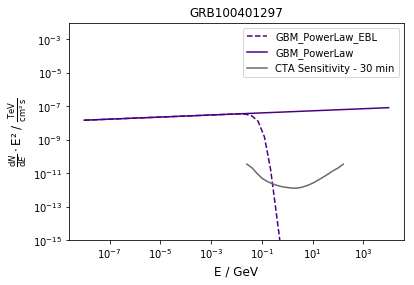

Start simulation for GRB150906944 with (random?) redshift =  0.297507635745
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


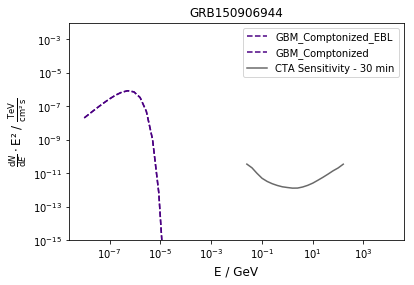

Start simulation for GRB090409288 with (random?) redshift =  3.14172644662
Start IRF part
Ready
47252.28914284353 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


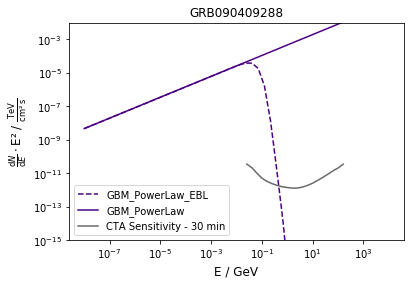

Start simulation for GRB120531393 with (random?) redshift =  1.02990760482
Start IRF part
Ready
46922.04953359328 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


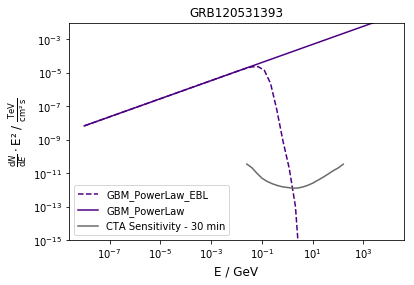

Start simulation for GRB110824009 with (random?) redshift =  0.720005918819
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


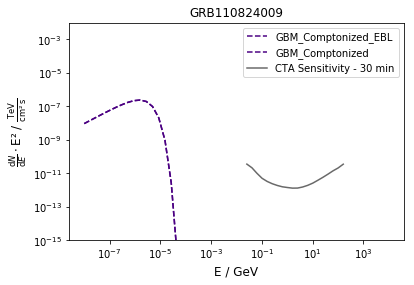

Start simulation for GRB140102887 with (random?) redshift =  2.58191806557
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


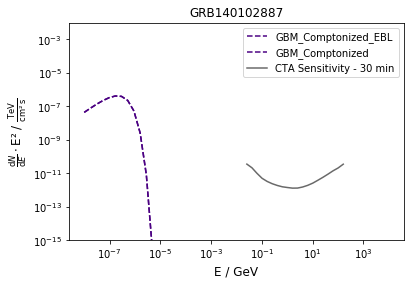

Start simulation for GRB160920249 with (random?) redshift =  0.432912316614
Start IRF part
Ready
15227.053252176052 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


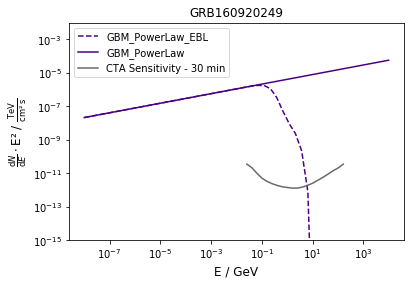

Start simulation for GRB170130510 with (random?) redshift =  0.340255810166
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


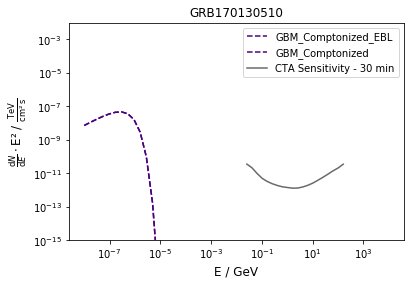

Start simulation for GRB130404428 with (random?) redshift =  0.814653610398
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


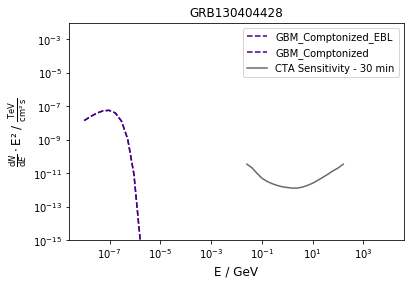

Start simulation for GRB131231198 with (random?) redshift =  2.45453097266
Start IRF part
Ready
658.5547364533525 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


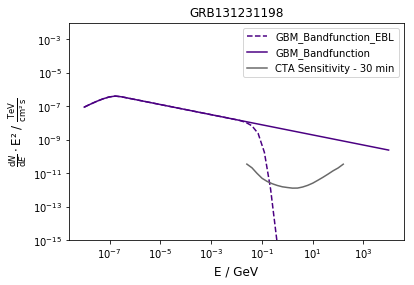

Start simulation for GRB150520893 with (random?) redshift =  0.533359785345
Start IRF part
Ready
2085.1117459445873 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


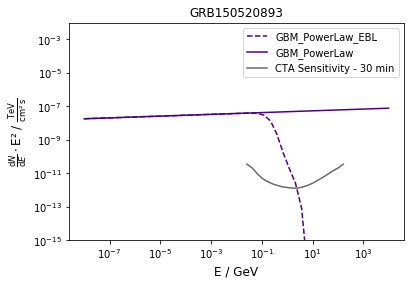

Start simulation for GRB100810049 with (random?) redshift =  1.84839589503
Start IRF part
Ready
5375.844312561867 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


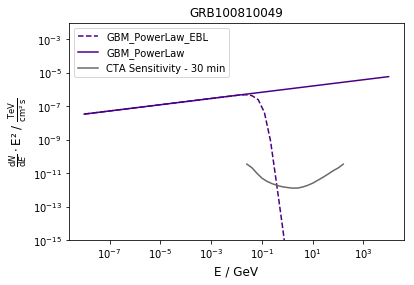

Start simulation for GRB110923481 with (random?) redshift =  1.53067913179
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


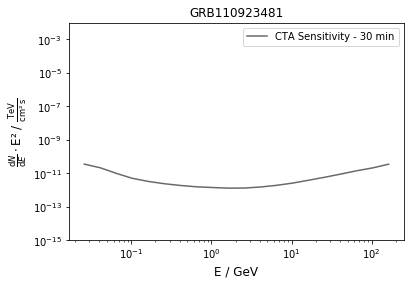

Start simulation for GRB170901007 with (random?) redshift =  3.14656653602
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


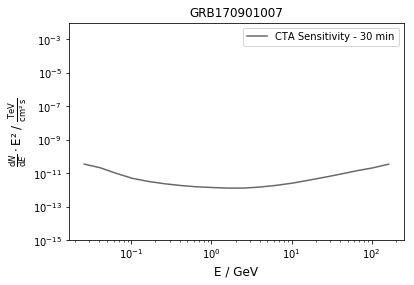

Start simulation for GRB150220598 with (random?) redshift =  4.87865929089
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


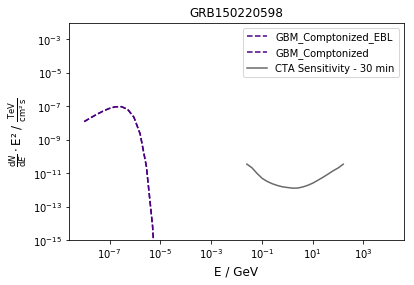

Start simulation for GRB100117879 with (random?) redshift =  1.66616034516
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


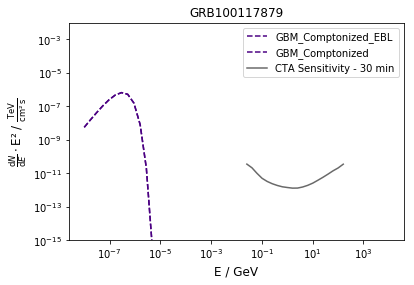

Start simulation for GRB131031482 with (random?) redshift =  2.84521018213
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


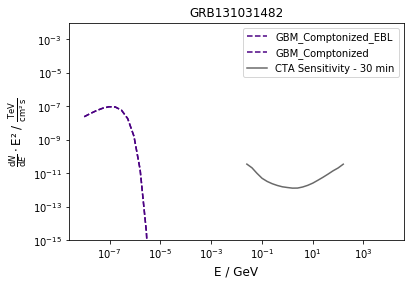

Start simulation for GRB170101116 with (random?) redshift =  4.34357446315
Start IRF part
Ready
610.8718732722533 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


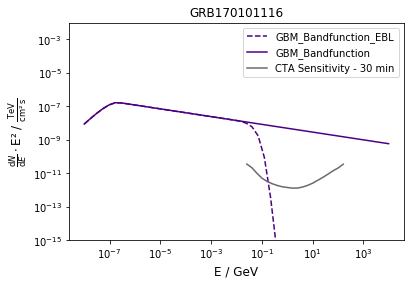

Start simulation for GRB091202072 with (random?) redshift =  2.73215443453
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


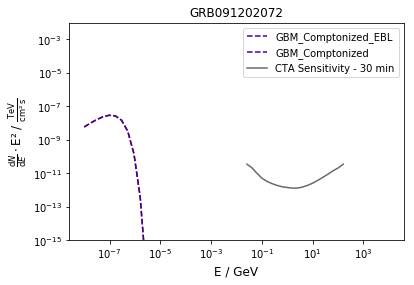

Start simulation for GRB170214649 with (random?) redshift =  2.11451374348
Start IRF part
Ready
982.0608525856438 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


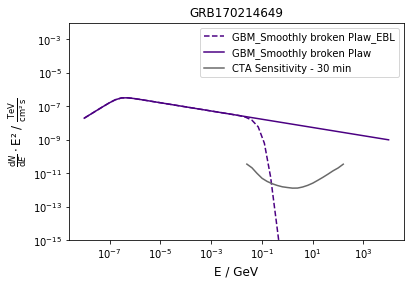

Start simulation for GRB140724533 with (random?) redshift =  1.34628670056
Start IRF part
Ready
75073.06328960475 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


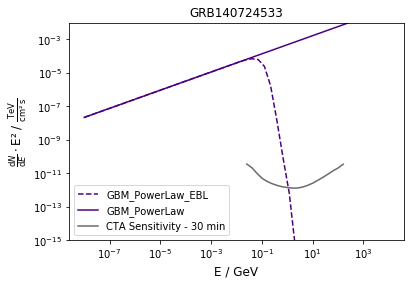

Start simulation for GRB100612726 with (random?) redshift =  0.295023830183
Start IRF part
Ready
172.14320318003217 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


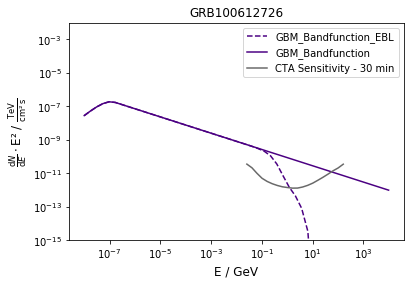

Start simulation for GRB130214137 with (random?) redshift =  1.03338661291
Start IRF part
Ready
11937.38644968703 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


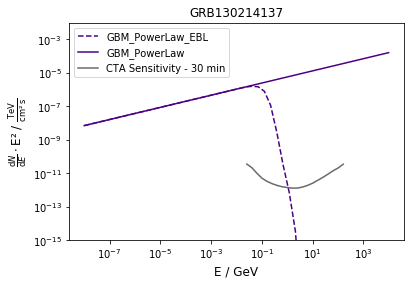

Start simulation for GRB171025416 with (random?) redshift =  3.24047047264
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


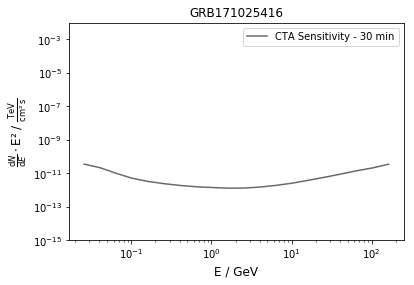

Start simulation for GRB111024896 with (random?) redshift =  1.08542804019
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


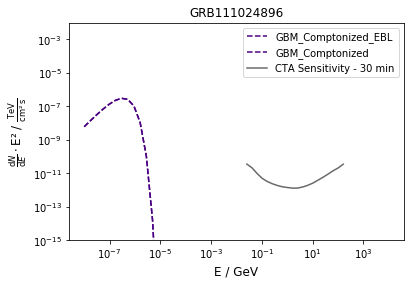

Start simulation for GRB141020439 with (random?) redshift =  3.03754725216
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


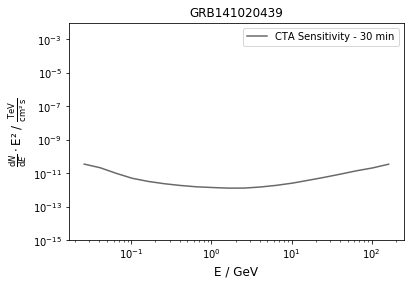

Start simulation for GRB120604343 with (random?) redshift =  1.46404760709
Start IRF part
Ready
6286.164723397043 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


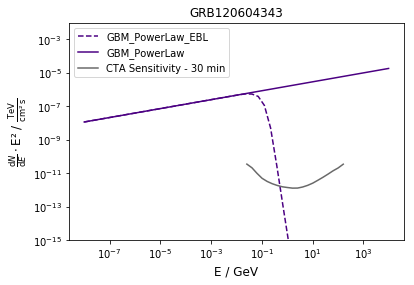

Start simulation for GRB090815300 with (random?) redshift =  0.720428875193
Start IRF part
Ready
36792.59193422405 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


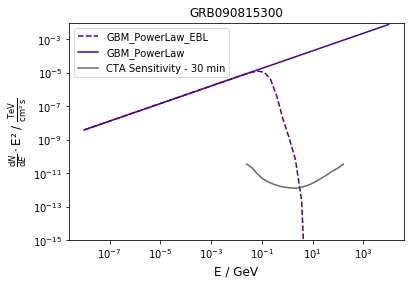

Start simulation for GRB100122616 with (random?) redshift =  2.54319439932
Start IRF part
Ready
255.4390500675 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


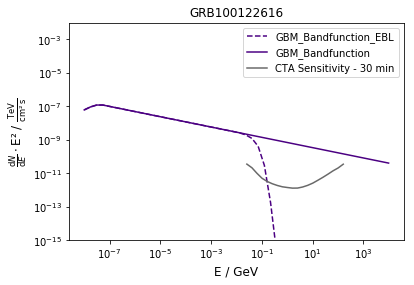

Start simulation for GRB130527627 with (random?) redshift =  5.14153628216
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


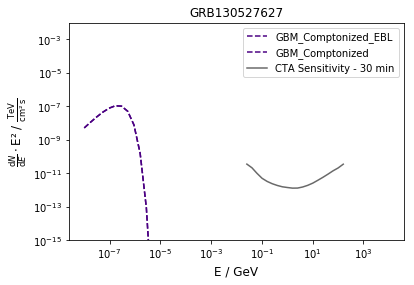

Start simulation for GRB130803419 with (random?) redshift =  0.829746164502
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


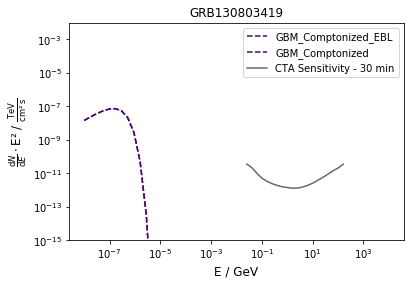

Start simulation for GRB131117766 with (random?) redshift =  0.667859038714
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


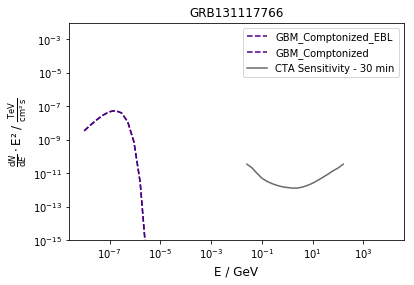

Start simulation for GRB130905377 with (random?) redshift =  7.53177889145
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


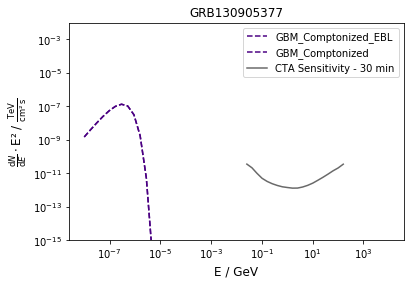

Start simulation for GRB150922234 with (random?) redshift =  1.77703084339
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


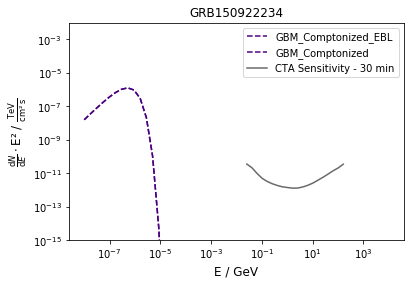

Start simulation for GRB160220868 with (random?) redshift =  0.866376243558
Start IRF part
Ready
57944.49619559472 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


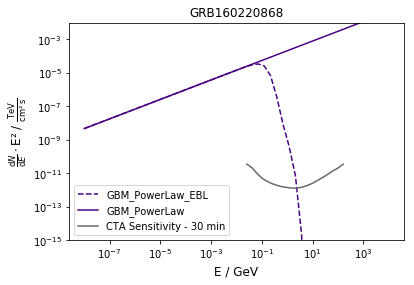

Start simulation for GRB130628860 with (random?) redshift =  1.52083014049
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


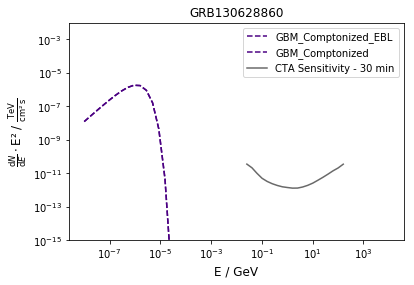

Start simulation for GRB110706202 with (random?) redshift =  2.46049326692
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


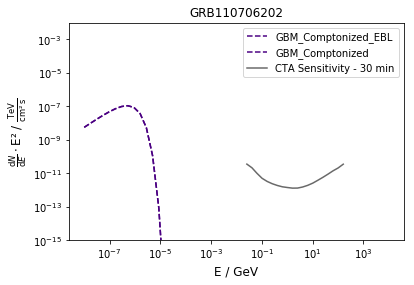

Start simulation for GRB160731024 with (random?) redshift =  3.06871592262
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


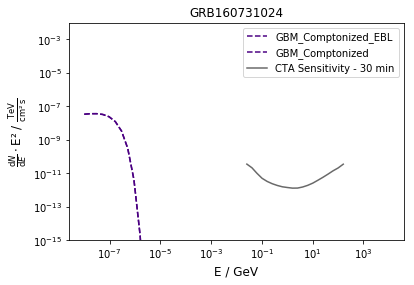

Start simulation for GRB160806584 with (random?) redshift =  1.55758447772
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


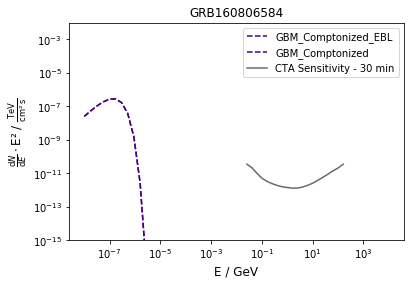

Start simulation for GRB090429753 with (random?) redshift =  3.7757098033
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


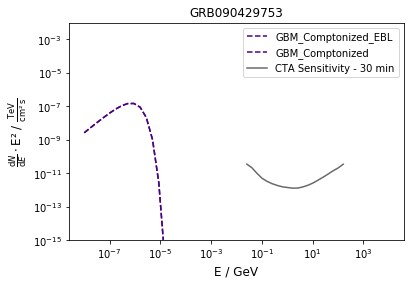

Start simulation for GRB110517573 with (random?) redshift =  1.02600029357
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


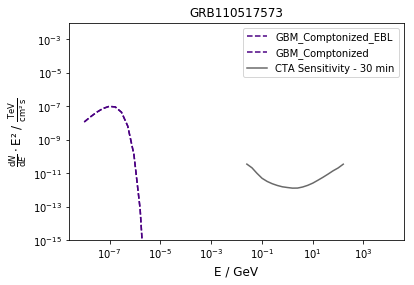

Start simulation for GRB170318644 with (random?) redshift =  0.43421422615
Start IRF part
Ready
115674.40784324681 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


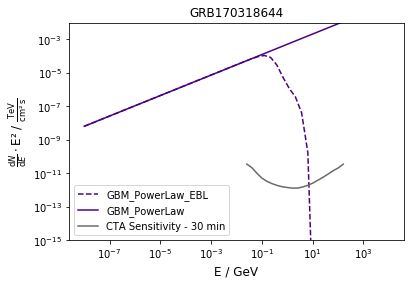

Start simulation for GRB110722694 with (random?) redshift =  3.4125734657
Start IRF part
Ready
5409.109612945801 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


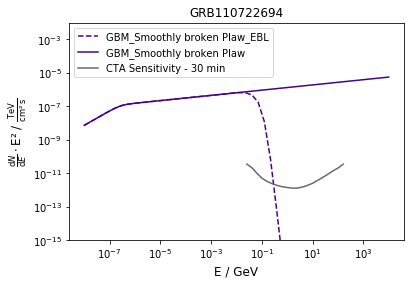

Start simulation for GRB120111051 with (random?) redshift =  1.24179572979
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


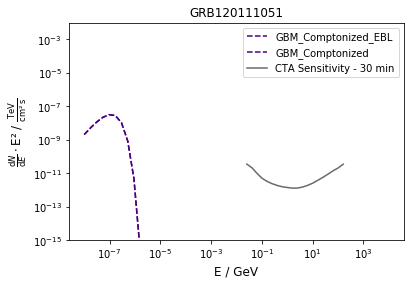

Start simulation for GRB090411991 with (random?) redshift =  1.02757547848
Start IRF part
Ready
1574.1392021620866 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


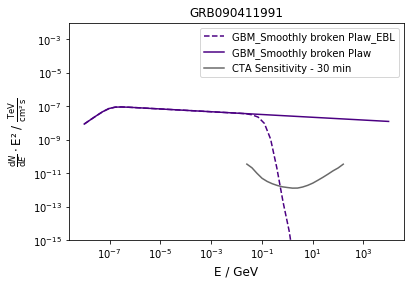

Start simulation for GRB080808565 with (random?) redshift =  0.958117062977
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


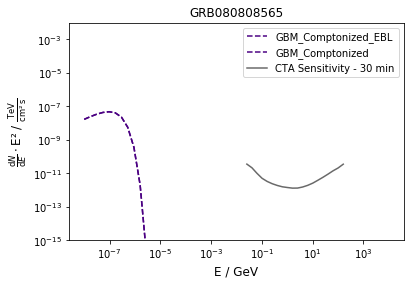

Start simulation for GRB100719989 with (random?) redshift =  0.57091386993
Start IRF part
Ready
1095.8030966570163 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


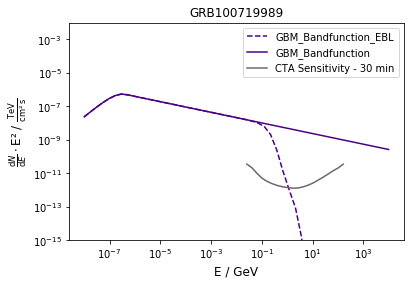

Start simulation for GRB110626448 with (random?) redshift =  1.14009564925
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


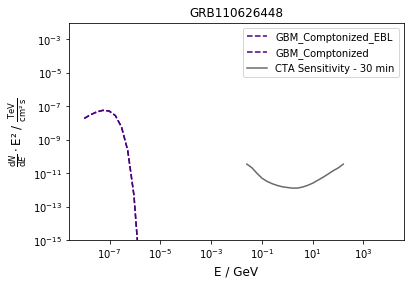

Start simulation for GRB140406120 with (random?) redshift =  4.84764472945
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


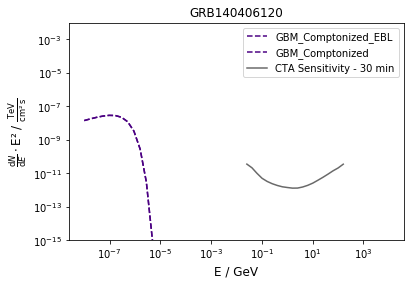

Start simulation for GRB150729517 with (random?) redshift =  4.20753895835
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


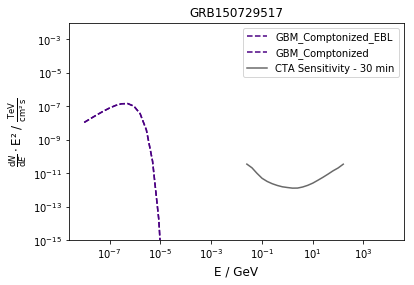

Start simulation for GRB080730520 with (random?) redshift =  0.794744782787
Start IRF part
Ready
3556.3140094862943 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


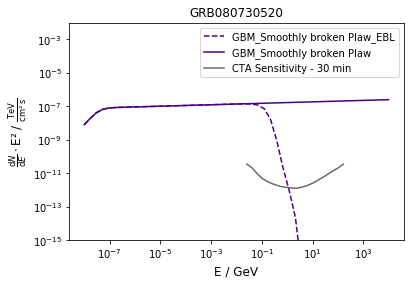

Start simulation for GRB111124308 with (random?) redshift =  1.54165348844
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


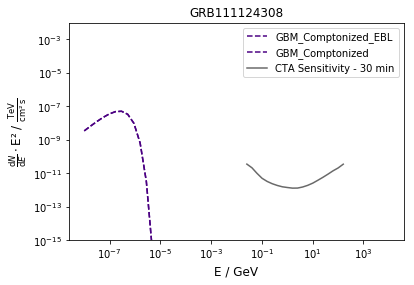

Start simulation for GRB150510139 with (random?) redshift =  0.313924705905
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


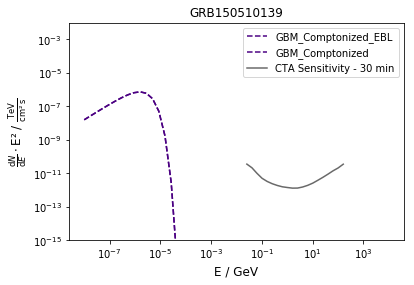

Start simulation for GRB091220442 with (random?) redshift =  1.39702627911
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


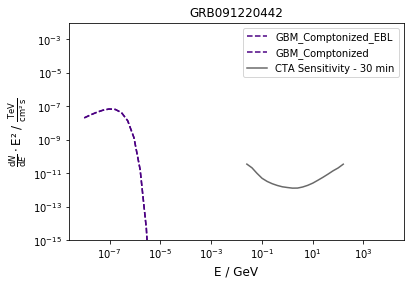

Start simulation for GRB131230808 with (random?) redshift =  1.96470197443
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


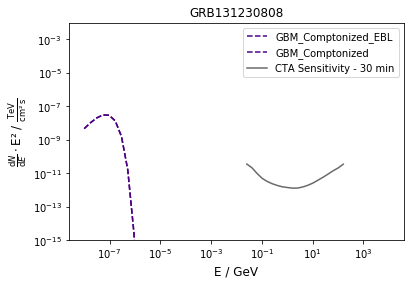

Start simulation for GRB120415891 with (random?) redshift =  1.41740463171
Start IRF part
Ready
184214.96157047 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


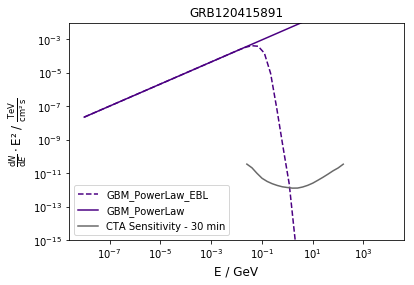

Start simulation for GRB130626596 with (random?) redshift =  4.07498072531
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


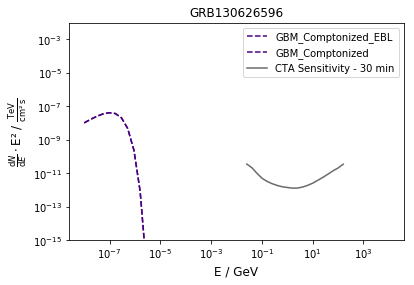

Start simulation for GRB110729142 with (random?) redshift =  1.93344957968
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


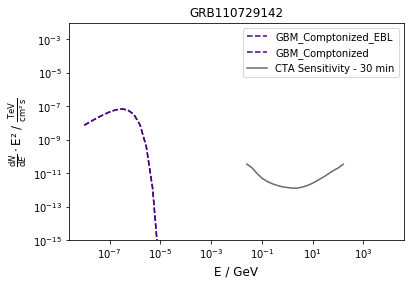

Start simulation for GRB150724782 with (random?) redshift =  2.3869208283
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


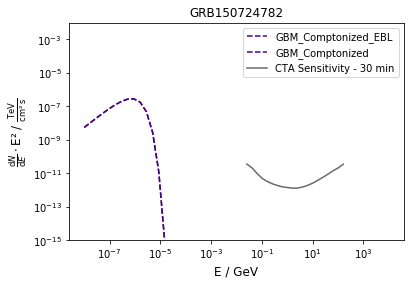

Start simulation for GRB100223110 with (random?) redshift =  1.6255736188
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


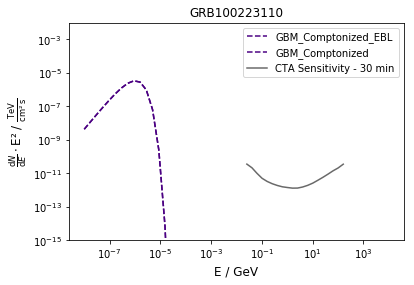

Start simulation for GRB130504978 with (random?) redshift =  2.05751261362
Start IRF part
Ready
2055.341441532501 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


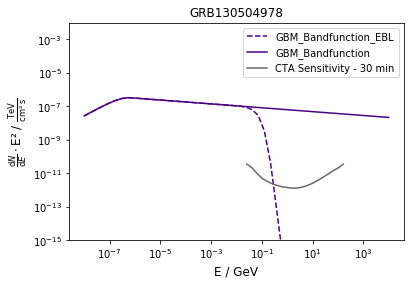

Start simulation for GRB111226795 with (random?) redshift =  1.12293273656
Start IRF part
Ready
186.33283807266608 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


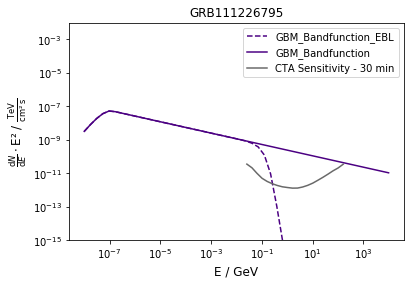

Start simulation for GRB140610689 with (random?) redshift =  3.84744830892
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


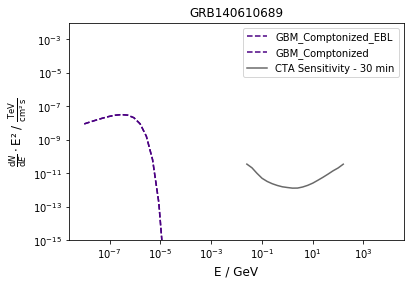

Start simulation for GRB141207800 with (random?) redshift =  0.593692805095
Start IRF part
Ready
1.1767843396719426 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


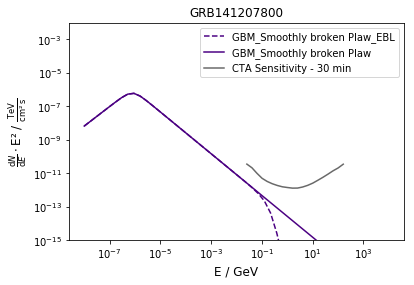

Start simulation for GRB100503554 with (random?) redshift =  0.308233770644
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


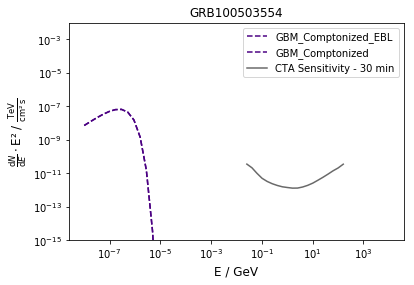

Start simulation for GRB101208203 with (random?) redshift =  1.41564618449
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


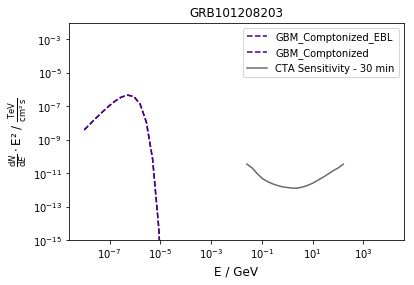

Start simulation for GRB090331681 with (random?) redshift =  0.759484502406
Start IRF part
Ready
289982.2626596176 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


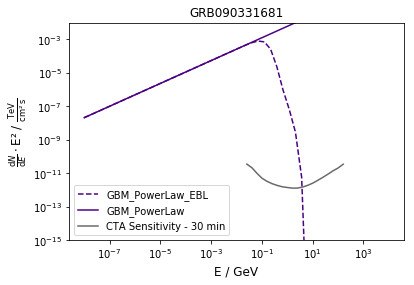

Start simulation for GRB140113183 with (random?) redshift =  3.22487334065
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


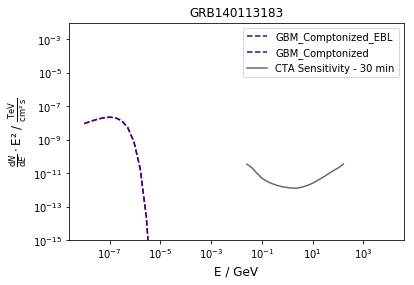

Start simulation for GRB080829790 with (random?) redshift =  2.28410799316
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


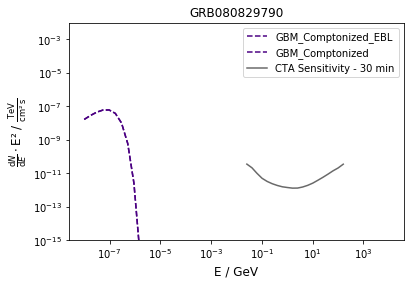

Start simulation for GRB091231540 with (random?) redshift =  0.73663856909
Start IRF part
Ready
19195.614259741153 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


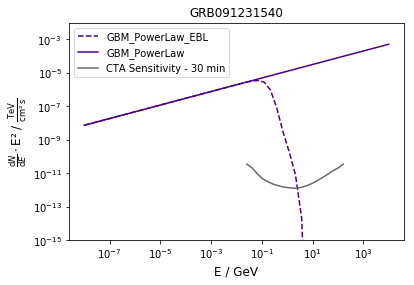

Start simulation for GRB150215026 with (random?) redshift =  3.00588607638
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


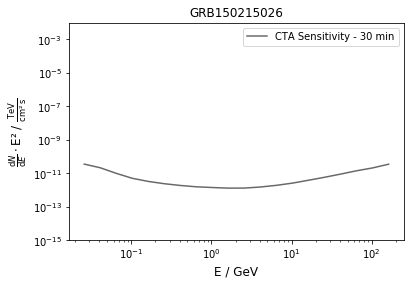

Start simulation for GRB111127810 with (random?) redshift =  2.63354798838
Start IRF part
Ready
154.55427413859735 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


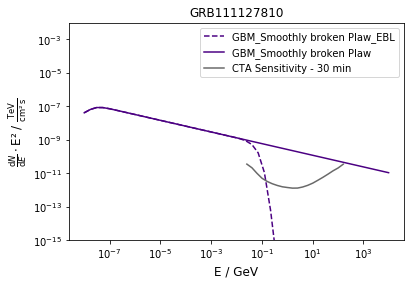

Start simulation for GRB170918139 with (random?) redshift =  1.9660526948
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


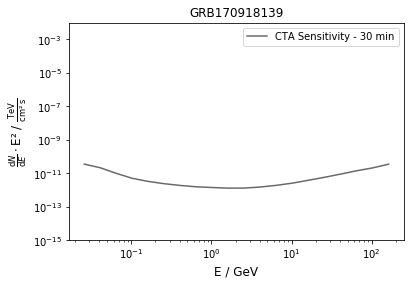

Start simulation for GRB090908314 with (random?) redshift =  1.20844244655
Start IRF part
Ready
25055.48989208695 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


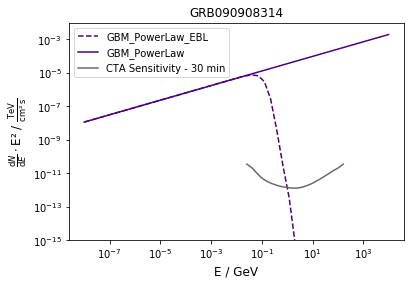

Start simulation for GRB170810918 with (random?) redshift =  2.26541064215
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


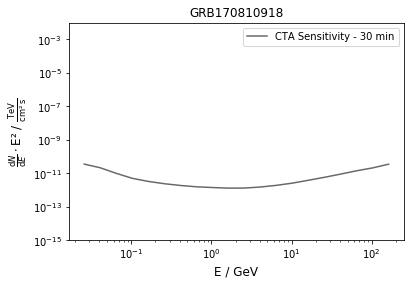

Start simulation for GRB101123952 with (random?) redshift =  5.1037843181
Start IRF part
Ready
2436.069986167286 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


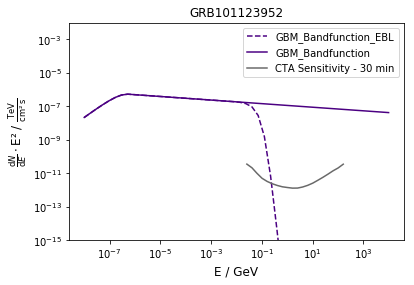

Start simulation for GRB130216790 with (random?) redshift =  2.0028999808
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


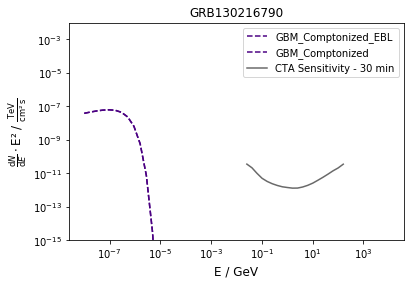

Start simulation for GRB170808936 with (random?) redshift =  4.81778817028
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


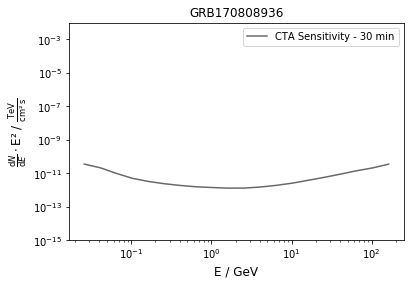

Start simulation for GRB170709334 with (random?) redshift =  4.58764084818
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


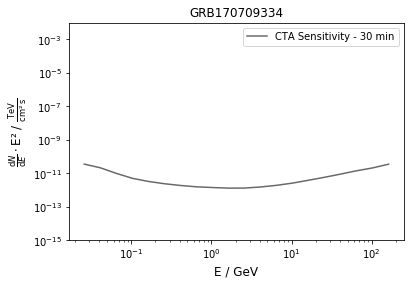

Start simulation for GRB160301215 with (random?) redshift =  3.48913738466
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


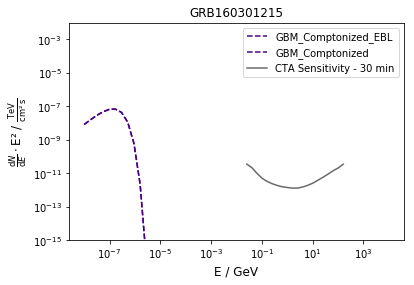

Start simulation for GRB110806934 with (random?) redshift =  2.5917141609
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


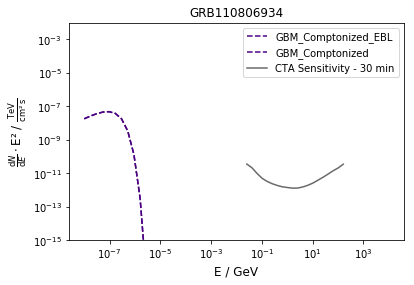

Start simulation for GRB160908136 with (random?) redshift =  3.25475949671
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


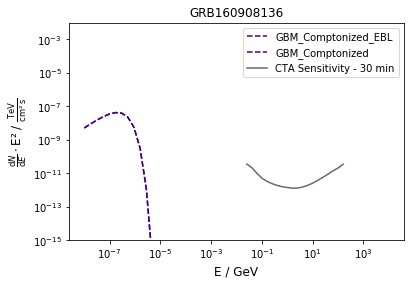

Start simulation for GRB141206254 with (random?) redshift =  1.37113214077
Start IRF part
Ready
11428.388639291963 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


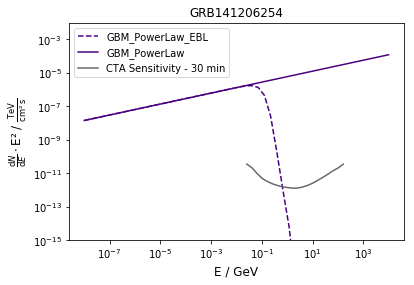

Start simulation for GRB110726211 with (random?) redshift =  2.10682510886
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


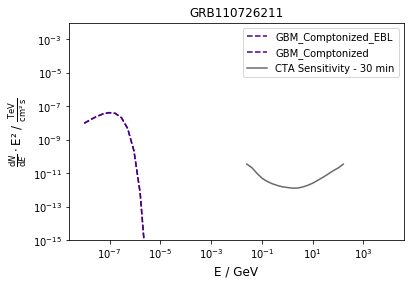

Start simulation for GRB091230260 with (random?) redshift =  2.08957194916
Start IRF part
Ready
21350.198865851147 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


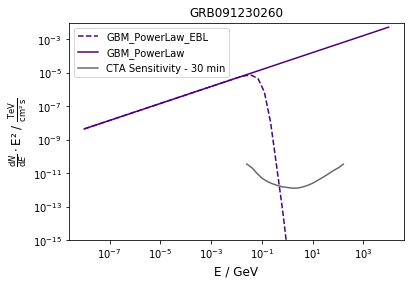

Start simulation for GRB090518080 with (random?) redshift =  0.613680774473
Start IRF part
Ready
33167.975239476975 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


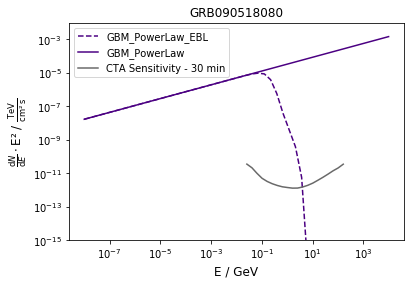

Start simulation for GRB160224911 with (random?) redshift =  1.90867421243
Start IRF part
Ready
75713.34886834135 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


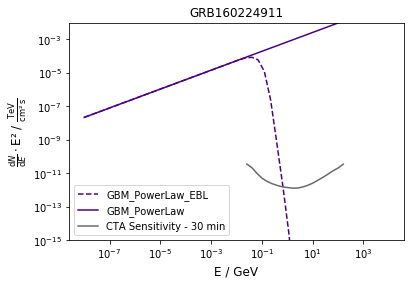

Start simulation for GRB150822178 with (random?) redshift =  2.89087876351
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


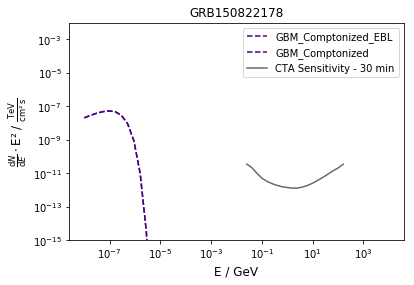

Start simulation for GRB170527480 with (random?) redshift =  2.59244257118
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


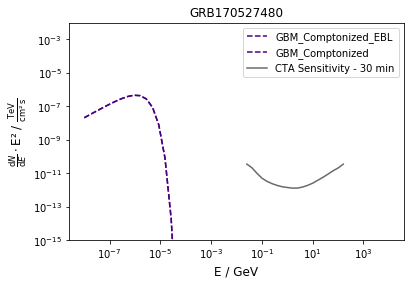

Start simulation for GRB140906429 with (random?) redshift =  1.38827475134
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


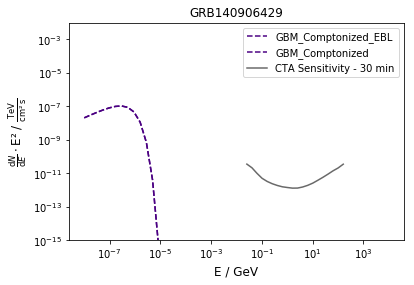

Start simulation for GRB101129726 with (random?) redshift =  0.508922162141
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


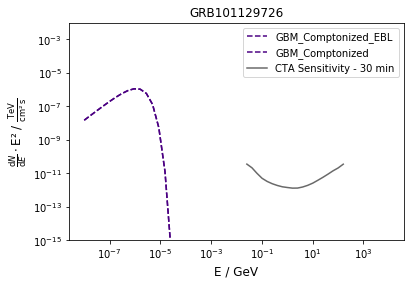

Start simulation for GRB150806348 with (random?) redshift =  2.38966456412
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


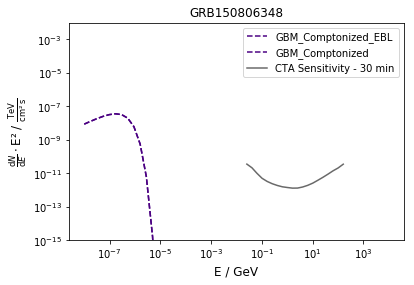

Start simulation for GRB110415541 with (random?) redshift =  2.14669367767
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


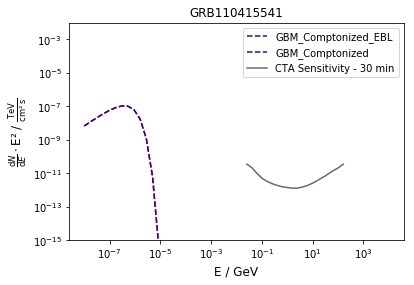

Start simulation for GRB091202219 with (random?) redshift =  5.21053390373
Start IRF part
Ready
1363.8843589944458 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


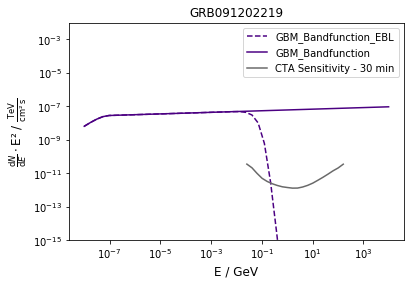

Start simulation for GRB170607971 with (random?) redshift =  2.40641350408
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


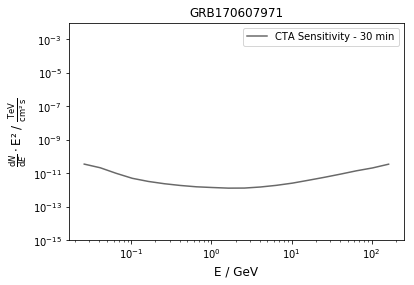

Start simulation for GRB150208573 with (random?) redshift =  2.00687117253
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


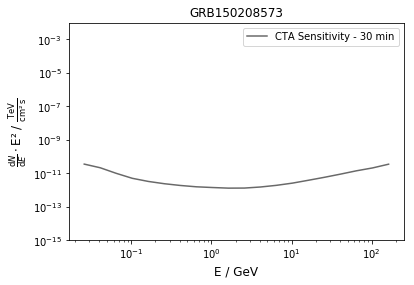

Start simulation for GRB160223072 with (random?) redshift =  0.347186194603
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


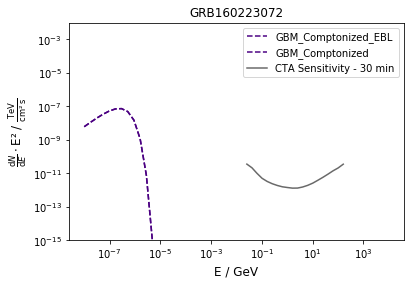

Start simulation for GRB100522157 with (random?) redshift =  1.63083382088
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


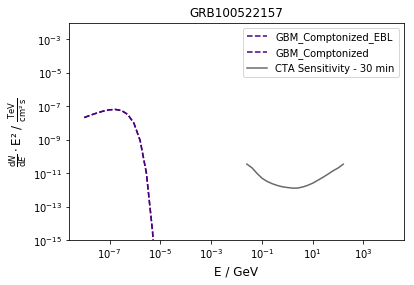

Start simulation for GRB120130906 with (random?) redshift =  2.89650911136
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


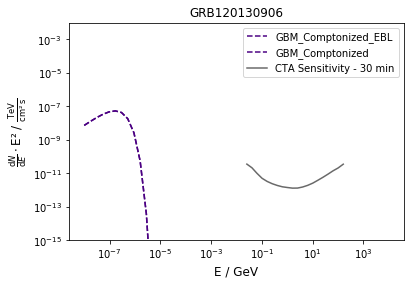

Start simulation for GRB090301315 with (random?) redshift =  9.16780881922
Start IRF part
Ready
36717.610911961594 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


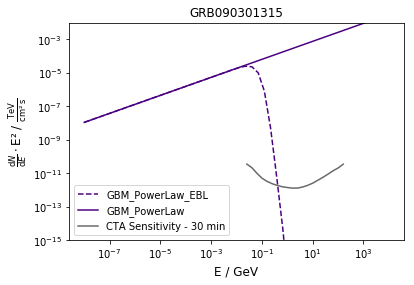

Start simulation for GRB170307851 with (random?) redshift =  0.590946483419
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


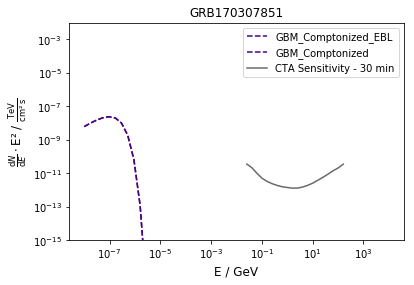

Start simulation for GRB110102788 with (random?) redshift =  4.02410210253
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


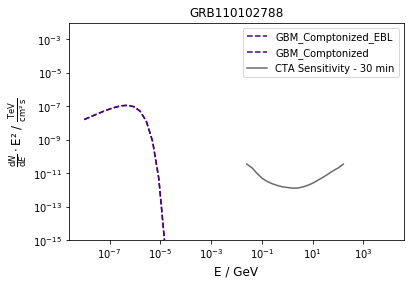

Start simulation for GRB150721242 with (random?) redshift =  1.53995787848
Start IRF part
Ready
32.96153133969289 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


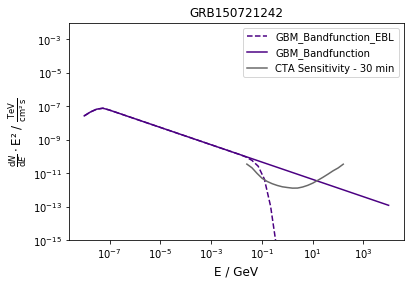

Start simulation for GRB161007009 with (random?) redshift =  5.24828574436
Start IRF part
Ready
15194.75735894478 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


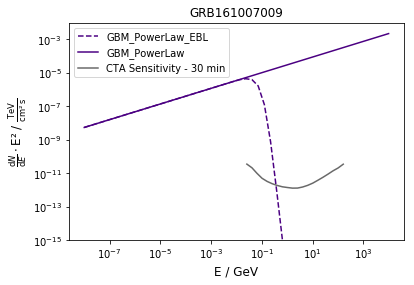

Start simulation for GRB101127093 with (random?) redshift =  2.99031203148
Start IRF part
Ready
17935.599491871308 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


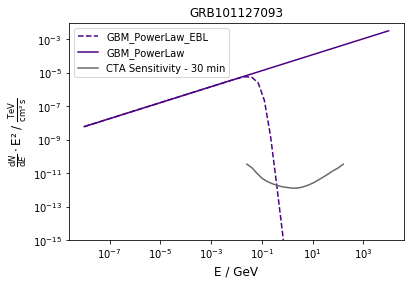

Start simulation for GRB160822672 with (random?) redshift =  0.636640600708
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


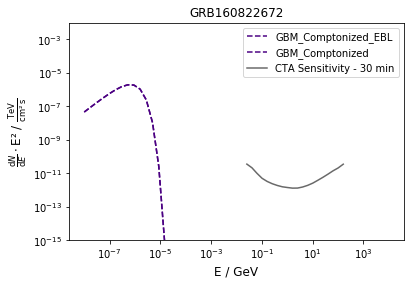

Start simulation for GRB151228949 with (random?) redshift =  0.941804306062
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


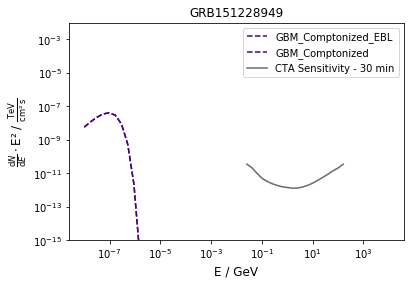

Start simulation for GRB130318456 with (random?) redshift =  1.62114816634
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


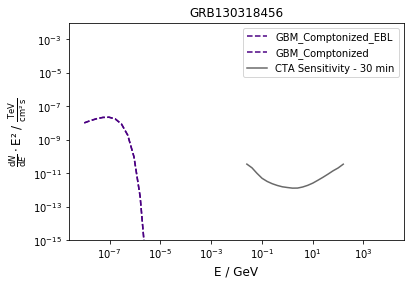

Start simulation for GRB160928825 with (random?) redshift =  1.16710951788
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


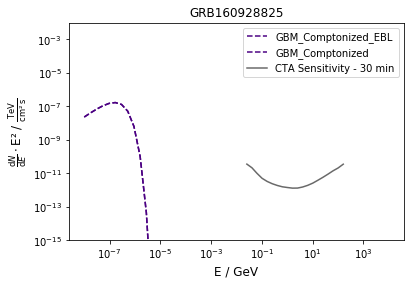

Start simulation for GRB160625945 with (random?) redshift =  1.80349600723
Start IRF part
Ready
2727.366117393007 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


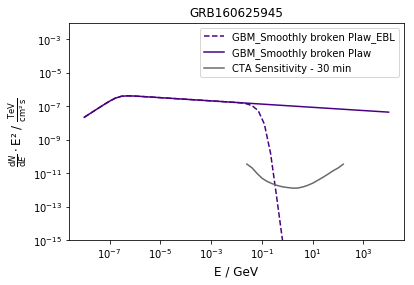

Start simulation for GRB140818229 with (random?) redshift =  0.886621065465
Start IRF part
Ready
662.3014136821332 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


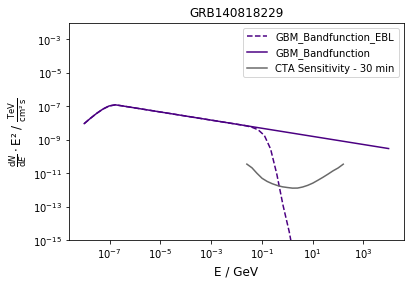

Start simulation for GRB150203173 with (random?) redshift =  1.95031954749
Start IRF part
Ready
13577.097142138296 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


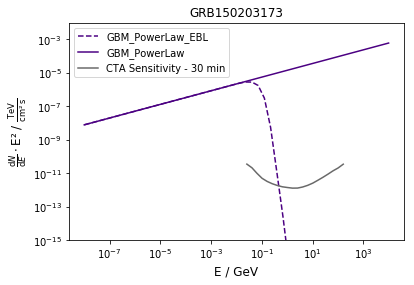

Start simulation for GRB100924165 with (random?) redshift =  3.4438596876
Start IRF part
Ready
13627.588990886394 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


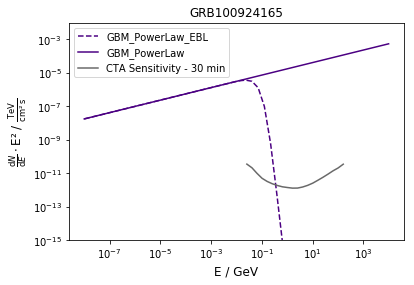

Start simulation for GRB120412920 with (random?) redshift =  2.20180975004
Start IRF part
Ready
710.8825003963699 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


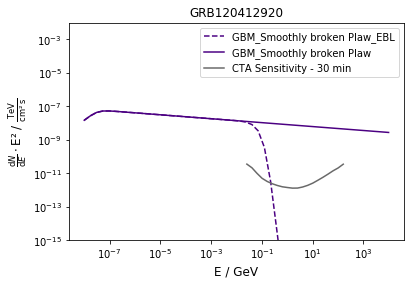

Start simulation for GRB110706977 with (random?) redshift =  2.88461483562
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


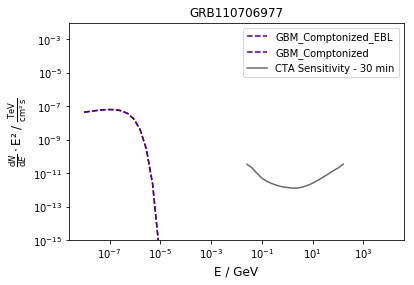

Start simulation for GRB120624309 with (random?) redshift =  0.994852264994
Start IRF part
Ready
313.8296227997164 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


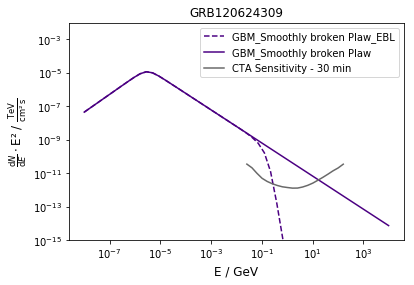

Start simulation for GRB170916700 with (random?) redshift =  7.35313445687
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


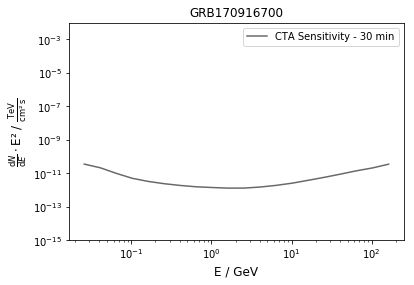

Start simulation for GRB150210935 with (random?) redshift =  0.548355700497
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


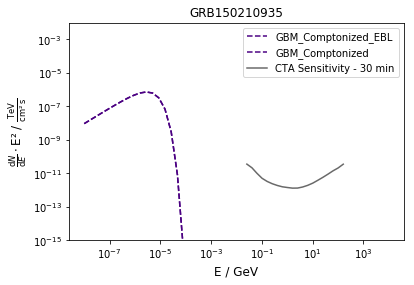

Start simulation for GRB130606316 with (random?) redshift =  1.33592520429
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


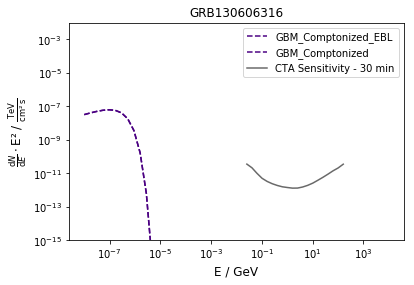

Start simulation for GRB161009651 with (random?) redshift =  1.59346590907
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


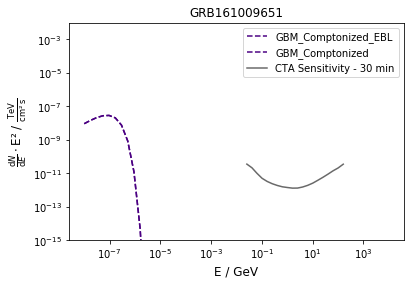

Start simulation for GRB170120471 with (random?) redshift =  2.02260329636
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


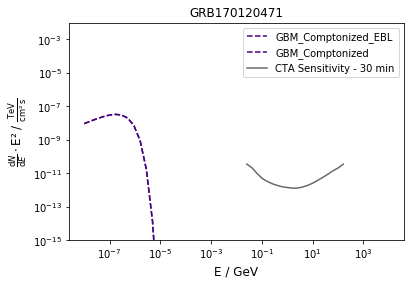

Start simulation for GRB120608777 with (random?) redshift =  1.8019779295
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


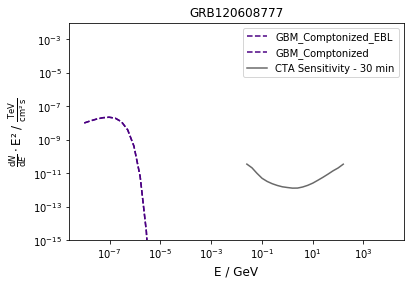

Start simulation for GRB141004973 with (random?) redshift =  1.31128696981
Start IRF part
Ready
6921.234496499464 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


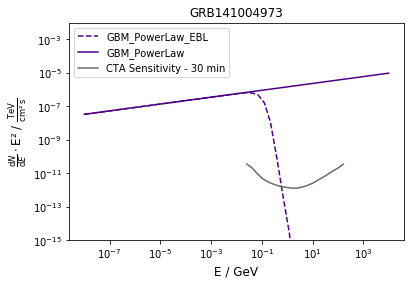

Start simulation for GRB100713980 with (random?) redshift =  1.38482231628
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


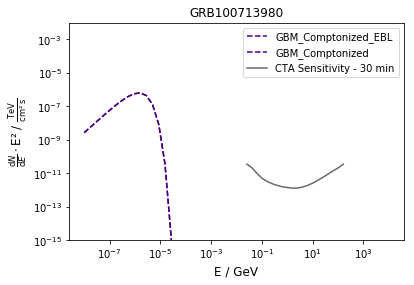

Start simulation for GRB120609580 with (random?) redshift =  1.08946924567
Start IRF part
Ready
37997.00285757474 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


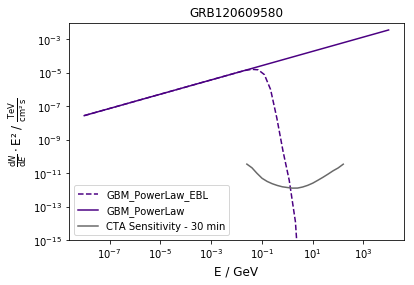

Start simulation for GRB130307238 with (random?) redshift =  0.907966037419
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


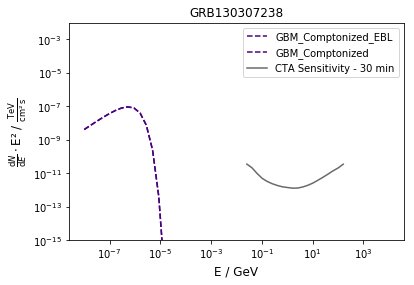

Start simulation for GRB151001628 with (random?) redshift =  0.869489742199
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


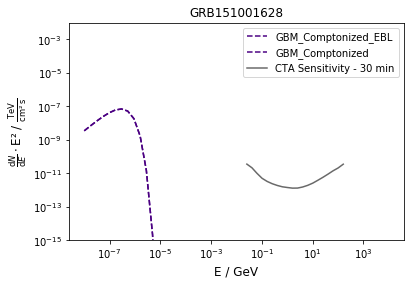

Start simulation for GRB141208038 with (random?) redshift =  1.73185739685
Start IRF part
Ready
3879.7633838885376 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


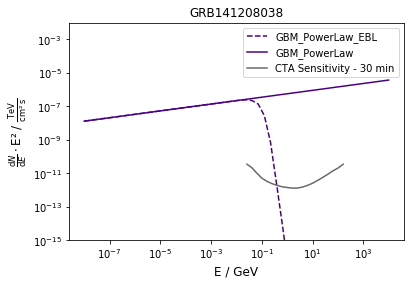

Start simulation for GRB170124528 with (random?) redshift =  1.4776377878
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


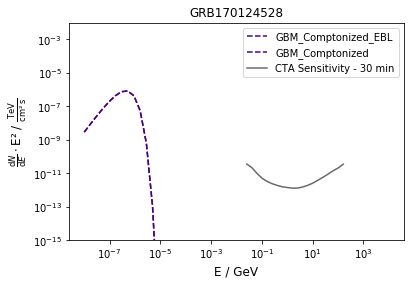

Start simulation for GRB161005977 with (random?) redshift =  0.937426380038
Start IRF part
Ready
6920.364862091627 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


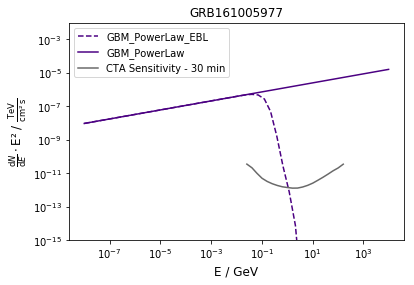

Start simulation for GRB140723499 with (random?) redshift =  5.41309890457
Start IRF part
Ready
0.09541826693322553 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


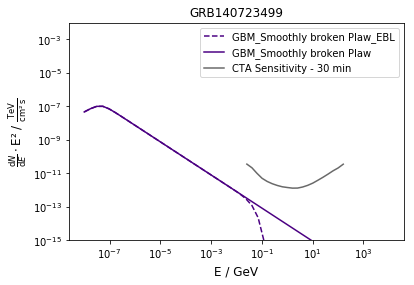

Start simulation for GRB130515755 with (random?) redshift =  0.495409554833
Start IRF part
Ready
19051.661164941223 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


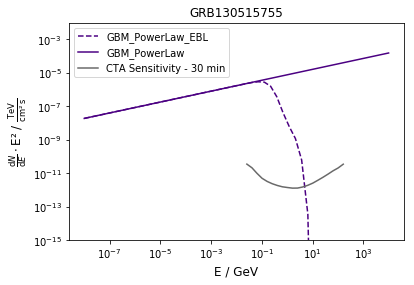

Start simulation for GRB091103912 with (random?) redshift =  1.01112491531
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


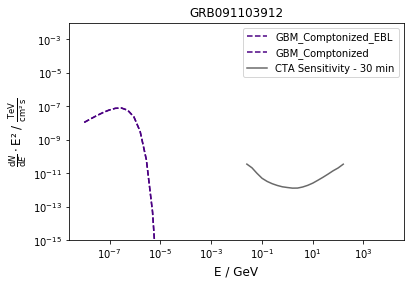

Start simulation for GRB120716712 with (random?) redshift =  1.47538615579
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


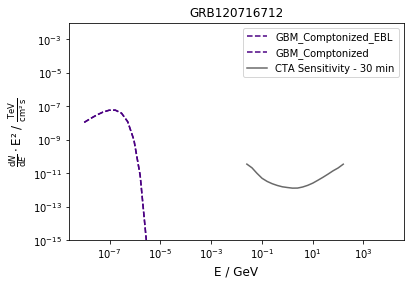

Start simulation for GRB101112984 with (random?) redshift =  1.66927311281
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


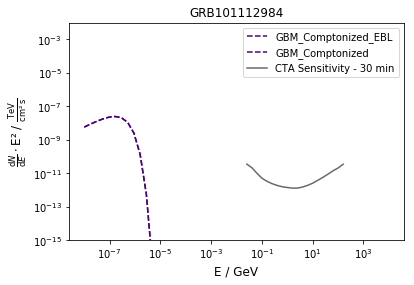

Start simulation for GRB131108862 with (random?) redshift =  1.70196668765
Start IRF part
Ready
380.3330597944424 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


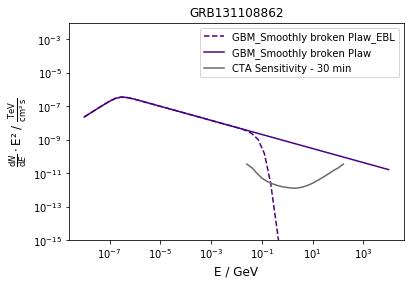

Start simulation for GRB090703329 with (random?) redshift =  4.65602060229
Start IRF part
Ready
5326.201147542635 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


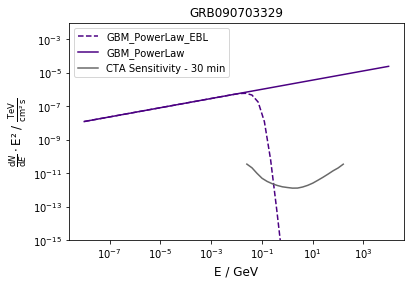

Start simulation for GRB120302722 with (random?) redshift =  1.67555732505
Start IRF part
Ready
97245.3807819185 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


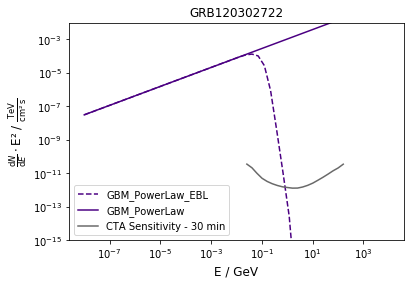

Start simulation for GRB170329387 with (random?) redshift =  0.342163367981
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


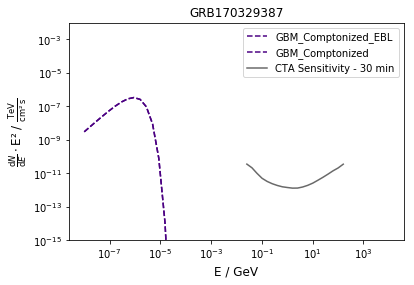

Start simulation for GRB100417789 with (random?) redshift =  7.36112595042
Start IRF part
Ready
26996.66948454441 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


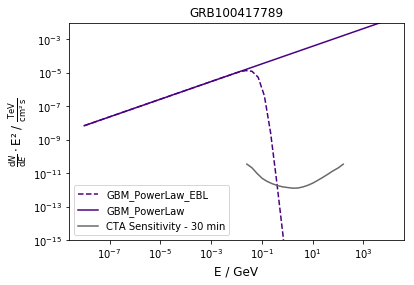

Start simulation for GRB080715950 with (random?) redshift =  4.2481789072
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


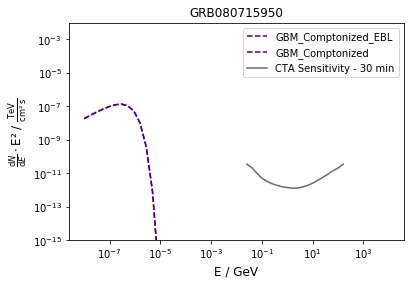

Start simulation for GRB140406144 with (random?) redshift =  2.17823295713
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


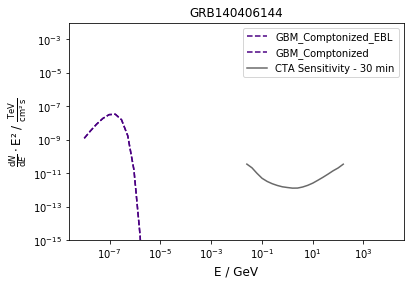

Start simulation for GRB140517813 with (random?) redshift =  4.30369344092
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


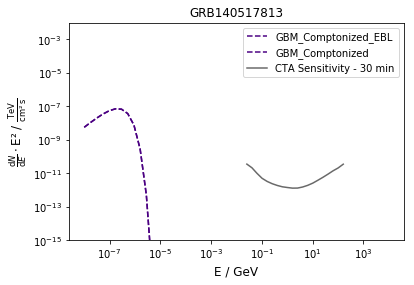

Start simulation for GRB161012416 with (random?) redshift =  3.6268732823
Start IRF part
Ready
28302.553271094956 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


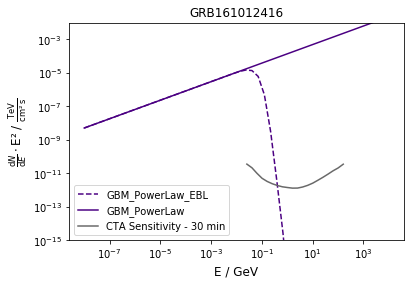

Start simulation for GRB120512112 with (random?) redshift =  2.42077593846
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


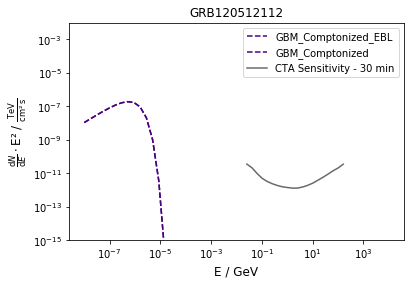

Start simulation for GRB160216801 with (random?) redshift =  1.99155397952
Start IRF part
Ready
4032.317555534246 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


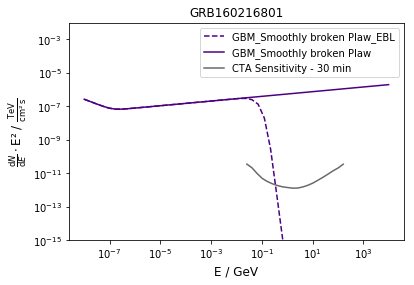

Start simulation for GRB170501467 with (random?) redshift =  1.23429441587
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


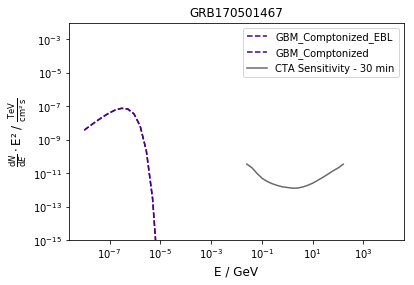

Start simulation for GRB100612545 with (random?) redshift =  2.80807547447
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


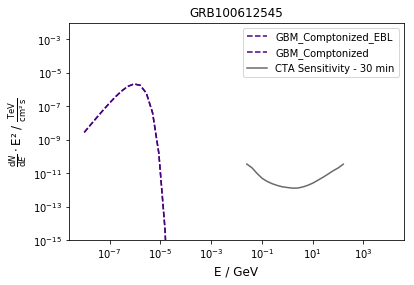

Start simulation for GRB090530760 with (random?) redshift =  1.29989126442
Start IRF part
Ready
11.717047176781376 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


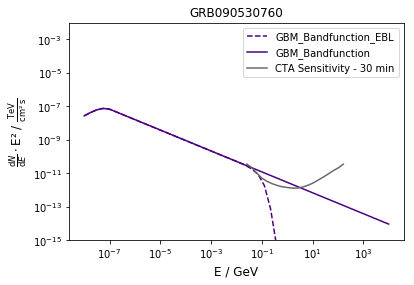

Start simulation for GRB090617208 with (random?) redshift =  4.099452126
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


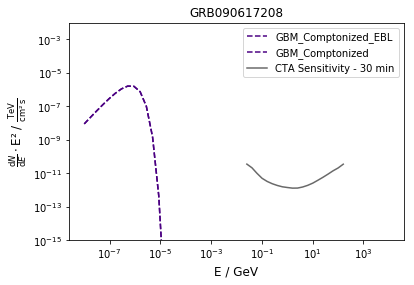

Start simulation for GRB160406023 with (random?) redshift =  3.54064990579
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


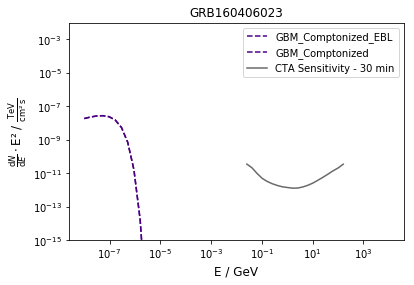

Start simulation for GRB161207813 with (random?) redshift =  1.47960382348
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


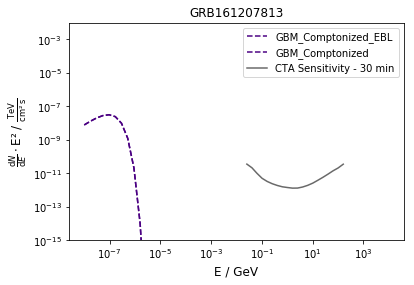

Start simulation for GRB170228773 with (random?) redshift =  0.401495630783
Start IRF part
Ready
8747.998059412921 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


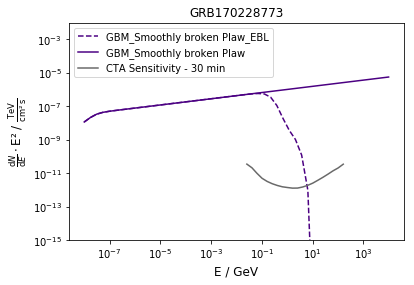

Start simulation for GRB130116415 with (random?) redshift =  2.23229503397
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


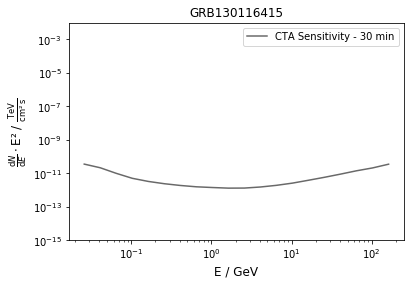

Start simulation for GRB130702004 with (random?) redshift =  1.74715650152
Start IRF part
Ready
19596.962157751055 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


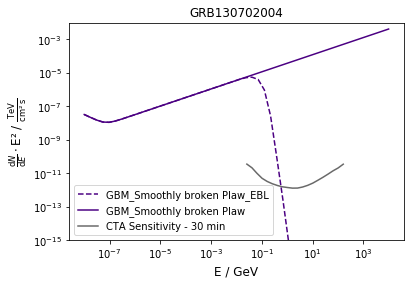

Start simulation for GRB100413732 with (random?) redshift =  1.46899752318
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


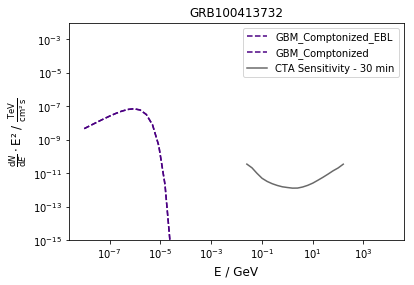

Start simulation for GRB100811108 with (random?) redshift =  1.60455955053
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


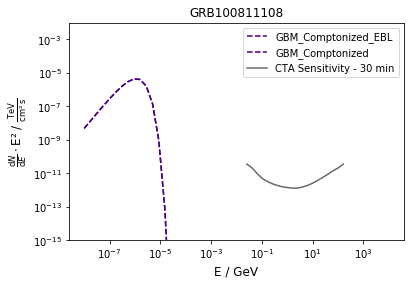

Start simulation for GRB140828288 with (random?) redshift =  2.58082743329
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


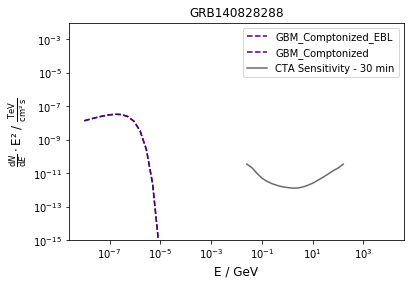

Start simulation for GRB130216927 with (random?) redshift =  1.65188114181
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


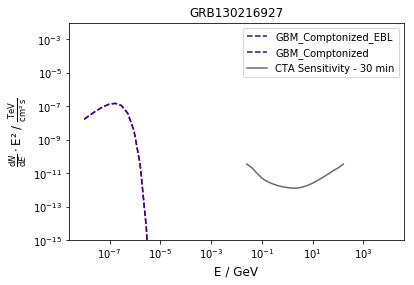

Start simulation for GRB150605782 with (random?) redshift =  1.94594316948
Start IRF part
Ready
33592.95716850038 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


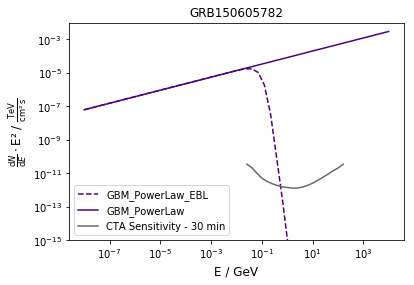

Start simulation for GRB100621529 with (random?) redshift =  0.596249900202
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


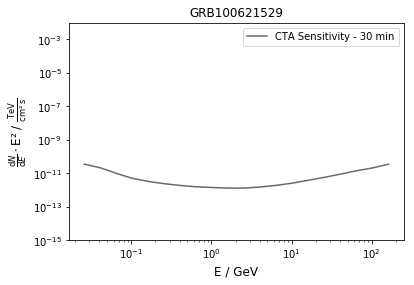

Start simulation for GRB160711968 with (random?) redshift =  2.83007359882
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


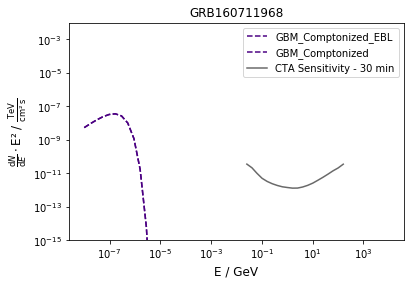

Start simulation for GRB130720116 with (random?) redshift =  4.24695290109
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


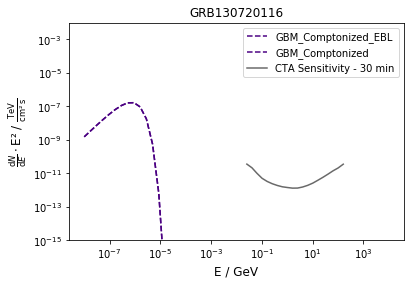

Start simulation for GRB100225249 with (random?) redshift =  2.01394220439
Start IRF part
Ready
20669.578856037802 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


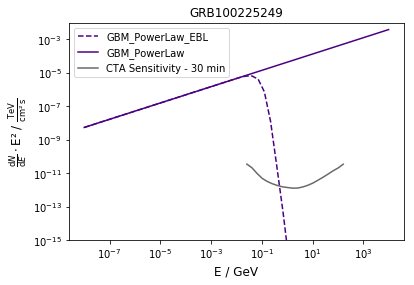

Start simulation for GRB140122597 with (random?) redshift =  2.59785928851
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


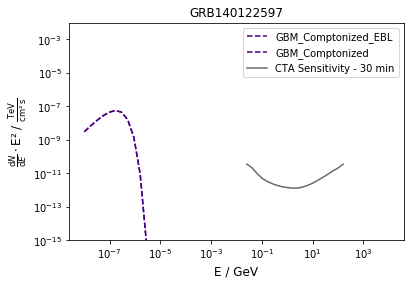

Start simulation for GRB150110433 with (random?) redshift =  1.51589266979
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


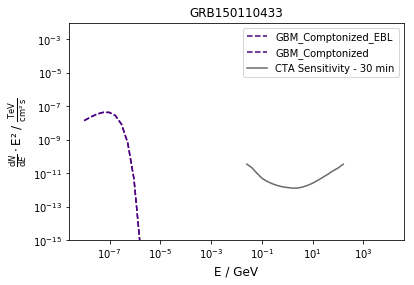

Start simulation for GRB140105748 with (random?) redshift =  2.16704823092
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


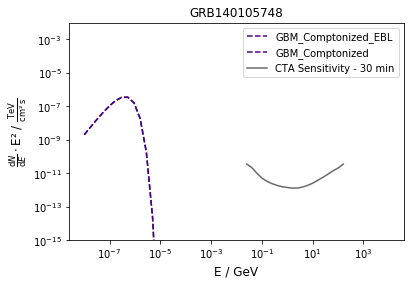

Start simulation for GRB170816599 with (random?) redshift =  2.1120835024
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


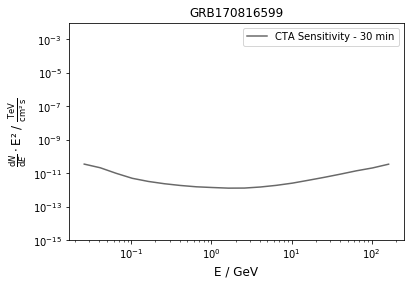

Start simulation for GRB170821265 with (random?) redshift =  1.87154762783
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


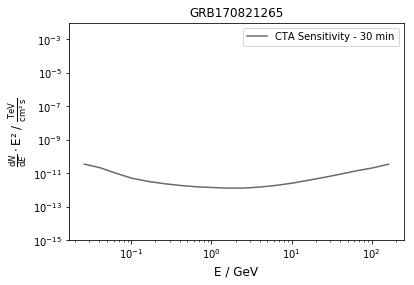

Start simulation for GRB130109206 with (random?) redshift =  2.59361240575
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


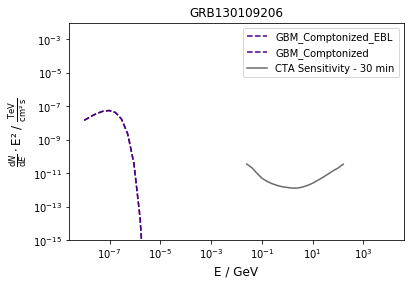

Start simulation for GRB150131951 with (random?) redshift =  1.43007426237
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


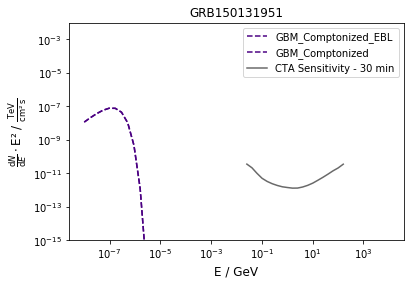

Start simulation for GRB110622158 with (random?) redshift =  3.5836091319
Start IRF part
Ready
16.836338203063125 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


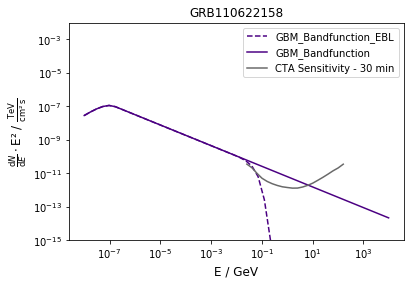

Start simulation for GRB100717446 with (random?) redshift =  5.909645681
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


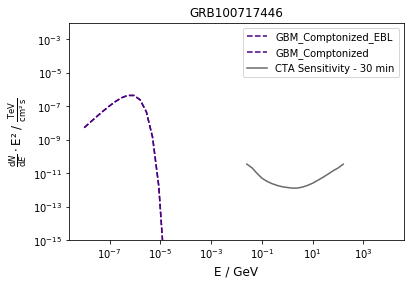

Start simulation for GRB090522344 with (random?) redshift =  1.04443201389
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


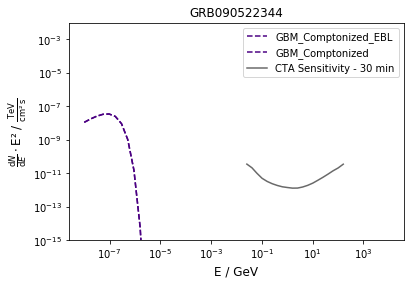

Start simulation for GRB090423330 with (random?) redshift =  4.96713403099
Start IRF part
Ready
5148.677509109962 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


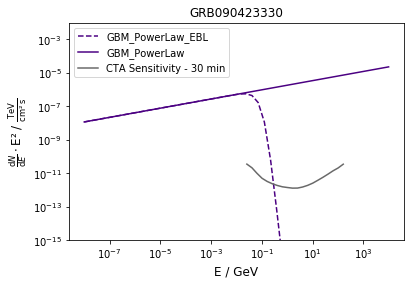

Start simulation for GRB131212814 with (random?) redshift =  1.87417853608
Start IRF part
Ready
3681.3944674716477 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


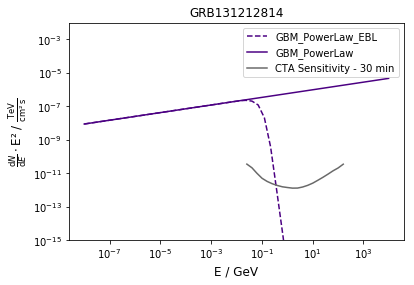

Start simulation for GRB140113624 with (random?) redshift =  1.54556890154
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


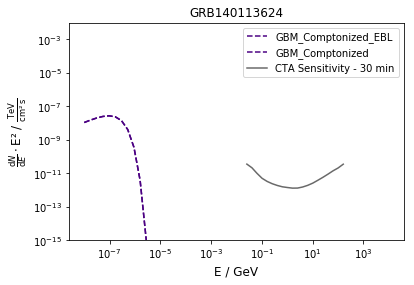

Start simulation for GRB080925775 with (random?) redshift =  2.25088271219
Start IRF part
Ready
1288.6401454541776 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


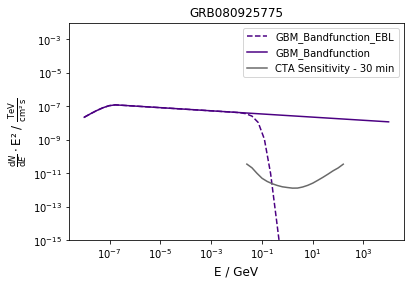

Start simulation for GRB091224373 with (random?) redshift =  2.55625234366
Start IRF part
Ready
358699.9392195401 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


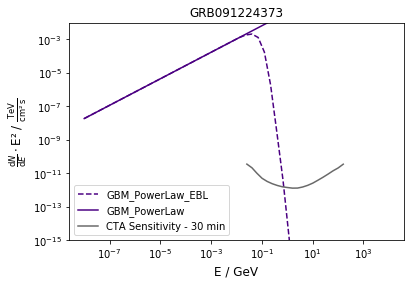

Start simulation for GRB111228657 with (random?) redshift =  2.33597908345
Start IRF part
Ready
78.890349308923 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


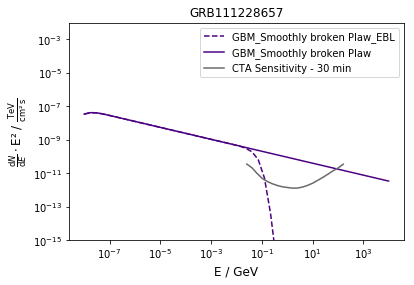

Start simulation for GRB170705115 with (random?) redshift =  0.715194754019
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


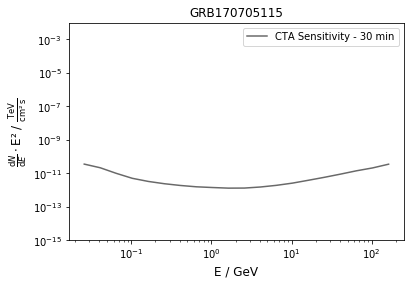

Start simulation for GRB170830069 with (random?) redshift =  1.49801971006
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


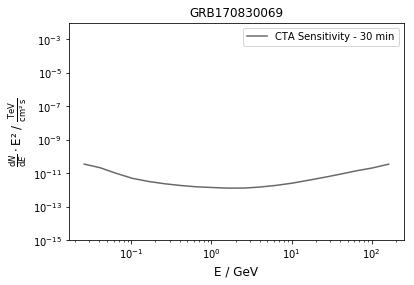

Start simulation for GRB150226948 with (random?) redshift =  2.87209306421
Start IRF part
Ready
79337.34409699176 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


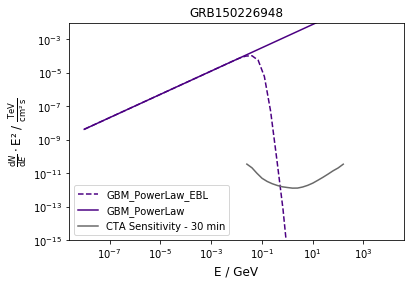

Start simulation for GRB160106948 with (random?) redshift =  0.640434610131
Start IRF part
Ready
2115.2450139380735 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


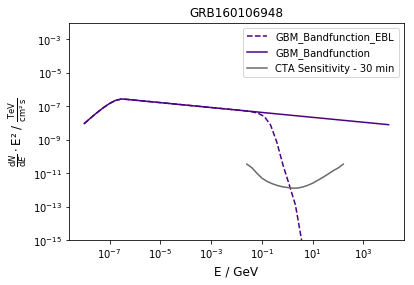

Start simulation for GRB160423066 with (random?) redshift =  1.66440629922
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


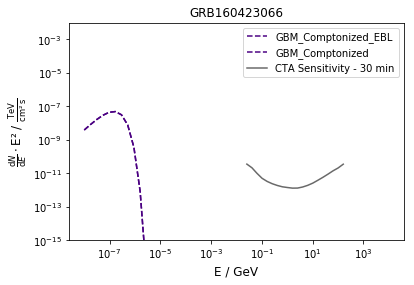

Start simulation for GRB120830702 with (random?) redshift =  1.45654083954
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


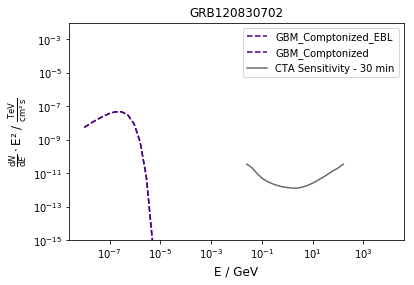

Start simulation for GRB091215234 with (random?) redshift =  1.17539959543
Start IRF part
Ready
14017.049194492452 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


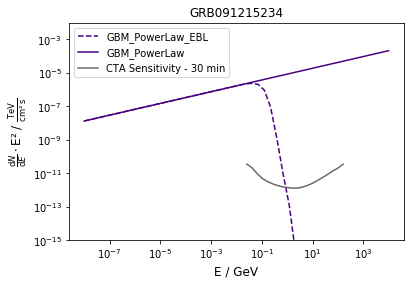

Start simulation for GRB161012214 with (random?) redshift =  3.70569765467
Start IRF part
Ready
3633.21652956114 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


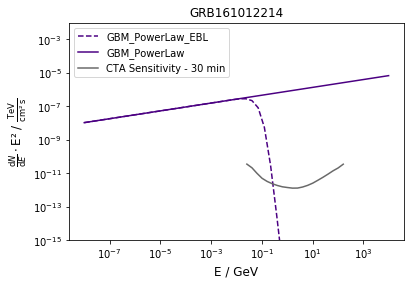

Start simulation for GRB130522510 with (random?) redshift =  0.687374616056
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


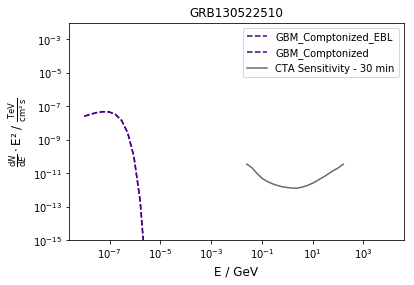

Start simulation for GRB120824594 with (random?) redshift =  2.11027463377
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


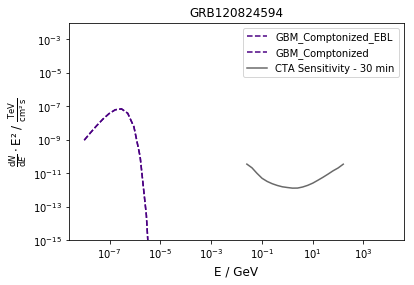

Start simulation for GRB101231067 with (random?) redshift =  0.780426819669
Start IRF part
Ready
258.6042512430444 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


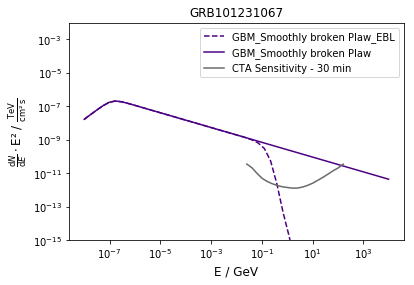

Start simulation for GRB091208410 with (random?) redshift =  2.77421251616
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


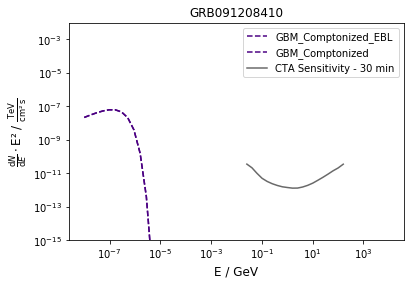

Start simulation for GRB120905657 with (random?) redshift =  3.04555856244
Start IRF part
Ready
6.08244237718469 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


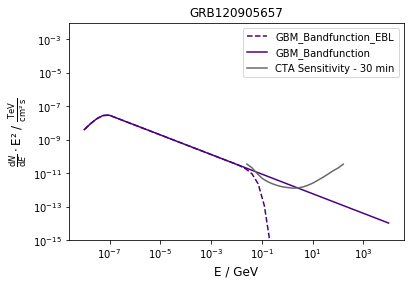

Start simulation for GRB150728151 with (random?) redshift =  1.58988619099
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


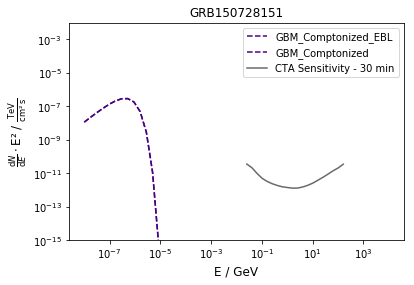

Start simulation for GRB081107321 with (random?) redshift =  1.59266377595
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


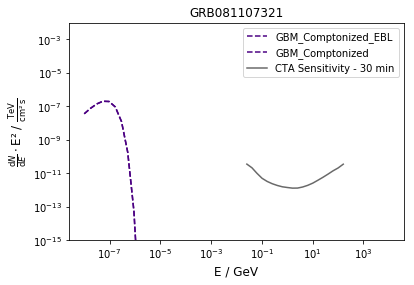

Start simulation for GRB090323002 with (random?) redshift =  0.501304178526
Start IRF part
Ready
883.7907004613489 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


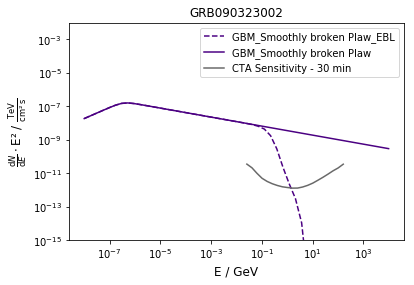

Start simulation for GRB150802207 with (random?) redshift =  3.16676762067
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


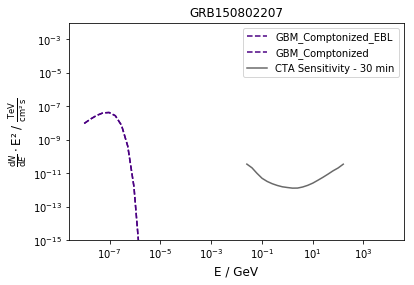

Start simulation for GRB170711713 with (random?) redshift =  0.302581289885
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


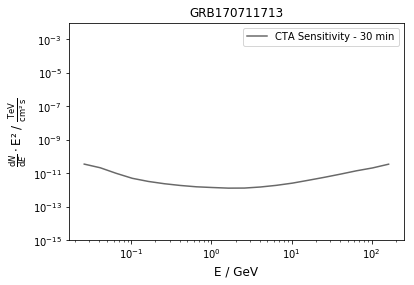

Start simulation for GRB100709602 with (random?) redshift =  0.883657309316
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


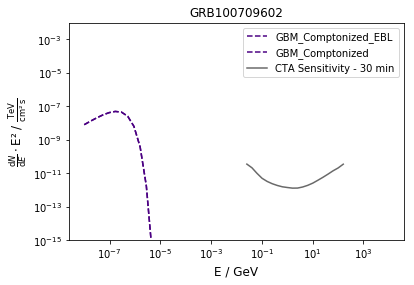

Start simulation for GRB130427324 with (random?) redshift =  1.7811416281
Start IRF part
Ready
104.52235007456264 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


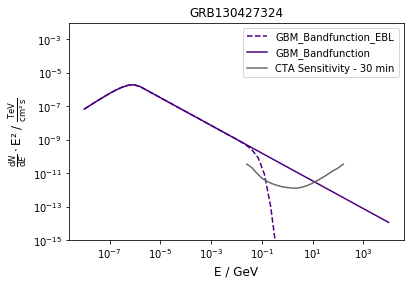

Start simulation for GRB170306130 with (random?) redshift =  1.31354903322
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


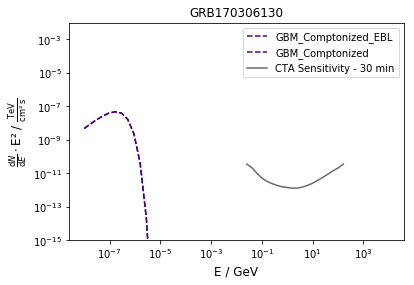

Start simulation for GRB150128791 with (random?) redshift =  2.93313223532
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


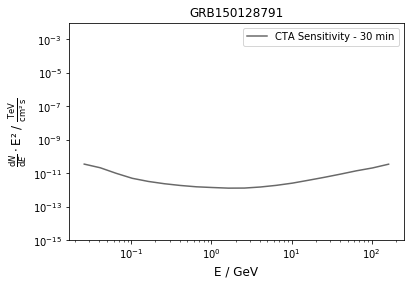

Start simulation for GRB100528075 with (random?) redshift =  2.48903662631
Start IRF part
Ready
4134.547469402055 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


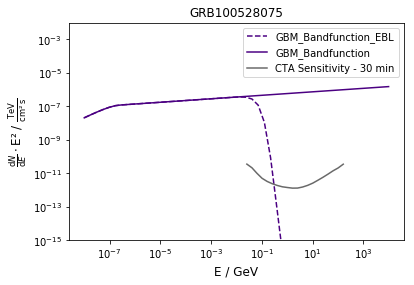

Start simulation for GRB100629801 with (random?) redshift =  1.66984379807
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


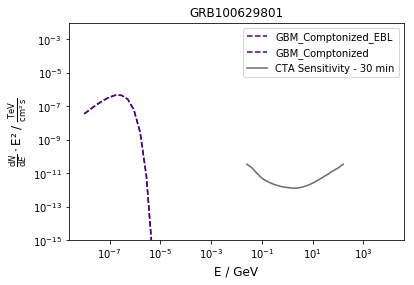

Start simulation for GRB130528503 with (random?) redshift =  0.22660842098
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


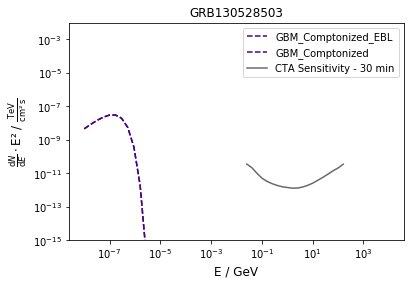

Start simulation for GRB130828808 with (random?) redshift =  2.94170712721
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


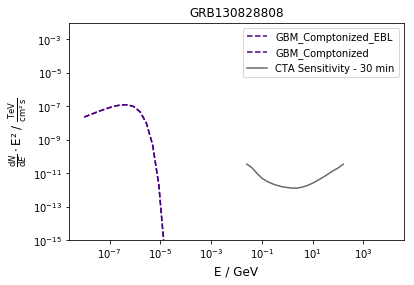

Start simulation for GRB110123804 with (random?) redshift =  3.27570237471
Start IRF part
Ready
5209.467710064532 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


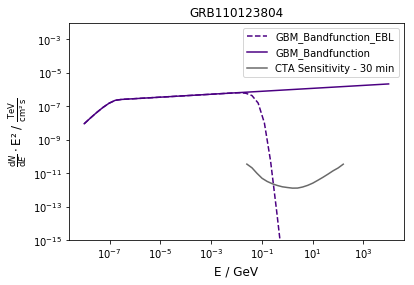

Start simulation for GRB171011810 with (random?) redshift =  2.04405035482
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


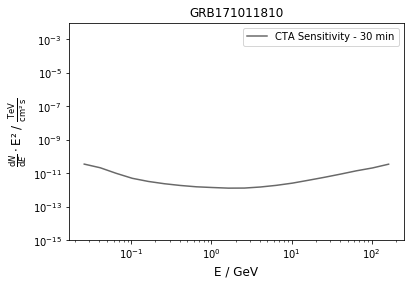

Start simulation for GRB150120685 with (random?) redshift =  0.816729378356
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


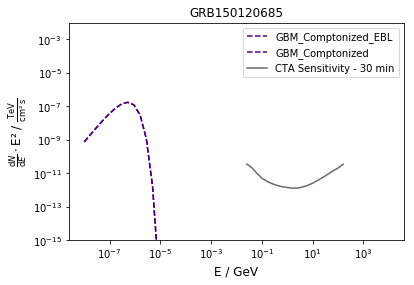

Start simulation for GRB120913846 with (random?) redshift =  3.55073301981
Start IRF part
Ready
1057.7062157300425 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


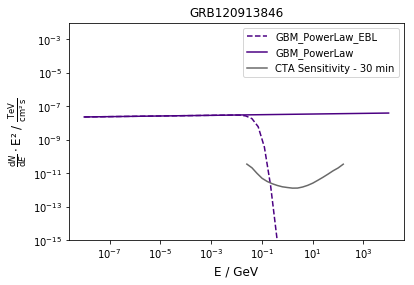

Start simulation for GRB100515467 with (random?) redshift =  0.724310217149
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


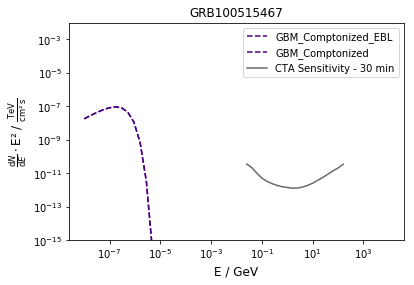

Start simulation for GRB150724398 with (random?) redshift =  4.19239598416
Start IRF part
Ready
3463.2036615132056 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


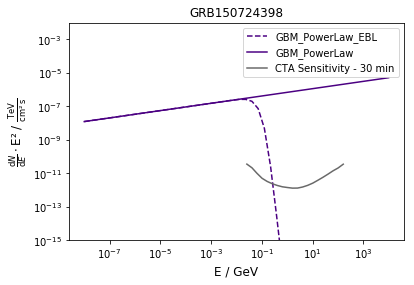

Start simulation for GRB090820027 with (random?) redshift =  0.325867009855
Start IRF part
Ready
239.74853785701657 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


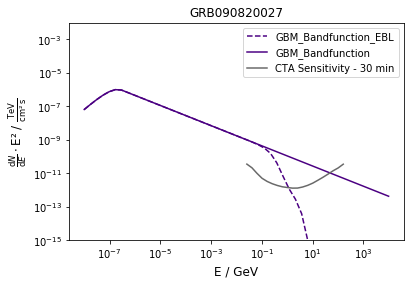

Start simulation for GRB150804806 with (random?) redshift =  1.32619279852
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


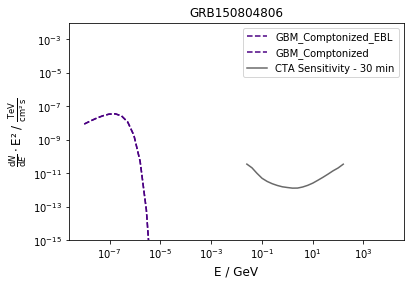

Start simulation for GRB101220864 with (random?) redshift =  3.86021466735
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


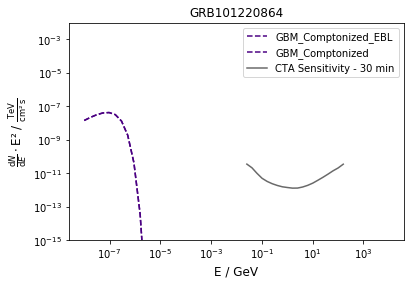

Start simulation for GRB090902462 with (random?) redshift =  1.59357151486
Start IRF part
Ready
4.3091689230083455e-07 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


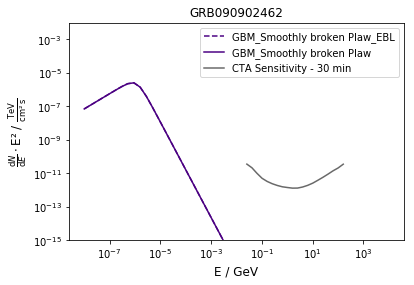

Start simulation for GRB080927480 with (random?) redshift =  2.93295203807
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


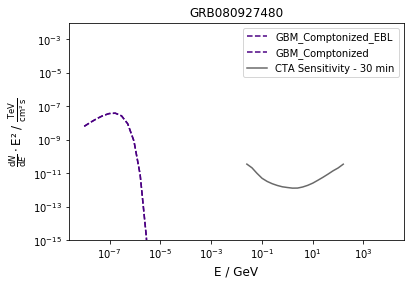

Start simulation for GRB100804104 with (random?) redshift =  0.72275486015
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


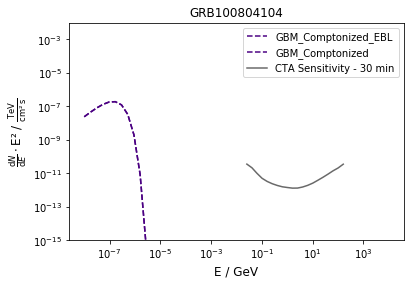

Start simulation for GRB140427702 with (random?) redshift =  1.23095907725
Start IRF part
Ready
2641.310504638701 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


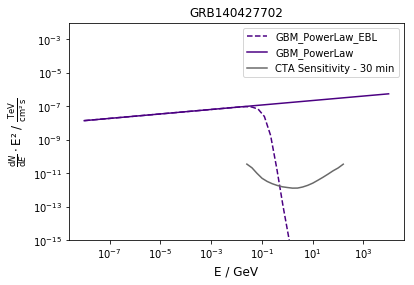

Start simulation for GRB100208386 with (random?) redshift =  0.690998178838
Start IRF part
Ready
405750.0549322315 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


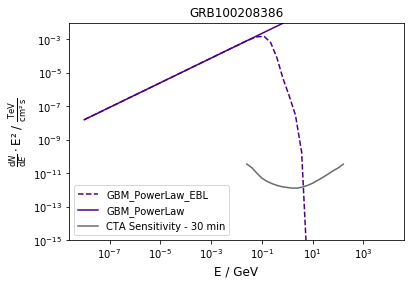

Start simulation for GRB110213876 with (random?) redshift =  1.14941335427
Start IRF part
Ready
395130.7041085456 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


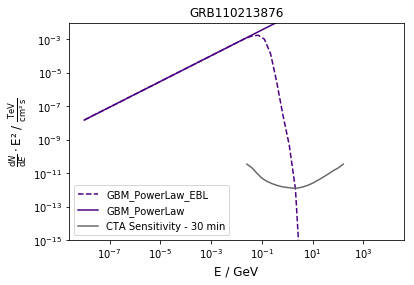

Start simulation for GRB140810782 with (random?) redshift =  5.7578311696
Start IRF part
Ready
664.9834940380238 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


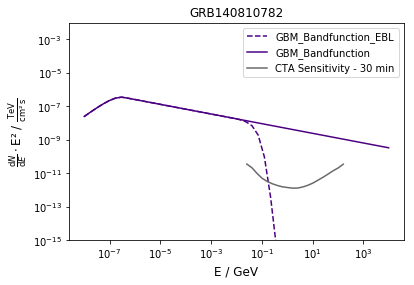

Start simulation for GRB170504734 with (random?) redshift =  4.07479492446
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


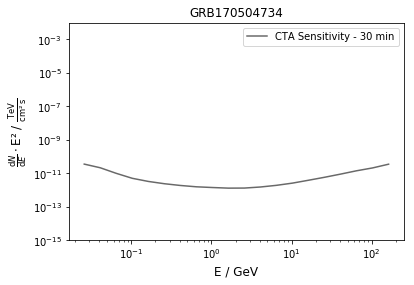

Start simulation for GRB130609129 with (random?) redshift =  0.462544300761
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


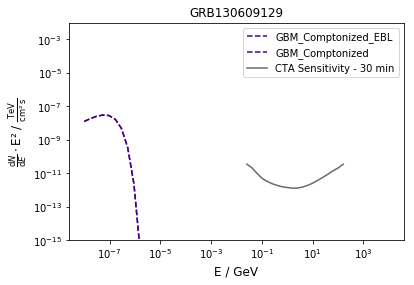

Start simulation for GRB130622615 with (random?) redshift =  1.54366052954
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


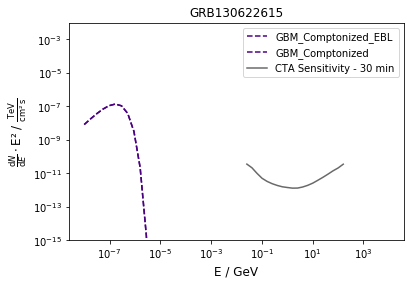

Start simulation for GRB140501139 with (random?) redshift =  3.05833877579
Start IRF part
Ready
130784.56974068959 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


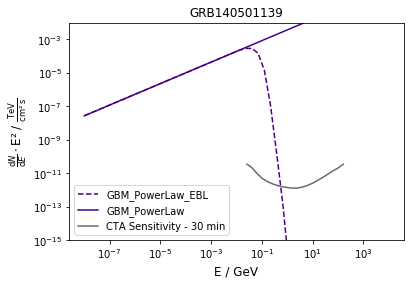

Start simulation for GRB130416690 with (random?) redshift =  0.400361432418
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


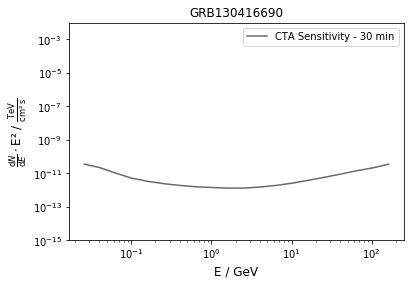

Start simulation for GRB120102095 with (random?) redshift =  5.04957073963
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


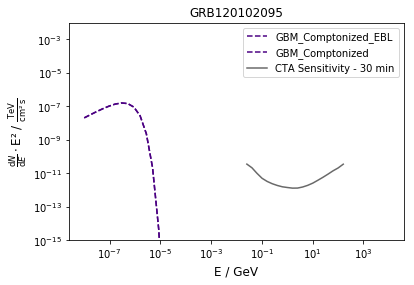

Start simulation for GRB160912521 with (random?) redshift =  1.03255400774
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


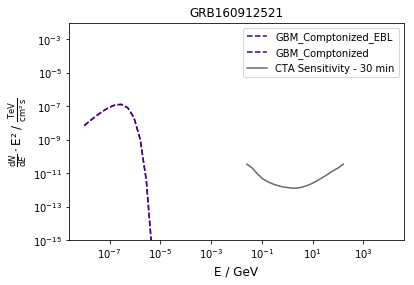

Start simulation for GRB140523129 with (random?) redshift =  2.4256216746
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


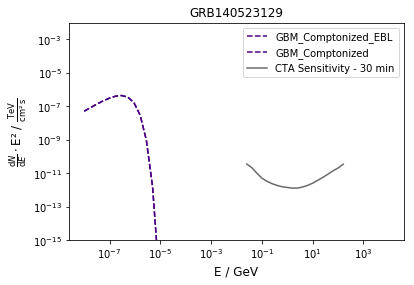

Start simulation for GRB110629174 with (random?) redshift =  1.60077043485
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


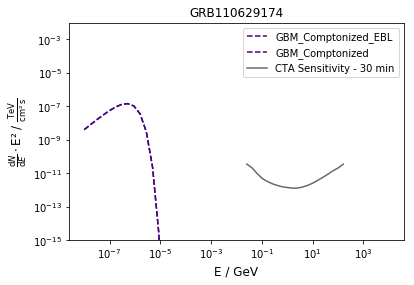

Start simulation for GRB111117510 with (random?) redshift =  2.29187868006
Start IRF part
Ready
10898.201523997725 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


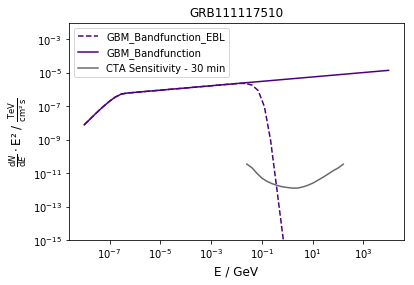

Start simulation for GRB141229911 with (random?) redshift =  4.71074815485
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


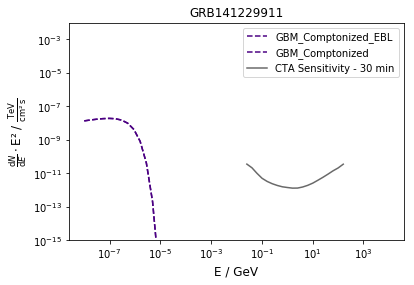

Start simulation for GRB131018673 with (random?) redshift =  0.449420624247
Start IRF part
Ready
20456.108544924984 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


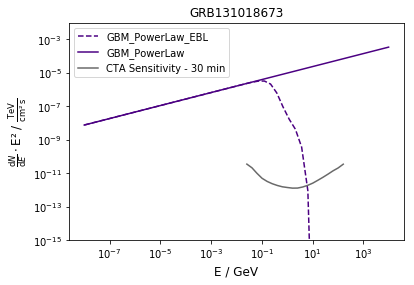

Start simulation for GRB110709463 with (random?) redshift =  2.91717667729
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


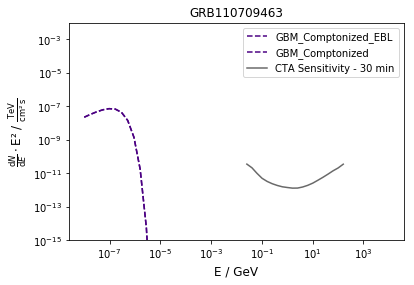

Start simulation for GRB091221870 with (random?) redshift =  3.45901287102
Start IRF part
Ready
1219.312536953839 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


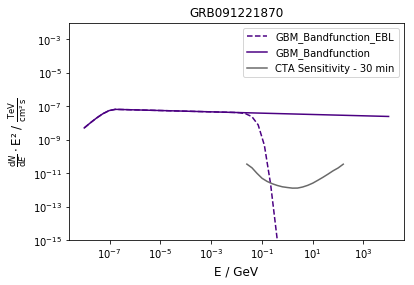

Start simulation for GRB091030613 with (random?) redshift =  1.18743899821
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


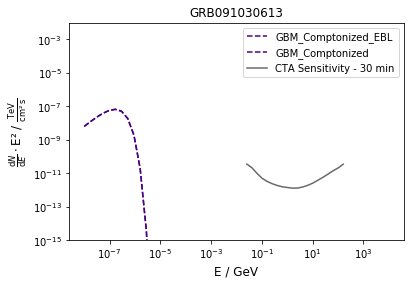

Start simulation for GRB150715136 with (random?) redshift =  1.56457206446
Start IRF part
Ready
112287.0503885969 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


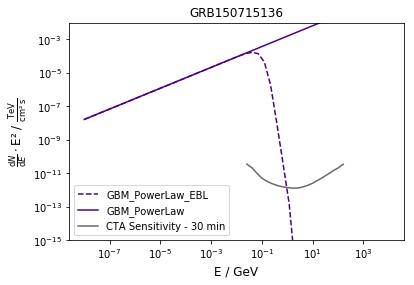

Start simulation for GRB120327418 with (random?) redshift =  1.67123456257
Start IRF part
Ready
80825.17449907683 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


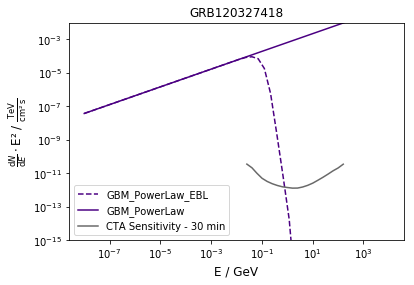

Start simulation for GRB170412988 with (random?) redshift =  1.18406472382
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


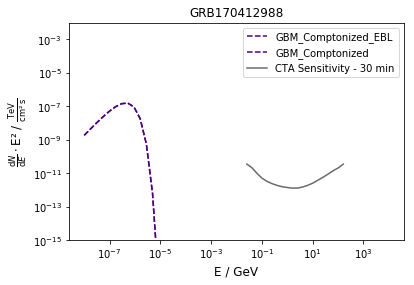

Start simulation for GRB090811696 with (random?) redshift =  5.52513509951
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


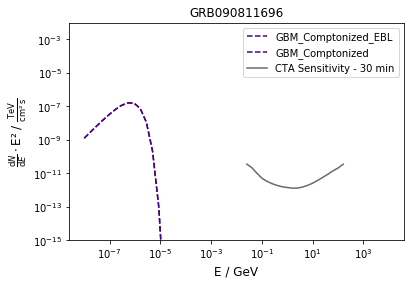

Start simulation for GRB100513879 with (random?) redshift =  4.24000631991
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


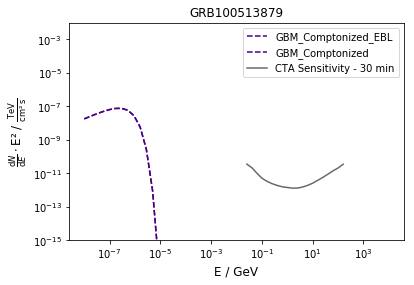

Start simulation for GRB140621827 with (random?) redshift =  0.613855217118
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


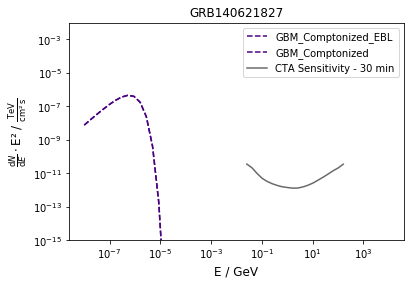

Start simulation for GRB101107011 with (random?) redshift =  3.41593476238
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


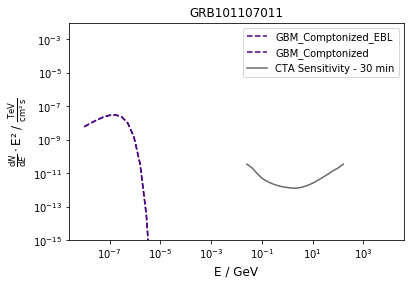

Start simulation for GRB120814201 with (random?) redshift =  0.644691035846
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


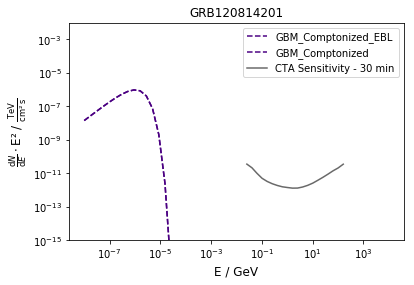

Start simulation for GRB171120556 with (random?) redshift =  0.827538630102
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


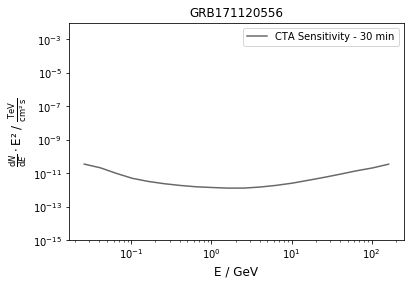

Start simulation for GRB150226223 with (random?) redshift =  0.93171940083
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


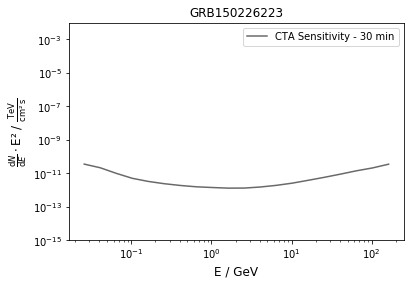

Start simulation for GRB090712160 with (random?) redshift =  1.77559138365
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


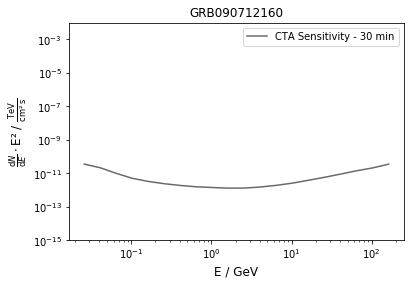

Start simulation for GRB130115716 with (random?) redshift =  1.80046852314
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


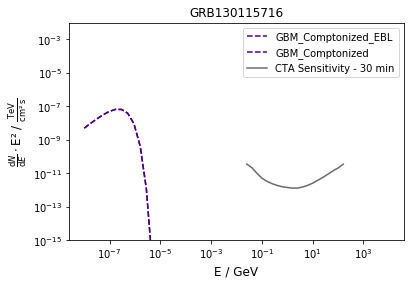

Start simulation for GRB120519721 with (random?) redshift =  1.11034953639
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


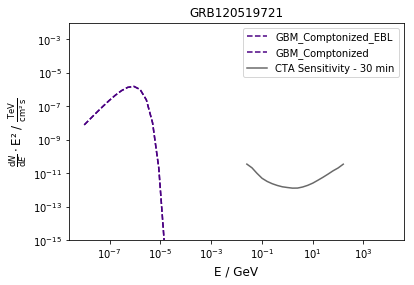

Start simulation for GRB100130777 with (random?) redshift =  2.40564045479
Start IRF part
Ready
1782.5386027258644 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


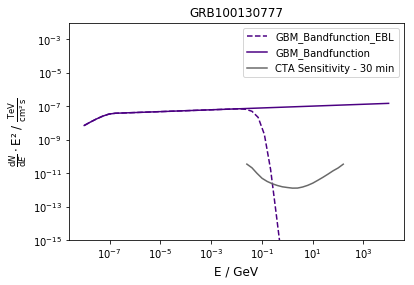

Start simulation for GRB150705009 with (random?) redshift =  2.96663605334
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


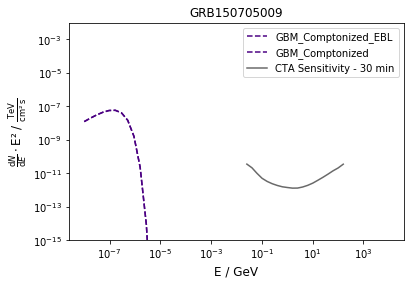

Start simulation for GRB160917456 with (random?) redshift =  0.610714896549
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


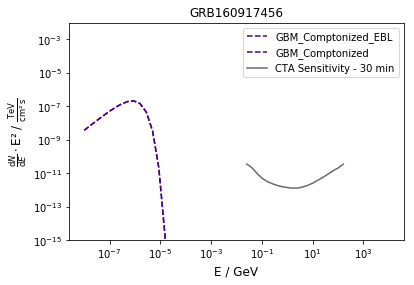

Start simulation for GRB150922718 with (random?) redshift =  4.57079732212
Start IRF part
Ready
45889.95122747424 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


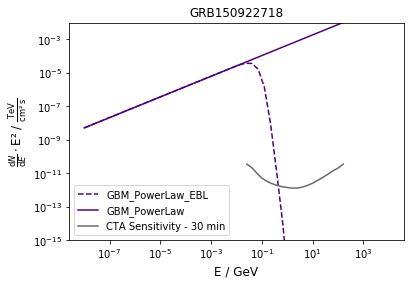

Start simulation for GRB170929699 with (random?) redshift =  2.65867016927
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


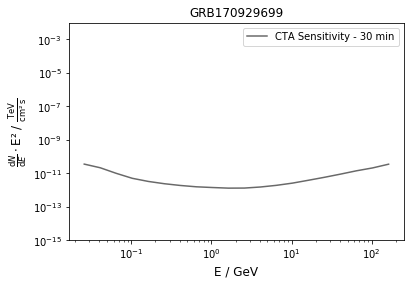

Start simulation for GRB170826369 with (random?) redshift =  6.66119781093
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


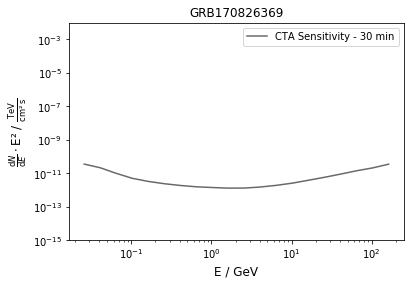

Start simulation for GRB150810485 with (random?) redshift =  1.52025205465
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


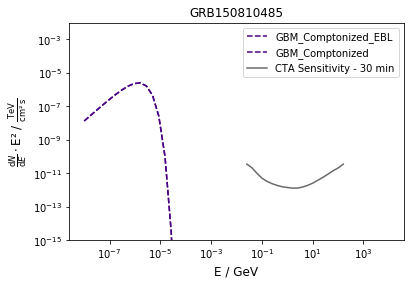

Start simulation for GRB100318611 with (random?) redshift =  4.14994607029
Start IRF part
Ready
3372.0983355220055 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


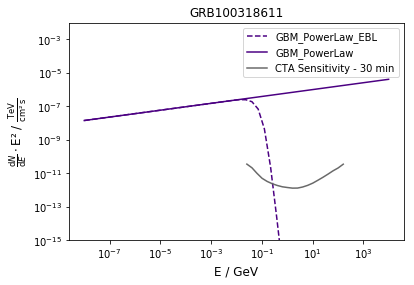

Start simulation for GRB170616165 with (random?) redshift =  3.95986005289
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


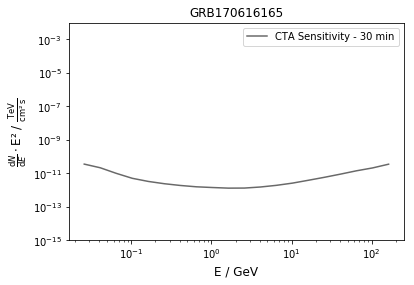

Start simulation for GRB150201040 with (random?) redshift =  1.96331502434
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


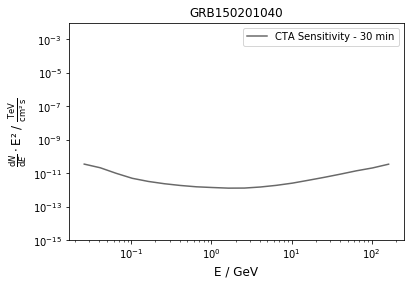

Start simulation for GRB141118678 with (random?) redshift =  1.95192234533
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


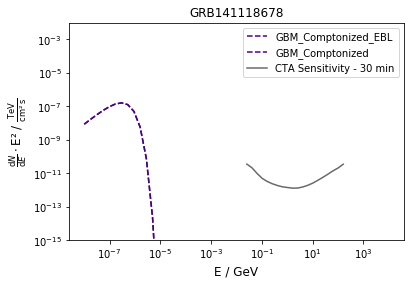

Start simulation for GRB100527795 with (random?) redshift =  2.15239893368
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


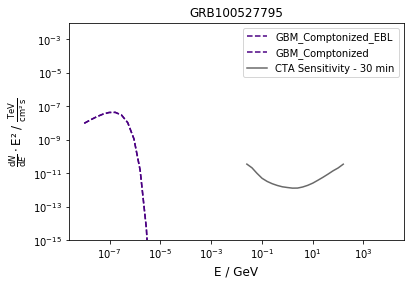

Start simulation for GRB100301223 with (random?) redshift =  1.65100646662
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


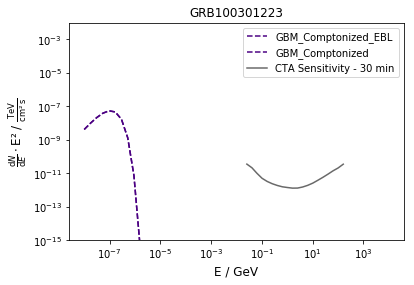

Start simulation for GRB110428338 with (random?) redshift =  0.877382557336
Start IRF part
Ready
24.25985121370252 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


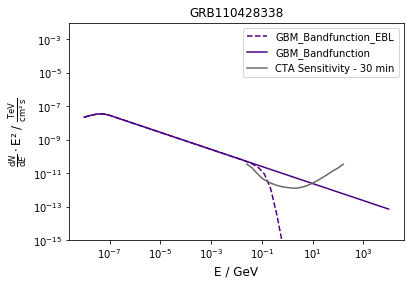

Start simulation for GRB150721431 with (random?) redshift =  0.136536758257
Start IRF part
Ready
335653.2618203685 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


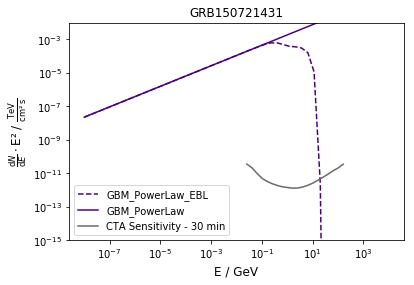

Start simulation for GRB110728056 with (random?) redshift =  2.03085329044
Start IRF part
Ready
138213.8045126836 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


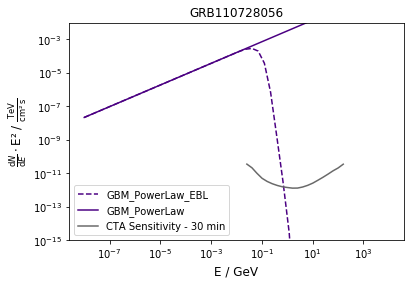

Start simulation for GRB170825500 with (random?) redshift =  1.44007295459
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


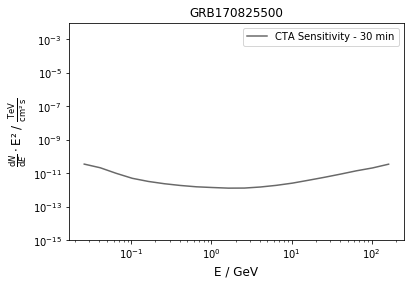

Start simulation for GRB150412931 with (random?) redshift =  0.788891283247
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


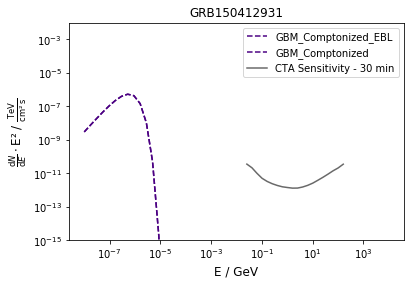

Start simulation for GRB151227218 with (random?) redshift =  0.9237005768
Start IRF part
Ready
2048.9218491416027 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


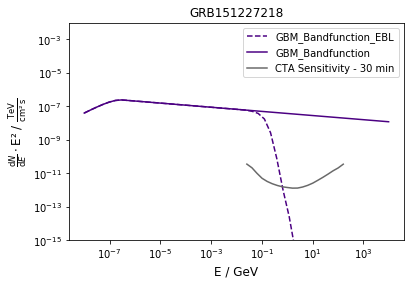

Start simulation for GRB160323293 with (random?) redshift =  3.40340381631
Start IRF part
Ready
3348.1042937745883 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


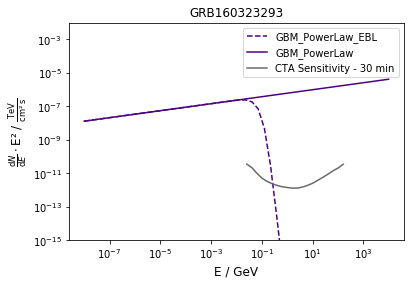

Start simulation for GRB140606133 with (random?) redshift =  2.32946945567
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


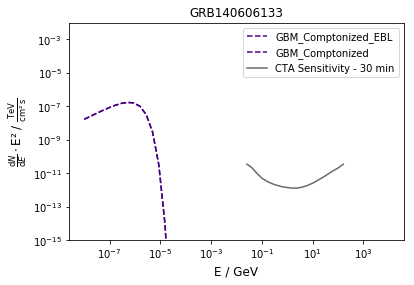

Start simulation for GRB141220252 with (random?) redshift =  1.39331197456
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


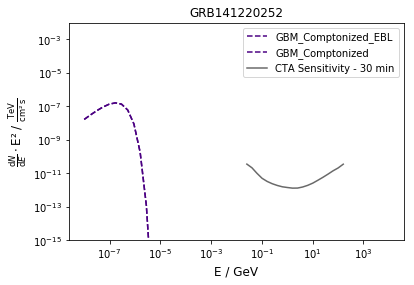

Start simulation for GRB161129300 with (random?) redshift =  3.44318351661
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


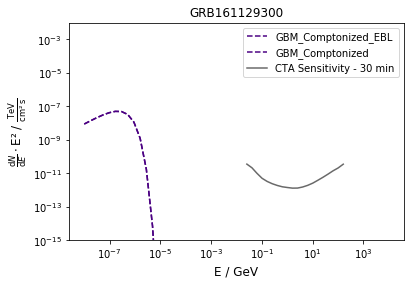

Start simulation for GRB090227772 with (random?) redshift =  3.68920989695
Start IRF part
Ready
14.356495482100309 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


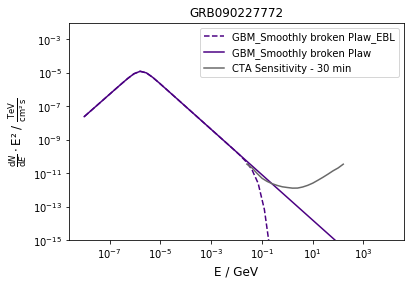

Start simulation for GRB090529310 with (random?) redshift =  1.35041184012
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


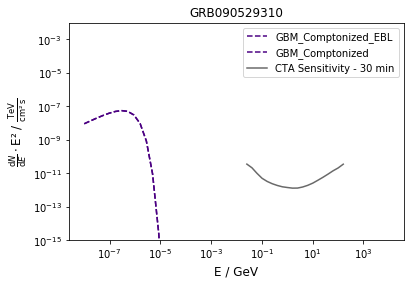

Start simulation for GRB100212550 with (random?) redshift =  2.3570772412
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


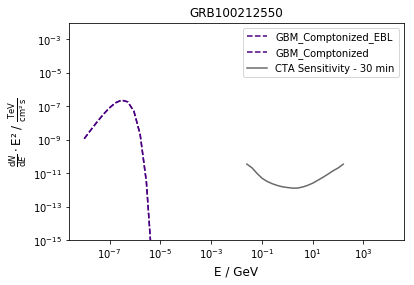

Start simulation for GRB081204517 with (random?) redshift =  1.61593728917
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


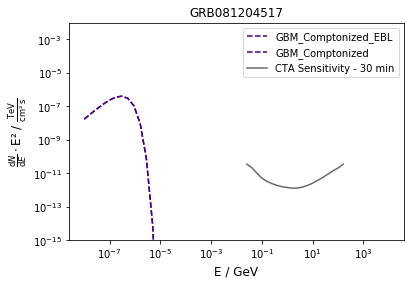

Start simulation for GRB131217108 with (random?) redshift =  2.78561629396
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


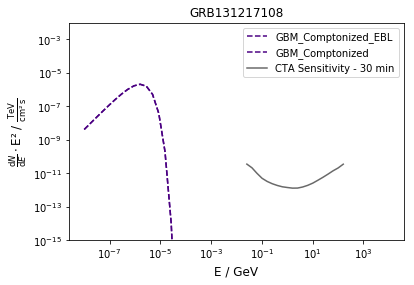

Start simulation for GRB080830368 with (random?) redshift =  0.731987905075
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


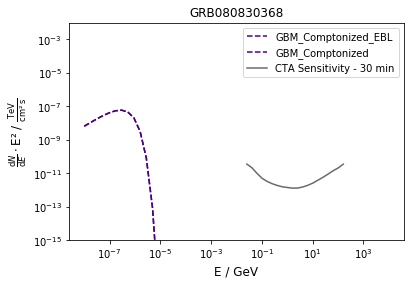

Start simulation for GRB120109824 with (random?) redshift =  2.02288936672
Start IRF part
Ready
24874.600891897302 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


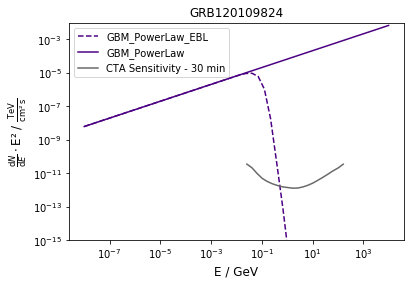

Start simulation for GRB151030999 with (random?) redshift =  4.51965515492
Start IRF part
Ready
1183.0914731286248 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


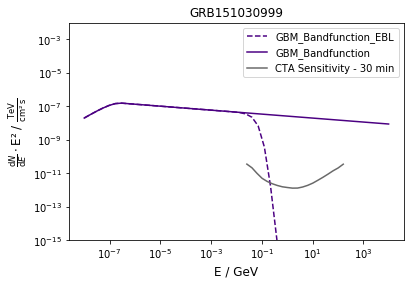

Start simulation for GRB151126293 with (random?) redshift =  2.21529495947
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


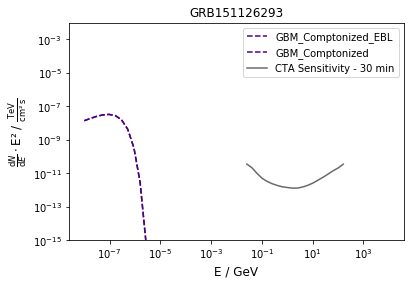

Start simulation for GRB170911267 with (random?) redshift =  0.398838194457
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


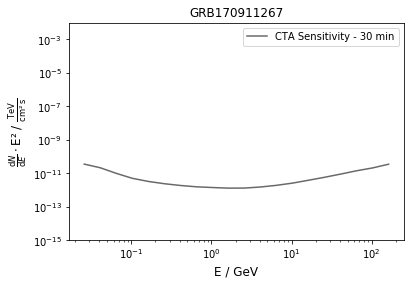

Start simulation for GRB140801792 with (random?) redshift =  0.783082339731
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


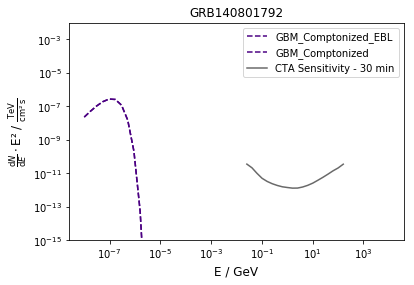

Start simulation for GRB151231568 with (random?) redshift =  2.16970477727
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


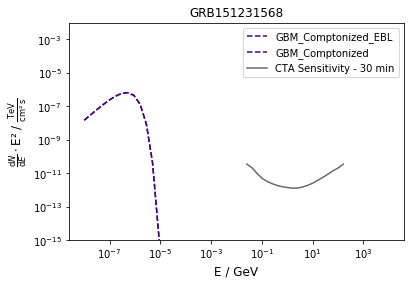

Start simulation for GRB170101374 with (random?) redshift =  1.90958597182
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


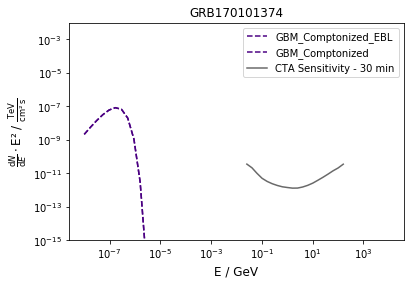

Start simulation for GRB171108656 with (random?) redshift =  1.73081492455
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


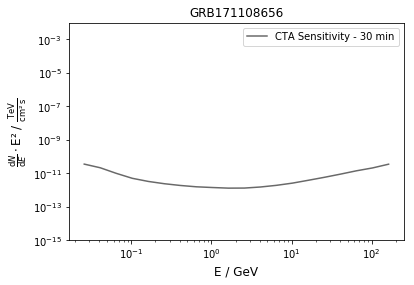

Start simulation for GRB141105406 with (random?) redshift =  0.68614491965
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


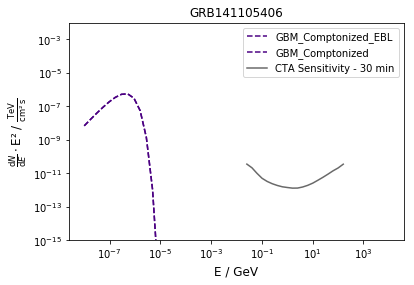

Start simulation for GRB170313125 with (random?) redshift =  3.64117606133
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


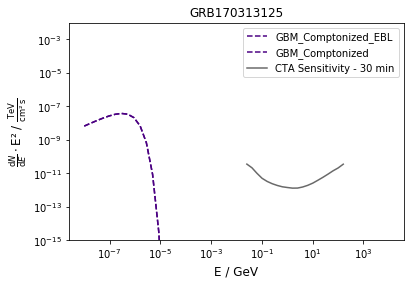

Start simulation for GRB120427054 with (random?) redshift =  2.13944873344
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


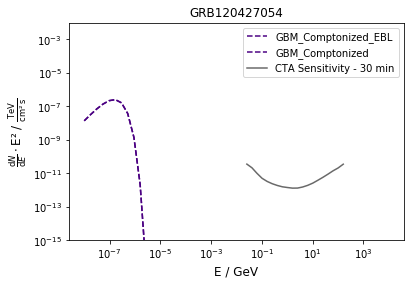

Start simulation for GRB170302166 with (random?) redshift =  4.02264180506
Start IRF part
Ready
1271.759547175727 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


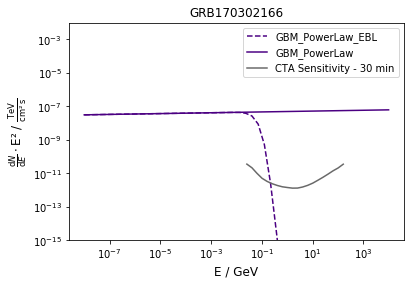

Start simulation for GRB110301214 with (random?) redshift =  0.234246996918
Start IRF part
Ready
86.14785103485606 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


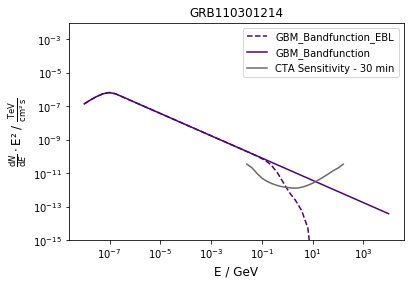

Start simulation for GRB080821332 with (random?) redshift =  0.656755586249
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


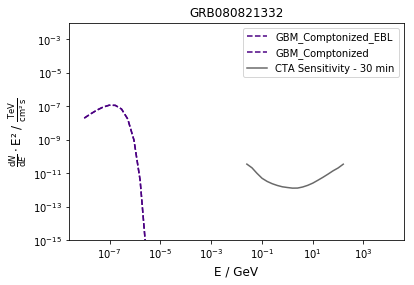

Start simulation for GRB161111197 with (random?) redshift =  1.06715663554
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


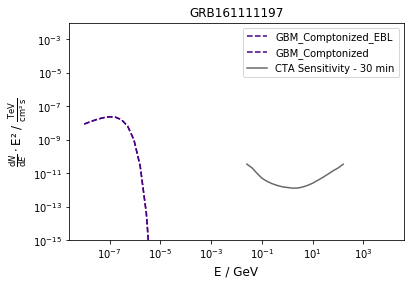

Start simulation for GRB150127935 with (random?) redshift =  0.771018240114
Start IRF part
Ready
11890.346948252583 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


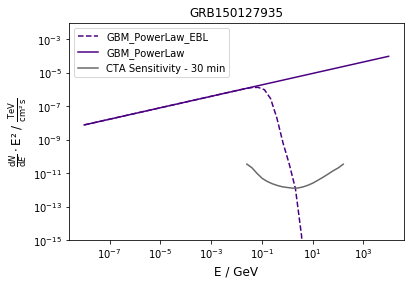

Start simulation for GRB090528516 with (random?) redshift =  2.53362195802
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


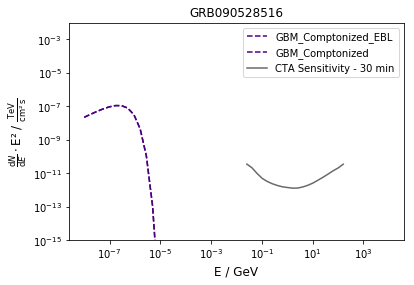

Start simulation for GRB120217904 with (random?) redshift =  0.599922409235
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


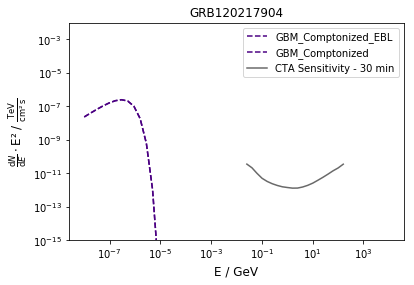

Start simulation for GRB101225377 with (random?) redshift =  1.63141796596
Start IRF part
Ready
1063.7966474713642 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


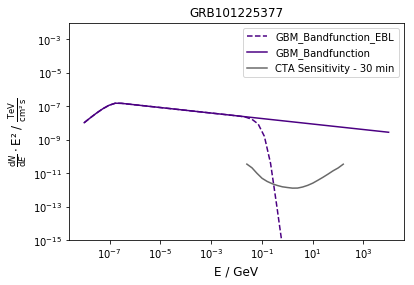

Start simulation for GRB081206275 with (random?) redshift =  1.87701379899
Start IRF part
Ready
5735.678774542552 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


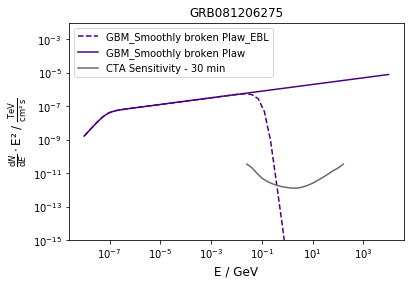

Start simulation for GRB140516765 with (random?) redshift =  1.7826267783
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


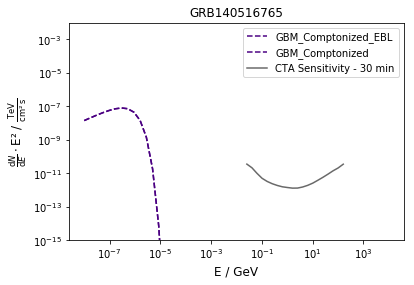

Start simulation for GRB140808038 with (random?) redshift =  1.45066435511
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


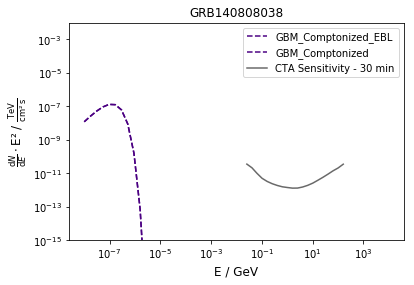

Start simulation for GRB110213220 with (random?) redshift =  0.834155683123
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


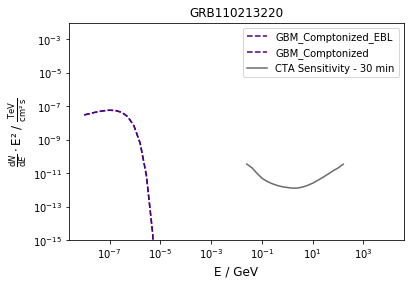

Start simulation for GRB110522296 with (random?) redshift =  1.57396127207
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


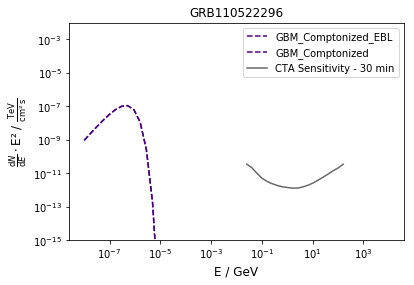

Start simulation for GRB120819048 with (random?) redshift =  3.55565615096
Start IRF part
Ready
7926.19134986871 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


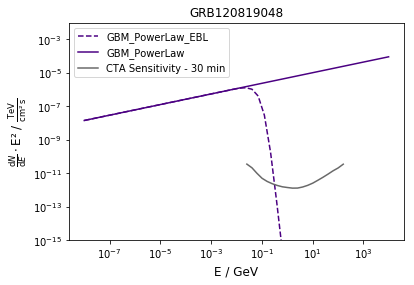

Start simulation for GRB130206482 with (random?) redshift =  0.286076498949
Start IRF part
Ready
777.7712452740268 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


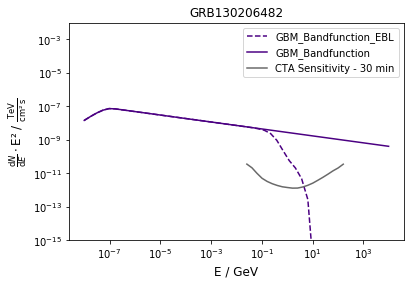

Start simulation for GRB100212588 with (random?) redshift =  1.4687066931
Start IRF part
Ready
7358.4197255261015 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


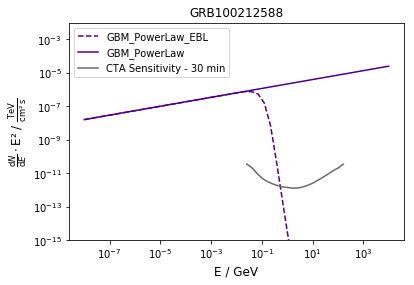

Start simulation for GRB140906175 with (random?) redshift =  1.81019658594
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


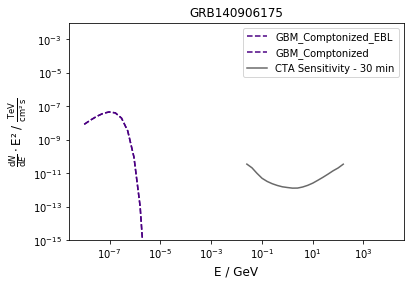

Start simulation for GRB121124606 with (random?) redshift =  1.40318182249
Start IRF part
Ready
79917.06896007495 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


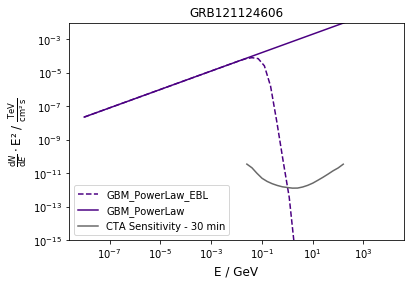

Start simulation for GRB100411516 with (random?) redshift =  1.29236526388
Start IRF part
Ready
28245.54550768601 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


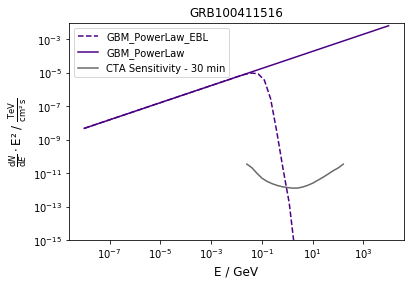

Start simulation for GRB121122885 with (random?) redshift =  2.05569905147
Start IRF part
Ready
0.31843033965096473 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


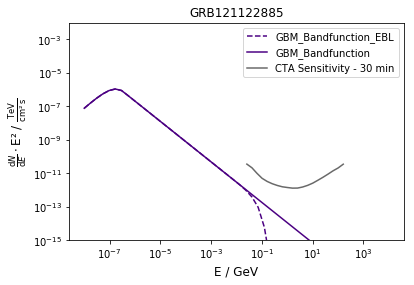

Start simulation for GRB101223834 with (random?) redshift =  3.33397802718
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


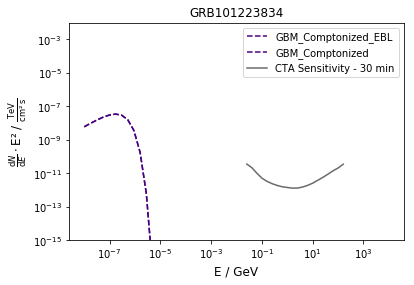

Start simulation for GRB121220311 with (random?) redshift =  0.901656629911
Start IRF part
Ready
164465.19149734467 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


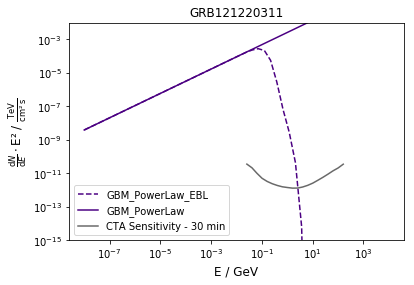

Start simulation for GRB131029973 with (random?) redshift =  2.3833868909
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


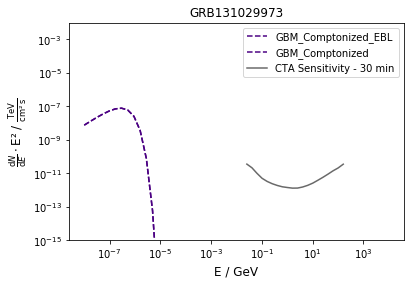

Start simulation for GRB110710954 with (random?) redshift =  3.42531188306
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


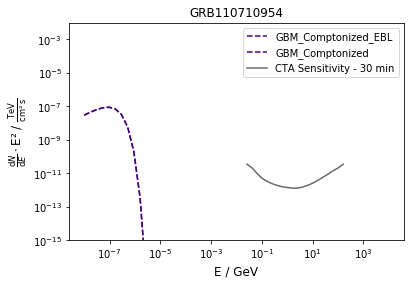

Start simulation for GRB131125689 with (random?) redshift =  2.47608642629
Start IRF part
Ready
49230.41963303674 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


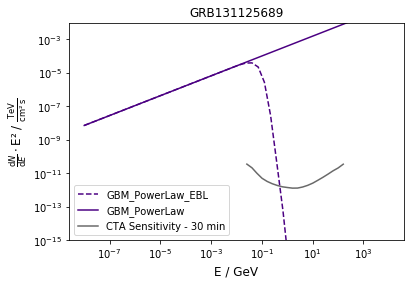

Start simulation for GRB140928100 with (random?) redshift =  1.17864594262
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


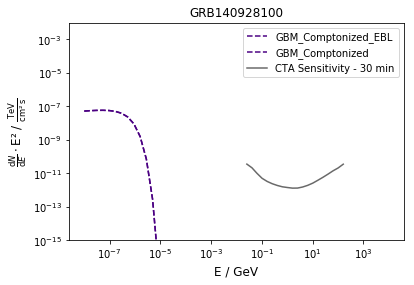

Start simulation for GRB141031257 with (random?) redshift =  0.457524257393
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


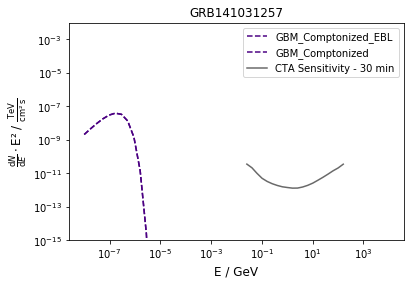

Start simulation for GRB090108020 with (random?) redshift =  0.839528661287
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


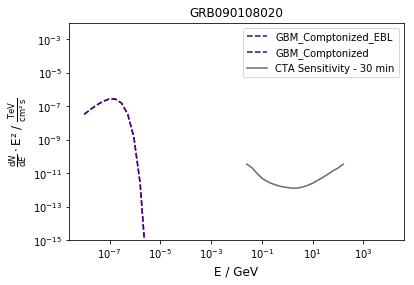

Start simulation for GRB101220576 with (random?) redshift =  2.56967805026
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


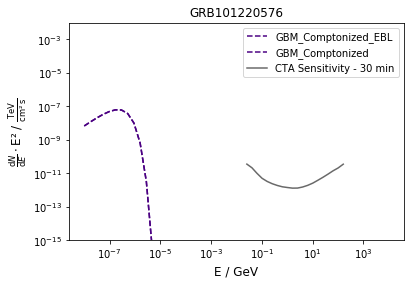

Start simulation for GRB120703498 with (random?) redshift =  1.98247983951
Start IRF part
Ready
8605.240326926063 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


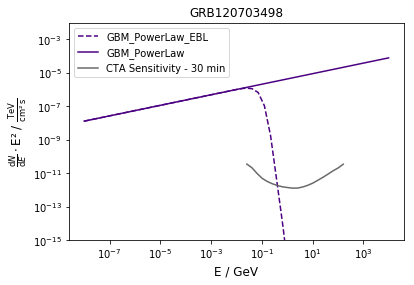

Start simulation for GRB160917479 with (random?) redshift =  1.03516008233
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


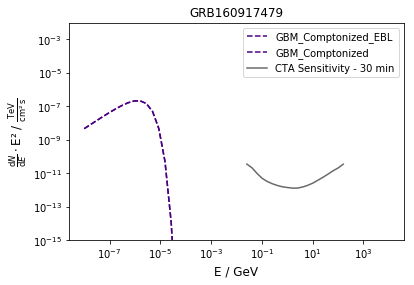

Start simulation for GRB121122564 with (random?) redshift =  3.64719026509
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


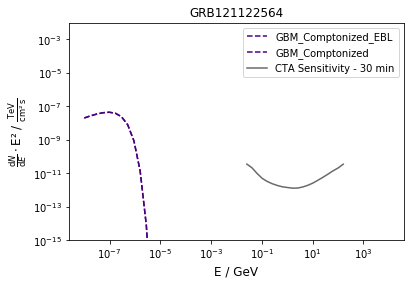

Start simulation for GRB170610689 with (random?) redshift =  1.29557231187
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


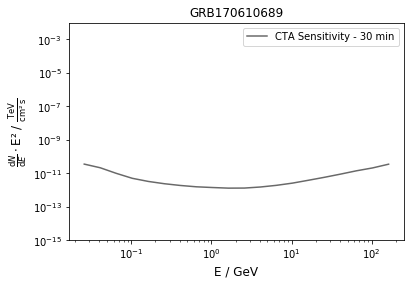

Start simulation for GRB140907672 with (random?) redshift =  2.68359532044
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


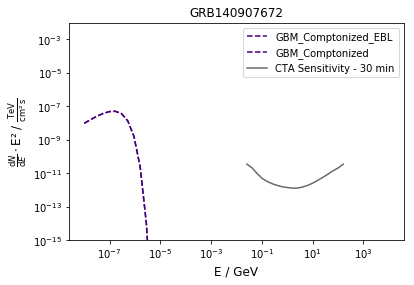

Start simulation for GRB100328141 with (random?) redshift =  0.358352794345
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


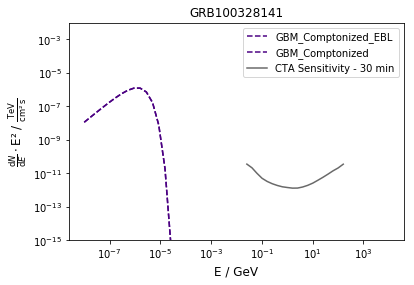

Start simulation for GRB160119072 with (random?) redshift =  1.39327189386
Start IRF part
Ready
84235.02691935153 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


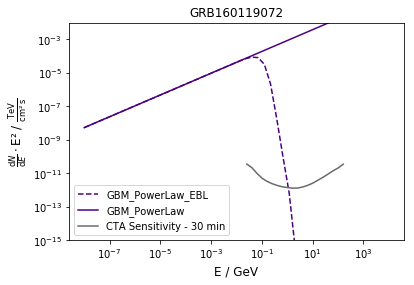

Start simulation for GRB090403314 with (random?) redshift =  0.55473784937
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


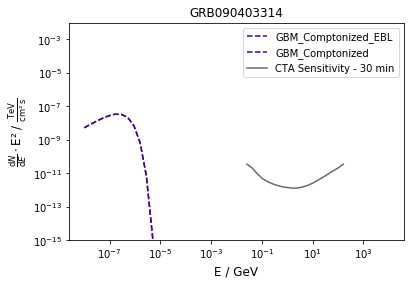

Start simulation for GRB090529564 with (random?) redshift =  4.72471366295
Start IRF part
Ready
4161.010349476945 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


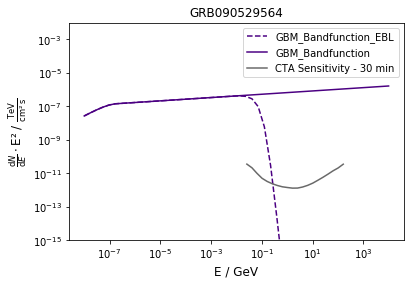

Start simulation for GRB101021063 with (random?) redshift =  3.13616067641
Start IRF part
Ready
162281.4955211865 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


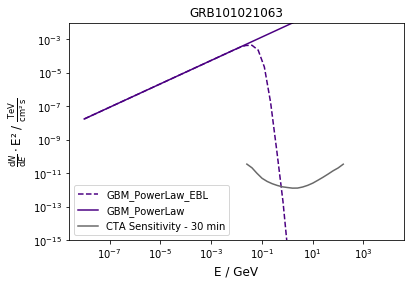

Start simulation for GRB130705398 with (random?) redshift =  1.28135752293
Start IRF part
Ready
191685.63659546946 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


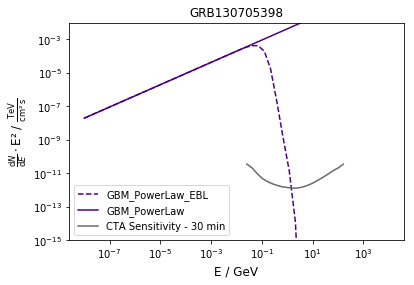

Start simulation for GRB160718975 with (random?) redshift =  0.823871267931
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


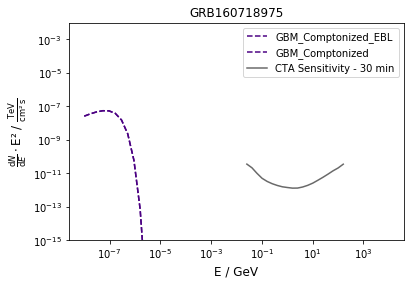

Start simulation for GRB130518580 with (random?) redshift =  2.34860944001
Start IRF part
Ready
910.9346066410297 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


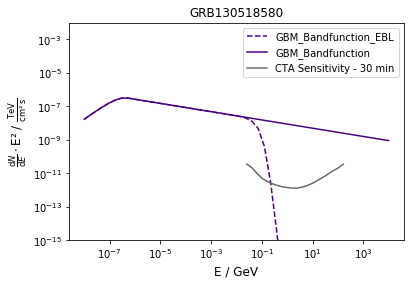

Start simulation for GRB100424876 with (random?) redshift =  4.29755693453
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


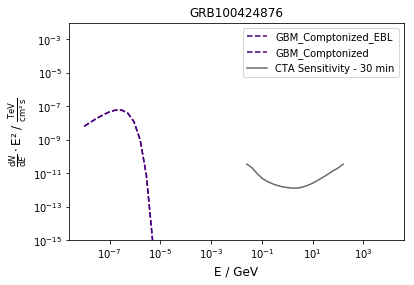

Start simulation for GRB151118554 with (random?) redshift =  3.67014323207
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


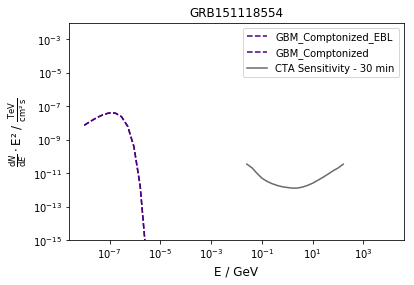

Start simulation for GRB160530667 with (random?) redshift =  1.75214194972
Start IRF part
Ready
262.20168275840945 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


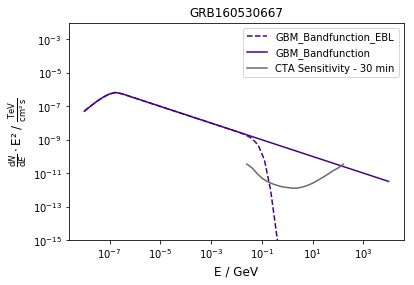

Start simulation for GRB101010190 with (random?) redshift =  0.982117265092
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


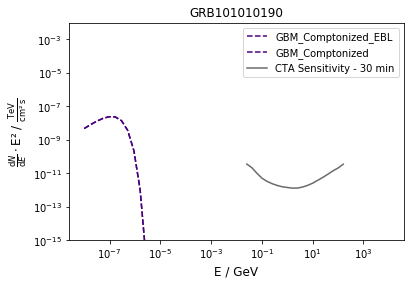

Start simulation for GRB160922856 with (random?) redshift =  0.273516754654
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


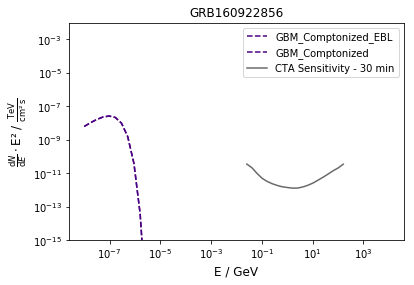

Start simulation for GRB161228553 with (random?) redshift =  0.923754183799
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


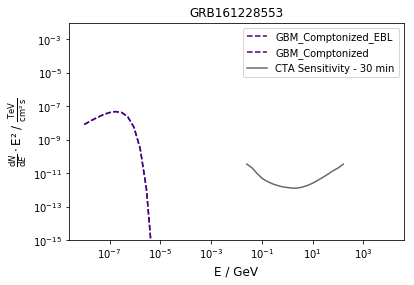

Start simulation for GRB160816414 with (random?) redshift =  3.64160878744
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


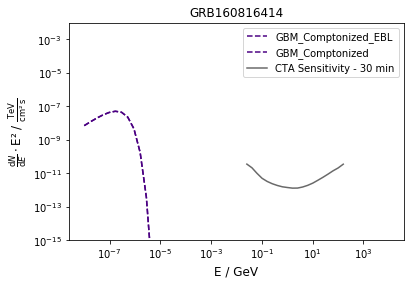

Start simulation for GRB140416060 with (random?) redshift =  1.50733018187
Start IRF part
Ready
117.33288548536335 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


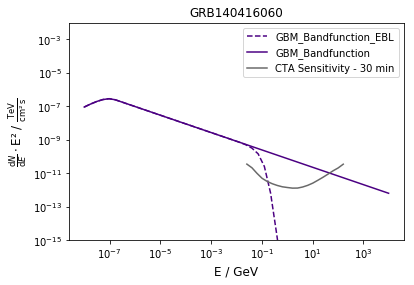

Start simulation for GRB161026373 with (random?) redshift =  1.96487494391
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


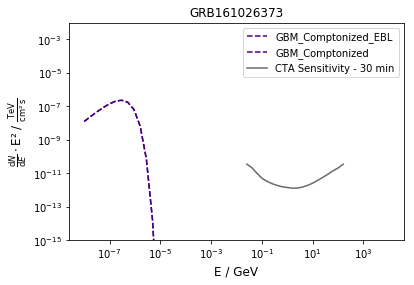

Start simulation for GRB111010709 with (random?) redshift =  1.43578327648
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


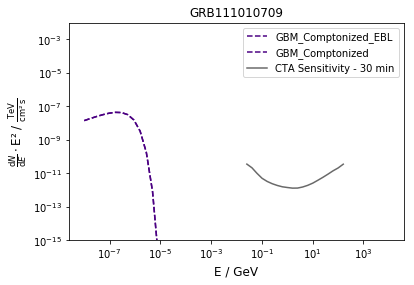

Start simulation for GRB130204484 with (random?) redshift =  2.8140501879
Start IRF part
Ready
176649.71667530265 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


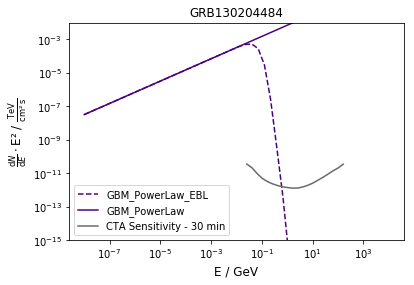

Start simulation for GRB110107886 with (random?) redshift =  0.916544392894
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


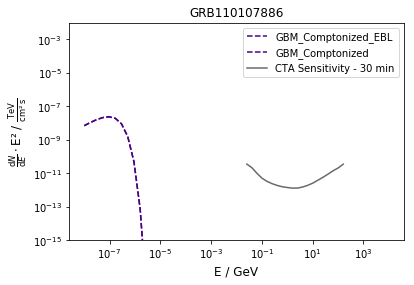

Start simulation for GRB150502435 with (random?) redshift =  2.70652941839
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


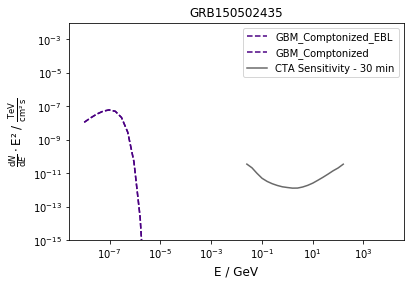

Start simulation for GRB110903009 with (random?) redshift =  3.4157817827
Start IRF part
Ready
62.6190517947574 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


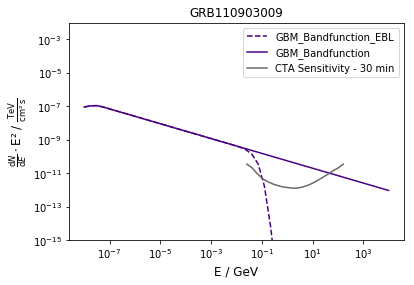

Start simulation for GRB160623209 with (random?) redshift =  0.303006261433
Start IRF part
Ready
36868.036036241836 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


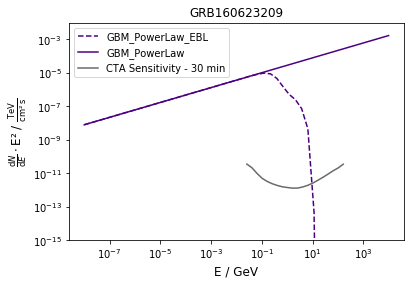

Start simulation for GRB091109895 with (random?) redshift =  1.28873717552
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


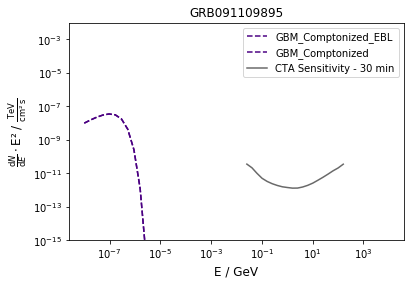

Start simulation for GRB080802386 with (random?) redshift =  2.56554131195
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


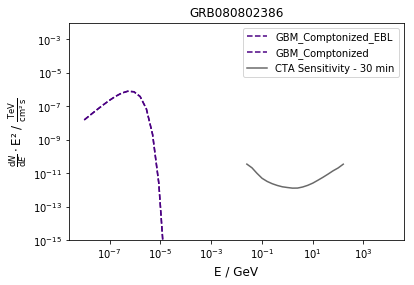

Start simulation for GRB130219775 with (random?) redshift =  2.38079066162
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


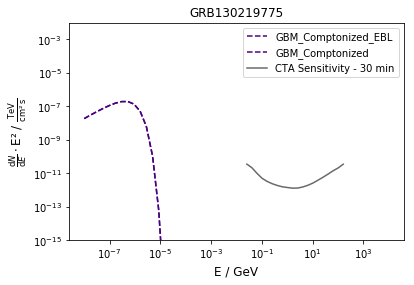

Start simulation for GRB100614498 with (random?) redshift =  0.962594184678
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


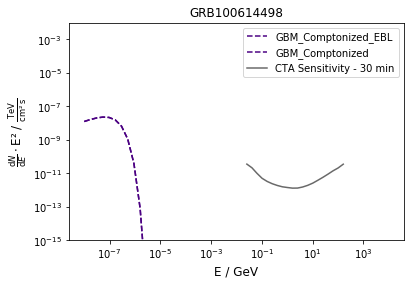

Start simulation for GRB150917148 with (random?) redshift =  0.93750441944
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


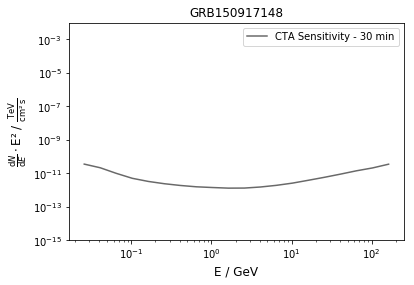

Start simulation for GRB110709642 with (random?) redshift =  8.13302767138
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


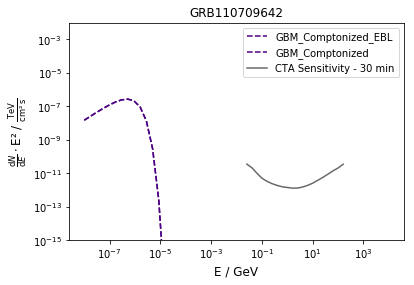

Start simulation for GRB130118482 with (random?) redshift =  2.44284540834
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


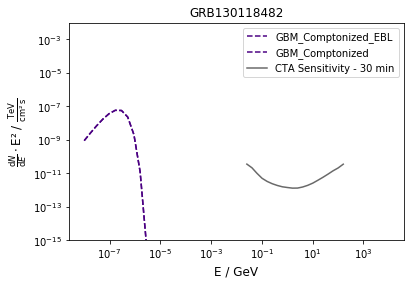

Start simulation for GRB100525744 with (random?) redshift =  3.36785555735
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


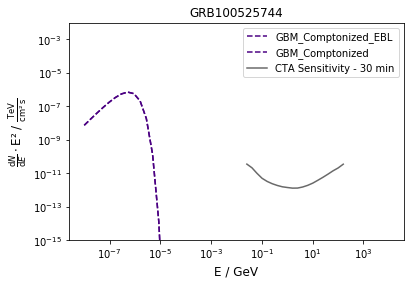

Start simulation for GRB170717952 with (random?) redshift =  3.61708950956
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


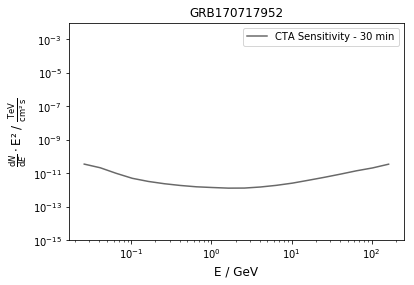

Start simulation for GRB140224788 with (random?) redshift =  0.946389054007
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


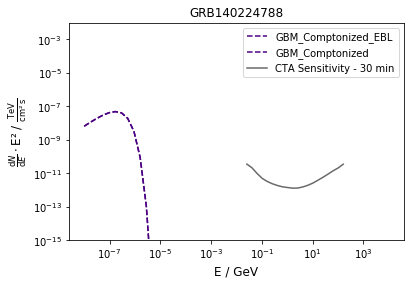

Start simulation for GRB090428441 with (random?) redshift =  1.72824105285
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


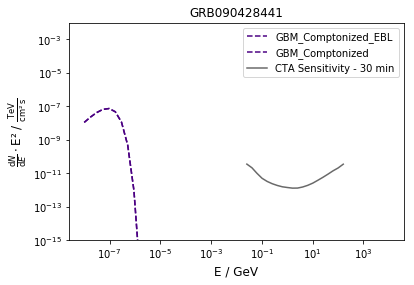

Start simulation for GRB100923844 with (random?) redshift =  1.08663132065
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


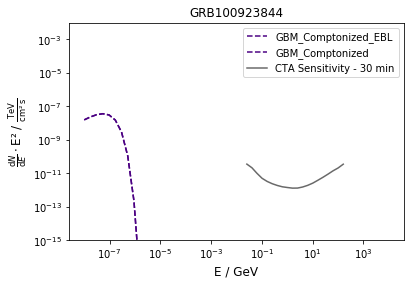

Start simulation for GRB150819440 with (random?) redshift =  1.02987127409
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


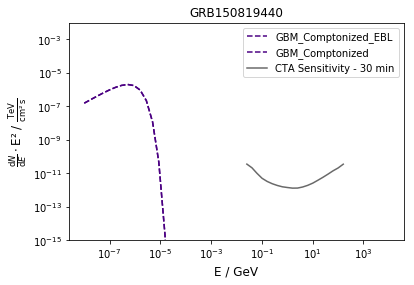

Start simulation for GRB161121186 with (random?) redshift =  2.02649788957
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


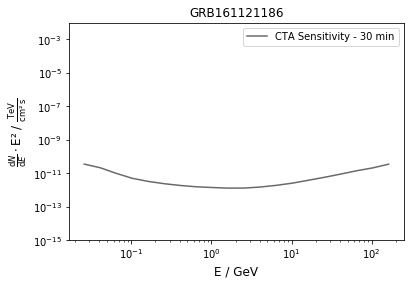

Start simulation for GRB170723882 with (random?) redshift =  3.03454948162
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


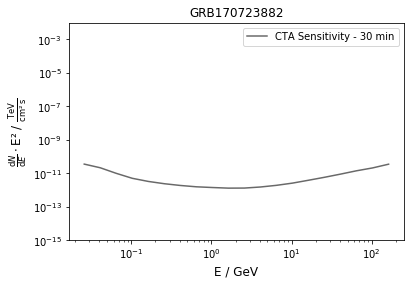

Start simulation for GRB081122520 with (random?) redshift =  4.00303297081
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


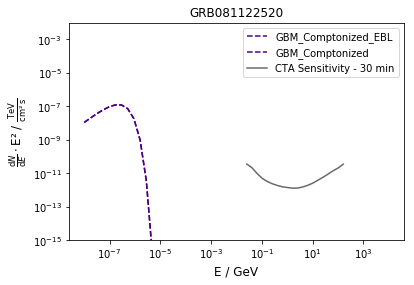

Start simulation for GRB120105584 with (random?) redshift =  11.4923558014
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


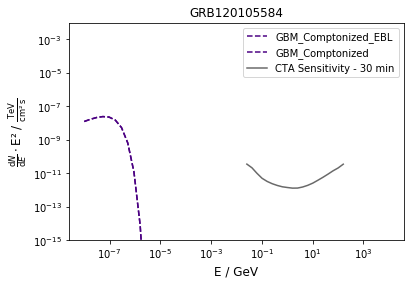

Start simulation for GRB110705151 with (random?) redshift =  0.642230526231
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


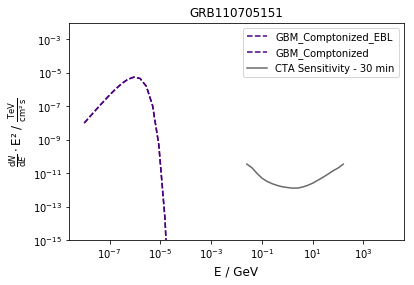

Start simulation for GRB140124527 with (random?) redshift =  2.07763582123
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


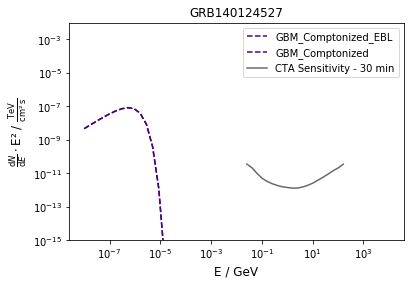

Start simulation for GRB121125469 with (random?) redshift =  6.35802608565
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


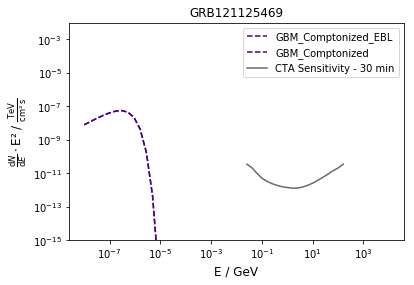

Start simulation for GRB081105614 with (random?) redshift =  1.08516016939
Start IRF part
Ready
722868.3699164897 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


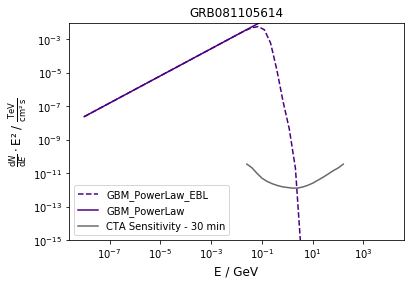

Start simulation for GRB160102936 with (random?) redshift =  0.94869486775
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


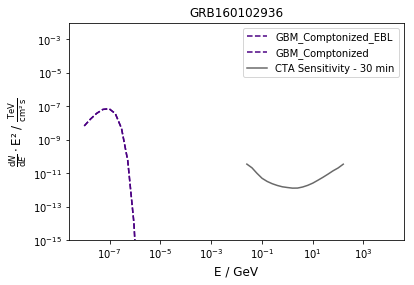

Start simulation for GRB110920338 with (random?) redshift =  0.749811553843
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


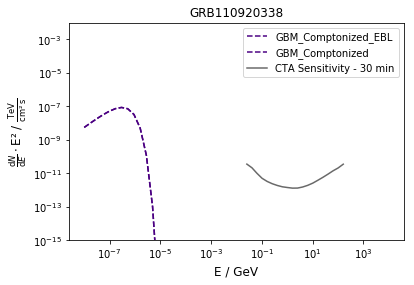

Start simulation for GRB140626843 with (random?) redshift =  2.45166937466
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


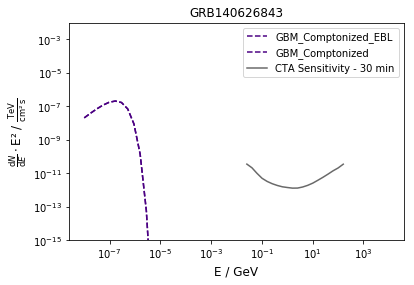

Start simulation for GRB140521184 with (random?) redshift =  1.63359564175
Start IRF part
Ready
9848.832418097287 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


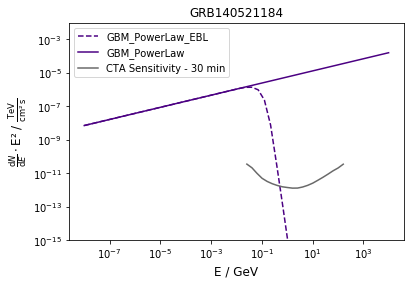

Start simulation for GRB171017823 with (random?) redshift =  2.73048866494
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


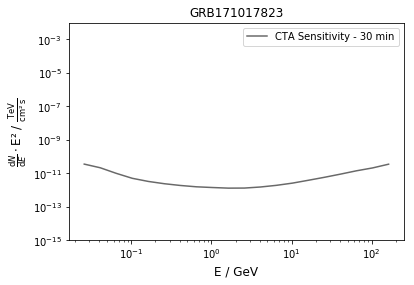

Start simulation for GRB090726218 with (random?) redshift =  0.565720051625
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


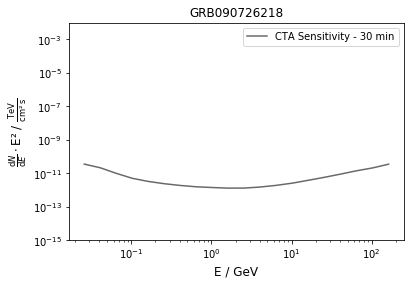

Start simulation for GRB120702891 with (random?) redshift =  0.371091891239
Start IRF part
Ready
60253.86910648434 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


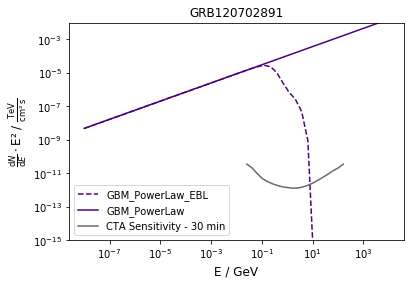

Start simulation for GRB120217808 with (random?) redshift =  1.8051296796
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


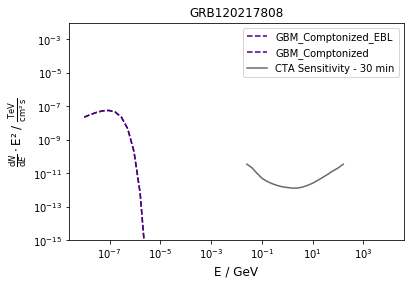

Start simulation for GRB101008697 with (random?) redshift =  1.79215634555
Start IRF part
Ready
45788.82514738558 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


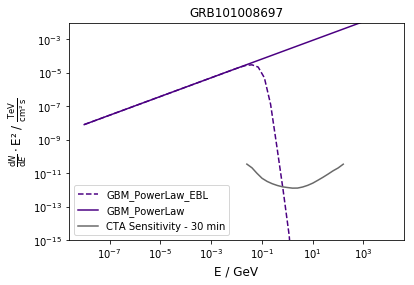

Start simulation for GRB160816730 with (random?) redshift =  0.869378369429
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


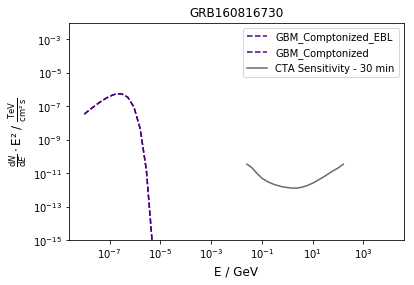

Start simulation for GRB091112928 with (random?) redshift =  0.641916841449
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


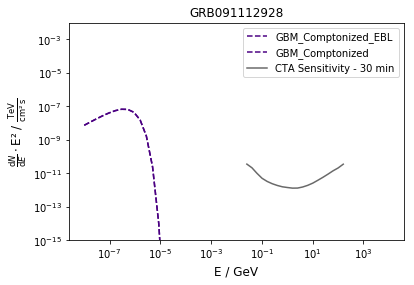

Start simulation for GRB100621452 with (random?) redshift =  1.9374869628
Start IRF part
Ready
5037.075092585347 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


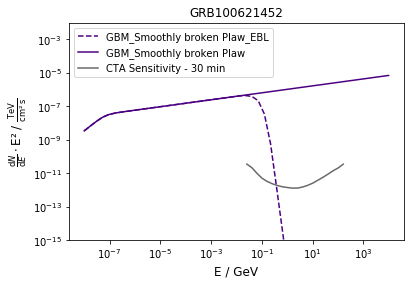

Start simulation for GRB160818230 with (random?) redshift =  1.18248654642
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


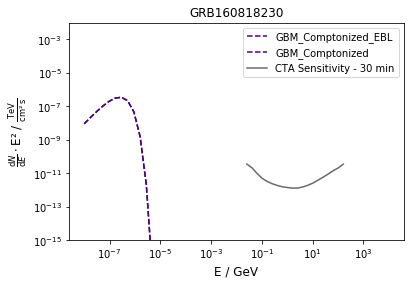

Start simulation for GRB150325696 with (random?) redshift =  3.46047029827
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


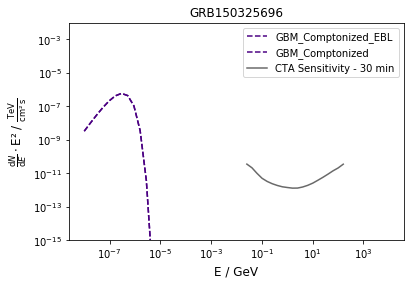

Start simulation for GRB151205657 with (random?) redshift =  7.27009369441
Start IRF part
Ready
52792.425370815785 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


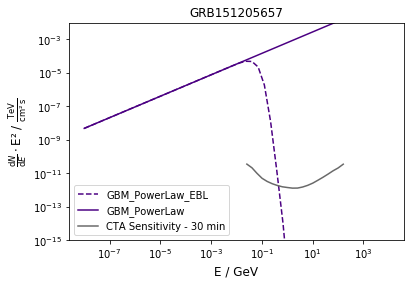

Start simulation for GRB110226989 with (random?) redshift =  2.31541246187
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


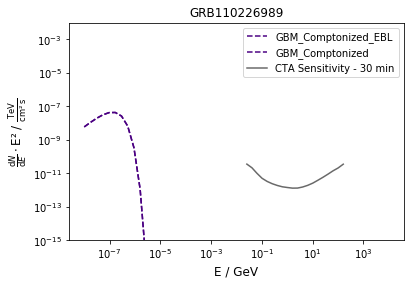

Start simulation for GRB140827763 with (random?) redshift =  1.74408692108
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


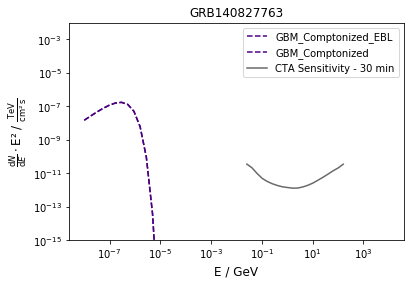

Start simulation for GRB110904124 with (random?) redshift =  1.43036256969
Start IRF part
Ready
1989.6583684266177 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


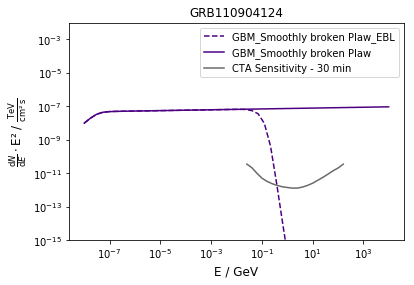

Start simulation for GRB140610487 with (random?) redshift =  0.610419789382
Start IRF part
Ready
435059.44973680977 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


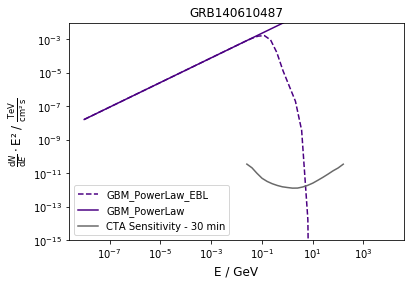

Start simulation for GRB130623790 with (random?) redshift =  3.52870060646
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


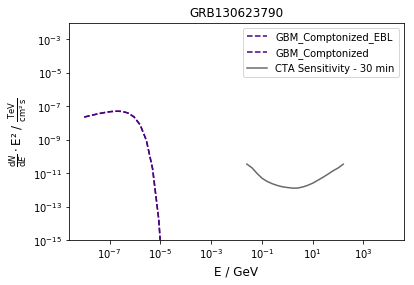

Start simulation for GRB141005217 with (random?) redshift =  4.03540242473
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


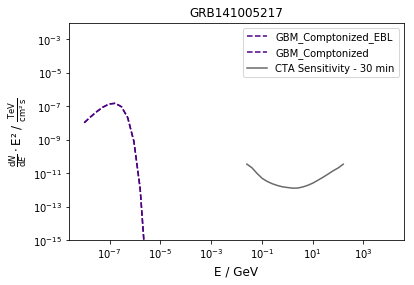

Start simulation for GRB160508290 with (random?) redshift =  0.612366355828
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


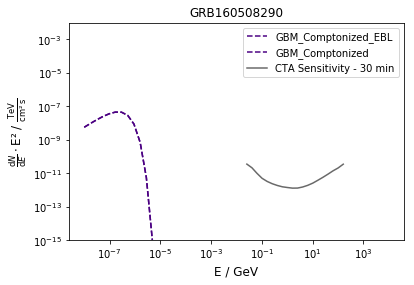

Start simulation for GRB120520949 with (random?) redshift =  0.914956409642
Start IRF part
Ready
20667.900965517212 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


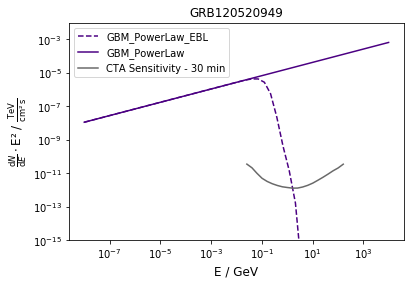

Start simulation for GRB081003644 with (random?) redshift =  2.33520312549
Start IRF part
Ready
15784.815989098512 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


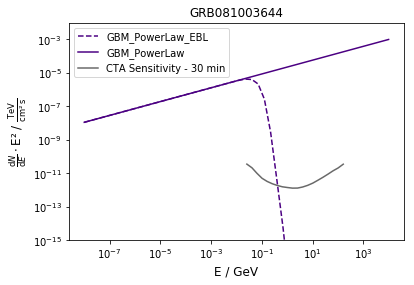

Start simulation for GRB090610648 with (random?) redshift =  1.07104282779
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


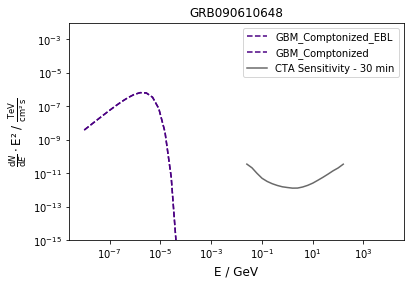

Start simulation for GRB120120432 with (random?) redshift =  2.08463241651
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


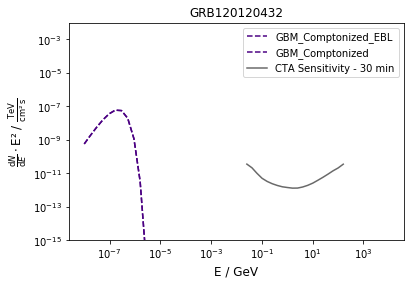

Start simulation for GRB100216422 with (random?) redshift =  1.39147602394
Start IRF part
Ready
334010.0602822132 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


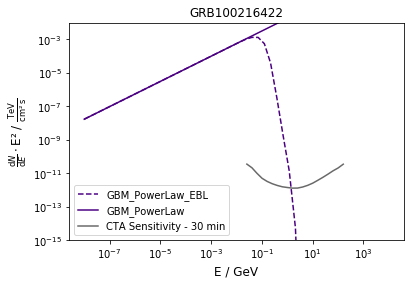

Start simulation for GRB130623130 with (random?) redshift =  5.81328336421
Start IRF part
Ready
5908.535519113906 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


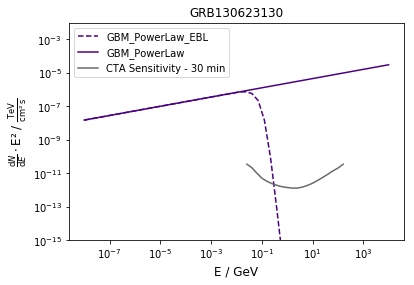

Start simulation for GRB160407673 with (random?) redshift =  4.36891472977
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


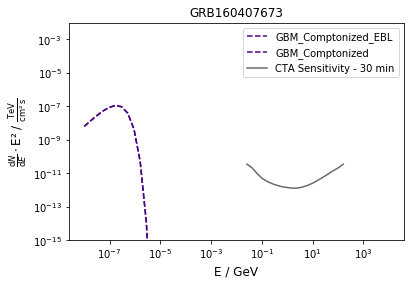

Start simulation for GRB170928607 with (random?) redshift =  0.534589071503
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


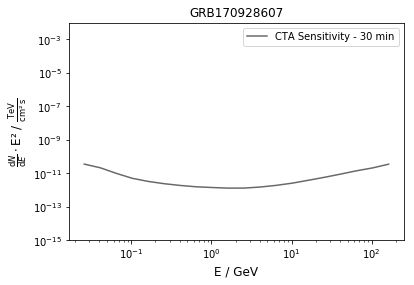

Start simulation for GRB150928359 with (random?) redshift =  2.55996179117
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


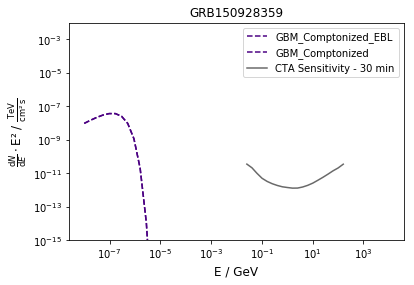

Start simulation for GRB110311812 with (random?) redshift =  1.22891281837
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


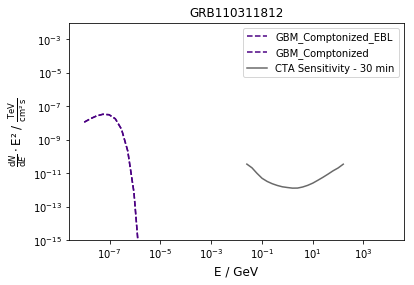

Start simulation for GRB110928180 with (random?) redshift =  2.5203147234
Start IRF part
Ready
2926.2286802252006 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


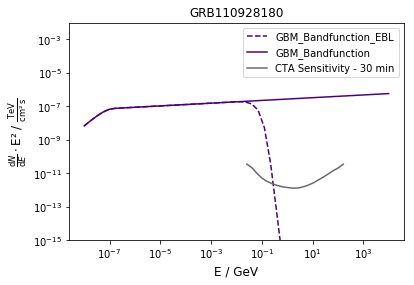

Start simulation for GRB111231622 with (random?) redshift =  4.00789752016
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


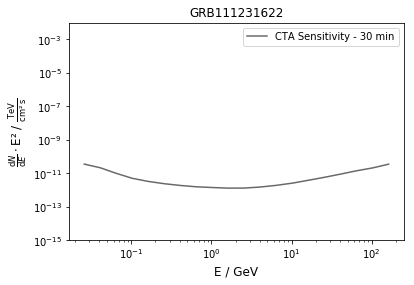

Start simulation for GRB140519043 with (random?) redshift =  3.81471356
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


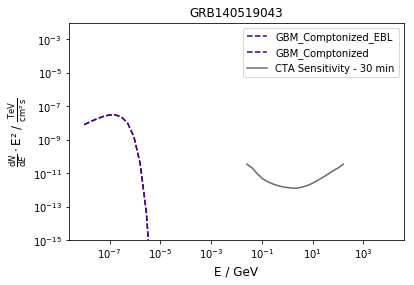

Start simulation for GRB101224614 with (random?) redshift =  2.06910989407
Start IRF part
Ready
4101.28308713222 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


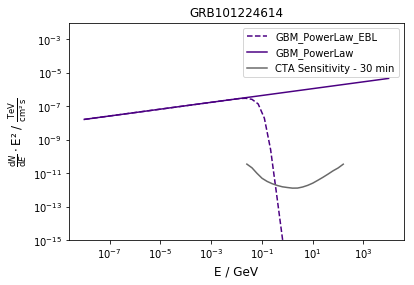

Start simulation for GRB160721806 with (random?) redshift =  7.37240528668
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


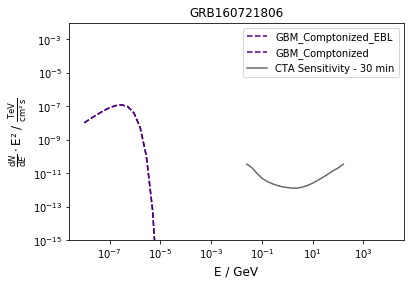

Start simulation for GRB110813237 with (random?) redshift =  1.13997817612
Start IRF part
Ready
2544.672593904326 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


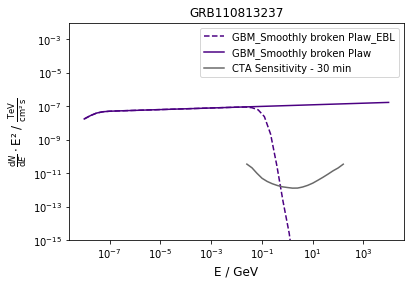

Start simulation for GRB170511249 with (random?) redshift =  0.826949891511
Start IRF part
Ready
559.7811465782253 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


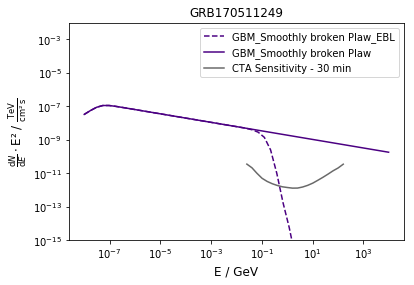

Start simulation for GRB100929315 with (random?) redshift =  1.5925295809
Start IRF part
Ready
22960.160631366627 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


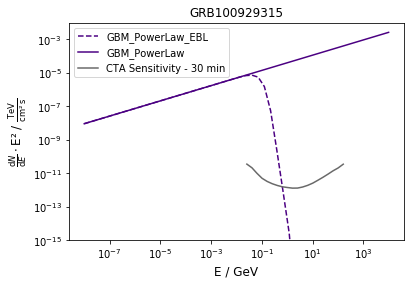

Start simulation for GRB130808253 with (random?) redshift =  1.329654234
Start IRF part
Ready
8343.780694386434 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


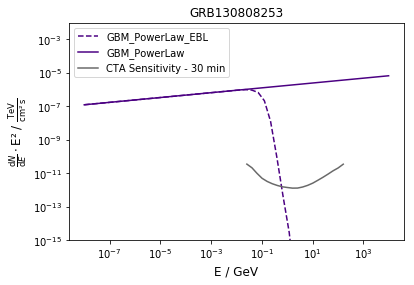

Start simulation for GRB131122490 with (random?) redshift =  0.160168148301
Start IRF part
Ready
1053.3315385771225 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


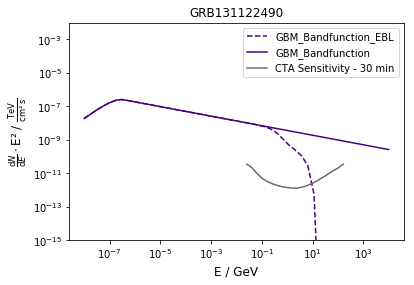

Start simulation for GRB090113778 with (random?) redshift =  2.42471016056
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


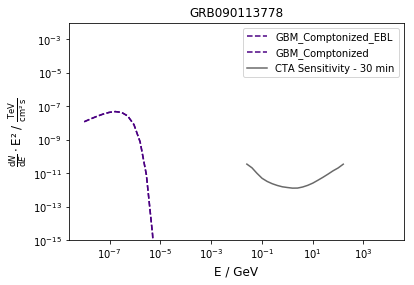

Start simulation for GRB090328713 with (random?) redshift =  1.48166458096
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


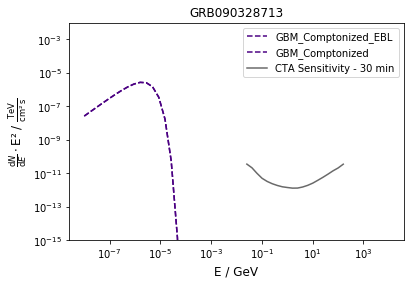

Start simulation for GRB141030746 with (random?) redshift =  0.240508075918
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


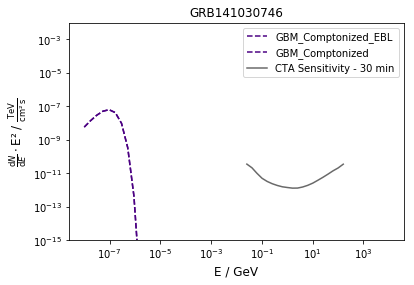

Start simulation for GRB160223416 with (random?) redshift =  1.95348892924
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


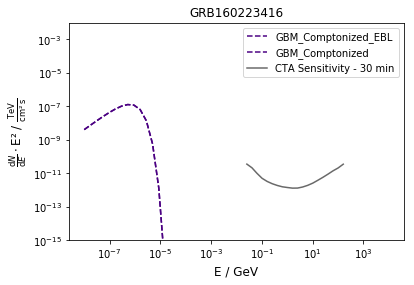

Start simulation for GRB100929235 with (random?) redshift =  1.05918943668
Start IRF part
Ready
87788.30621386482 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


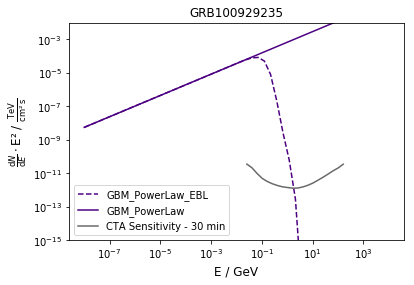

Start simulation for GRB170808065 with (random?) redshift =  0.812309239362
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


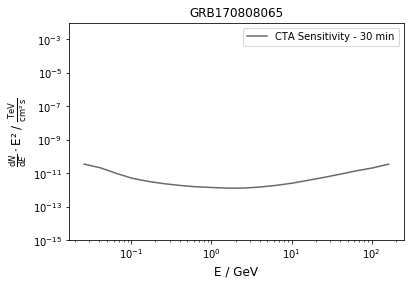

Start simulation for GRB120811649 with (random?) redshift =  0.795068293126
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


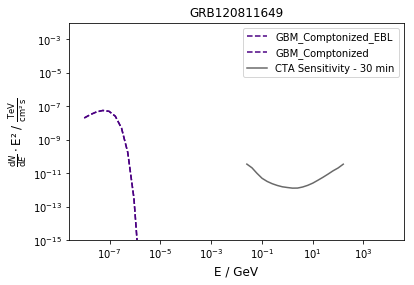

Start simulation for GRB160821937 with (random?) redshift =  2.54259732914
Start IRF part
Ready
4408.463445028871 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


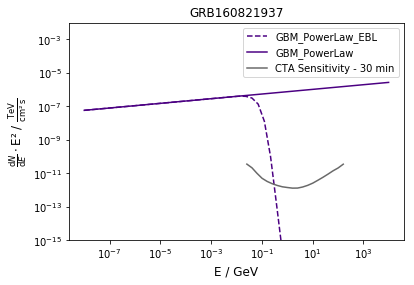

Start simulation for GRB141026742 with (random?) redshift =  0.800942411787
Start IRF part
Ready
20657.031655042098 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


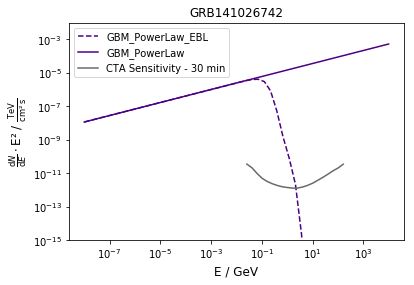

Start simulation for GRB140204547 with (random?) redshift =  1.57321478838
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


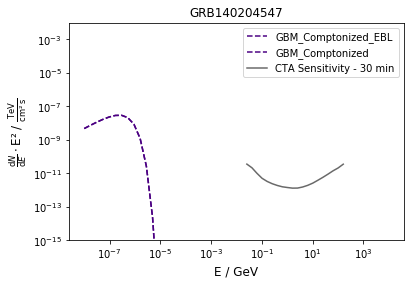

Start simulation for GRB170723677 with (random?) redshift =  1.51065766032
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


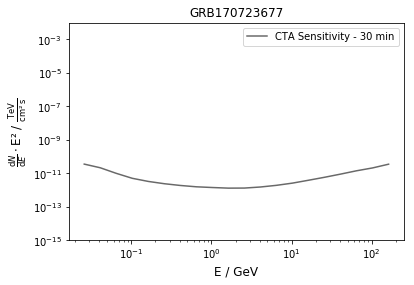

Start simulation for GRB110722710 with (random?) redshift =  2.0027009378
Start IRF part
Ready
37989.131455488554 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


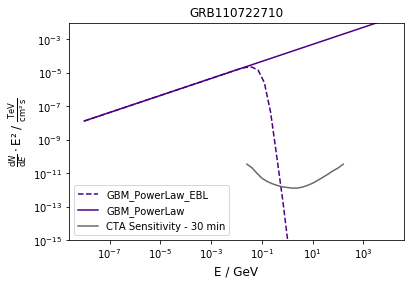

Start simulation for GRB080809808 with (random?) redshift =  3.57326848476
Start IRF part
Ready
3068.6715174288197 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


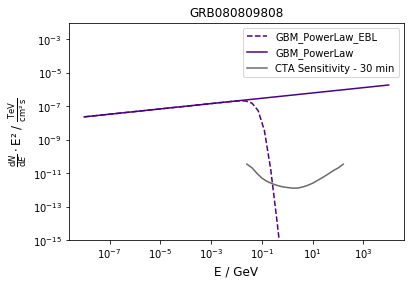

Start simulation for GRB090912660 with (random?) redshift =  1.98955199961
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


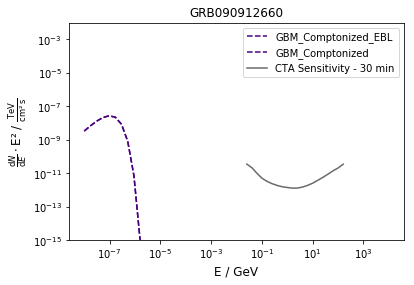

Start simulation for GRB170111760 with (random?) redshift =  1.58626489229
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


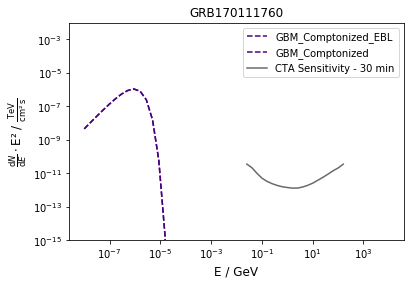

Start simulation for GRB161109263 with (random?) redshift =  1.29776882679
Start IRF part
Ready
1401.720421923546 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


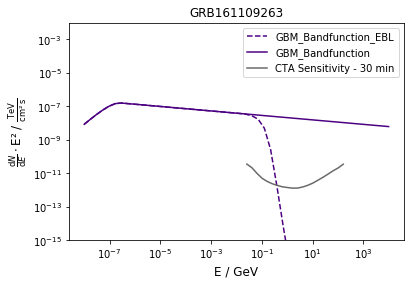

Start simulation for GRB090621185 with (random?) redshift =  1.08372185711
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


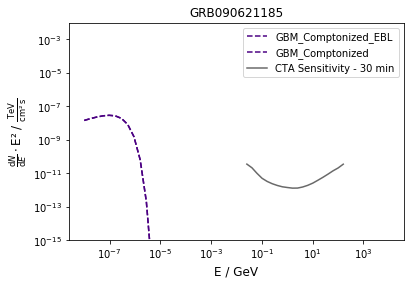

Start simulation for GRB130325005 with (random?) redshift =  1.13185598895
Start IRF part
Ready
45396.47286584322 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


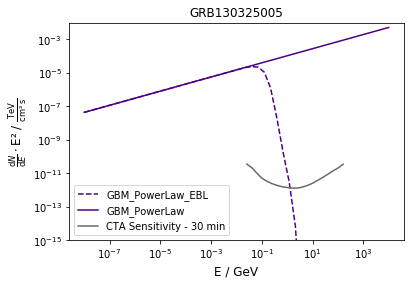

Start simulation for GRB121019233 with (random?) redshift =  1.46613071477
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


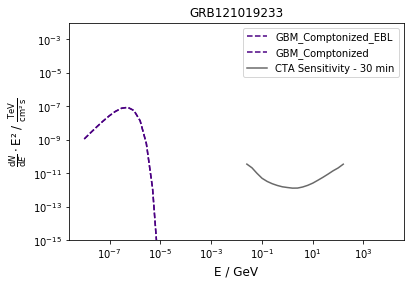

Start simulation for GRB100811781 with (random?) redshift =  4.91915955667
Start IRF part
Ready
1720.1624476880902 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


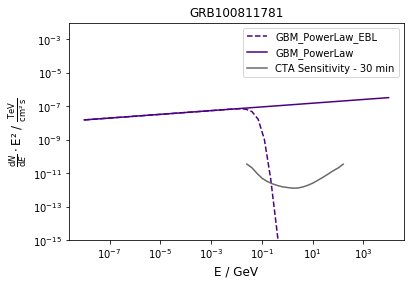

Start simulation for GRB101119685 with (random?) redshift =  5.88303645305
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


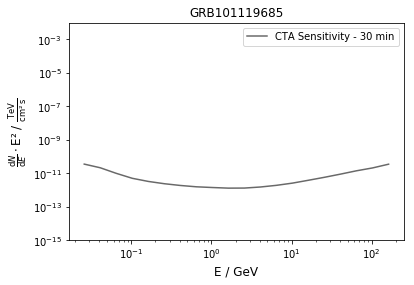

Start simulation for GRB140713780 with (random?) redshift =  1.29529977797
Start IRF part
Ready
20504.635134029504 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


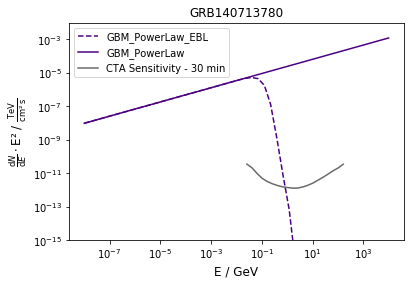

Start simulation for GRB130224370 with (random?) redshift =  3.78723603449
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


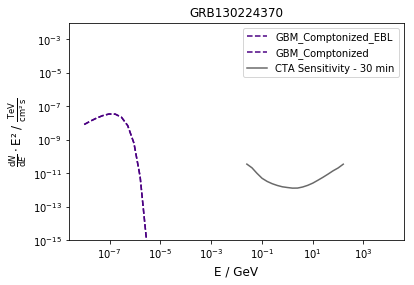

Start simulation for GRB160118060 with (random?) redshift =  0.78430873069
Start IRF part
Ready
426.1666040980628 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


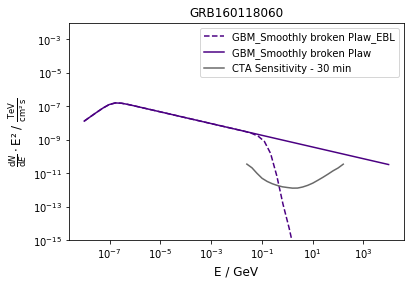

Start simulation for GRB090824918 with (random?) redshift =  1.53469001815
Start IRF part
Ready
1030.3671372186502 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


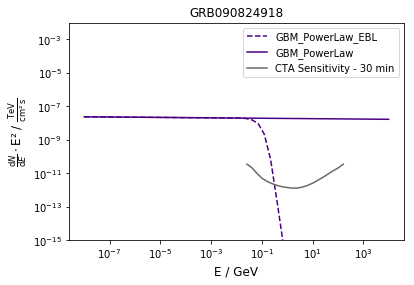

Start simulation for GRB121113544 with (random?) redshift =  3.99717085286
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


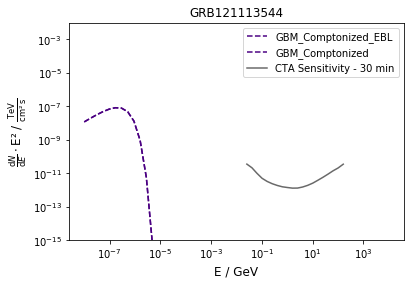

Start simulation for GRB141202470 with (random?) redshift =  1.89157519907
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


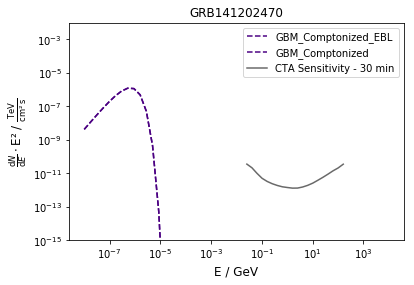

Start simulation for GRB141126233 with (random?) redshift =  3.17710751367
Start IRF part
Ready
79803.81170497379 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


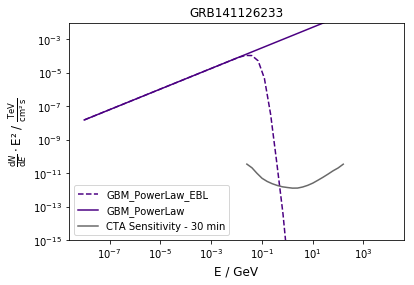

Start simulation for GRB150522944 with (random?) redshift =  2.51467659516
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


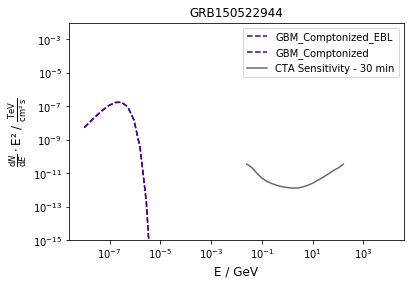

Start simulation for GRB100506653 with (random?) redshift =  0.47679702796
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


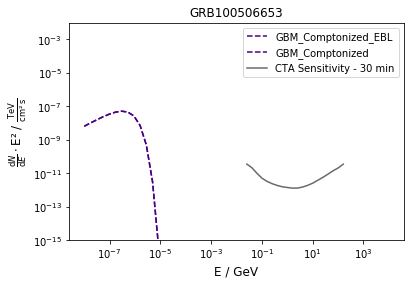

Start simulation for GRB140824606 with (random?) redshift =  2.67162374015
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


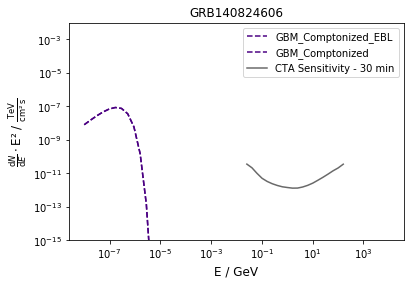

Start simulation for GRB140108721 with (random?) redshift =  3.73345471181
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


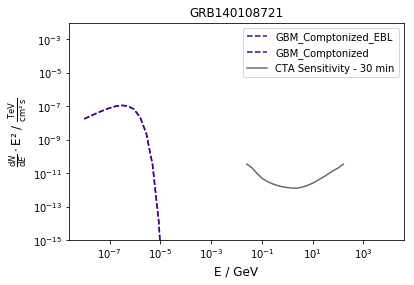

Start simulation for GRB120715066 with (random?) redshift =  0.648837891644
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


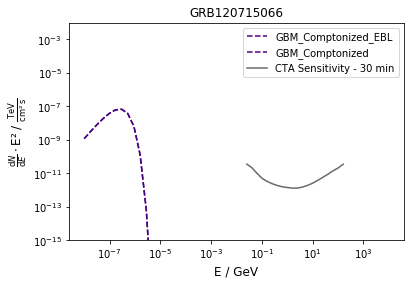

Start simulation for GRB090814368 with (random?) redshift =  3.40332549298
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


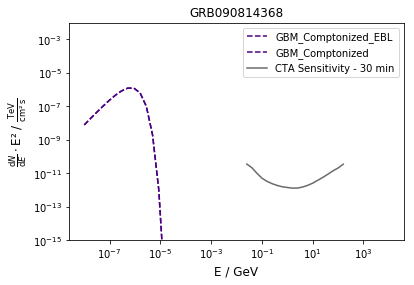

Start simulation for GRB110903111 with (random?) redshift =  0.788197068822
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


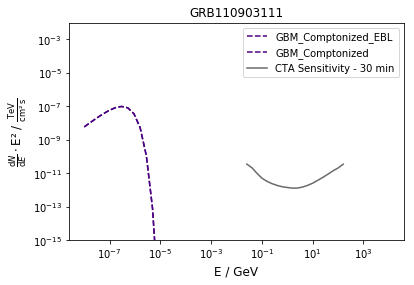

Start simulation for GRB100911816 with (random?) redshift =  1.29010075209
Start IRF part
Ready
46183.82533885085 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


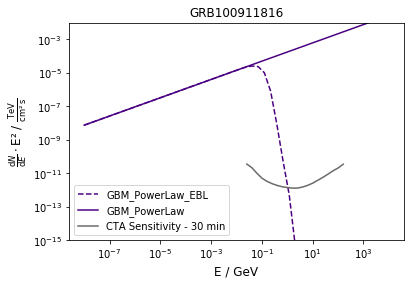

Start simulation for GRB160303201 with (random?) redshift =  2.13810813666
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


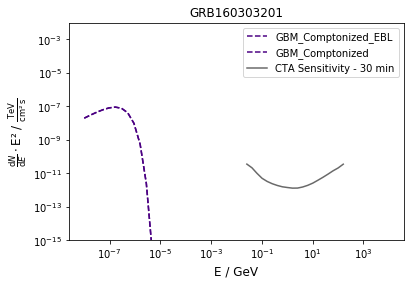

Start simulation for GRB140705539 with (random?) redshift =  0.990960543177
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


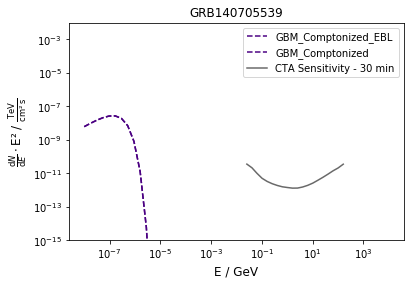

Start simulation for GRB090306245 with (random?) redshift =  4.0906198836
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


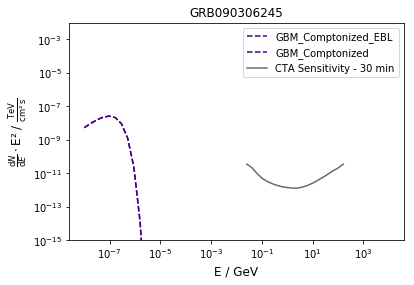

Start simulation for GRB140716306 with (random?) redshift =  0.161069596821
Start IRF part
Ready
193896.60372092493 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


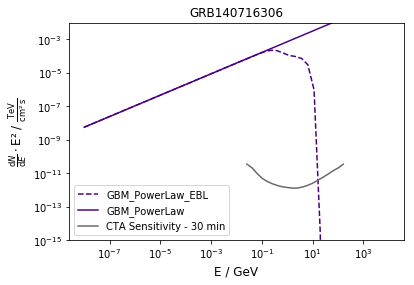

Start simulation for GRB120114681 with (random?) redshift =  0.185707018552
Start IRF part
Ready
71681.0139451128 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


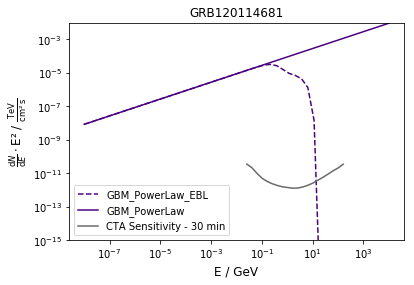

Start simulation for GRB170921168 with (random?) redshift =  1.59623280916
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


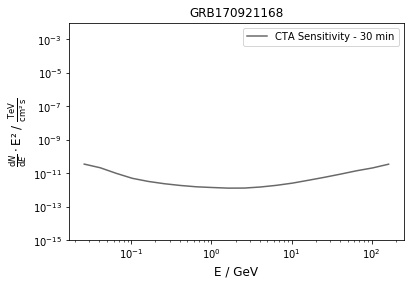

Start simulation for GRB100519204 with (random?) redshift =  1.55149162865
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


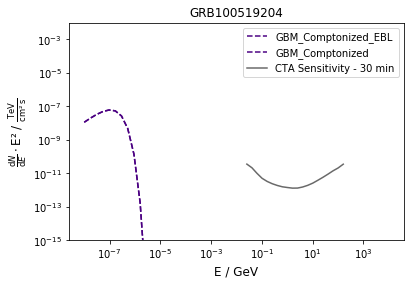

Start simulation for GRB150206407 with (random?) redshift =  0.369906658798
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


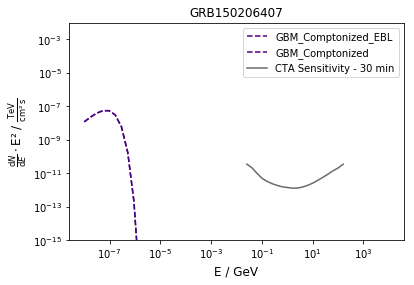

Start simulation for GRB110522256 with (random?) redshift =  1.2157251421
Start IRF part
Ready
50905.86950809349 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


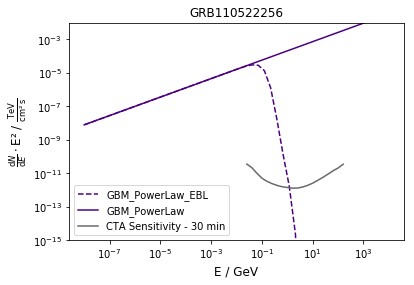

Start simulation for GRB100906576 with (random?) redshift =  0.654636669501
Start IRF part
Ready
6737.845078690315 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


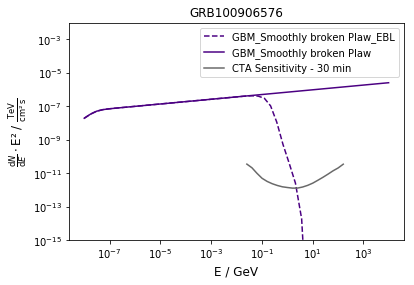

Start simulation for GRB101204343 with (random?) redshift =  1.06119887362
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


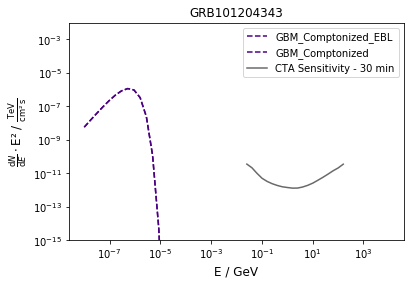

Start simulation for GRB170207906 with (random?) redshift =  1.3709176799
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


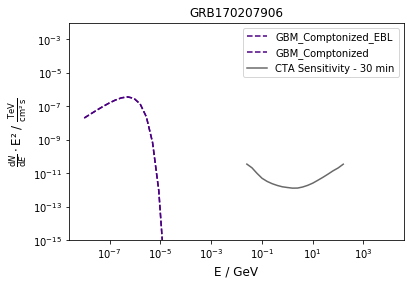

Start simulation for GRB140829880 with (random?) redshift =  0.959143414088
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


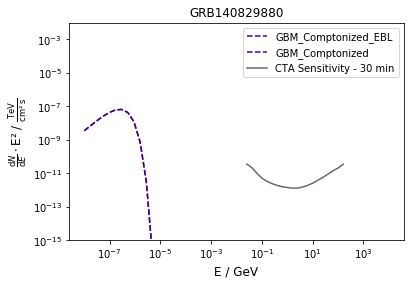

Start simulation for GRB100722291 with (random?) redshift =  0.88186877584
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


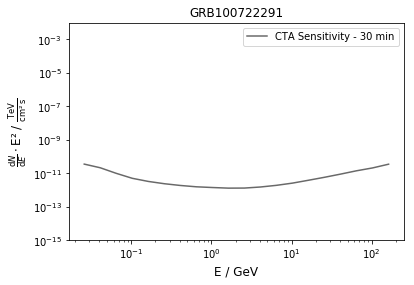

Start simulation for GRB170428136 with (random?) redshift =  1.90761668685
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


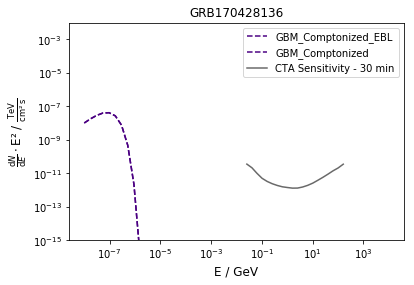

Start simulation for GRB081113230 with (random?) redshift =  5.10550792451
Start IRF part
Ready
22893.199621998217 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


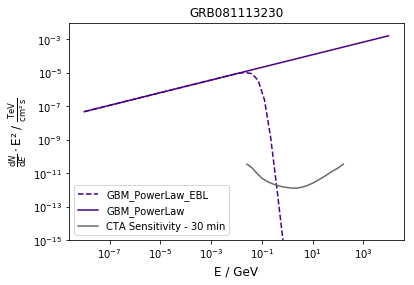

Start simulation for GRB090902401 with (random?) redshift =  1.86117920933
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


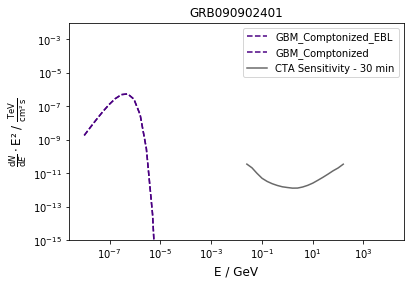

Start simulation for GRB150316400 with (random?) redshift =  1.60996430954
Start IRF part
Ready
45526.46837837092 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


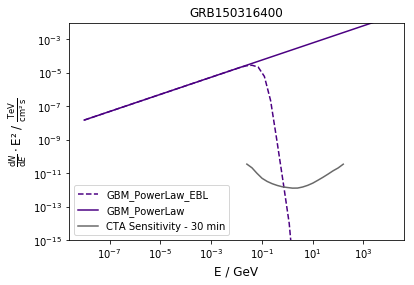

Start simulation for GRB160512536 with (random?) redshift =  1.44461040821
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


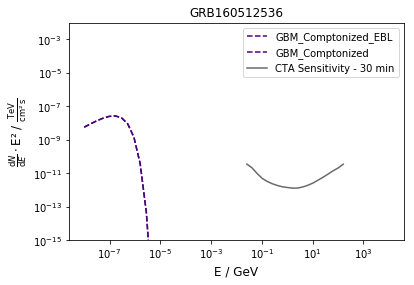

Start simulation for GRB160211119 with (random?) redshift =  1.67469522508
Start IRF part
Ready
94699.54972996638 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


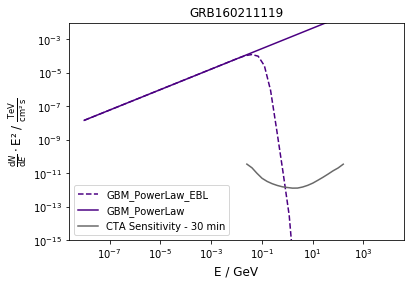

Start simulation for GRB090815438 with (random?) redshift =  2.13178234284
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


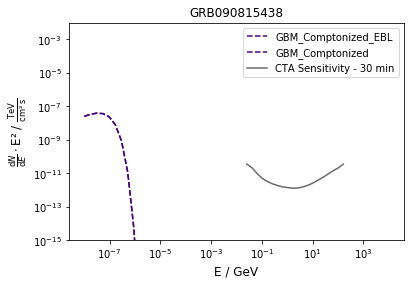

Start simulation for GRB131126163 with (random?) redshift =  1.73014308913
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


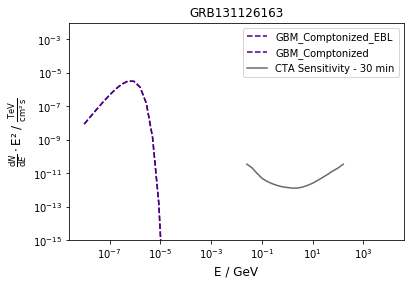

Start simulation for GRB130304410 with (random?) redshift =  0.437378956979
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


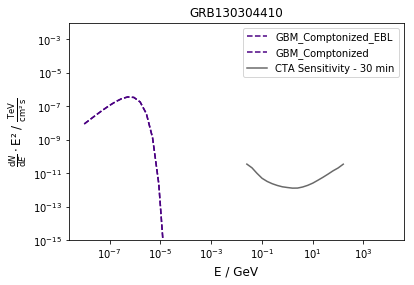

Start simulation for GRB140608713 with (random?) redshift =  1.81901485589
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


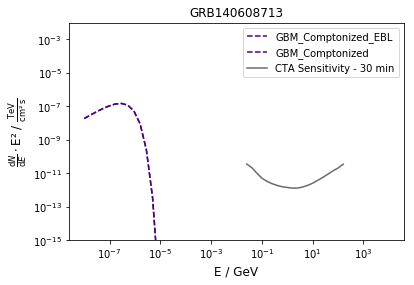

Start simulation for GRB100714672 with (random?) redshift =  2.253118283
Start IRF part
Ready
10851.548345352747 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


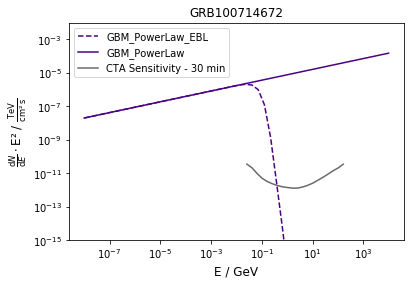

Start simulation for GRB140709051 with (random?) redshift =  1.19084927571
Start IRF part
Ready
1534.0458781127554 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


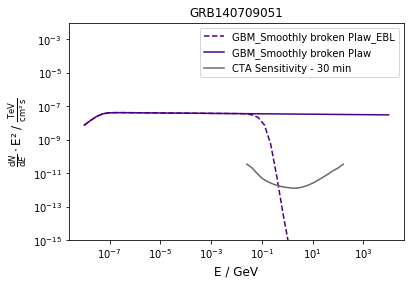

Start simulation for GRB090511684 with (random?) redshift =  0.375965294437
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


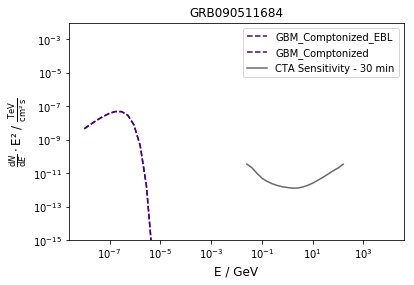

Start simulation for GRB170306588 with (random?) redshift =  0.952759093758
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


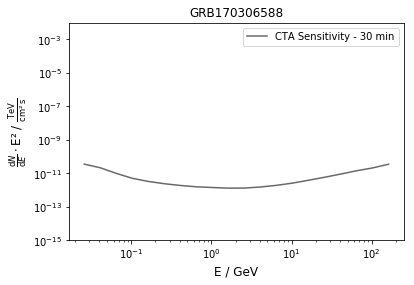

Start simulation for GRB090109332 with (random?) redshift =  4.93786123613
Start IRF part
Ready
15556.060632158375 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


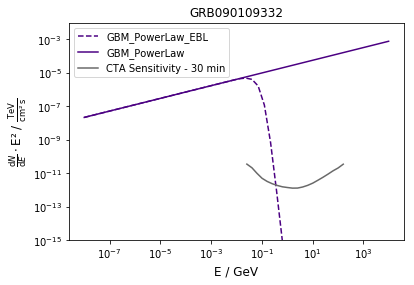

Start simulation for GRB170506169 with (random?) redshift =  1.0321111045
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


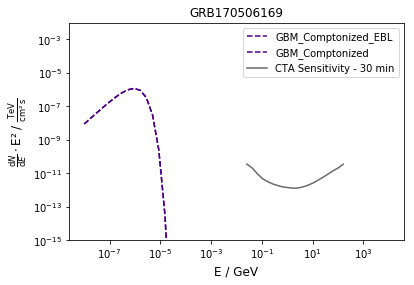

Start simulation for GRB161217128 with (random?) redshift =  2.65351318465
Start IRF part
Ready
9816.176213336463 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


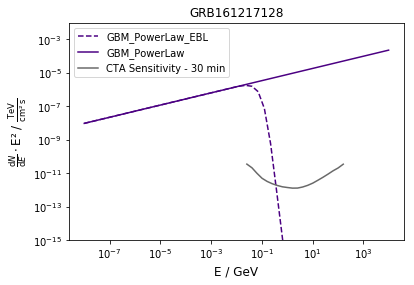

Start simulation for GRB130305486 with (random?) redshift =  3.1251976451
Start IRF part
Ready
250.29903169092788 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


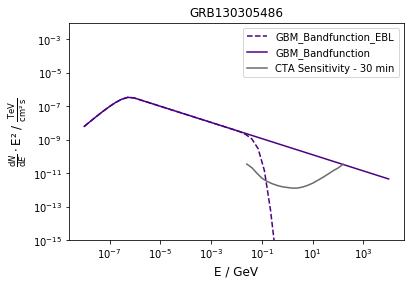

Start simulation for GRB130112286 with (random?) redshift =  1.47492224001
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


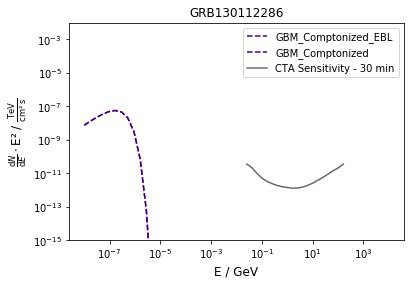

Start simulation for GRB170724543 with (random?) redshift =  1.89832549473
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


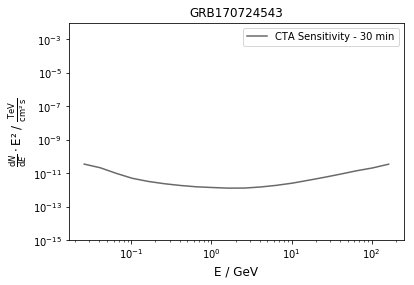

Start simulation for GRB130815420 with (random?) redshift =  4.56893845188
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


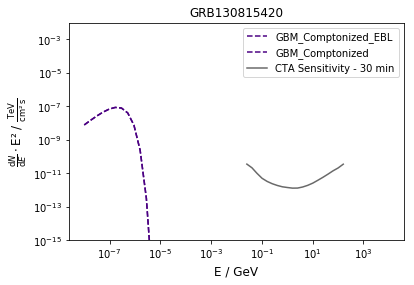

Start simulation for GRB140620219 with (random?) redshift =  2.42438404909
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


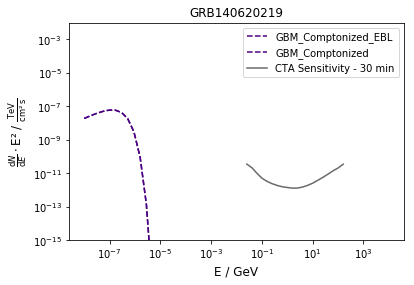

Start simulation for GRB090320801 with (random?) redshift =  0.506751680748
Start IRF part
Ready
7488.434281814191 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


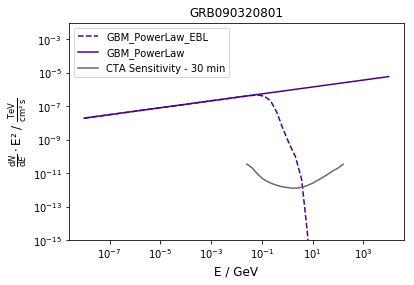

Start simulation for GRB170831179 with (random?) redshift =  3.74722110308
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


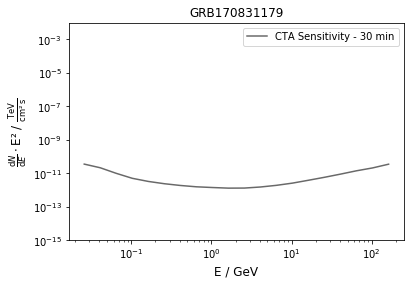

Start simulation for GRB140423356 with (random?) redshift =  1.98045824636
Start IRF part
Ready
4011.953288062813 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


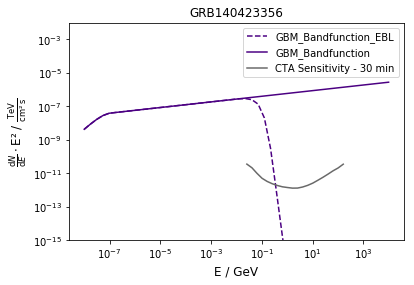

Start simulation for GRB120729456 with (random?) redshift =  2.47681915029
Start IRF part
Ready
15496.24180017459 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


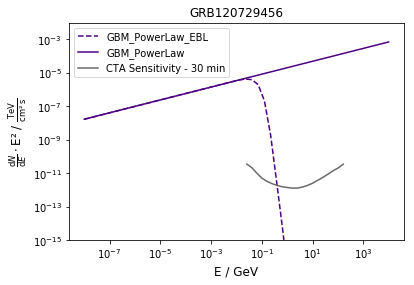

Start simulation for GRB150330828 with (random?) redshift =  1.39094581065
Start IRF part
Ready
3641.321195450809 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


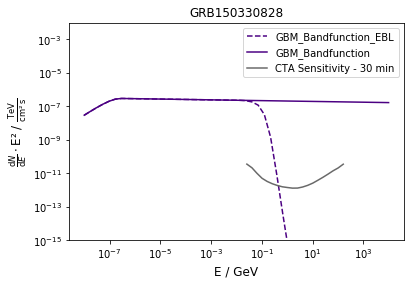

Start simulation for GRB170511648 with (random?) redshift =  2.13617429229
Start IRF part
Ready
13282.269149739146 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


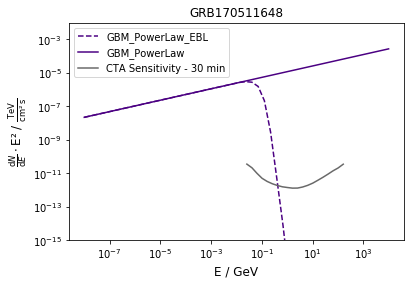

Start simulation for GRB141124277 with (random?) redshift =  3.06198594525
Start IRF part
Ready
99873.32975094055 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


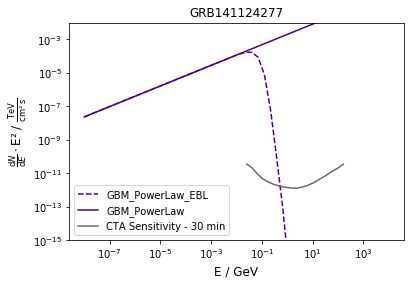

Start simulation for GRB090618353 with (random?) redshift =  1.67404867357
Start IRF part
Ready
1079.4258245930018 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


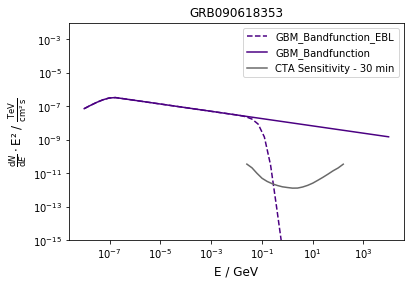

Start simulation for GRB150828901 with (random?) redshift =  1.20004254299
Start IRF part
Ready
86014.88834487552 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


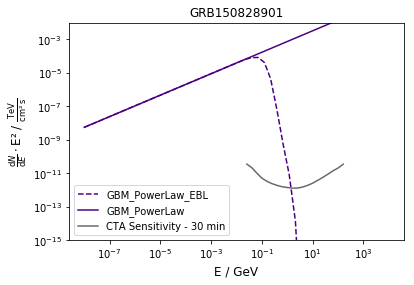

Start simulation for GRB120530121 with (random?) redshift =  1.34710416076
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


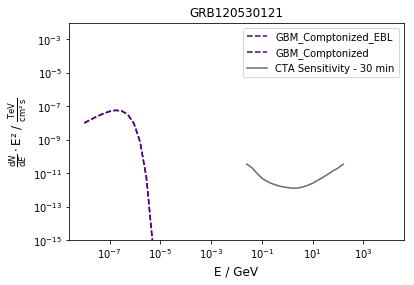

Start simulation for GRB140404030 with (random?) redshift =  2.87385402768
Start IRF part
Ready
5215.670260771812 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


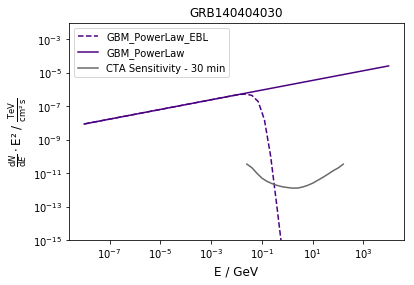

Start simulation for GRB160521385 with (random?) redshift =  0.524035183942
Start IRF part
Ready
344.36302696459194 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


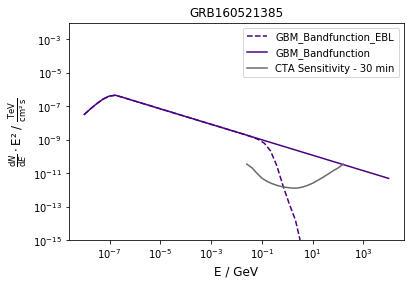

Start simulation for GRB141109447 with (random?) redshift =  4.91366319727
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


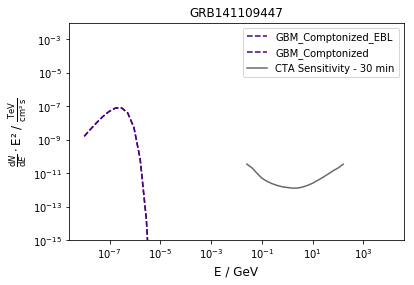

Start simulation for GRB100724029 with (random?) redshift =  1.6984903957
Start IRF part
Ready
4365.854707081198 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


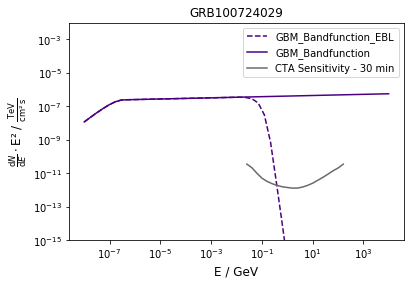

Start simulation for GRB170414551 with (random?) redshift =  2.52233207835
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


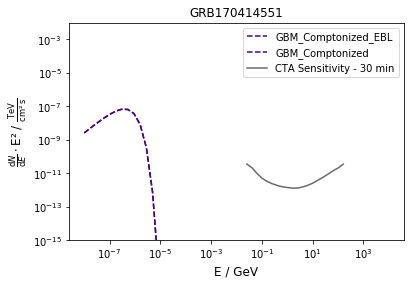

Start simulation for GRB160509374 with (random?) redshift =  1.5250489427
Start IRF part
Ready
1041.4432398844956 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


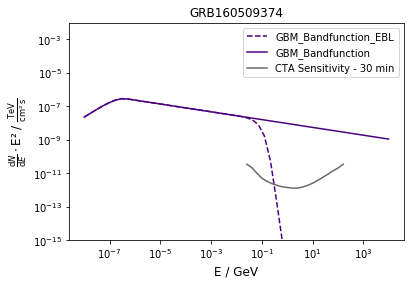

Start simulation for GRB091223191 with (random?) redshift =  2.39737865867
Start IRF part
Ready
128540.89077076066 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


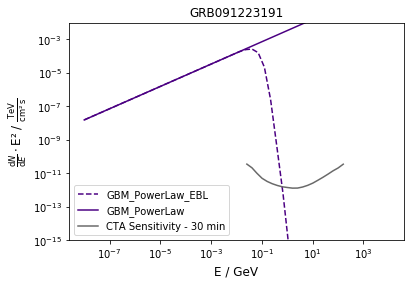

Start simulation for GRB140217043 with (random?) redshift =  2.33444516273
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


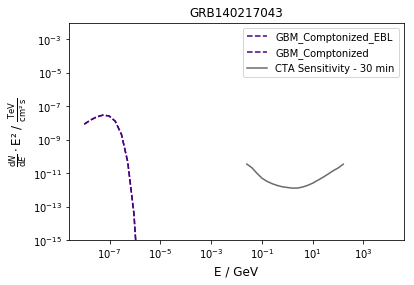

Start simulation for GRB100725475 with (random?) redshift =  3.80860483952
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


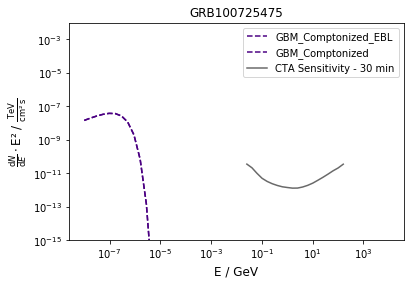

Start simulation for GRB160629930 with (random?) redshift =  2.82274237026
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


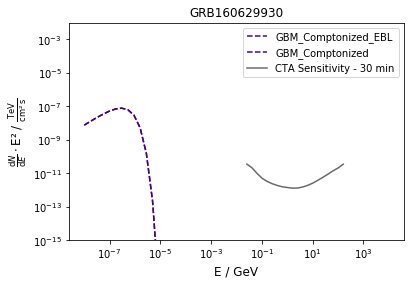

Start simulation for GRB091230712 with (random?) redshift =  2.02736825382
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


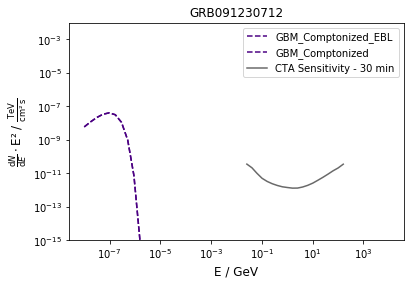

Start simulation for GRB160924253 with (random?) redshift =  2.9612042374
Start IRF part
Ready
56676.1415326882 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


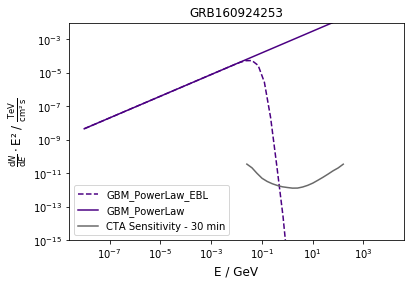

Start simulation for GRB091115177 with (random?) redshift =  0.750606024949
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


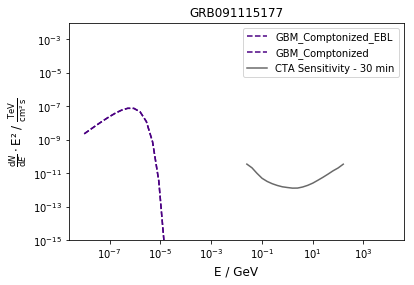

Start simulation for GRB150919606 with (random?) redshift =  1.08840368859
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


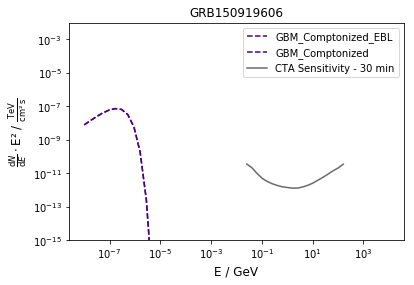

Start simulation for GRB100827455 with (random?) redshift =  1.00854319148
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


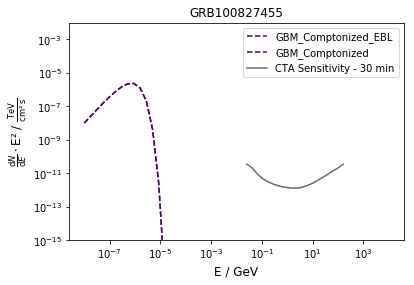

Start simulation for GRB091219462 with (random?) redshift =  2.16879564071
Start IRF part
Ready
13396.28502652016 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


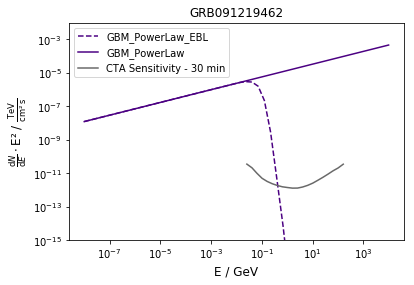

Start simulation for GRB170514152 with (random?) redshift =  1.50693078802
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


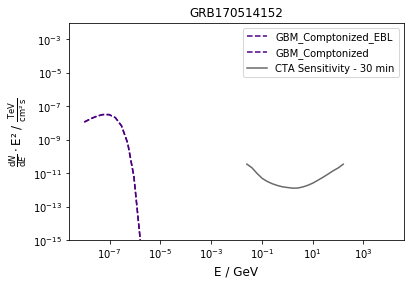

Start simulation for GRB131028076 with (random?) redshift =  3.96481004158
Start IRF part
Ready
2.025732517730498 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


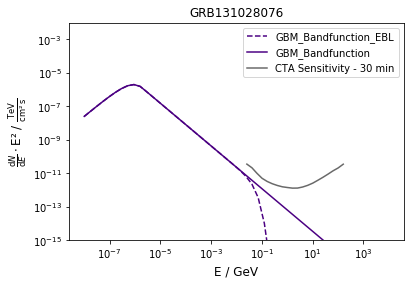

Start simulation for GRB090910812 with (random?) redshift =  3.90930543724
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


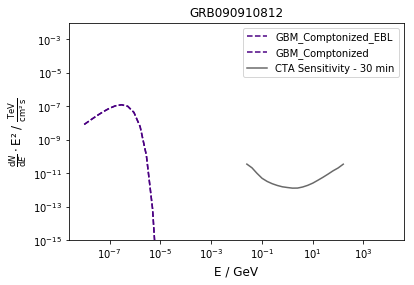

Start simulation for GRB150607330 with (random?) redshift =  1.79379121589
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


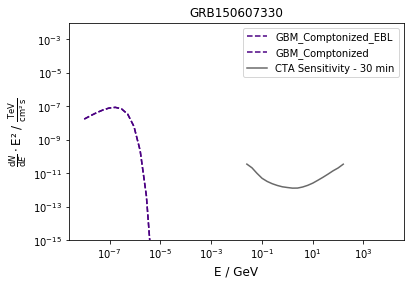

Start simulation for GRB150320462 with (random?) redshift =  1.415660649
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


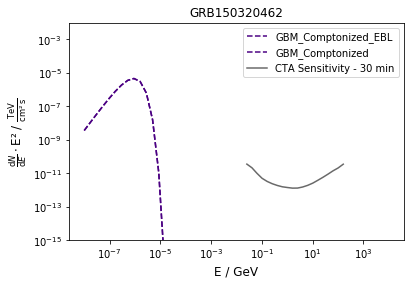

Start simulation for GRB160317385 with (random?) redshift =  0.668095818055
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


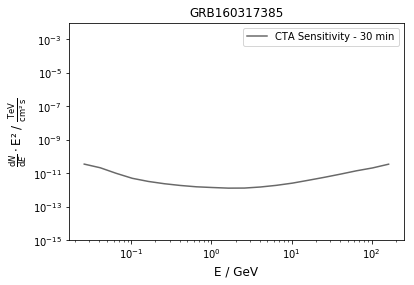

Start simulation for GRB090621922 with (random?) redshift =  1.87961364893
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


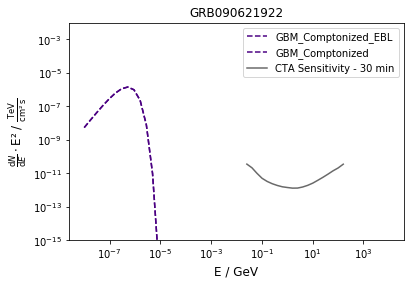

Start simulation for GRB111222619 with (random?) redshift =  0.123122917962
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


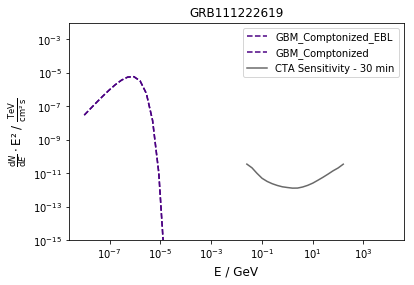

Start simulation for GRB120326056 with (random?) redshift =  2.29445296797
Start IRF part
Ready
72.21495224706507 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


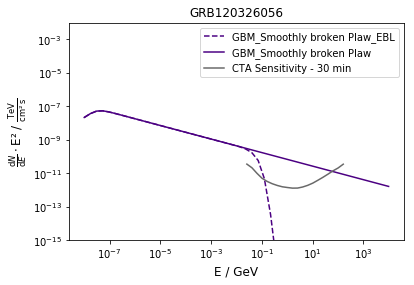

Start simulation for GRB160201883 with (random?) redshift =  1.45575714283
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


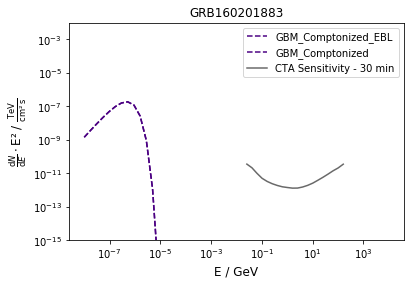

Start simulation for GRB150428305 with (random?) redshift =  0.909284207936
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


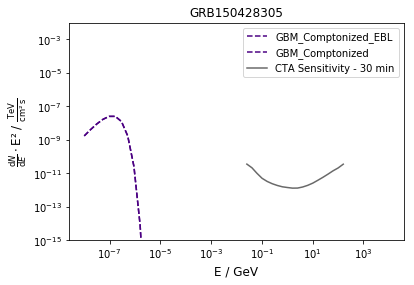

Start simulation for GRB161106499 with (random?) redshift =  1.69204666054
Start IRF part
Ready
0.0 Sigma reached with a maximum background and EBL absorption
Duration of simulation in seconds:  1800


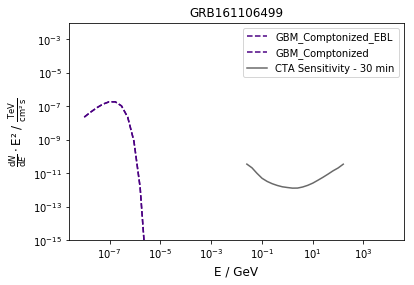

In [14]:
N = len(DF)
Sigmas = unumpy.uarray(np.zeros(N), np.zeros(N)) 
for i in range(0,N-1):
    index = i 
    Name = DF['Name'][index]
    z = gamma.rvs(a, size=1)
    z = z[0]

    Sigma = simulate_GBM_detection('/home/jana/Schreibtisch/Projekt_Master/caldb/data/cta/prod3b/bcf/South_z20_average_30m/irf_file.fits',
               DF,Name,z,1800)
    if np.isnan(Sigma) == True:
        Sigma = ufloat(0.0,0.0)
    Sigmas[i] = Sigma 

In [15]:
DetectionRate = len(Sigmas[Sigmas>5])/len(Sigmas)
DetectionRate

0.36

## Usage with Joint LAT and GBM data  


In [13]:
from Gilmore_simulation import calculaterate_and_Plot_Joint
from Gilmore_simulation import integrate_background, calculatesignificance
from Sensitivity import plot_Sens
import matplotlib.pyplot as plt 

<Quantity 658.4548790478474>

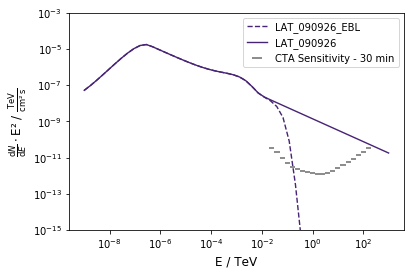

In [17]:
def simulate_LAT_detection(Path_to_fits_file,GRBname,time,z):
    plot_Sens('Tev', 'binwise','dimgray')
    Gamma_R = calculaterate_and_Plot_Joint(Path_to_fits_file,GRBname,z)
    plt.ylim(1e-15,1e-3)
    Back_R = integrate_background(Path_to_fits_file)[0]
    Sigma = calculatesignificance(Gamma_R,Back_R,time,1)
    return Sigma 

simulate_LAT_detection('/home/jana/Schreibtisch/Projekt_Master/caldb/data/cta/prod3b/bcf/South_z20_average_30m/irf_file.fits',
                       '090926',1800,4)

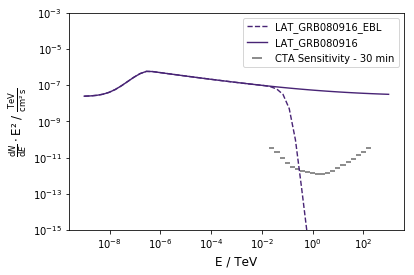

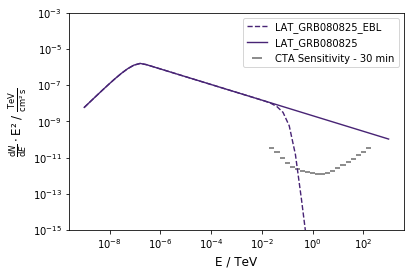

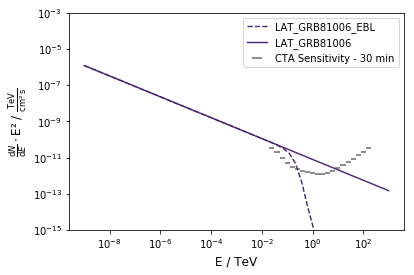

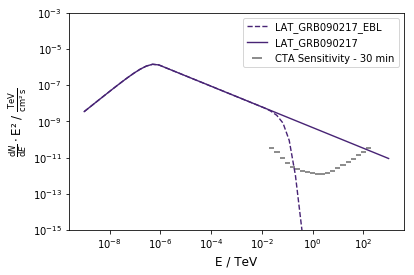

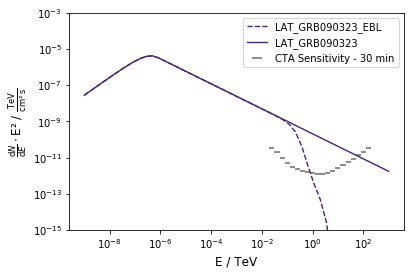

...

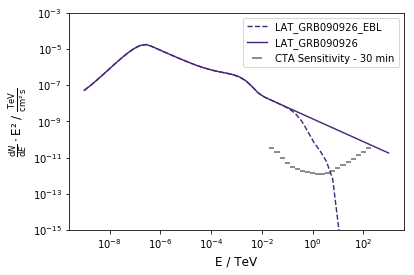

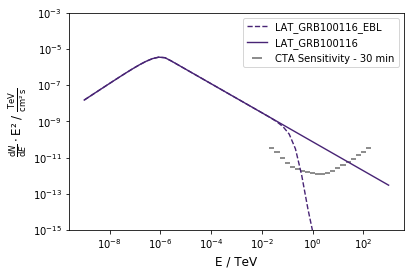

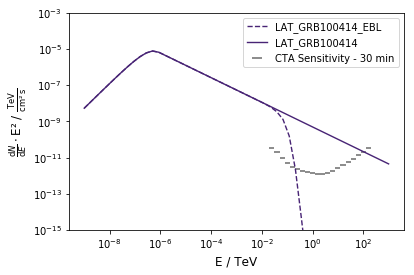

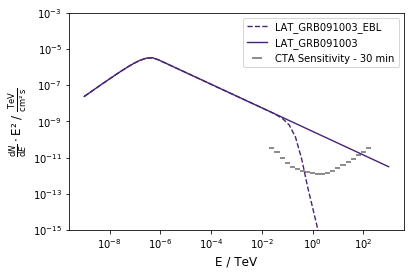

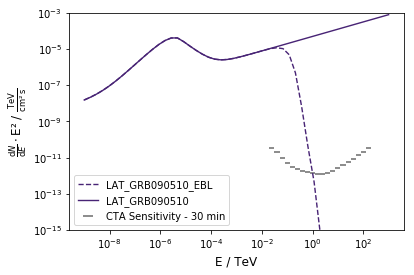

/home/jana/anaconda3/lib/python3.6/site-packages/scipy/integrate/quadpack.py:364: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  warnings.warn(msg, IntegrationWarning)
/home/jana/.local/lib/python3.6/site-packages/astropy/units/quantity.py:641: RuntimeWarning: invalid value encountered in log
  *arrays, **kwargs)


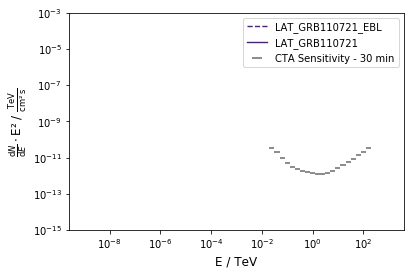

In [18]:
Names = np.array(['GRB080916','GRB080825', 'GRB81006', 'GRB090217', 'GRB090323',
                 'GRB090902', 'GRB090926', 'GRB100116', 'GRB100414', 'GRB091003',
                 'GRB090510', 'GRB110721', 'GRB110731'])
N = len(Names)
Sigmas = np.zeros(N) 
for i in range(0,N-1):
    Name = Names[i]
    z = gamma.rvs(a, size=1)
    z = z[0]
    Sigma = simulate_LAT_detection('/home/jana/Schreibtisch/Projekt_Master/caldb/data/cta/prod3b/bcf/South_z20_average_30m/irf_file.fits',
               Name,1800,z)
    plt.show()
    plt.clf()
    if np.isnan(Sigma) == True:
        Sigma = 0
    Sigmas[i] = Sigma 

In [24]:
DetectionRate = len(Sigmas[Sigmas>5])/len(Sigmas)
DetectionRate

0.8461538461538461

In [19]:
cmap = plt.cm.get_cmap('viridis')
viridis10 = cmap(0.1)
viridis9 = cmap(0.2)
viridis8 = cmap(0.28)
viridis7 = cmap(0.35)
viridis6 = cmap(0.42)
viridis5 = cmap(0.5)
viridis4 = cmap(0.6)
viridis3= cmap(0.7)
viridis2 = cmap(0.82)
viridis1 = cmap(0.9)
viridis0 = cmap(0.98)

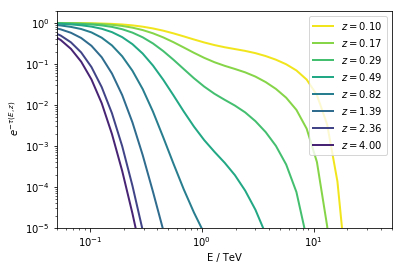

In [27]:
## New EBL method 
colors = np.array(['indigo', 'dimgray','thistle','darkslateblue','lightsteelblue',
                  'darkmagenta','lightgray','midnightblue'])


colors = np.array([viridis0,viridis2,viridis3,viridis4,viridis6,viridis7,viridis9,viridis10])

from ebltable.tau_from_model import OptDepth
tau =  OptDepth.readmodel(model = 'dominguez')
z = np.arange(0.1,4,0.45)
z = np.logspace(np.log10(0.1), np.log10(4), num=8)
ETeV = np.logspace(-2,2.5,50)
atten = np.exp(-1. * tau.opt_depth(z,ETeV))
for i,zz in enumerate(z):
    plt.loglog(ETeV,atten[i],
              ls = '-',color = colors[i],
              label = '$z = {0:.2f}$'.format(zz), lw = 2)

plt.gca().set_ylim((1e-5,2.))
plt.gca().set_xlim((5e-2,5e1))
plt.gca().set_xlabel('E / TeV')
plt.gca().set_ylabel(r' $e^{-\tau(E,z)}$')
plt.legend(loc = 'upper right')
#plt.savefig('Plots/Gilmore_Simulation/New_EBL_Dom.jpg')
plt.savefig('Plots/New_EBL_Dom.pdf')
plt.show()